<a href="https://colab.research.google.com/github/romqn1999/Predict-price-after-pattern/blob/main/Find_price_patterns.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Find price patterns

## Install packages

In [1]:
#optional installations: 
!pip install yfinance --upgrade --no-cache-dir
!pip3 install pandas_datareader

Requirement already up-to-date: yfinance in /usr/local/lib/python3.7/dist-packages (0.1.59)


## Import packages

In [2]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

# ___library_import_statements___
import pandas as pd

# for pandas_datareader, otherwise it might have issues, sometimes there is some version mismatch
pd.core.common.is_list_like = pd.api.types.is_list_like
import pandas_datareader.data as web
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.signal import argrelextrema
import datetime
import time

#newest yahoo API 
import yfinance as yahoo_finance

from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels import DotProduct, WhiteKernel, RBF, ConstantKernel as C

#optional 
#yahoo_finance.pdr_override()

%matplotlib inline

## Get data

In [3]:
#@title Set symbol and time for get data
ticker = "All" #@param ["AA", "AAA", "AAAU", "AABB", "AAC", "AACG", "AACQ", "AADAX", "AADEX", "AADR", "AADTX", "AAEEF", "AAGC", "AAGH", "AAIC", "AAIGF", "AAIIQ", "AAIRF", "AAL", "AAMC", "AAME", "AAMMF", "AAN", "AAOI", "AAP", "AAPL", "AAPT", "AAQC", "AASP", "AASZF", "AAT", "AATGF", "AATRL", "AATV", "AAVVF", "AAVXF", "AAWW", "AAXJ", "ABB", "ABBRF", "ABBV", "ABC", "ABCB", "ABCL", "ABCM", "ABEO", "ABEV", "ABG", "ABGI", "ABGSF", "ABIO", "ABKB", "ABLZF", "ABM", "ABMBF", "ABMC", "ABMD", "ABML", "ABMT", "ABNAF", "ABNB", "ABQQ", "ABR", "ABRRP", "ABST", "ABT", "ABTI", "ABTX", "ABVC", "ABVG", "ABWN", "ABXXF", "ABZPF", "ABZPY", "ABZT", "ABZUF", "ACA", "ACAC", "ACAD", "ACB", "ACBA", "ACBAU", "ACBI", "ACC", "ACCD", "ACDSF", "ACDVF", "ACER", "ACES", "ACET", "ACEV", "ACFL", "ACFN", "ACGBY", "ACGL", "ACGLO", "ACGLP", "ACH", "ACHC", "ACHL", "ACHV", "ACI", "ACIC", "ACIU", "ACIW", "ACKAY", "ACKIU", "ACKIW", "ACKRF", "ACLLF", "ACLS", "ACM", "ACMC", "ACMR", "ACN", "ACNB", "ACND", "ACNNF", "ACNV", "ACP", "ACPRF", "ACR", "ACRDF", "ACRE", "ACRHF", "ACRS", "ACRX", "ACST", "ACTC", "ACTG", "ACV", "ACVA", "ACVF", "ACWI", "ACWV", "ACWX", "ACXIF", "ACY", "ADAP", "ADBE", "ADBRF", "ADC", "ADCOF", "ADCT", "ADDC", "ADDDF", "ADDXF", "ADDYY", "ADES", "ADFI", "ADFS", "ADGCF", "ADGO", "ADHC", "ADI", "ADIL", "ADKT", "ADM", "ADMA", "ADMP", "ADN", "ADNT", "ADP", "ADPT", "ADRNY", "ADS", "ADSK", "ADT", "ADTM", "ADTN", "ADTX", "ADV", "ADVM", "ADWPF", "ADX", "ADXN", "ADXS", "ADYEY", "ADYX", "ADYYF", "AE", "AEAC", "AEAU", "AEAW", "AEB", "AEBZY", "AEE", "AEEX", "AEF", "AEFC", "AEG", "AEGY", "AEHDX", "AEHL", "AEHR", "AEI", "AEIS", "AEL", "AELTF", "AEM", "AEMD", "AENG", "AENZ", "AEP", "AEPPL", "AEPT", "AER", "AES", "AESC", "AESE", "AESO", "AETUF", "AEVA", "AEXAY", "AEXE", "AEY", "AEYE", "AEZS", "AFAQ", "AFAQU", "AFAQW", "AFAVX", "AFAZX", "AFB", "AFBA", "AFBG", "AFBI", "AFC.L", "AFCG", "AFDIX", "AFDVX", "AFE.JO", "AFE.V", "AFG", "AFG.AX", "AFG.OL", "AFGC", "AFGD", "AFGYF", "AFH.JO", "AFHBL", "AFHIF", "AFHL.TA", "AFHP.L", "AFI", "AFIB", "AFIN", "AFINP", "AFJAX", "AFJCX", "AFK", "AFK.OL", "AFKS.ME", "AFL", "AFL.SG", "AFLG", "AFLT.ME", "AFLYY", "AFM.JF", "AFM.V", "AFMD", "AFML", "AFN.L", "AFP.L", "AFP.SW", "AFPW", "AFQSX", "AFRM", "AFS.L", "AFSIB", "AFSIC", "AFSIM", "AFSIN", "AFSIP", "AFT", "AFTM", "AFTPY", "AFW.AX", "AFW.DE", "AFW.DU", "AFW.F", "AFW.MU", "AFW.SG", "AFX.DE", "AFX.F", "AFX.HA", "AFX.L", "AFX.TI", "AFX.VI", "AFYA", "AFYG", "AFZ.BE", "AFZ.F", "AFZ.MU", "AFZ.SG", "AMC", "AMD", "AMZN", "BA", "BABA", "BB", "BTC", "BTC-USD", "DAX", "ETH-USD", "F", "FB", "GME", "GOOG", "IBM", "KO", "NFLX", "NOK", "NVDA", "PLUG", "QCOM", "QQQ", "QYLD", "R", "RIDE", "RIOT", "SNP", "SPCE", "SPY", "T", "TSLA", "V", "VIAC", "VICI", "VXRT", "VZ", "W", "WFC", "WMT", "X", "XOM", "XPEV", "Y", "Z", "ZM", "ZOM"] {allow-input: true}
tickers = ["AA", "AACG", "AACQ", "AADAX", "AADEX", "AADR", "AAIC", "AAIGF", "AAIIQ", "AAL", "AAMC", "AAME", "AAN", "AAOI", "AAP", "AAPL", "AASP", "AAT", "AATRL", "AAVVF", "AAVXF", "AAWW", "AAXJ", "ABB", "ABBV", "ABC", "ABCB", "ABCL", "ABEO", "ABEV", "ABG", "ABIO", "ABLZF", "ABM", "ABMD", "ABNAF", "ABNB", "ABR", "ABST", "ABT", "ABTX", "ABWN", "ACA", "ACAC", "ACAD", "ACB", "ACBI", "ACC", "ACCD", "ACDVF", "ACER", "ACES", "ACET", "ACFL", "ACFN", "ACGBY", "ACGL", "ACGLO", "ACH", "ACHC", "ACHV", "ACI", "ACIU", "ACIW", "ACKAY", "ACLLF", "ACLS", "ACM", "ACMR", "ACN", "ACNB", "ACP", "ACR", "ACRDF", "ACRE", "ACRHF", "ACRS", "ACRX", "ACST", "ACTC", "ACTG", "ACV", "ACWI", "ACWV", "ACWX", "ACXIF", "ACY", "ADAP", "ADBE", "ADC", "ADCT", "ADDDF", "ADDYY", "ADES", "ADHC", "ADI", "ADIL", "ADM", "ADMA", "ADMP", "ADNT", "ADP", "ADPT", "ADRNY", "ADS", "ADSK", "ADT", "ADTM", "ADTN", "ADTX", "ADVM", "ADX", "ADXN", "ADXS", "ADYEY", "ADYX", "ADYYF", "AE", "AEB", "AEE", "AEF", "AEFC", "AEG", "AEGY", "AEHL", "AEHR", "AEIS", "AEL", "AEM", "AEMD", "AENZ", "AEP", "AEPPL", "AEPT", "AER", "AES", "AESC", "AETUF", "AEXAY", "AEXE", "AEY", "AEYE", "AEZS", "AFAVX", "AFAZX", "AFB", "AFBA", "AFC.L", "AFCG", "AFDIX", "AFDVX", "AFE.JO", "AFG.OL", "AFGC", "AFGD", "AFH.JO", "AFHBL", "AFHIF", "AFHL.TA", "AFHP.L", "AFI", "AFIB", "AFIN", "AFINP", "AFJAX", "AFJCX", "AFK", "AFK.OL", "AFKS.ME", "AFL", "AFL.SG", "AFLG", "AFLT.ME", "AFLYY", "AFM.JF", "AFMD", "AFN.L", "AFP.SW", "AFPW", "AFRM", "AFS.L", "AFSIB", "AFSIC", "AFSIM", "AFSIN", "AFSIP", "AFT", "AFTM", "AFTPY", "AFW.DE", "AFW.DU", "AFW.F", "AFW.MU", "AFW.SG", "AFX.DE", "AFX.F", "AFX.HA", "AFX.L", "AFX.VI", "AFYA", "AFZ.BE", "AFZ.F", "AFZ.MU", "AFZ.SG", "AMC", "AMD", "AMZN", "BA", "BABA", "BB", "BTC-USD", "DAX", "ETH-USD", "F", "FB", "GME", "GOOG", "IBM", "KO", "NFLX", "NOK", "NVDA", "PLUG", "QCOM", "QQQ", "QYLD", "R", "RIDE", "RIOT", "SNP", "SPCE", "SPY", "T", "TSLA", "V", "VIAC", "VICI", "VXRT", "VZ", "W", "WFC", "WMT", "X", "XOM", "XPEV", "Y", "Z", "ZM"]
start_time = "2000-01-01" #@param {type:"date"}
start_time = datetime.datetime.strptime(start_time, "%Y-%m-%d")
# end_time = datetime.datetime.now().date().isoformat()         # today
end_time = datetime.datetime.now().date().strftime("%Y-%m-%d") #@param {type:"date"}
price_name = "Close" #@param ["Open", "High", "Low", "Close", "Adj Close"]

In [4]:
def get_data_yahoo(ticker, start_time, end_time, max_try=5):
    # yahoo gives only daily historical data
    connected = False
    tried = 0
    while not connected and tried < max_try:
        tried += 1
        try:
            ticker_df = web.get_data_yahoo(ticker, start=start_time, end=end_time)
            connected = True
            print('connected to yahoo')
        except Exception as e:
            print("Error: " + str(e))
            time.sleep(5)
            pass

    if tried >= max_try:
        return None

    # use numerical integer index instead of date    
    ticker_df = ticker_df.reset_index()
    # print(ticker_df.head(5))
    return ticker_df

def get_data_multiple_tickers(tickers, start_time, end_time, max_try=5):
    ticker_dfs = {}
    for ticker in tickers:
        ticker_df = get_data_yahoo(ticker, start_time, end_time)
        ticker_dfs[ticker] = ticker_df
    return ticker_dfs

In [5]:
ticker_df = get_data_yahoo(ticker, start_time, end_time)
print(ticker_df)

if ticker is 'All':
    ticker_dfs = get_data_multiple_tickers(tickers, start_time, end_time)
    print(ticker_dfs)

connected to yahoo
           Date        High         Low  ...       Close     Volume   Adj Close
0    2000-01-03   24.187500   23.250000  ...   23.500000  2993100.0   13.983213
1    2000-01-04   23.750000   22.687500  ...   22.750000  3186700.0   13.536941
2    2000-01-05   23.937500   23.000000  ...   23.750000  3290200.0   14.131971
3    2000-01-06   24.125000   23.125000  ...   23.625000  2760400.0   14.057599
4    2000-01-07   24.812500   23.250000  ...   24.500000  3140400.0   14.578240
...         ...         ...         ...  ...         ...        ...         ...
5390 2021-06-07  136.479996  134.449997  ...  134.490005  2389600.0  134.490005
5391 2021-06-08  134.990005  133.440002  ...  134.580002  1624700.0  134.580002
5392 2021-06-09  134.419998  132.979996  ...  133.029999  1256300.0  133.029999
5393 2021-06-10  134.259995  131.320007  ...  131.410004  1359700.0  131.410004
5394 2021-06-11  132.830002  131.869995  ...  132.220001   229358.0  132.220001

[5395 rows x 7 colum

## Find pattern

### Helper

In [6]:
#@title Check if data is nearly formed a line
#@markdown ### Delta price distance from data point to trend line
trend_delta =  15#@param {type:"number"}

# Get angle of vector ba & vector bc
def get_angle(a, b, c):
    a = np.array(a)
    b = np.array(b)
    c = np.array(c)

    if np.array_equal(a, b) or np.array_equal(a, c) or np.array_equal(b, c):
        return 0

    ba = a - b
    bc = c - b

    if np.all(ba == 0) or np.all(bc == 0):
        return 0

    cosine_angle = np.dot(ba, bc) / (np.linalg.norm(ba) * np.linalg.norm(bc))
    # print(a, b, c)
    # print(cosine_angle)
    angle = np.arccos(cosine_angle)

    deg = np.degrees(angle)
    # print('get_angle({}, {}, {}) = {}'.format(a, b, c, deg))
    return deg

def is_trend(x_data, y_data):
    assert len(x_data) == len(y_data)
    if len(x_data) < 2:
        return False
    # print(x_data)
    # print(y_data)
    # Find the line from the first to the last point
    # y = a * x + b
    x1, y1 = x_data[0], y_data[0]
    x2, y2 = x_data[-1], y_data[-1]
    a = (y1 - y2) / (x1 - x2)  # slope
    b = y1 - a * x1  # intercept
    b_is_trend = True
    for i in range(len(x_data)):
        angle1 = get_angle([x_data[0], y_data[0]], [x_data[-1], y_data[-1]], [x_data[i], y_data[i]])
        angle2 = get_angle([x_data[-1], y_data[-1]], [x_data[0], y_data[0]], [x_data[i], y_data[i]])
        if (angle1 > trend_delta) or (angle2 > trend_delta):
            b_is_trend = False
            break
        # y_val = a * x_data[i] + b
        # err = abs(y_val - y_data[i])
        # if (err > trend_delta * y_val):
        #     b_is_trend = False
        #     break
    return b_is_trend
    # p, res, _, _, _ = np.polyfit(x_data, y_data, 1, full=True)
    # err = res[0] if res.size > 0 else 0
    # if err <= len(x_data) * trend_delta:
    #     return True
    # return False

In [7]:
#@markdown ### Delta price distance between 2 tops/bottoms
y_delta = 0.15 #@param {type:"number"}
min_height = 0.5 #@param {type:"number"}

### Patterns detection func

In [8]:
#@title Double top detection

def find_double_top(x_data, y_data, key_points=None):
    assert len(x_data) == len(y_data)
    # print(x_data, y_data)
    if key_points is None:        
        #           ___ detection of local minimums and maximums ___
        min_max = np.diff(np.sign(np.diff(y_data))).nonzero()[0] + 1          # local min & max
        l_min = (np.diff(np.sign(np.diff(y_data))) > 0).nonzero()[0] + 1      # local min
        l_max = (np.diff(np.sign(np.diff(y_data))) < 0).nonzero()[0] + 1      # local max
        # +1 due to the fact that diff reduces the original index number
        key_points = min_max
        # print(key_points)

    suspected_double_tops = list()
    n = len(x_data)
    maxy = np.max(y_data)
    # for i in range(1, n - 3):
    #     for j in range(i + 2, n - 1):
    for i in range(1, len(key_points) - 2):
        for j in range(i + 2, len(key_points)):
            l = key_points[i]
            r = key_points[j]
            # print(l, r, abs(y_data[l] - y_data[r]))
            # if l == 301 and r == 307:
            #     print(y_data[l], y_data[r], max(y_data[key_points[i + 1: j]]))
            if (abs(y_data[l] - y_data[r]) <= y_delta * maxy) \
               and r - l > 1 \
               and min(y_data[l], y_data[r]) >= max(y_data[key_points[i + 1: j]]):
                k_bottom = np.argmin(y_data[l + 1: r]) + l + 1
                # print(l, k_bottom, r)
                if min(y_data[l], y_data[r]) < y_data[k_bottom] + min_height:
                    continue
                (ilows,) = np.where(y_data[:l] <= y_data[k_bottom])
                istart = None
                if ilows.size > 0:
                    istart = ilows[-1]
                (ilows,) = np.where(y_data[r:] <= y_data[k_bottom])
                iend = None
                if ilows.size > 0:
                    iend = ilows[0] + r
                # print(istart, l, k_bottom, r, iend)
                if istart and iend \
                   and is_trend(x_data[istart: l + 1], y_data[istart:l + 1]) \
                   and is_trend(x_data[l: k_bottom + 1], y_data[l: k_bottom + 1]) \
                   and is_trend(x_data[k_bottom: r + 1], y_data[k_bottom: r + 1]) \
                   and is_trend(x_data[r: iend + 1], y_data[r: iend + 1]):                    
                    # print(istart, l, k_bottom, r, iend)
                    suspected_double_tops.append((istart, l, k_bottom, r, iend))
    return suspected_double_tops

def find_double_top_in_pre_time_steps(x_data, y_data, pre_time_steps=30):
    n = len(x_data)
    suspected_double_tops = list()
    for i in range(0, n - pre_time_steps + 1):
        patterns = find_double_top(x_data[i: i + pre_time_steps], y_data[i: i + pre_time_steps])
        for p in patterns:
            p = (p[0] + i, p[1] + i, p[2] + i, p[3] + i, p[4] + i)
            if p not in suspected_double_tops:
                suspected_double_tops.append(p)
    return suspected_double_tops

In [9]:
#@title Double bottom detection

def find_double_bottom(x_data, y_data, key_points=None):
    assert len(x_data) == len(y_data)
    if key_points is None:        
        #           ___ detection of local minimums and maximums ___
        min_max = np.diff(np.sign(np.diff(y_data))).nonzero()[0] + 1          # local min & max
        l_min = (np.diff(np.sign(np.diff(y_data))) > 0).nonzero()[0] + 1      # local min
        l_max = (np.diff(np.sign(np.diff(y_data))) < 0).nonzero()[0] + 1      # local max
        # +1 due to the fact that diff reduces the original index number
        key_points = min_max

    suspected_double_bottoms = list()
    n = len(x_data)
    maxy = np.max(y_data)
    # for i in range(1, n - 3):
    #     for j in range(i + 2, n - 1):
    for i in range(1, len(key_points) - 2):
        for j in range(i + 2, len(key_points)):
            l = key_points[i]
            r = key_points[j]
            if (abs(y_data[l] - y_data[r]) <= y_delta * maxy) \
               and r - l > 1 \
               and max(y_data[l], y_data[r]) <= min(y_data[key_points[i + 1: j]]):
                k_top = np.argmax(y_data[l + 1: r]) + l + 1
                if max(y_data[l], y_data[r]) + min_height > y_data[k_top]:
                    continue
                (ihights,) = np.where(y_data[:l] >= y_data[k_top])
                istart = None
                if ihights.size > 0:
                    istart = ihights[-1]
                (ihights,) = np.where(y_data[r:] >= y_data[k_top])
                iend = None
                if ihights.size > 0:
                    iend = ihights[0] + r
                if istart and iend \
                   and is_trend(x_data[istart: l + 1], y_data[istart: l + 1]) \
                   and is_trend(x_data[l: k_top + 1], y_data[l: k_top + 1]) \
                   and is_trend(x_data[k_top: r + 1], y_data[k_top: r + 1]) \
                   and is_trend(x_data[r: iend + 1], y_data[r: iend + 1]):                    
                    suspected_double_bottoms.append((istart, l, k_top, r, iend))
    return suspected_double_bottoms

def find_double_bot_in_pre_time_steps(x_data, y_data, pre_time_steps=30):
    n = len(x_data)
    suspected_double_bots = list()
    for i in range(0, n - pre_time_steps + 1):
        patterns = find_double_bottom(x_data[i: i + pre_time_steps], y_data[i: i + pre_time_steps])
        for p in patterns:
            p = (p[0] + i, p[1] + i, p[2] + i, p[3] + i, p[4] + i)
            if p not in suspected_double_bots:
                suspected_double_bots.append(p)
    return suspected_double_bots

### Final visualization

In [10]:
def visualize_res(x_data, y_data, suspected_double_tops, suspected_double_bottoms):
    # ___ plotting ___
    plt.figure(figsize=(20, 10), dpi= 120, facecolor='w', edgecolor='k')
    # plot stock data
    plt.plot(x_data, y_data, '-', markersize=1.5, color='magenta', alpha=0.7)
    # plt.axis('equal')

    for istart, top1, bottom, top2, iend in suspected_double_tops:
        plt.plot(x_data[istart], y_data[istart], "o", color='r')
        plt.plot(x_data[top1], y_data[top1], "o", color='b')
        plt.plot(x_data[bottom], y_data[bottom], "o", color='g')
        plt.plot(x_data[top2], y_data[top2], "o", color='b')
        plt.plot(x_data[iend], y_data[iend], "o", color='r')
        plt.plot(np.array(x_data)[[istart, top1, bottom, top2, iend]], np.array(y_data)[[istart, top1, bottom, top2, iend]], "-", color='g')

    for istart, bot1, top, bot2, iend in suspected_double_bottoms:
        plt.plot(np.array(x_data)[[istart, bot1, top, bot2, iend]], np.array(y_data)[[istart, bot1, top, bot2, iend]], "-", color='b')

    plt.show()

In [15]:
#@title Get data at patterns
pre_time_steps = 30 #@param {type:"integer"}

def save_data_price_patterns(x_data, y_data, suspected_patterns, filename):
    price_patterns_df = pd.DataFrame()
    last = -1
    for pattern in suspected_patterns:
        # if 2 patterns have same end point then only use 1 skip other
        if last == pattern[-1]:
            continue
        last = pattern[-1]
        if last < pre_time_steps or last + 1 >= len(x_data):
            continue
        prices = np.array(y_data).reshape(-1, 1)[last - pre_time_steps + 1 : last + 2]
        price_patterns_df = price_patterns_df.append(pd.DataFrame(prices).T)

    price_patterns_df.to_csv(filename, index=False, header=False)


def save_data_price_pattern(df, pattern, filename):
    last = pattern[-1]
    # print(last)
    if last < pre_time_steps or last + 1 >= len(df):
        return
    start = last - pre_time_steps + 1
    end = last + 2
    # prices = np.array(y_data).reshape(-1, 1)[last - pre_time_steps + 1 : last + 2]
    # price_patterns_df = price_patterns_df.append(pd.DataFrame(prices).T)
    price_pattern_df = df[start: end]

    price_pattern_df.to_csv(filename, index=False, header=True)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(28, 32, 36, 38, 39), (130, 131, 132, 134, 135), (237, 238, 239, 240, 242), (246, 247, 249, 250, 251), (253, 254, 255, 256, 257), (272, 273, 275, 276, 277), (376, 377, 378, 379, 380), (488, 489, 490, 491, 492), (642, 643, 644, 645, 647), (782, 783, 785, 786, 787), (832, 837, 839, 841, 843), (896, 897, 898, 899, 900), (984, 985, 986, 987, 988), (1004, 1005, 1007, 1008, 1009), (1221, 1222, 1224, 1226, 1227), (1304, 1305, 1306, 1308, 1310), (1330, 1331, 1332, 1333, 1334), (1349, 1350, 1352, 1353, 1355), (1530, 1531, 1532, 1533, 1535), (1778, 1779, 1780, 1782, 1783), (1789, 1792, 1793, 1795, 1796), (1949, 1950, 1951, 1952, 1954), (1965, 1966, 1967, 1968, 1969), (1969, 1970, 1971, 1972, 1973), (1993, 1995, 1996, 1997, 1999), (2262, 2263, 2264, 2265, 2266), (2307, 2308, 2309, 2310, 2311), (2345, 2346, 2347, 2348, 2349), (2396, 2397, 2398, 2399, 2400), (2454, 2456, 2459, 2461, 2462), (2516, 2517, 2518, 2520, 2521), (2601, 2602, 2603, 2605, 2607), (2688, 2689, 2693, 2694, 2695), (2848, 2850, 

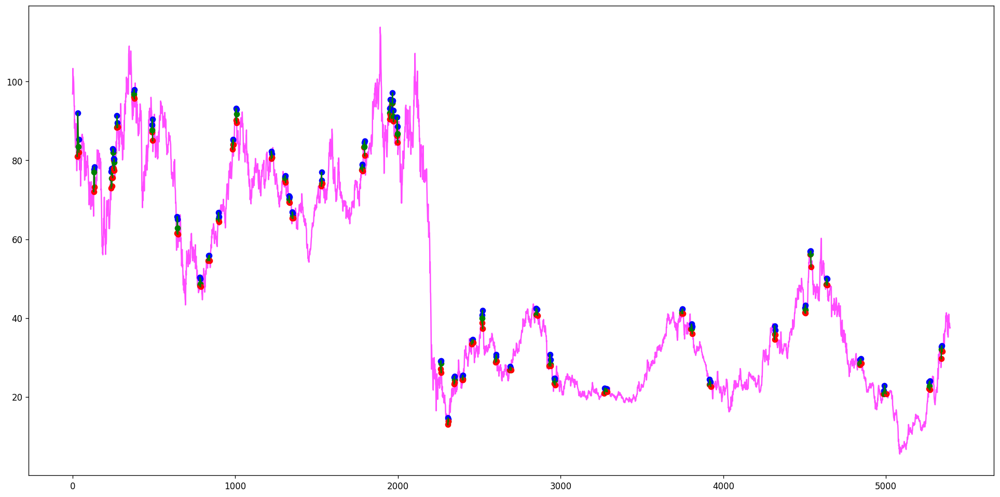

[(146, 147, 148, 150, 152), (178, 179, 182, 185, 187), (371, 375, 379, 380, 383), (866, 867, 873, 875, 877), (1050, 1053, 1057, 1059, 1067), (1854, 1858, 1864, 1865, 1871), (1854, 1860, 1864, 1865, 1871), (3299, 3302, 3305, 3308, 3311)]
[]
Ticker AACG found 8 double top patterns, 0 double bottom patterns


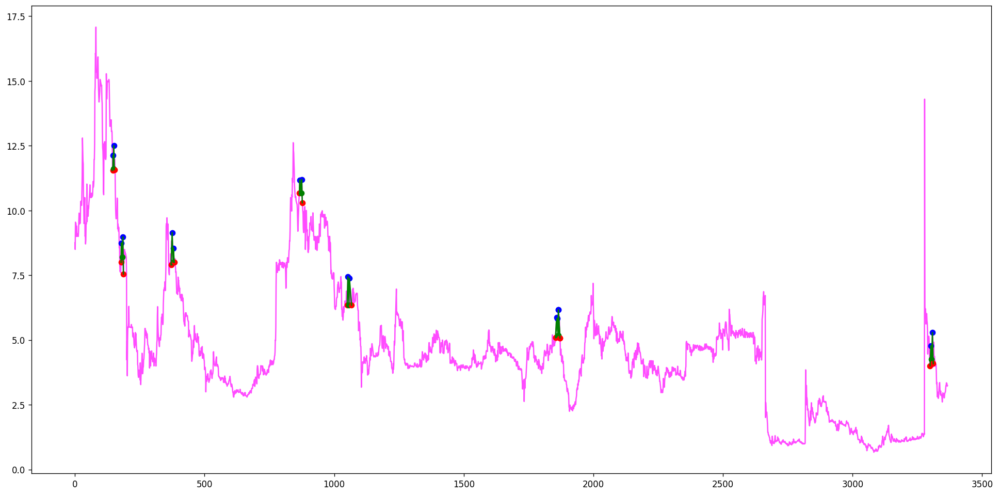

[(110, 111, 113, 115, 116)]
[]
Ticker AACQ found 1 double top patterns, 0 double bottom patterns


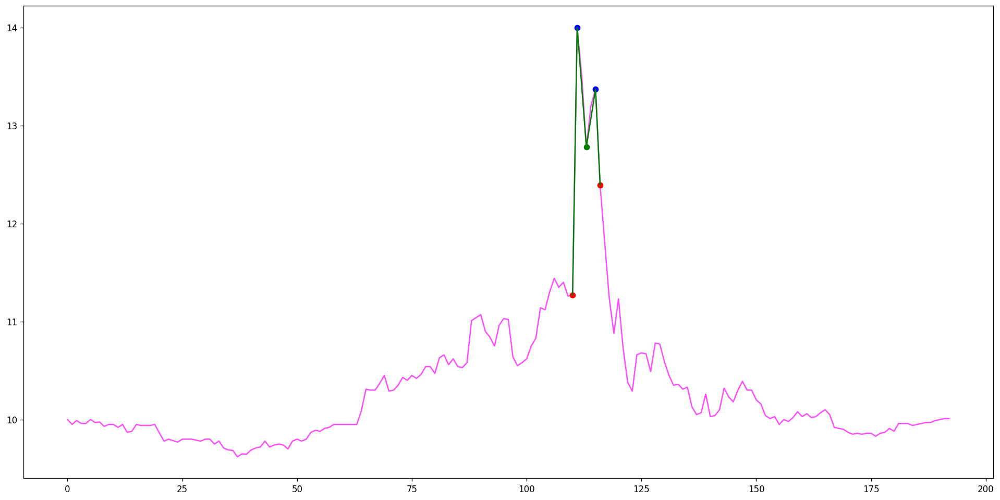

[(1149, 1153, 1154, 1159, 1170), (3649, 3656, 3665, 3673, 3676)]
[]
Ticker AADAX found 2 double top patterns, 0 double bottom patterns


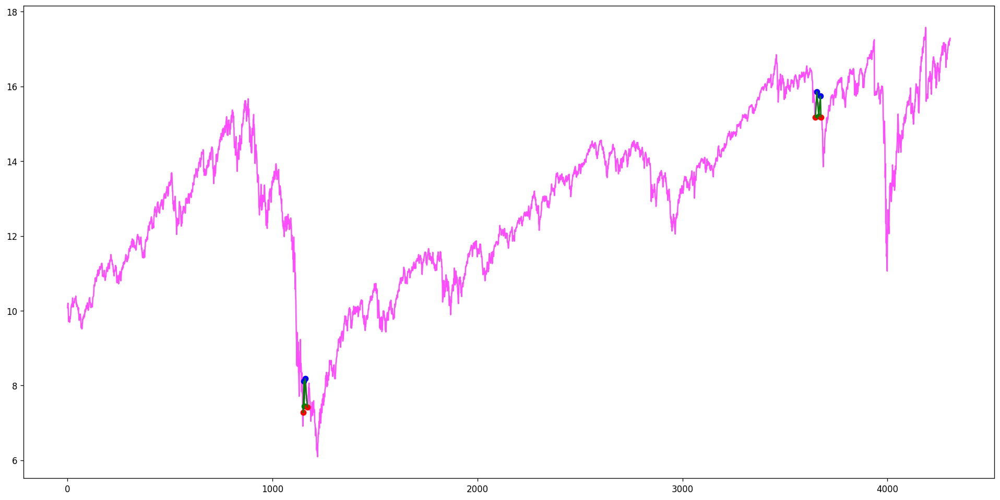

[(2026, 2031, 2036, 2048, 2050), (2888, 2895, 2902, 2905, 2910), (2888, 2895, 2902, 2906, 2910), (2977, 2982, 2983, 2985, 2989), (3142, 3145, 3151, 3155, 3159), (3358, 3371, 3375, 3384, 3386), (5070, 5071, 5072, 5073, 5074), (5097, 5099, 5103, 5104, 5106), (5224, 5227, 5232, 5236, 5237)]
[]
Ticker AADEX found 9 double top patterns, 0 double bottom patterns


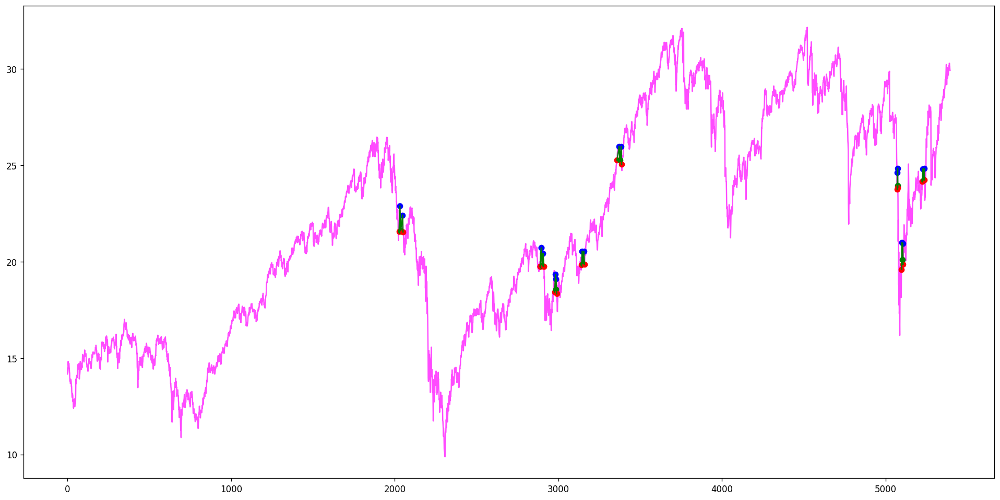

[(64, 66, 70, 75, 81), (234, 247, 250, 255, 261), (234, 249, 250, 255, 261), (1031, 1038, 1040, 1042, 1044), (1262, 1269, 1271, 1272, 1273), (1663, 1664, 1665, 1666, 1668), (1674, 1677, 1678, 1681, 1695), (1981, 1983, 1984, 1985, 1988), (2204, 2207, 2210, 2211, 2213), (2496, 2498, 2499, 2500, 2501), (2542, 2543, 2544, 2548, 2549), (2677, 2678, 2679, 2682, 2683)]
[]
Ticker AADR found 12 double top patterns, 0 double bottom patterns


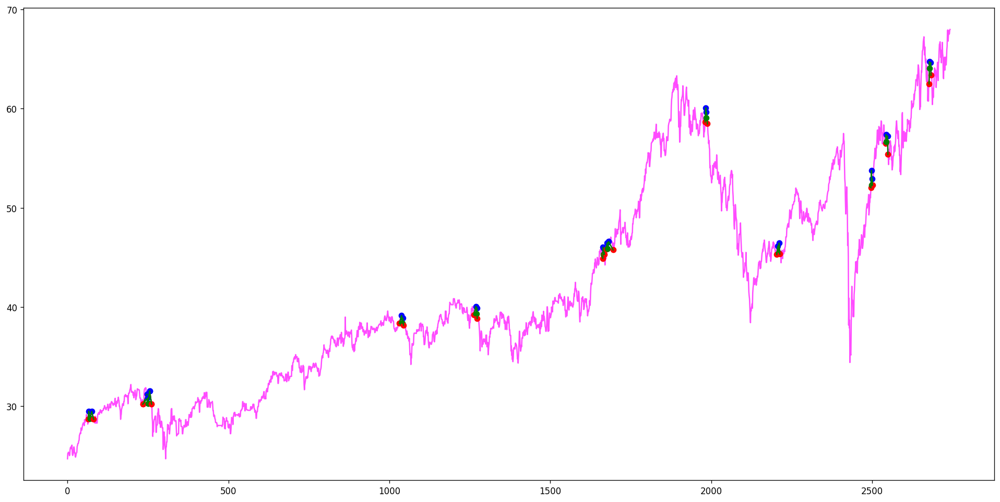

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(7, 8, 11, 12, 13), (72, 73, 74, 76, 77), (118, 119, 121, 124, 127), (131, 132, 133, 134, 135), (187, 188, 189, 190, 191), (209, 210, 211, 212, 213), (209, 210, 213, 215, 218), (301, 302, 303, 304, 305), (333, 334, 336, 337, 338), (348, 349, 350, 351, 352), (386, 387, 388, 389, 390), (390, 391, 392, 393, 394), (410, 411, 412, 413, 414), (443, 444, 446, 447, 448), (458, 459, 460, 462, 463), (501, 502, 503, 504, 505), (518, 520, 522, 523, 524), (525, 526, 528, 529, 532), (583, 584, 585, 587, 588), (615, 616, 617, 618, 619), (648, 649, 650, 651, 654), (666, 667, 668, 671, 672), (701, 702, 703, 704, 705), (699, 700, 701, 702, 706), (717, 718, 719, 720, 721), (724, 725, 728, 729, 730), (728, 729, 730, 731, 732), (738, 739, 740, 741, 743), (758, 759, 760, 761, 762), (817, 818, 819, 820, 821), (862, 863, 864, 865, 866), (866, 867, 868, 869, 870), (895, 897, 899, 900, 901), (891, 894, 895, 897, 902), (909, 910, 911, 913, 914), (930, 932, 933, 934, 935), (941, 942, 943, 944, 945), (953, 954, 9

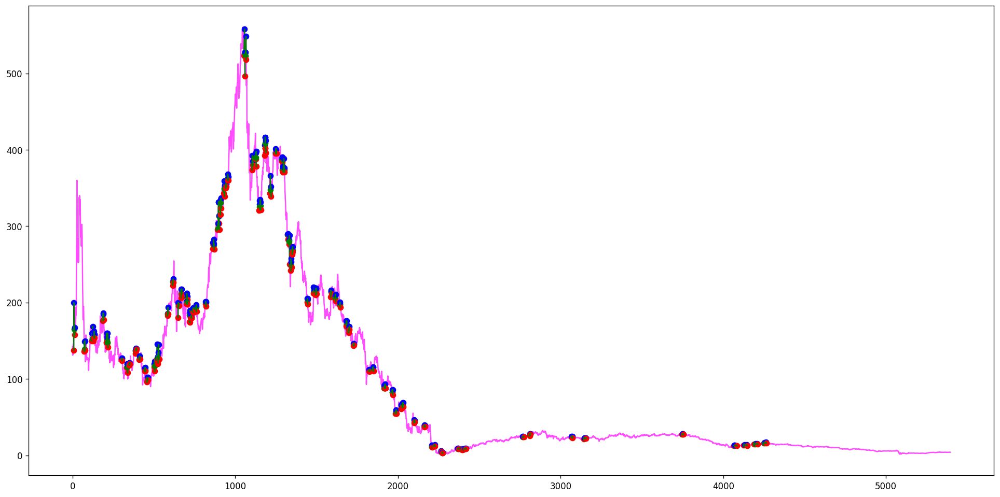

[(2542, 2543, 2544, 2548, 2549), (2593, 2598, 2602, 2604, 2607)]
[]
Ticker AAIGF found 2 double top patterns, 0 double bottom patterns


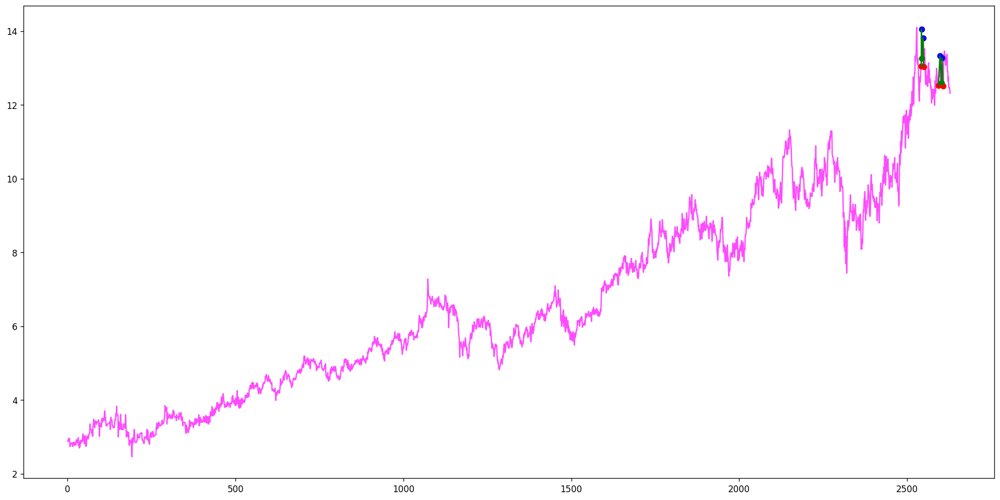

[(19, 20, 21, 23, 24), (60, 61, 62, 63, 64), (790, 793, 794, 797, 798), (900, 901, 902, 903, 904), (971, 981, 984, 985, 986), (1057, 1058, 1059, 1063, 1064), (1434, 1447, 1448, 1453, 1454)]
[]
Ticker AAIIQ found 7 double top patterns, 0 double bottom patterns


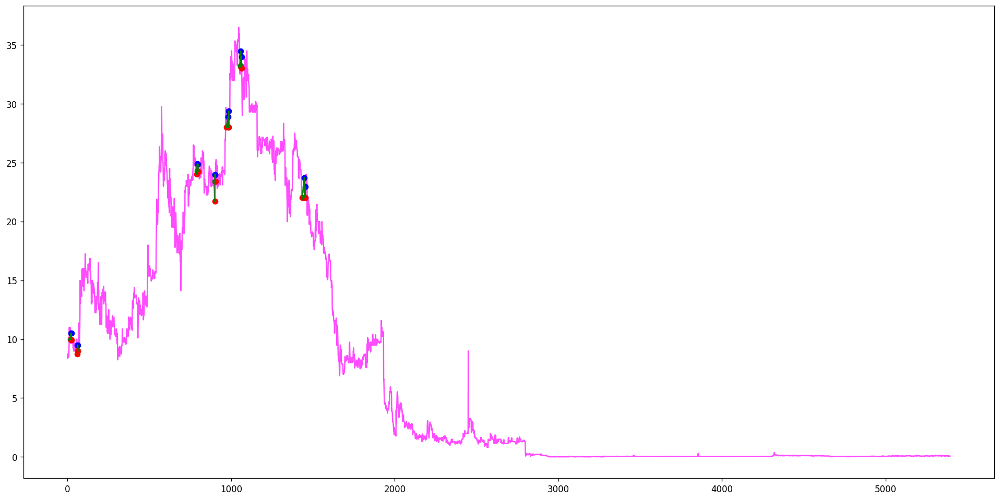

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(4, 7, 12, 13, 15), (153, 154, 157, 158, 159), (193, 194, 195, 196, 197), (230, 233, 235, 236, 237), (342, 343, 344, 346, 347), (379, 380, 381, 383, 384), (477, 478, 479, 480, 482), (507, 511, 513, 514, 515), (545, 546, 547, 548, 549), (2032, 2033, 2035, 2037, 2038), (2215, 2216, 2218, 2219, 2220), (2256, 2257, 2258, 2259, 2260), (2317, 2318, 2319, 2320, 2321), (2329, 2332, 2335, 2336, 2337), (2818, 2819, 2820, 2821, 2822), (2863, 2864, 2865, 2866, 2870), (2998, 2999, 3002, 3004, 3005), (3155, 3156, 3157, 3158, 3159), (3179, 3180, 3182, 3183, 3184), (3228, 3229, 3231, 3232, 3233), (3340, 3341, 3342, 3343, 3344), (3358, 3361, 3364, 3365, 3366), (3449, 3450, 3453, 3454, 3455), (3593, 3595, 3596, 3601, 3602), (3657, 3658, 3659, 3661, 3662), (3754, 3756, 3757, 3762, 3763)]
[]
Ticker AAL found 26 double top patterns, 0 double bottom patterns


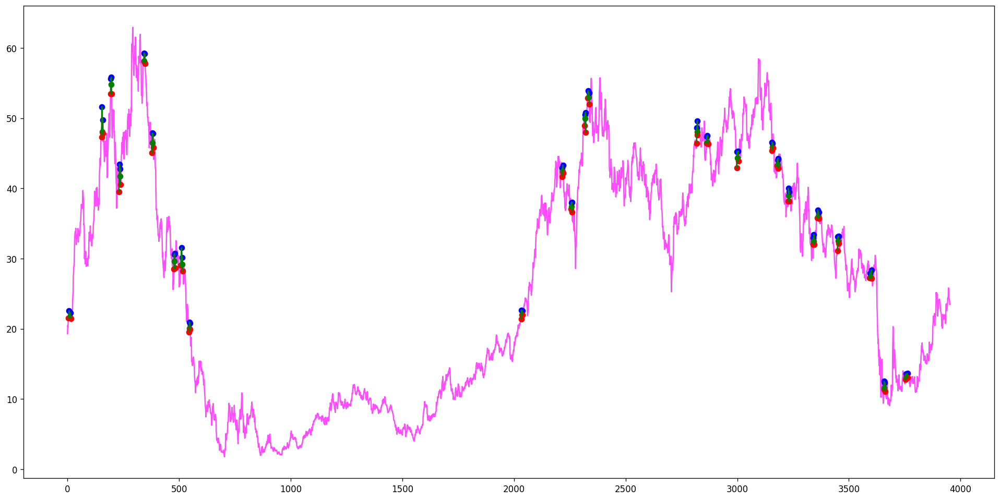

[(37, 39, 40, 41, 42), (46, 47, 48, 49, 50), (61, 62, 63, 65, 66), (105, 106, 107, 108, 110), (221, 222, 223, 224, 225), (262, 263, 264, 265, 266), (269, 273, 280, 281, 282), (292, 293, 294, 295, 296), (317, 318, 319, 320, 321), (368, 369, 370, 372, 374), (429, 431, 432, 434, 435), (538, 540, 543, 544, 545), (578, 580, 585, 586, 588), (595, 596, 597, 598, 599), (599, 600, 601, 602, 603), (609, 610, 611, 613, 614), (663, 664, 665, 666, 667), (691, 692, 693, 694, 695), (761, 763, 764, 765, 766), (1046, 1050, 1051, 1052, 1054), (1137, 1138, 1139, 1140, 1141), (1467, 1468, 1469, 1470, 1471), (1488, 1489, 1490, 1491, 1493), (1502, 1503, 1504, 1506, 1507), (1569, 1572, 1574, 1575, 1576), (1755, 1757, 1759, 1760, 1768), (1896, 1897, 1898, 1902, 1904), (1974, 1975, 1977, 1978, 1981)]
[]
Ticker AAMC found 28 double top patterns, 0 double bottom patterns


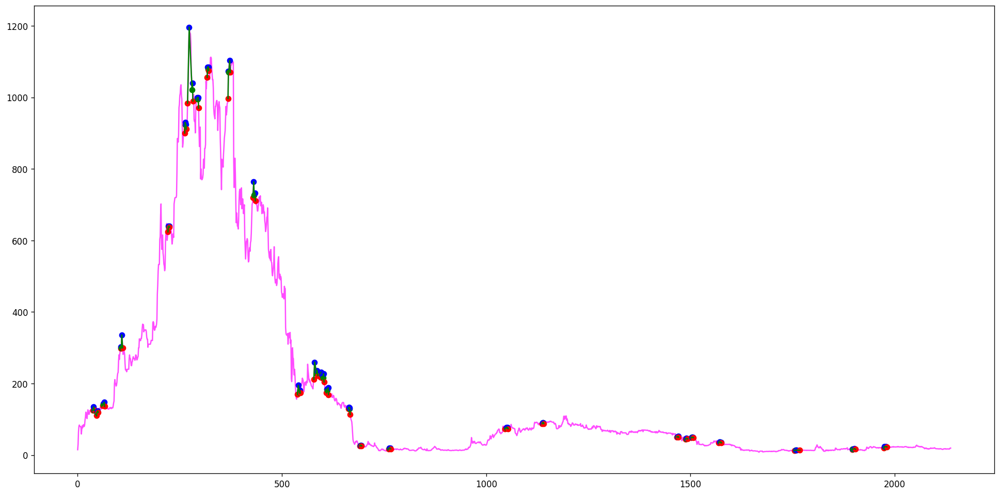

[(98, 106, 107, 112, 121)]
[]
Ticker AAME found 1 double top patterns, 0 double bottom patterns


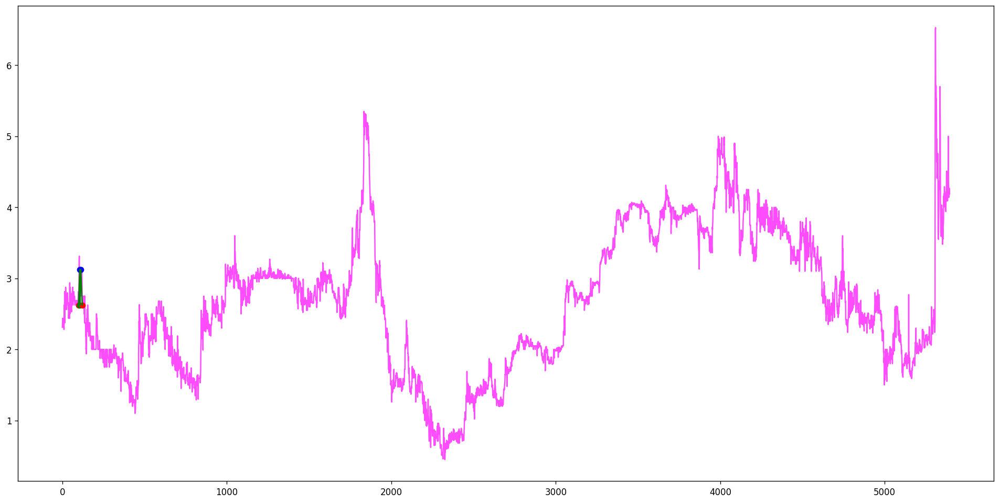

[(80, 82, 83, 87, 91)]
[]
Ticker AAN found 1 double top patterns, 0 double bottom patterns


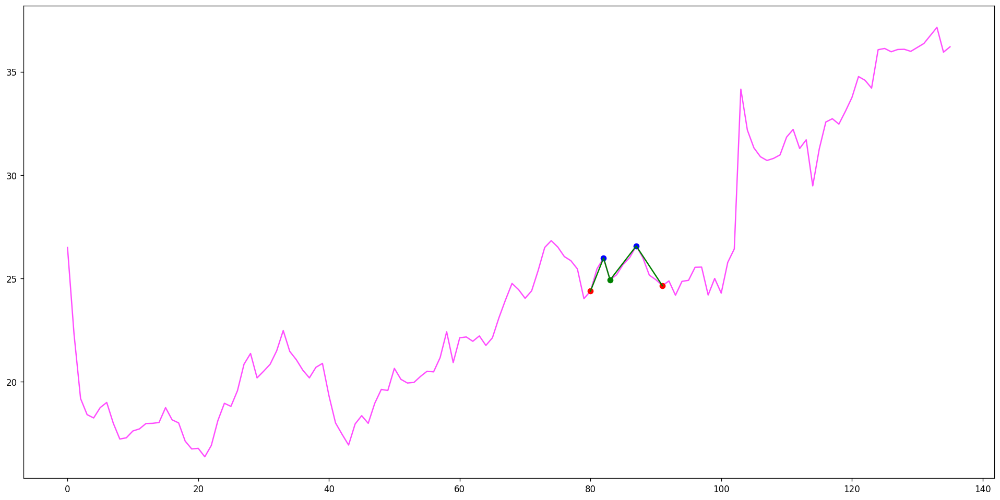

[(22, 23, 24, 29, 35), (863, 864, 865, 866, 869), (879, 880, 883, 884, 885), (876, 877, 878, 880, 886), (910, 911, 912, 913, 914), (926, 927, 928, 929, 930), (983, 984, 987, 988, 990), (1085, 1086, 1087, 1088, 1089), (1094, 1095, 1097, 1098, 1099), (1205, 1206, 1207, 1208, 1209)]
[]
Ticker AAOI found 10 double top patterns, 0 double bottom patterns


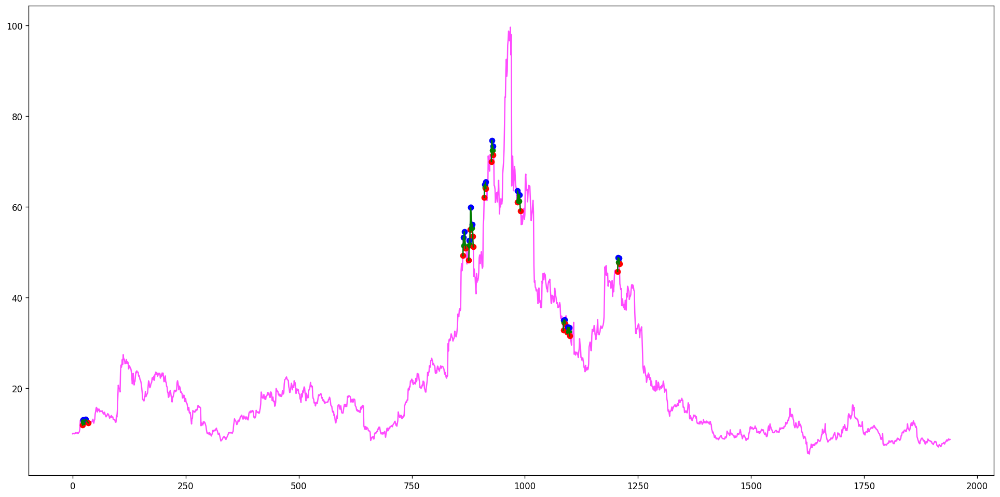

[(107, 108, 112, 114, 122), (1009, 1012, 1013, 1015, 1016), (1310, 1311, 1313, 1317, 1318), (1703, 1704, 1705, 1706, 1708), (1714, 1718, 1719, 1721, 1723), (1742, 1743, 1744, 1745, 1746), (1804, 1806, 1808, 1810, 1811), (1841, 1842, 1845, 1846, 1847), (1863, 1864, 1865, 1866, 1867), (1928, 1929, 1930, 1931, 1932), (2111, 2114, 2115, 2117, 2118), (2675, 2677, 2681, 2682, 2683), (2749, 2750, 2751, 2752, 2754), (2918, 2919, 2923, 2924, 2925), (2942, 2943, 2944, 2945, 2947), (2976, 2979, 2981, 2982, 2984), (3030, 3031, 3033, 3034, 3035), (3165, 3166, 3168, 3169, 3170), (3232, 3233, 3235, 3236, 3238), (3249, 3250, 3251, 3256, 3258), (3278, 3279, 3280, 3283, 3284), (3347, 3348, 3349, 3350, 3351), (3476, 3477, 3478, 3479, 3480), (3504, 3505, 3506, 3508, 3510), (3585, 3586, 3587, 3588, 3590), (3622, 3623, 3624, 3626, 3627), (3766, 3767, 3768, 3769, 3770), (3787, 3788, 3789, 3791, 3793), (4139, 4141, 4143, 4144, 4145), (4186, 4187, 4188, 4189, 4190), (4328, 4329, 4330, 4332, 4334), (4337, 4338,

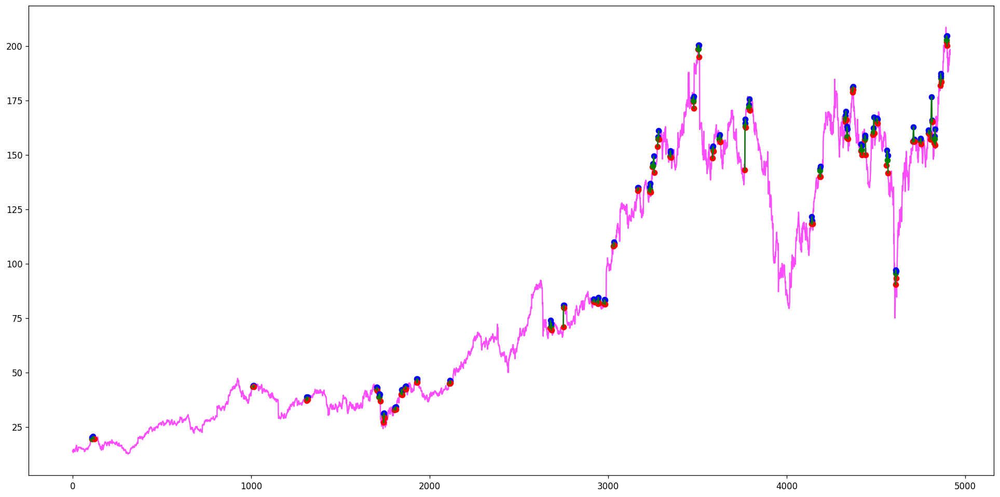

[(2205, 2207, 2213, 2220, 2229), (2930, 2933, 2936, 2947, 2957), (3193, 3201, 3204, 3205, 3207), (3285, 3287, 3291, 3292, 3308), (3705, 3706, 3713, 3715, 3718), (3865, 3870, 3871, 3872, 3878), (4029, 4031, 4032, 4033, 4034), (4042, 4043, 4045, 4047, 4048), (4701, 4702, 4703, 4704, 4706), (4756, 4757, 4759, 4760, 4761), (5100, 5101, 5102, 5103, 5104), (5126, 5127, 5128, 5129, 5130), (5149, 5150, 5151, 5152, 5153), (5180, 5181, 5182, 5183, 5184), (5216, 5217, 5218, 5220, 5221), (5276, 5280, 5284, 5285, 5286)]
[]
Ticker AAPL found 16 double top patterns, 0 double bottom patterns


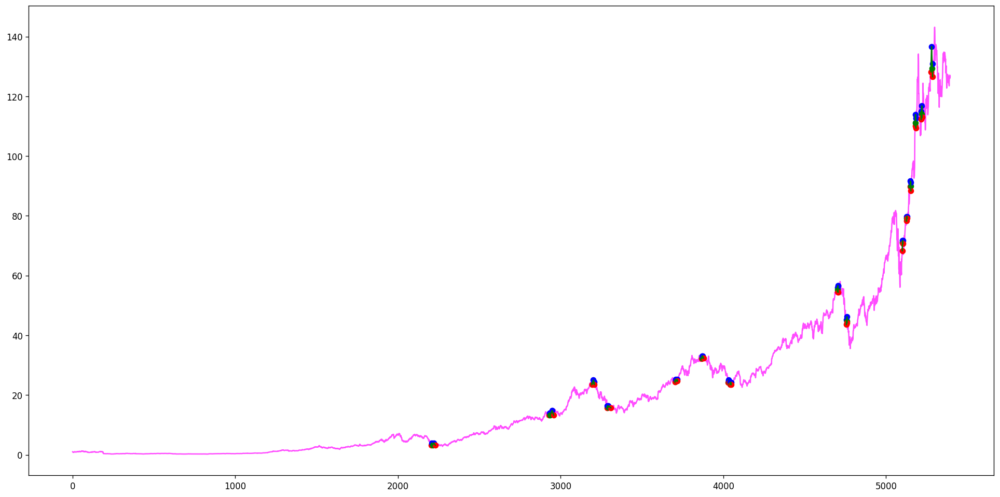

[(3999, 4005, 4008, 4017, 4024), (3999, 4005, 4008, 4019, 4024)]
[]
Ticker AASP found 2 double top patterns, 0 double bottom patterns


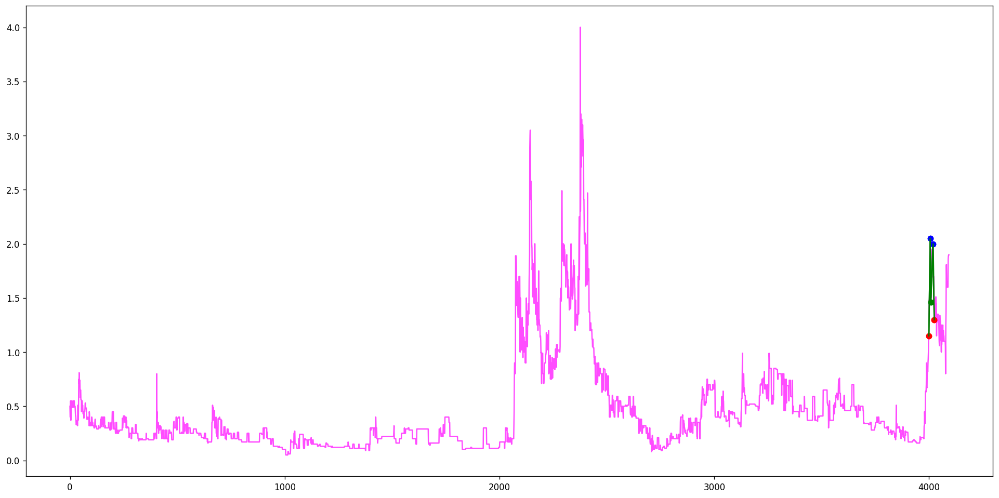

[(414, 415, 419, 422, 425), (621, 636, 639, 643, 645), (712, 714, 718, 719, 722), (775, 779, 785, 787, 790), (972, 975, 976, 982, 986), (1237, 1239, 1241, 1247, 1250), (1523, 1525, 1526, 1529, 1545), (1635, 1638, 1641, 1644, 1655), (1664, 1665, 1667, 1675, 1676), (1871, 1873, 1878, 1881, 1883), (2007, 2008, 2012, 2015, 2017), (2168, 2184, 2187, 2190, 2192), (2295, 2296, 2297, 2298, 2300), (2323, 2324, 2325, 2326, 2327), (2503, 2505, 2506, 2508, 2509), (2564, 2566, 2567, 2568, 2569)]
[]
Ticker AAT found 16 double top patterns, 0 double bottom patterns


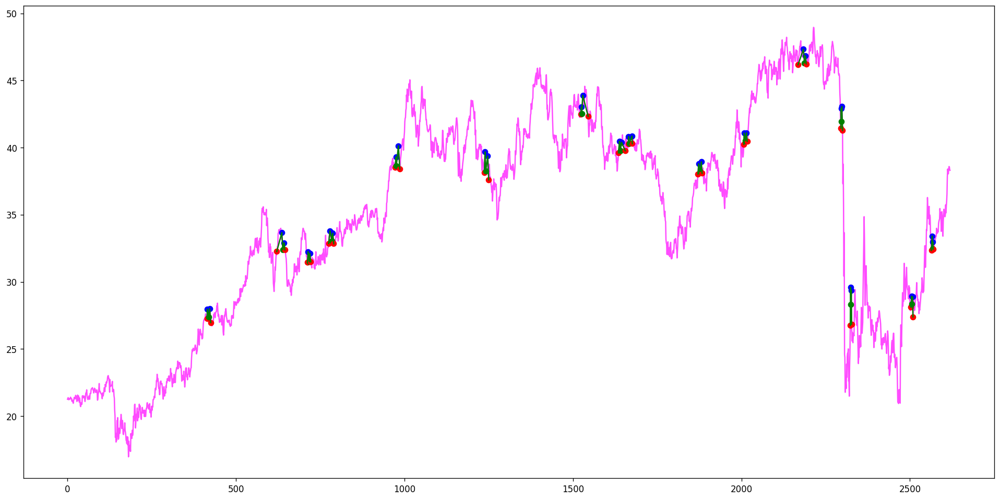

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(402, 403, 404, 405, 406), (484, 485, 486, 488, 489), (773, 774, 775, 776, 778), (930, 931, 932, 933, 941), (1034, 1038, 1039, 1040, 1041), (1262, 1263, 1264, 1265, 1266), (1641, 1642, 1643, 1644, 1645), (1779, 1780, 1783, 1784, 1785), (1883, 1885, 1886, 1887, 1888), (1895, 1896, 1897, 1899, 1900), (2102, 2103, 2104, 2105, 2107), (2221, 2224, 2225, 2226, 2227)]
[]
Ticker AATRL found 12 double top patterns, 0 double bottom patterns


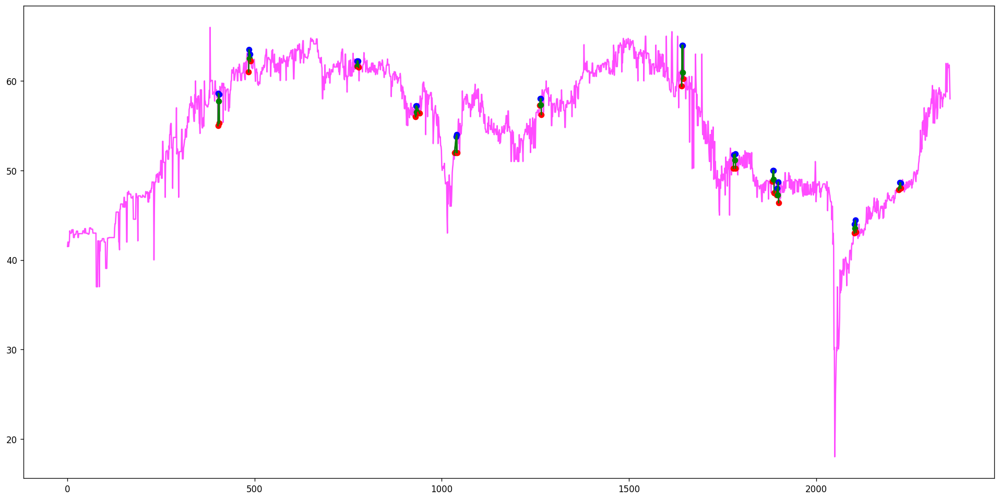

[(260, 268, 274, 279, 282), (509, 519, 522, 525, 535), (582, 584, 585, 589, 595), (944, 946, 951, 953, 956), (1074, 1078, 1081, 1083, 1085), (1098, 1101, 1103, 1106, 1117), (1373, 1379, 1382, 1385, 1387), (1905, 1910, 1912, 1914, 1926)]
[]
Ticker AAVVF found 8 double top patterns, 0 double bottom patterns


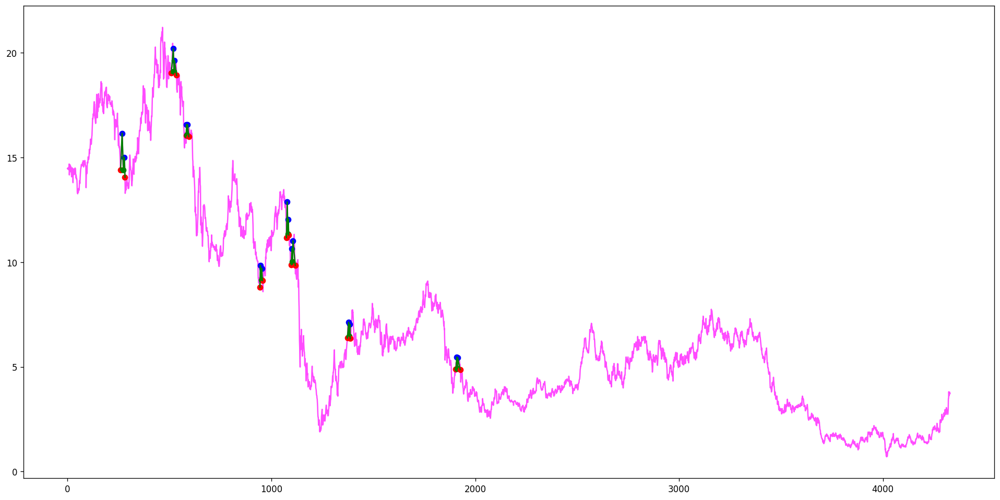

[(309, 310, 315, 316, 317)]
[]
Ticker AAVXF found 1 double top patterns, 0 double bottom patterns


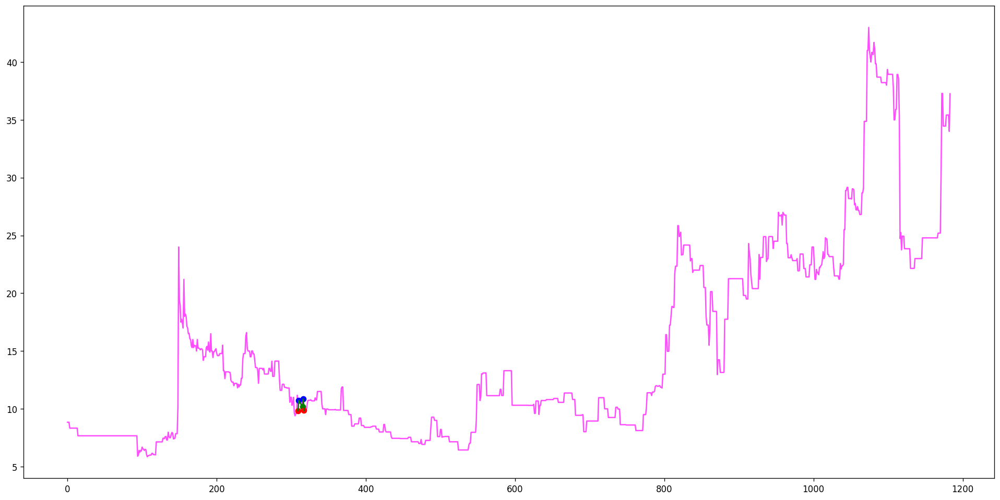

[(54, 56, 58, 65, 66), (378, 379, 380, 383, 384), (417, 419, 420, 422, 424), (545, 546, 547, 548, 549), (584, 585, 586, 587, 588), (911, 912, 914, 915, 916), (953, 954, 955, 956, 958), (1043, 1044, 1045, 1051, 1055), (1243, 1244, 1245, 1249, 1251), (1492, 1493, 1494, 1495, 1496), (1505, 1507, 1509, 1510, 1511), (1527, 1528, 1529, 1530, 1531), (1662, 1663, 1665, 1666, 1667), (1695, 1697, 1698, 1699, 1701), (1773, 1775, 1780, 1783, 1785), (1860, 1861, 1863, 1866, 1867), (2077, 2079, 2081, 2082, 2083), (2167, 2169, 2170, 2175, 2177), (2313, 2314, 2315, 2316, 2318), (2392, 2395, 2399, 2400, 2401), (2402, 2403, 2404, 2405, 2406), (2430, 2431, 2432, 2433, 2434), (2630, 2632, 2634, 2635, 2636), (2788, 2790, 2791, 2792, 2793), (2841, 2842, 2843, 2844, 2846), (3046, 3051, 3056, 3058, 3059), (3128, 3131, 3133, 3134, 3135), (3284, 3285, 3286, 3288, 3289), (3303, 3304, 3305, 3306, 3308), (3416, 3417, 3418, 3419, 3421), (3612, 3614, 3616, 3617, 3618), (3625, 3627, 3628, 3629, 3630), (3843, 3844, 38

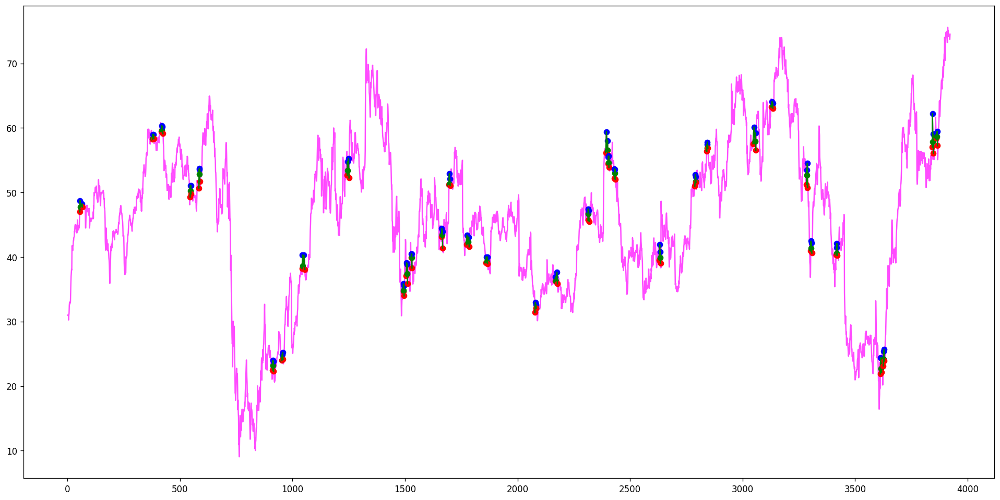

[(50, 51, 52, 56, 58), (169, 170, 171, 173, 174), (178, 179, 180, 181, 182), (272, 273, 276, 277, 279), (578, 579, 583, 587, 588), (784, 785, 786, 787, 788), (1056, 1064, 1066, 1068, 1069), (1232, 1233, 1234, 1237, 1239), (1391, 1392, 1394, 1397, 1400), (1510, 1512, 1514, 1518, 1521), (1543, 1545, 1546, 1547, 1548), (2042, 2044, 2045, 2047, 2048), (2091, 2094, 2096, 2097, 2098), (2142, 2145, 2148, 2149, 2150), (2159, 2162, 2163, 2169, 2177), (2224, 2225, 2226, 2230, 2233), (2557, 2558, 2559, 2560, 2562), (2760, 2763, 2765, 2766, 2767), (2870, 2871, 2873, 2875, 2876), (3090, 3091, 3092, 3093, 3094), (3162, 3163, 3164, 3167, 3168), (3177, 3180, 3181, 3182, 3184)]
[]
Ticker AAXJ found 22 double top patterns, 0 double bottom patterns


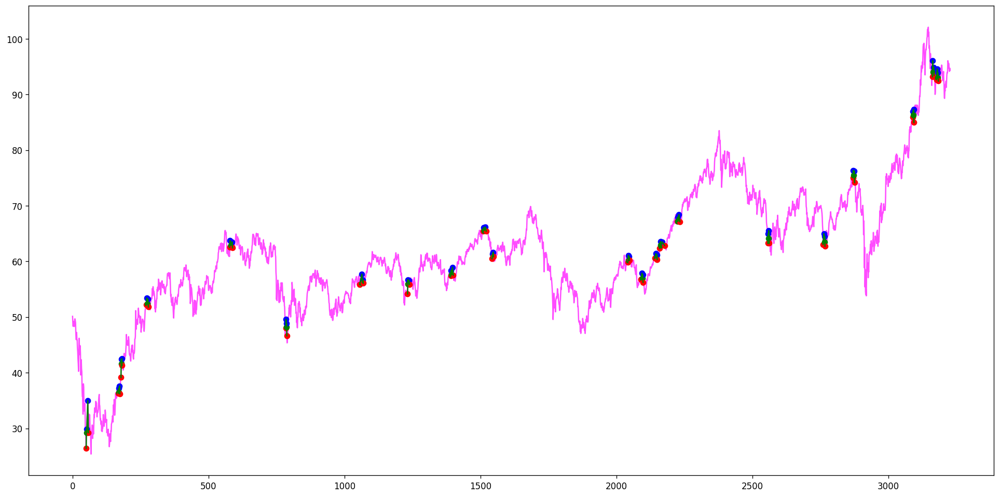

[(407, 413, 418, 423, 431), (542, 550, 560, 564, 567), (1570, 1572, 1576, 1577, 1580), (1635, 1638, 1639, 1641, 1642), (1784, 1787, 1789, 1790, 1798), (1784, 1793, 1798, 1799, 1800), (1998, 1999, 2000, 2002, 2003), (2010, 2017, 2018, 2020, 2024), (2089, 2091, 2097, 2099, 2101), (2210, 2213, 2215, 2217, 2219), (2292, 2293, 2296, 2297, 2303), (2323, 2326, 2327, 2330, 2331), (2534, 2539, 2540, 2544, 2546), (2955, 2957, 2965, 2970, 2976), (3016, 3020, 3021, 3022, 3023), (3096, 3106, 3111, 3113, 3115), (3722, 3725, 3727, 3729, 3734), (4791, 4794, 4799, 4801, 4805), (5017, 5019, 5021, 5023, 5024)]
[]
Ticker ABB found 19 double top patterns, 0 double bottom patterns


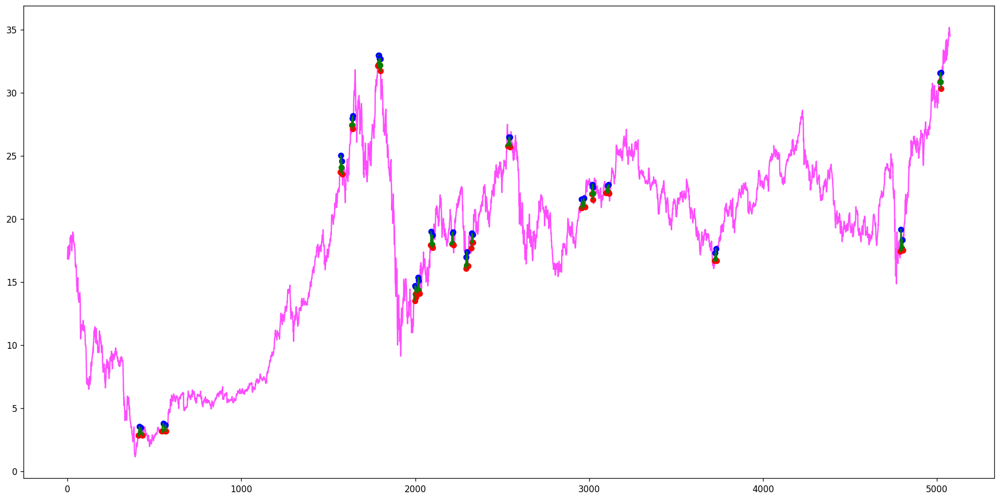

[(131, 132, 134, 138, 140), (434, 435, 436, 437, 439), (580, 581, 582, 583, 585), (645, 646, 650, 652, 653), (715, 716, 717, 718, 720), (794, 795, 796, 799, 800), (817, 818, 819, 820, 822), (1139, 1141, 1143, 1146, 1150), (1261, 1262, 1263, 1264, 1266), (1290, 1291, 1294, 1296, 1298), (1365, 1366, 1367, 1368, 1370), (1445, 1447, 1448, 1449, 1450), (1464, 1465, 1466, 1468, 1469), (1585, 1590, 1593, 1595, 1596), (1763, 1764, 1765, 1767, 1769), (1839, 1841, 1842, 1843, 1844), (1895, 1896, 1897, 1898, 1899), (1946, 1950, 1952, 1953, 1954), (1995, 1996, 1997, 1999, 2002), (2049, 2050, 2051, 2053, 2055)]
[]
Ticker ABBV found 20 double top patterns, 0 double bottom patterns


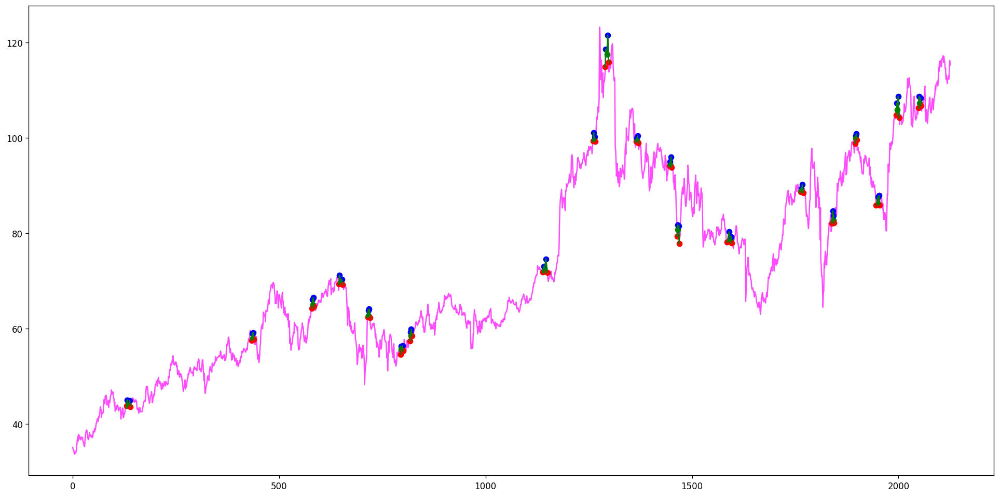

[(283, 290, 291, 294, 299), (431, 435, 445, 451, 455), (607, 609, 611, 616, 619), (660, 661, 662, 666, 668), (692, 693, 695, 697, 701), (1839, 1846, 1848, 1849, 1850), (1986, 1989, 1991, 1994, 1998), (2206, 2207, 2209, 2213, 2217), (2356, 2366, 2371, 2373, 2376), (2566, 2568, 2572, 2574, 2576), (2614, 2615, 2617, 2619, 2620), (3075, 3076, 3078, 3080, 3082), (3069, 3072, 3074, 3076, 3084), (3227, 3228, 3230, 3232, 3235), (3354, 3356, 3359, 3361, 3362), (3456, 3457, 3459, 3460, 3462), (3662, 3665, 3666, 3668, 3670), (3807, 3809, 3811, 3815, 3816), (3908, 3909, 3910, 3911, 3912), (4071, 4072, 4074, 4075, 4076), (4083, 4084, 4086, 4087, 4088), (4235, 4236, 4238, 4239, 4240), (4261, 4262, 4263, 4264, 4265), (4301, 4303, 4305, 4307, 4308), (4603, 4604, 4605, 4608, 4610), (4677, 4678, 4679, 4680, 4681), (4790, 4791, 4794, 4796, 4798), (4889, 4891, 4892, 4895, 4897), (4929, 4930, 4932, 4933, 4934), (4948, 4951, 4952, 4953, 4954), (5081, 5082, 5083, 5084, 5085), (5117, 5118, 5119, 5120, 5122), 

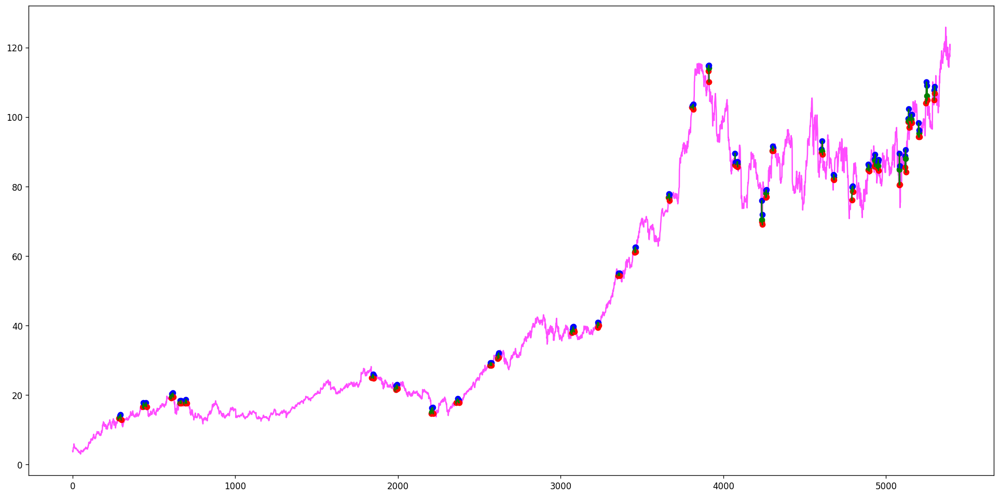

[(1079, 1083, 1092, 1094, 1097), (1247, 1250, 1251, 1252, 1255), (1422, 1430, 1433, 1434, 1437), (1653, 1656, 1661, 1663, 1668), (2241, 2243, 2244, 2246, 2247), (2316, 2317, 2318, 2320, 2321), (2329, 2331, 2332, 2335, 2336), (2586, 2596, 2601, 2604, 2610), (2897, 2916, 2917, 2918, 2919), (2972, 2974, 2977, 2979, 2991), (3626, 3629, 3634, 3635, 3639), (3680, 3683, 3690, 3695, 3698), (3736, 3739, 3744, 3748, 3750), (4436, 4440, 4443, 4445, 4446), (4504, 4506, 4507, 4509, 4510), (4558, 4560, 4561, 4562, 4563), (4847, 4849, 4850, 4851, 4854), (5047, 5048, 5049, 5050, 5051), (5224, 5225, 5226, 5227, 5228), (5291, 5292, 5293, 5295, 5296), (5340, 5341, 5342, 5343, 5344), (5374, 5375, 5378, 5380, 5381)]
[]
Ticker ABCB found 22 double top patterns, 0 double bottom patterns


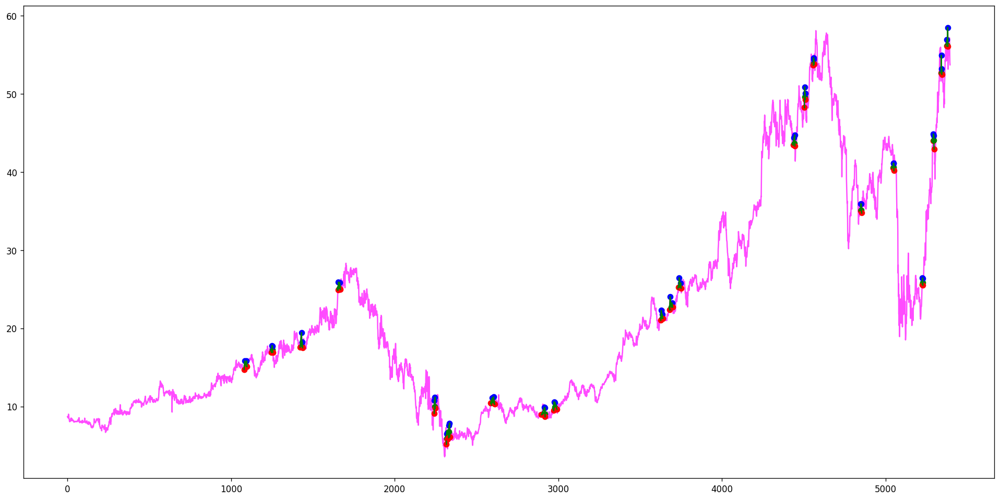

[(90, 91, 92, 93, 94)]
[]
Ticker ABCL found 1 double top patterns, 0 double bottom patterns


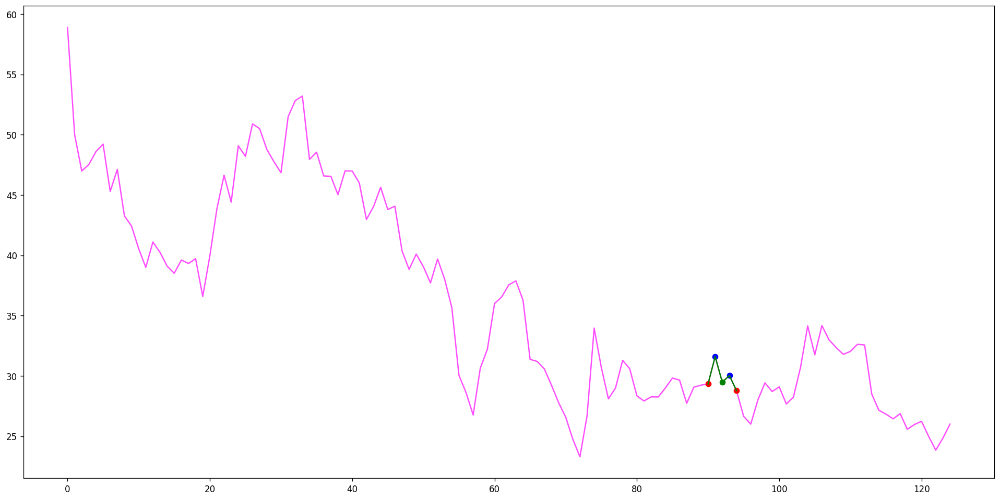

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(41, 43, 45, 46, 50), (60, 61, 62, 63, 65), (60, 63, 65, 67, 69), (56, 58, 60, 67, 70), (120, 121, 122, 123, 124), (127, 129, 132, 133, 134), (172, 173, 176, 177, 178), (183, 184, 185, 186, 189), (185, 186, 187, 188, 189), (183, 186, 191, 192, 197), (191, 192, 194, 195, 197), (212, 213, 214, 215, 216), (208, 211, 212, 213, 218), (202, 203, 206, 213, 219), (219, 220, 221, 222, 224), (236, 240, 242, 243, 245), (246, 247, 248, 249, 250), (267, 268, 269, 270, 272), (273, 274, 275, 276, 277), (291, 294, 296, 298, 299), (324, 325, 327, 328, 329), (346, 347, 350, 351, 352), (383, 384, 385, 386, 387), (383, 386, 387, 389, 392), (399, 400, 402, 404, 408), (423, 425, 426, 427, 428), (432, 433, 434, 435, 437), (471, 476, 480, 481, 483), (508, 510, 512, 513, 514), (506, 507, 508, 510, 517), (543, 544, 546, 547, 548), (538, 542, 543, 544, 549), (558, 559, 560, 561, 562), (575, 578, 581, 582, 585), (591, 592, 593, 594, 595), (608, 609, 611, 612, 613), (627, 629, 633, 634, 635), (626, 629, 635, 637,

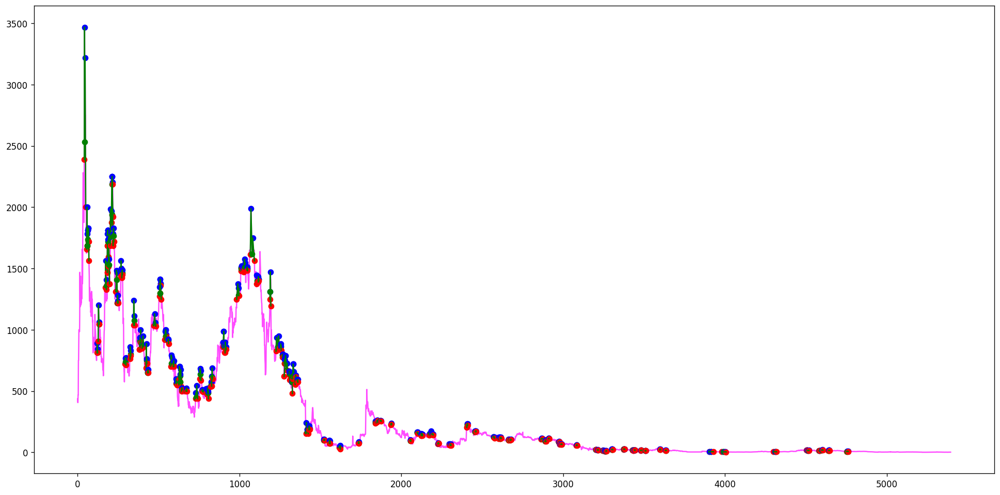

[(3725, 3731, 3741, 3746, 3752)]
[]
Ticker ABEV found 1 double top patterns, 0 double bottom patterns


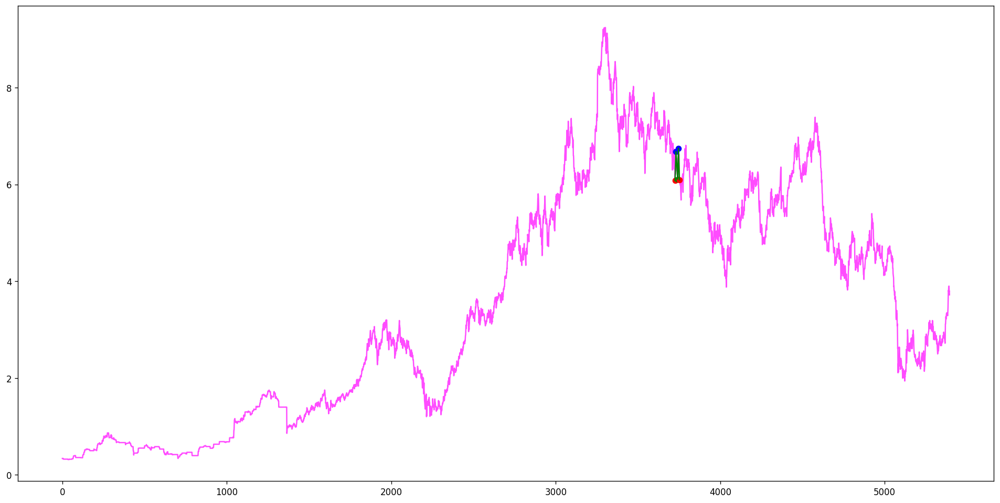

[(32, 34, 36, 37, 39), (506, 515, 517, 518, 519), (617, 624, 626, 628, 631), (932, 933, 934, 941, 943), (1055, 1059, 1066, 1067, 1069), (1100, 1102, 1107, 1110, 1115), (1361, 1363, 1369, 1373, 1377), (1690, 1692, 1697, 1699, 1703), (1801, 1802, 1806, 1807, 1808), (2105, 2106, 2109, 2111, 2113), (2383, 2384, 2386, 2389, 2393), (2544, 2545, 2546, 2548, 2549), (2716, 2717, 2718, 2720, 2721), (2826, 2827, 2828, 2830, 2831), (2903, 2904, 2905, 2906, 2907), (2960, 2963, 2965, 2967, 2968), (3102, 3103, 3106, 3107, 3109), (3159, 3160, 3161, 3162, 3163), (3233, 3234, 3236, 3237, 3238), (3417, 3418, 3419, 3420, 3421), (3593, 3594, 3595, 3596, 3597), (3623, 3624, 3625, 3626, 3628), (3668, 3669, 3671, 3672, 3673), (3843, 3848, 3850, 3851, 3852), (3865, 3866, 3867, 3868, 3869), (4030, 4031, 4032, 4034, 4035), (4056, 4059, 4060, 4062, 4063), (4132, 4134, 4137, 4140, 4141), (4200, 4201, 4202, 4203, 4204), (4227, 4228, 4229, 4230, 4231), (4274, 4276, 4278, 4279, 4280), (4303, 4304, 4305, 4306, 4307), 

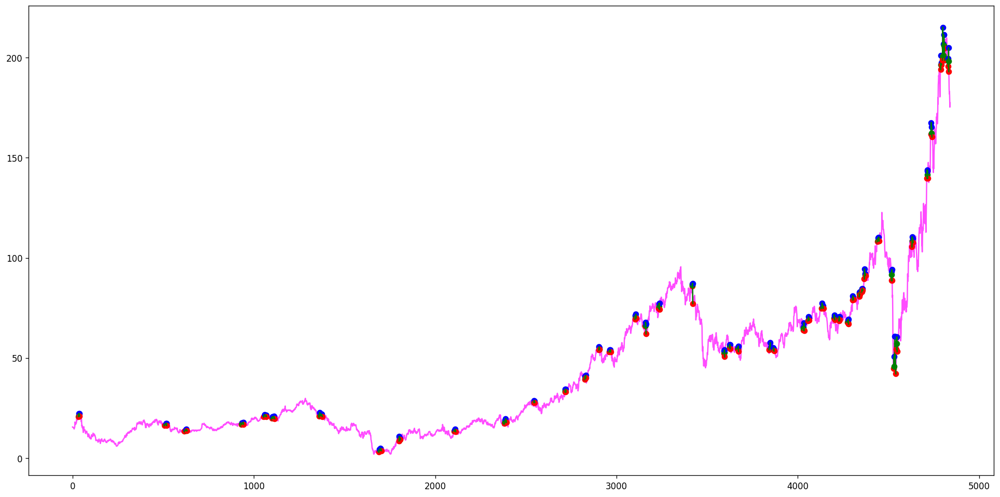

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(51, 52, 53, 56, 59), (81, 82, 83, 86, 88), (80, 82, 89, 93, 98), (106, 108, 109, 110, 114), (115, 116, 117, 118, 120), (128, 132, 134, 136, 137), (128, 132, 137, 138, 140), (122, 125, 127, 132, 141), (145, 146, 147, 148, 152), (145, 148, 153, 155, 157), (162, 165, 167, 169, 171), (162, 169, 171, 172, 173), (162, 169, 174, 177, 178), (179, 180, 182, 184, 186), (197, 199, 200, 201, 202), (203, 204, 205, 206, 208), (209, 210, 212, 213, 217), (264, 266, 269, 271, 275), (264, 271, 275, 276, 278), (282, 283, 284, 285, 286), (309, 310, 312, 313, 315), (320, 322, 324, 325, 328), (332, 335, 336, 339, 343), (336, 337, 338, 339, 343), (348, 349, 350, 351, 352), (345, 346, 347, 349, 353), (368, 371, 372, 373, 374), (382, 385, 386, 393, 394), (389, 390, 391, 393, 394), (396, 397, 398, 400, 402), (394, 400, 408, 409, 410), (420, 421, 424, 425, 426), (443, 444, 445, 446, 447), (441, 442, 443, 444, 448), (448, 451, 452, 454, 455), (448, 454, 455, 458, 459), (455, 456, 457, 458, 459), (472, 474, 477,

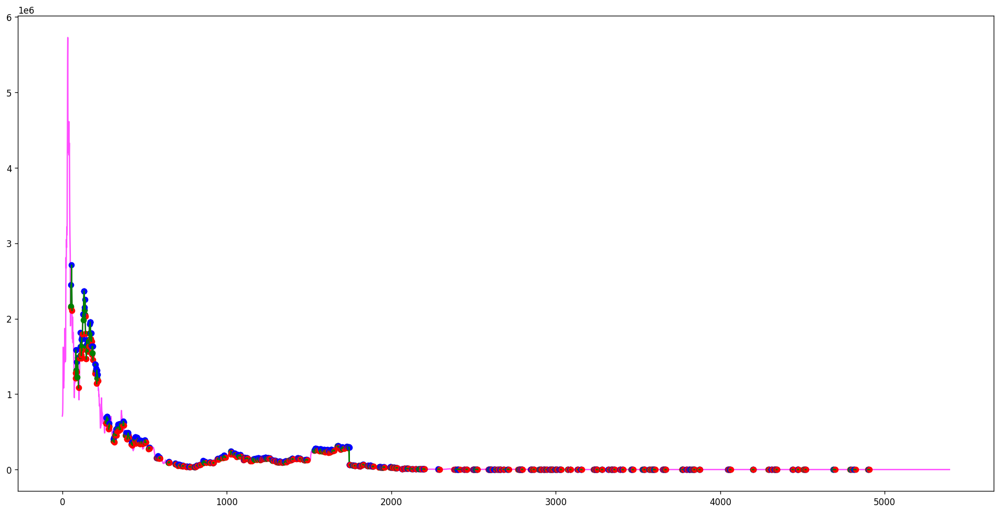

[(3150, 3155, 3156, 3157, 3158), (4785, 4792, 4795, 4796, 4798), (4785, 4793, 4795, 4796, 4798), (4871, 4872, 4873, 4875, 4876), (4917, 4919, 4920, 4922, 4924), (4971, 4974, 4976, 4977, 4978)]
[]
Ticker ABLZF found 6 double top patterns, 0 double bottom patterns


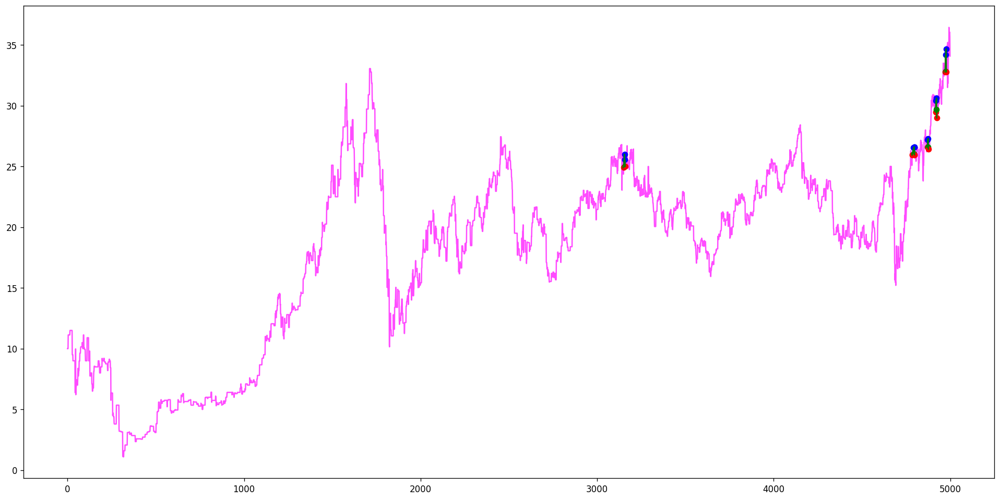

[(489, 490, 493, 497, 500), (655, 661, 662, 663, 664), (906, 912, 914, 923, 925), (1349, 1353, 1355, 1359, 1365), (1478, 1480, 1484, 1487, 1492), (1642, 1644, 1646, 1648, 1650), (1853, 1855, 1857, 1864, 1865), (2024, 2028, 2029, 2030, 2033), (2051, 2052, 2056, 2057, 2058), (2080, 2082, 2083, 2084, 2086), (2138, 2139, 2140, 2141, 2142), (2209, 2210, 2211, 2213, 2215), (2261, 2262, 2266, 2267, 2268), (2316, 2317, 2318, 2320, 2321), (2455, 2458, 2459, 2463, 2465), (2587, 2595, 2596, 2597, 2600), (2793, 2796, 2797, 2800, 2802), (2888, 2899, 2902, 2905, 2908), (2950, 2952, 2953, 2954, 2956), (2969, 2971, 2972, 2974, 2977), (3876, 3877, 3880, 3883, 3899), (4205, 4207, 4212, 4214, 4215), (4635, 4636, 4637, 4640, 4648), (4635, 4636, 4637, 4642, 4648), (4852, 4855, 4857, 4860, 4861), (4869, 4872, 4874, 4876, 4877), (4978, 4982, 4984, 4986, 4989), (5079, 5080, 5081, 5082, 5083), (5146, 5147, 5148, 5149, 5150), (5166, 5167, 5168, 5169, 5171), (5195, 5200, 5201, 5202, 5203), (5358, 5360, 5363, 536

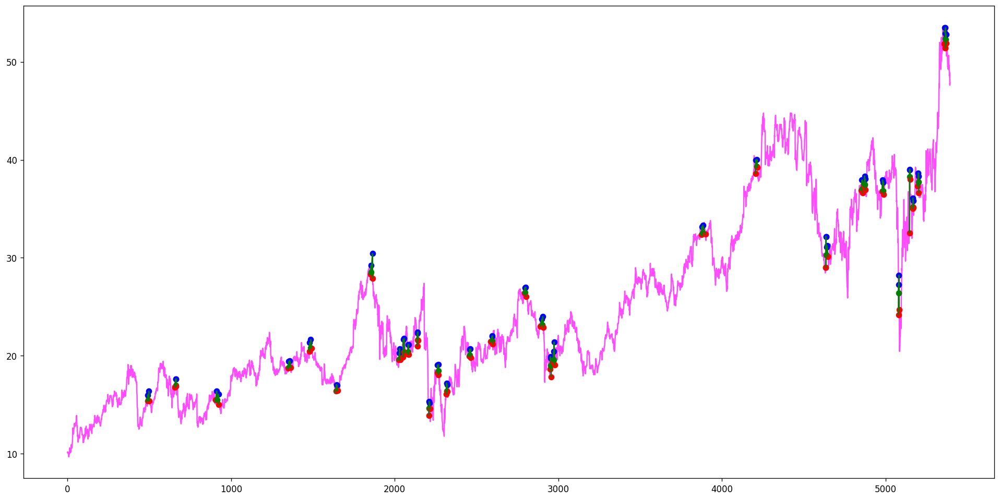

[(12, 14, 15, 18, 20), (51, 52, 53, 55, 58), (94, 95, 98, 100, 102), (133, 135, 136, 139, 140), (246, 247, 248, 249, 251), (279, 280, 281, 282, 284), (386, 387, 388, 390, 391), (551, 552, 554, 560, 562), (1996, 2009, 2012, 2015, 2019), (2060, 2062, 2065, 2068, 2070), (2087, 2088, 2092, 2094, 2097), (2205, 2208, 2209, 2212, 2214), (2249, 2250, 2251, 2252, 2256), (2487, 2489, 2492, 2494, 2501), (2487, 2489, 2492, 2497, 2501), (2550, 2558, 2567, 2574, 2576), (2550, 2560, 2567, 2574, 2576), (2586, 2590, 2593, 2597, 2599), (2984, 2985, 2986, 2987, 2990), (3200, 3201, 3202, 3203, 3204), (3513, 3515, 3517, 3519, 3520), (3608, 3610, 3613, 3615, 3616), (3863, 3864, 3865, 3866, 3868), (3887, 3890, 3893, 3894, 3895), (3926, 3927, 3928, 3929, 3932), (3959, 3960, 3961, 3963, 3964), (4007, 4008, 4009, 4010, 4012), (4088, 4089, 4090, 4091, 4092), (4272, 4273, 4274, 4275, 4276), (4315, 4316, 4317, 4318, 4319), (4467, 4469, 4471, 4474, 4475), (4500, 4501, 4502, 4503, 4504), (4594, 4595, 4596, 4597, 459

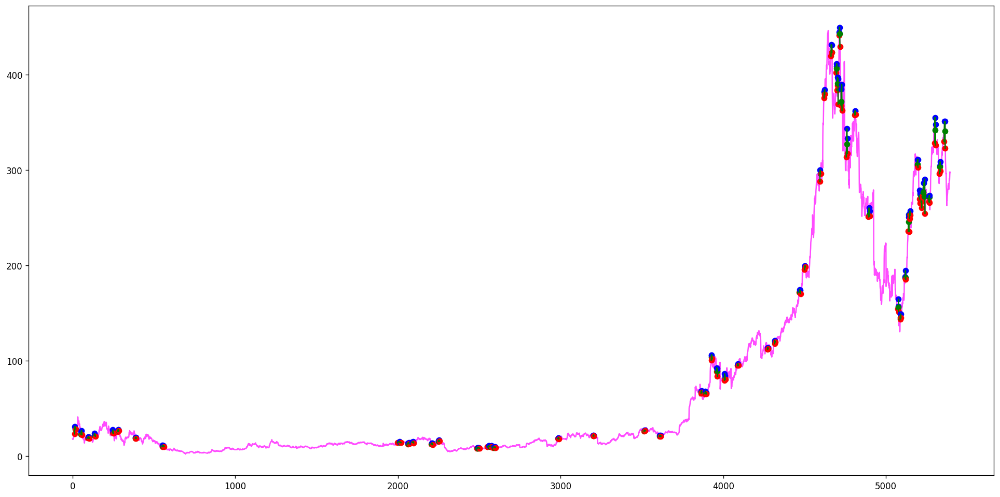

[(1635, 1636, 1637, 1638, 1639), (1665, 1666, 1667, 1668, 1669), (1677, 1678, 1679, 1681, 1682), (1823, 1824, 1826, 1827, 1828), (1919, 1920, 1921, 1922, 1923), (2340, 2342, 2352, 2355, 2356), (2360, 2362, 2363, 2364, 2371), (2413, 2414, 2415, 2417, 2418), (2524, 2526, 2527, 2533, 2534), (2529, 2530, 2531, 2533, 2534), (2603, 2604, 2605, 2609, 2611), (2617, 2620, 2621, 2622, 2631)]
[]
Ticker ABNAF found 12 double top patterns, 0 double bottom patterns


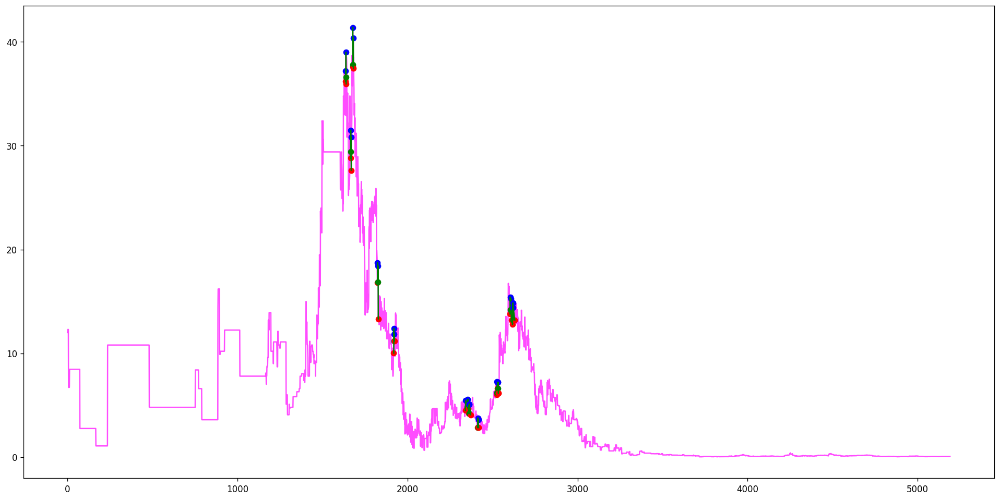

[(21, 23, 24, 25, 26), (38, 39, 40, 42, 46), (38, 42, 46, 47, 48), (35, 42, 51, 52, 55), (61, 63, 64, 65, 66), (89, 94, 97, 98, 99), (107, 109, 111, 112, 113)]
[]
Ticker ABNB found 7 double top patterns, 0 double bottom patterns


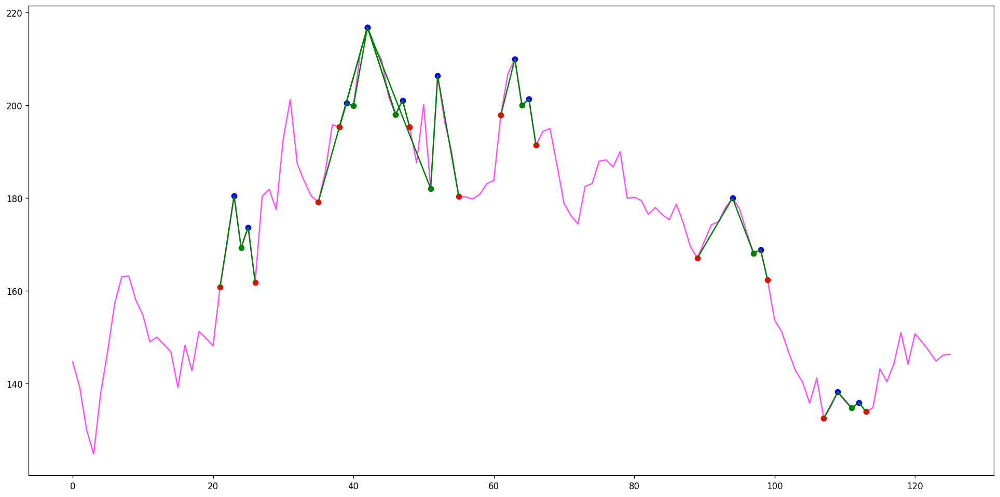

[(579, 584, 585, 586, 588), (739, 745, 747, 749, 752), (834, 835, 838, 839, 841), (1181, 1188, 1190, 1194, 1204), (1517, 1522, 1531, 1534, 1540), (4027, 4029, 4033, 4034, 4035)]
[]
Ticker ABR found 6 double top patterns, 0 double bottom patterns


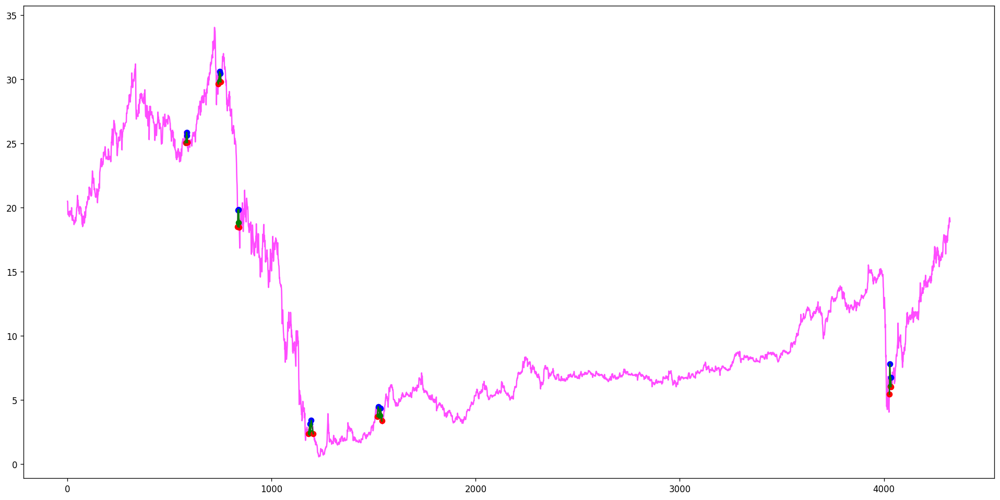

[(3035, 3038, 3044, 3045, 3048)]
[]
Ticker ABST found 1 double top patterns, 0 double bottom patterns


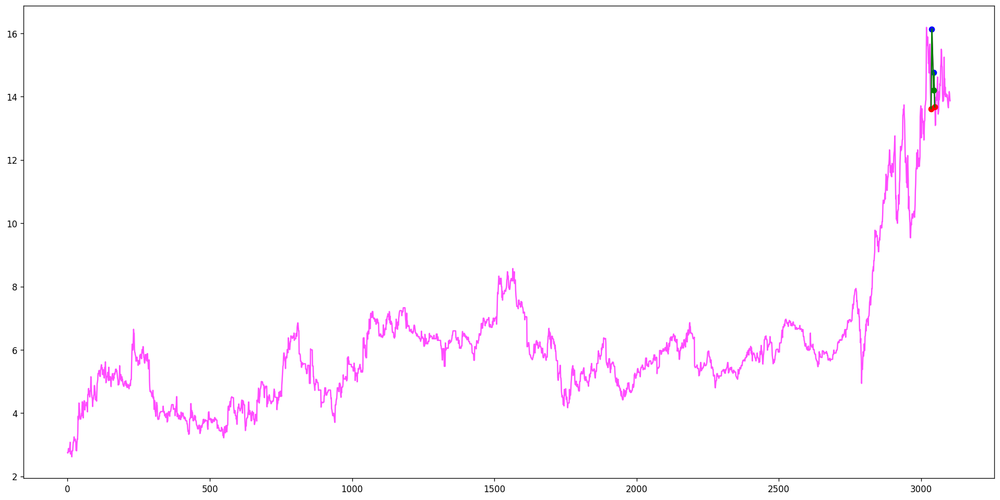

[(72, 77, 85, 88, 91), (284, 286, 290, 292, 295), (310, 313, 315, 319, 328), (395, 397, 404, 408, 417), (509, 513, 518, 520, 524), (680, 684, 686, 690, 692), (1283, 1286, 1290, 1299, 1306), (2058, 2059, 2060, 2064, 2082), (2229, 2230, 2231, 2233, 2234), (2251, 2252, 2254, 2263, 2265), (2283, 2284, 2285, 2288, 2289), (2931, 2934, 2936, 2938, 2940), (2967, 2969, 2972, 2975, 2977), (3555, 3566, 3570, 3572, 3574), (3710, 3712, 3713, 3714, 3717), (4311, 4313, 4315, 4317, 4320), (4309, 4317, 4320, 4323, 4325), (4309, 4323, 4325, 4326, 4330), (4825, 4833, 4834, 4839, 4850), (4904, 4905, 4907, 4910, 4911), (4929, 4931, 4932, 4933, 4934), (5072, 5073, 5074, 5075, 5076), (5126, 5129, 5130, 5133, 5137), (5138, 5139, 5140, 5141, 5142)]
[]
Ticker ABT found 24 double top patterns, 0 double bottom patterns


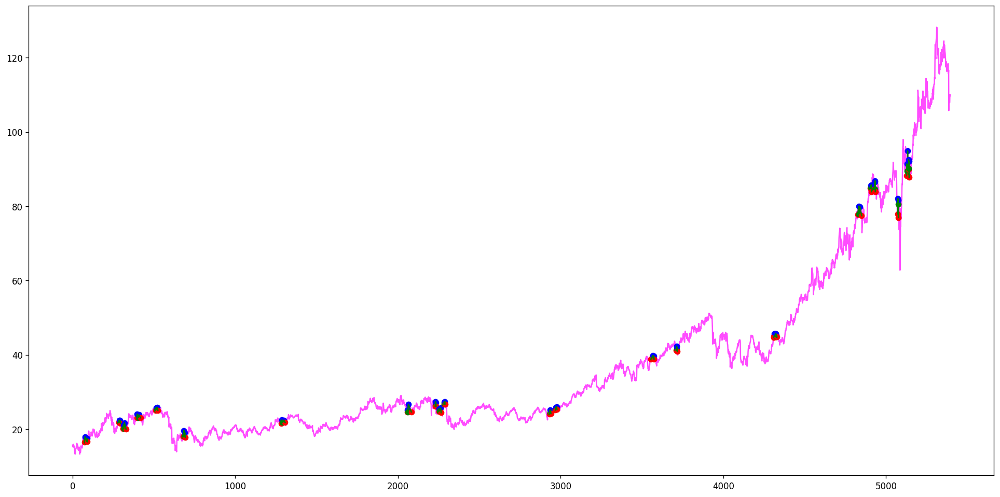

[(257, 258, 261, 263, 265), (435, 437, 438, 440, 441), (715, 717, 721, 723, 725), (1115, 1116, 1117, 1118, 1119), (1120, 1121, 1122, 1123, 1124), (1129, 1130, 1131, 1133, 1136)]
[]
Ticker ABTX found 6 double top patterns, 0 double bottom patterns


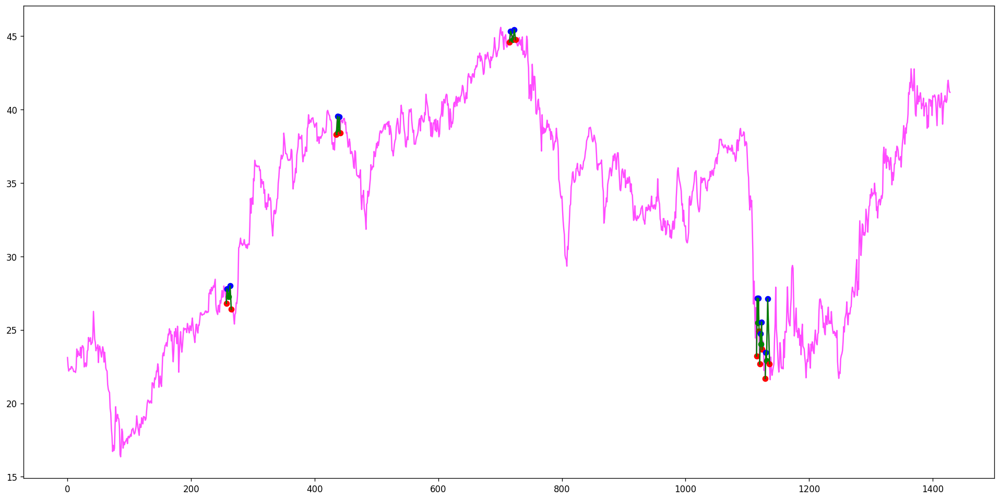

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(214, 216, 218, 219, 220), (229, 230, 231, 232, 237), (231, 232, 235, 236, 237), (244, 245, 246, 249, 250), (260, 261, 262, 263, 266), (277, 278, 279, 280, 281), (291, 292, 293, 294, 295), (314, 315, 316, 317, 318), (344, 347, 349, 350, 351), (341, 342, 344, 347, 353), (366, 368, 369, 370, 371), (362, 363, 364, 368, 375), (375, 376, 379, 380, 381), (398, 399, 401, 402, 403), (396, 399, 405, 408, 414), (426, 428, 431, 433, 434), (421, 423, 426, 428, 435), (450, 451, 452, 454, 456), (482, 483, 484, 485, 486), (499, 500, 501, 503, 504), (518, 521, 523, 524, 527), (523, 524, 525, 526, 527), (579, 580, 581, 584, 586), (581, 582, 583, 584, 586), (579, 584, 586, 587, 588), (591, 592, 593, 594, 596), (633, 634, 636, 637, 638)]
[]
Ticker ABWN found 27 double top patterns, 0 double bottom patterns


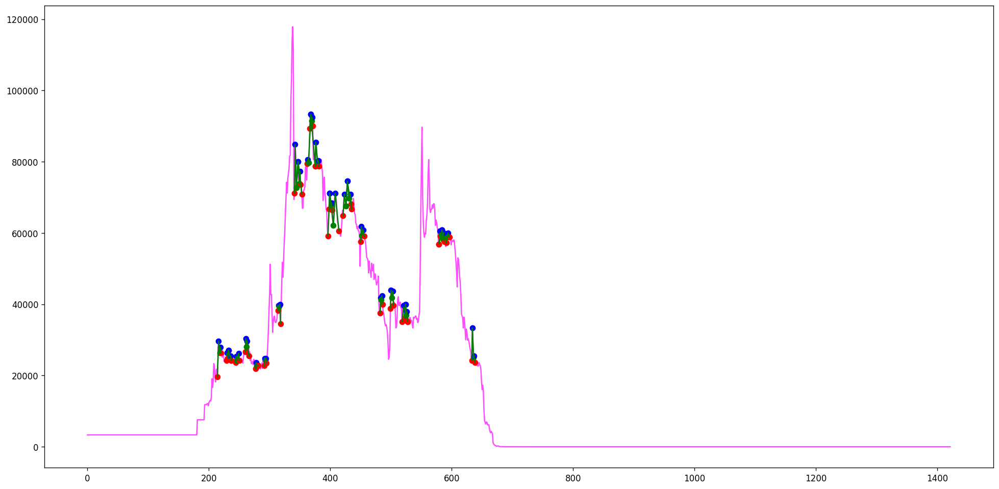

[(293, 295, 296, 300, 303), (338, 339, 340, 341, 342), (515, 517, 518, 519, 520), (619, 620, 622, 623, 624)]
[]
Ticker ACA found 4 double top patterns, 0 double bottom patterns


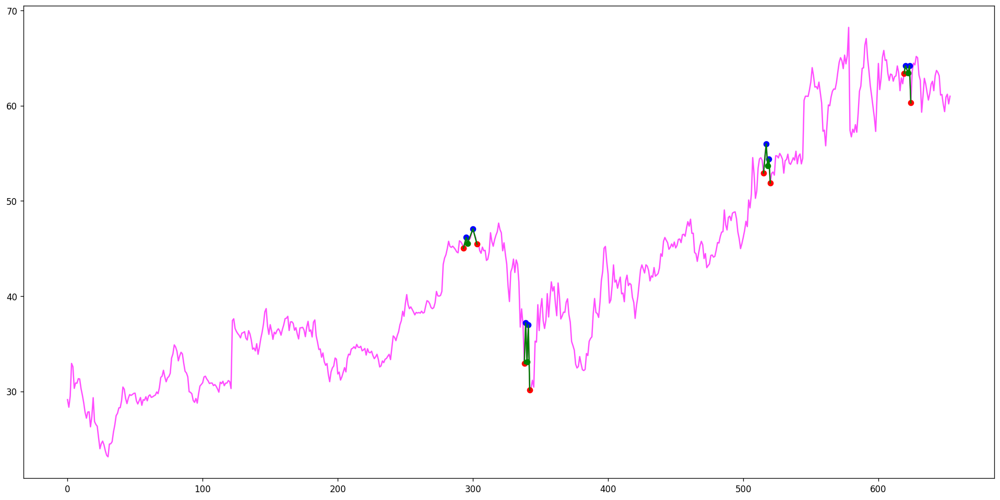

[(15, 20, 24, 28, 31), (24, 28, 31, 33, 37)]
[]
Ticker ACAC found 2 double top patterns, 0 double bottom patterns


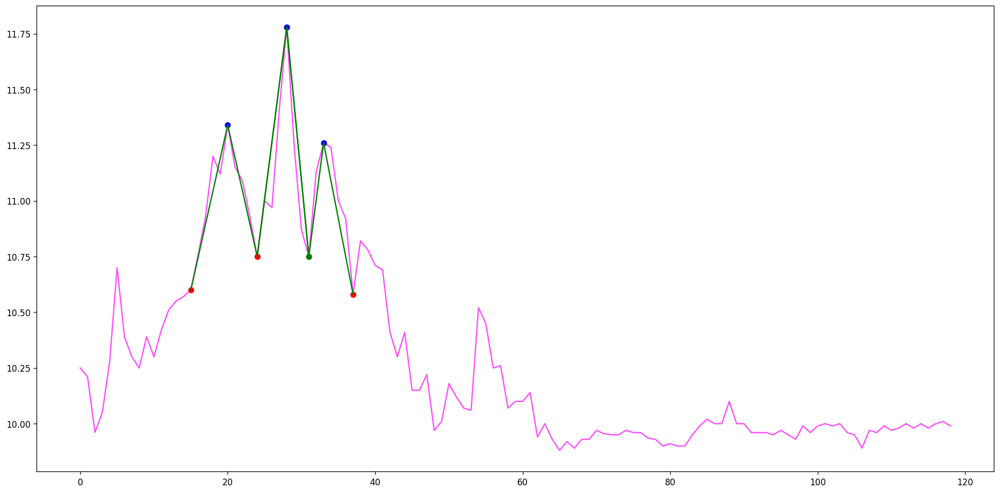

[(564, 566, 567, 570, 572), (613, 616, 621, 624, 630), (710, 711, 712, 713, 714), (715, 716, 717, 719, 720), (831, 834, 840, 841, 842), (2272, 2273, 2275, 2277, 2283), (2323, 2327, 2328, 2330, 2331), (2352, 2353, 2354, 2355, 2356), (2460, 2461, 2462, 2463, 2464), (2495, 2497, 2499, 2500, 2501), (2586, 2587, 2588, 2591, 2592), (2809, 2810, 2812, 2813, 2815), (2949, 2950, 2951, 2953, 2954), (3048, 3049, 3050, 3051, 3052), (3098, 3100, 3104, 3105, 3106), (3247, 3249, 3250, 3253, 3254), (3297, 3298, 3299, 3300, 3301), (3554, 3555, 3557, 3558, 3561), (3651, 3652, 3654, 3655, 3656), (3882, 3883, 3884, 3885, 3887), (3918, 3919, 3920, 3921, 3923), (4059, 4060, 4061, 4063, 4064), (4159, 4160, 4161, 4162, 4163), (4267, 4268, 4269, 4270, 4273)]
[]
Ticker ACAD found 24 double top patterns, 0 double bottom patterns


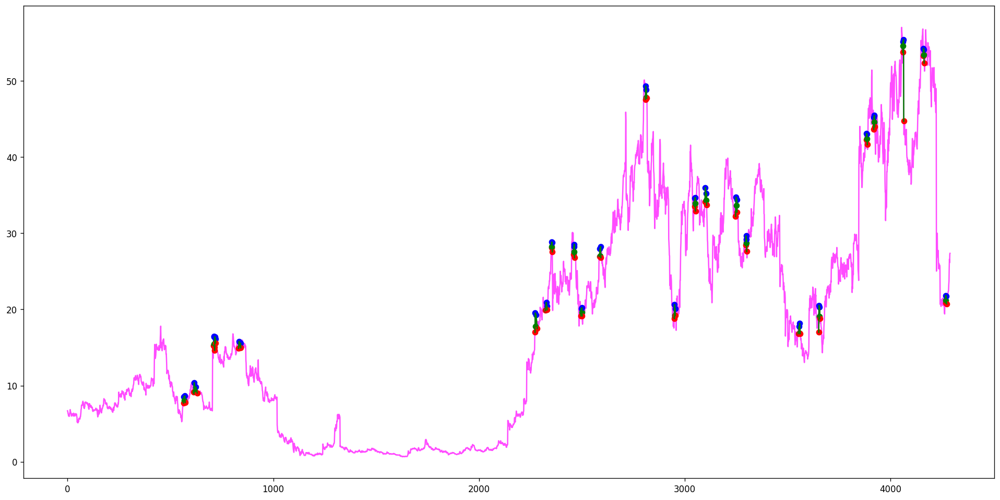

[(689, 690, 691, 692, 693), (801, 803, 804, 806, 810), (813, 814, 815, 816, 817), (874, 875, 876, 878, 881), (885, 888, 890, 891, 892), (943, 945, 946, 948, 949), (954, 955, 956, 960, 961), (969, 970, 971, 972, 973), (1039, 1040, 1042, 1043, 1044), (1054, 1055, 1056, 1058, 1060), (1070, 1072, 1074, 1075, 1076), (1065, 1067, 1070, 1072, 1077), (1083, 1084, 1085, 1089, 1093), (1083, 1089, 1094, 1095, 1097), (1108, 1112, 1113, 1114, 1115), (1124, 1125, 1126, 1128, 1129), (1146, 1147, 1149, 1150, 1152), (1199, 1200, 1201, 1202, 1204), (1281, 1282, 1283, 1284, 1285), (1295, 1296, 1297, 1299, 1300)]
[]
Ticker ACB found 20 double top patterns, 0 double bottom patterns


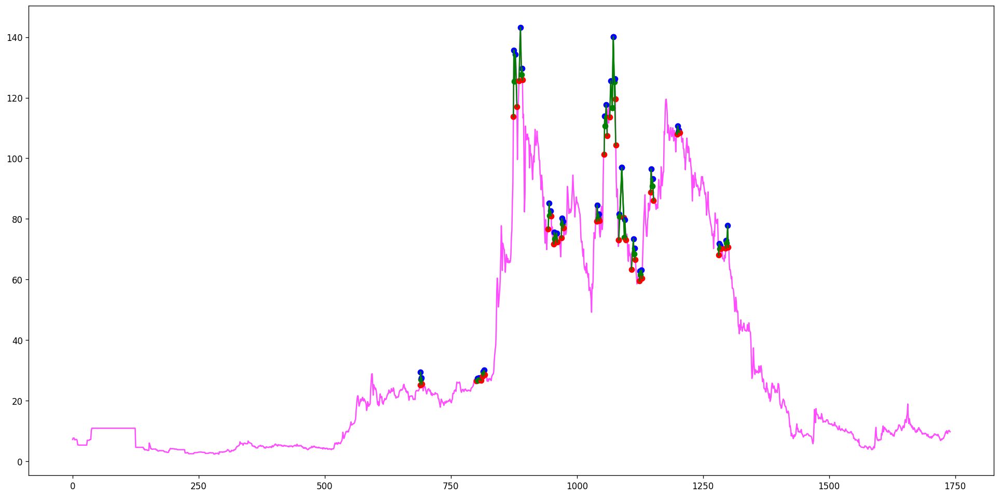

[(296, 300, 303, 309, 312), (854, 866, 871, 873, 875), (854, 869, 871, 873, 875), (1159, 1166, 1168, 1169, 1170), (1251, 1253, 1255, 1260, 1261)]
[]
Ticker ACBI found 5 double top patterns, 0 double bottom patterns


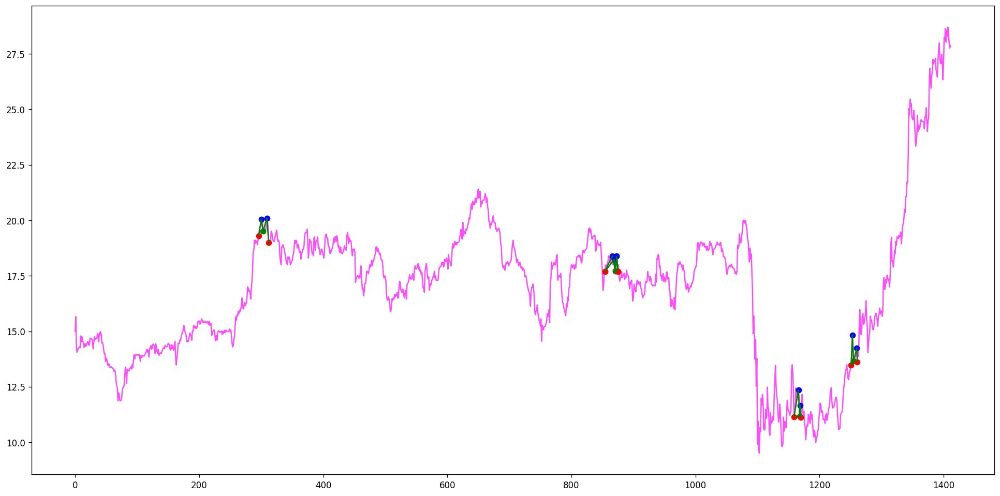

[(154, 161, 164, 165, 167), (235, 241, 247, 250, 251), (645, 646, 647, 649, 651), (902, 903, 905, 908, 910), (1003, 1004, 1006, 1008, 1009), (1085, 1087, 1088, 1089, 1090), (1136, 1137, 1138, 1139, 1141), (1186, 1187, 1188, 1189, 1190), (1194, 1195, 1196, 1197, 1201), (1204, 1206, 1208, 1210, 1213), (1288, 1289, 1290, 1291, 1292), (1297, 1299, 1300, 1301, 1303), (1418, 1419, 1423, 1424, 1428), (1500, 1502, 1504, 1506, 1508), (1706, 1716, 1719, 1720, 1721), (1791, 1793, 1794, 1795, 1796), (1839, 1843, 1844, 1845, 1846), (2169, 2171, 2172, 2175, 2178), (2198, 2200, 2204, 2206, 2207), (2240, 2241, 2244, 2249, 2250), (2443, 2448, 2452, 2456, 2458), (2722, 2724, 2726, 2729, 2734), (2991, 2992, 2994, 2998, 2999), (3213, 3216, 3219, 3223, 3224), (3226, 3238, 3242, 3243, 3244), (3480, 3484, 3485, 3489, 3491), (3680, 3682, 3683, 3685, 3687), (3775, 3778, 3779, 3781, 3782), (4060, 4062, 4064, 4066, 4072), (4075, 4077, 4078, 4079, 4080), (4117, 4118, 4119, 4120, 4122), (4172, 4173, 4174, 4175, 41

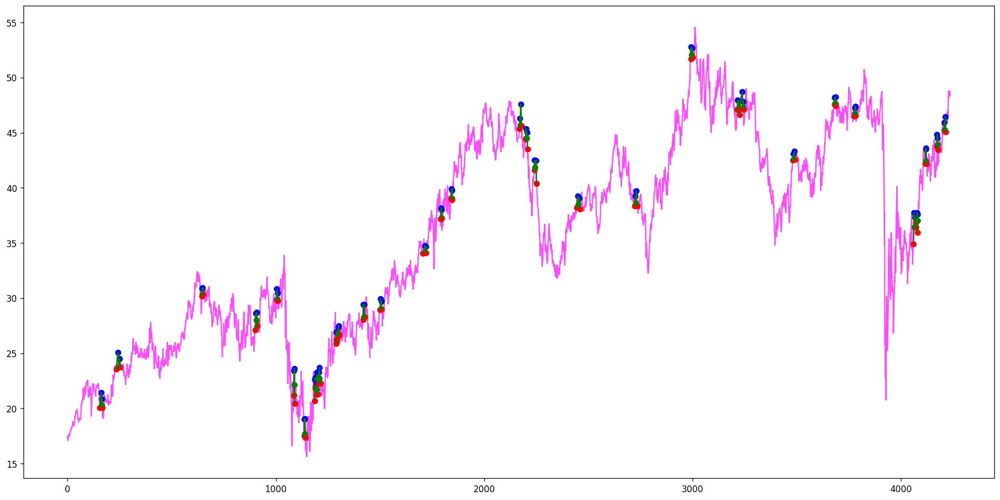

[(16, 17, 18, 19, 21), (23, 25, 26, 27, 28), (175, 176, 177, 178, 179), (227, 228, 229, 231, 232)]
[]
Ticker ACCD found 4 double top patterns, 0 double bottom patterns


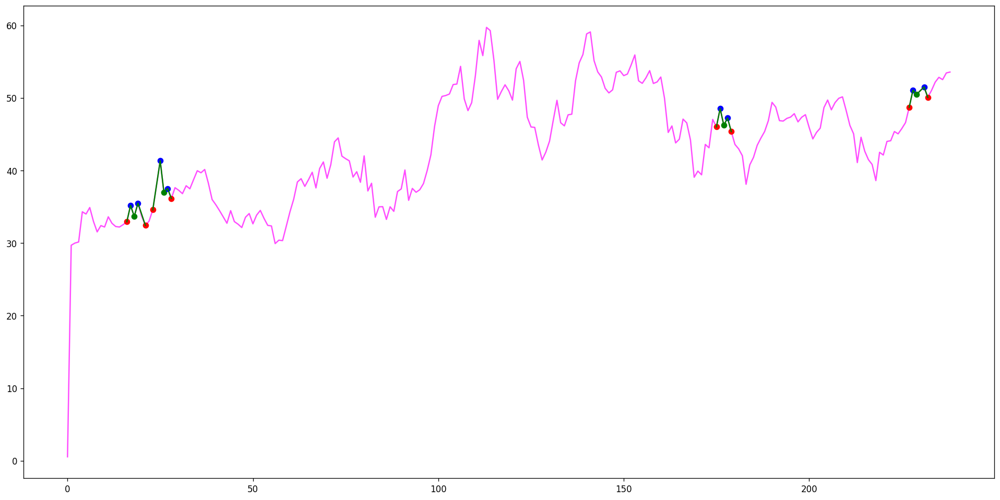

[(55, 61, 62, 65, 83), (723, 725, 729, 734, 741), (805, 811, 813, 815, 817), (1622, 1623, 1627, 1628, 1630)]
[]
Ticker ACDVF found 4 double top patterns, 0 double bottom patterns


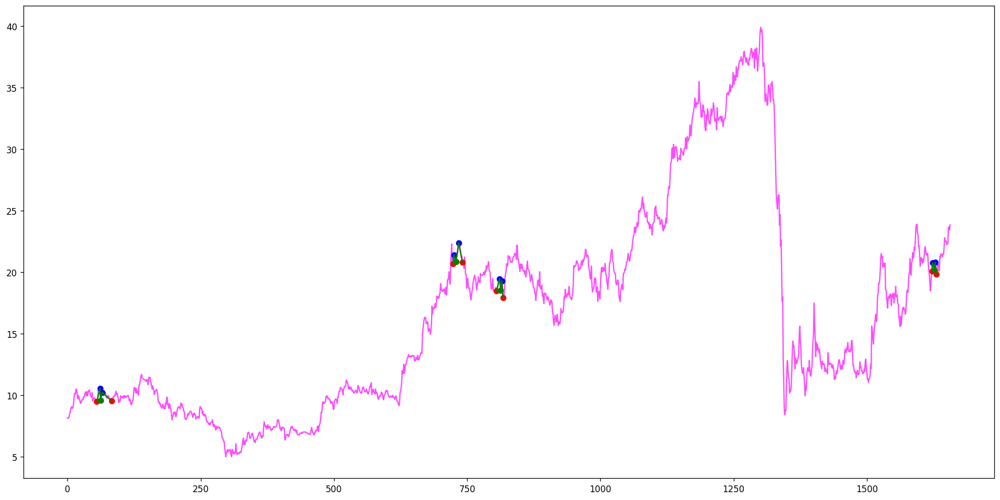

[(194, 197, 198, 199, 200), (194, 197, 200, 201, 202), (222, 223, 224, 225, 226), (275, 276, 277, 278, 279), (291, 292, 293, 295, 296), (411, 412, 414, 415, 416), (471, 472, 473, 474, 475), (523, 524, 528, 530, 531), (533, 534, 535, 536, 540), (535, 536, 537, 538, 540), (546, 548, 549, 552, 553), (614, 617, 620, 621, 622), (614, 617, 623, 624, 625), (612, 613, 614, 617, 626), (642, 643, 644, 645, 646), (646, 648, 651, 652, 653), (663, 664, 665, 667, 668), (642, 645, 646, 648, 669), (700, 701, 706, 708, 709), (747, 748, 750, 751, 752), (747, 748, 753, 755, 759), (754, 755, 757, 758, 759), (764, 765, 766, 767, 768), (791, 792, 793, 794, 795), (798, 800, 801, 802, 803), (834, 835, 837, 838, 840), (830, 832, 834, 838, 843), (837, 838, 840, 841, 843), (856, 857, 858, 859, 860), (860, 861, 862, 863, 864), (864, 865, 866, 869, 871), (883, 884, 885, 886, 887), (887, 889, 890, 891, 892), (883, 886, 887, 889, 893), (924, 925, 927, 928, 929), (933, 935, 936, 938, 939), (978, 980, 982, 986, 987), 

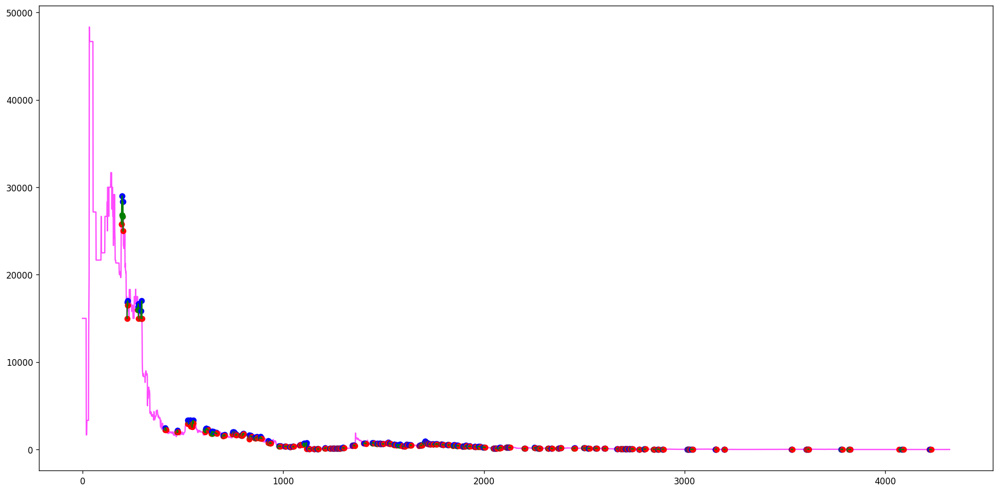

[(85, 93, 96, 98, 100), (491, 493, 494, 498, 499), (677, 678, 679, 680, 681)]
[]
Ticker ACES found 3 double top patterns, 0 double bottom patterns


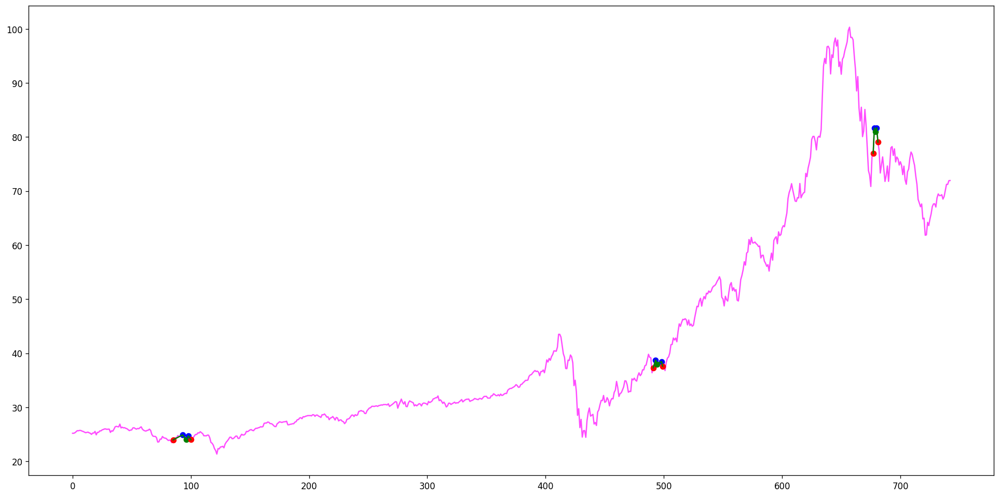

[(123, 124, 125, 128, 131), (125, 128, 129, 130, 131), (186, 187, 188, 190, 191), (196, 197, 198, 199, 200), (216, 217, 218, 222, 224), (231, 232, 233, 234, 235), (279, 280, 281, 285, 286), (301, 302, 303, 304, 305), (301, 304, 305, 306, 307), (332, 333, 334, 335, 337), (459, 461, 467, 470, 475), (621, 622, 623, 624, 625), (630, 631, 632, 635, 637), (705, 706, 707, 708, 709)]
[]
Ticker ACET found 14 double top patterns, 0 double bottom patterns


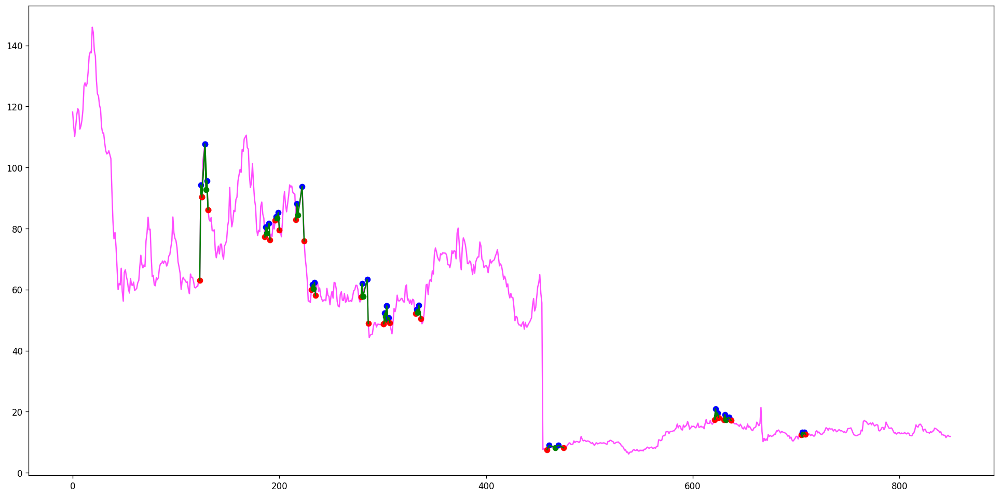

[]
[]
Ticker ACFL found 0 double top patterns, 0 double bottom patterns


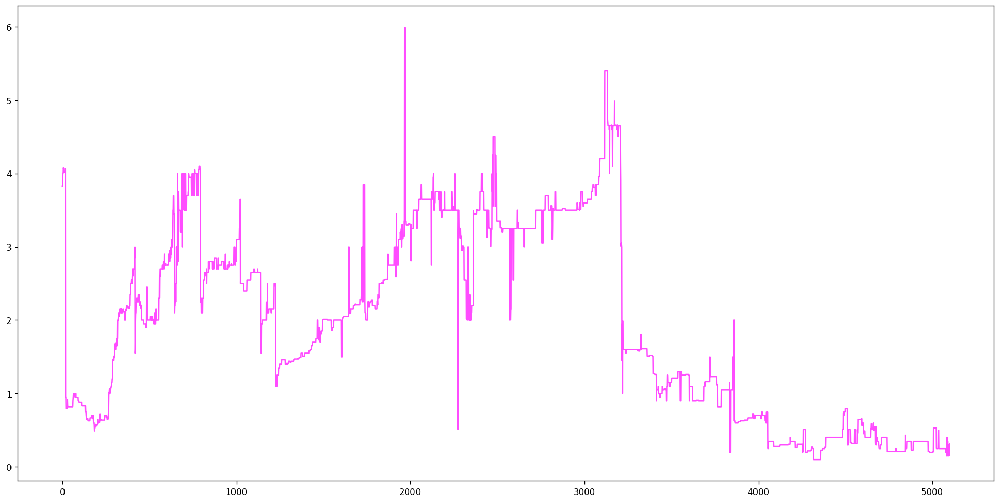

[(352, 362, 373, 376, 379)]
[]
Ticker ACFN found 1 double top patterns, 0 double bottom patterns


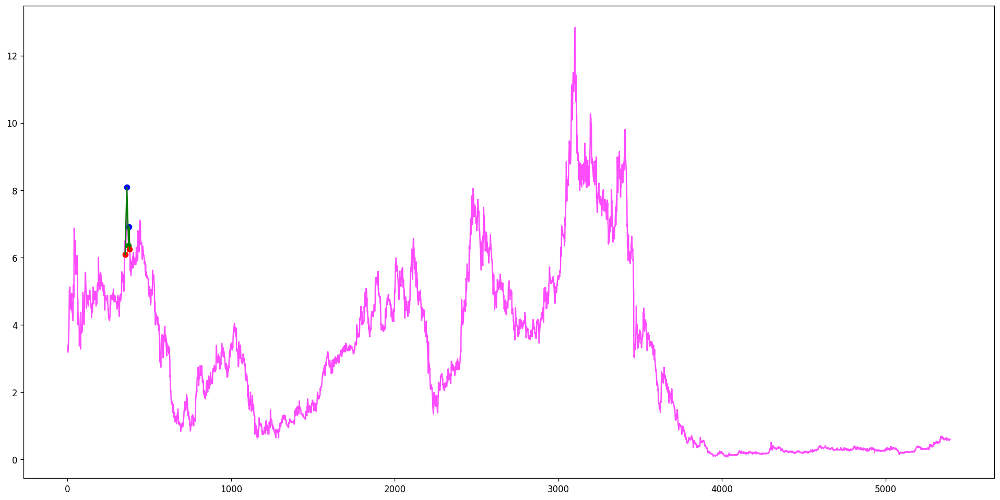

[(205, 209, 211, 212, 214), (1904, 1911, 1914, 1921, 1931), (1904, 1911, 1914, 1924, 1931), (1904, 1911, 1914, 1928, 1931)]
[]
Ticker ACGBY found 4 double top patterns, 0 double bottom patterns


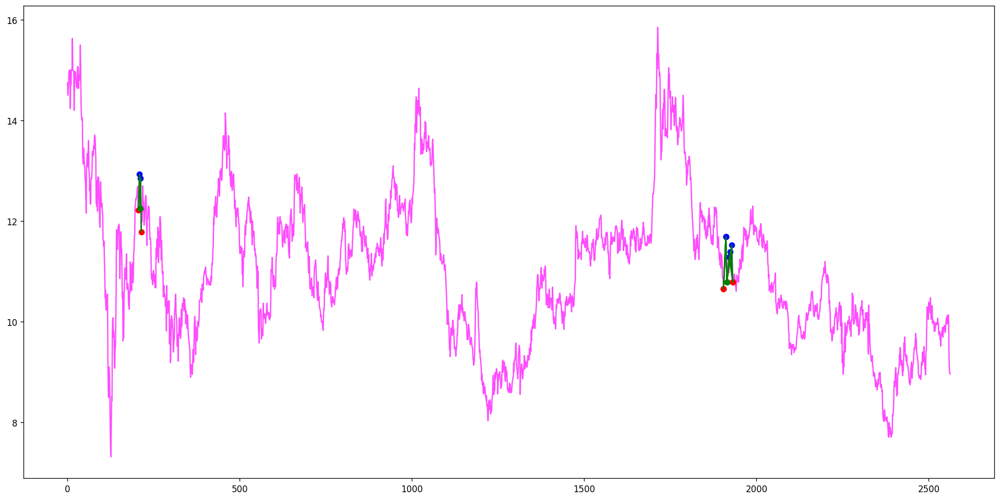

[(2968, 2974, 2977, 2982, 2993), (2968, 2974, 2977, 2985, 2993), (4190, 4196, 4203, 4207, 4209), (4612, 4615, 4620, 4625, 4629), (4612, 4618, 4620, 4625, 4629), (4811, 4820, 4824, 4829, 4832), (4859, 4863, 4867, 4868, 4869), (5070, 5071, 5072, 5073, 5074), (5088, 5089, 5090, 5091, 5092)]
[]
Ticker ACGL found 9 double top patterns, 0 double bottom patterns


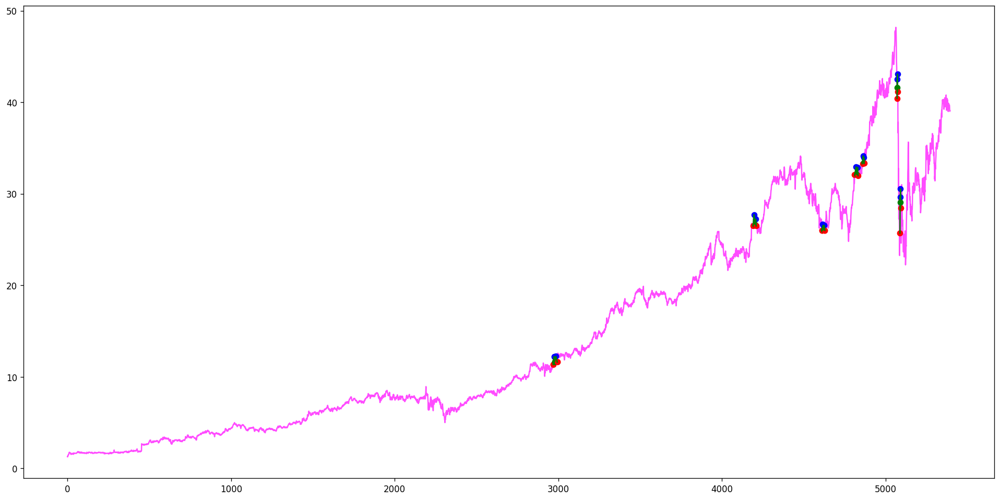

[]
[]
Ticker ACGLO found 0 double top patterns, 0 double bottom patterns


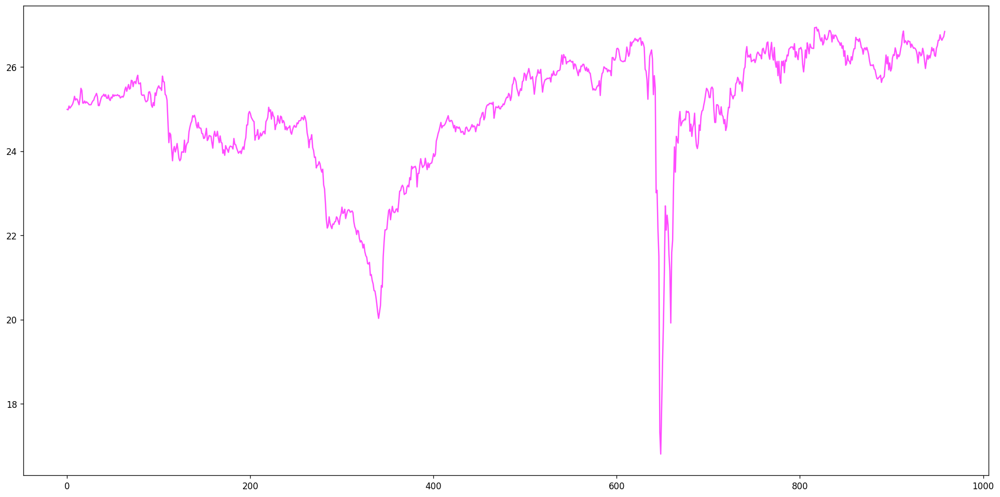

[(805, 808, 812, 814, 816), (1055, 1056, 1057, 1058, 1059), (1264, 1266, 1268, 1269, 1271), (1301, 1302, 1304, 1306, 1309), (1595, 1596, 1597, 1599, 1600), (1733, 1734, 1736, 1737, 1739), (1878, 1879, 1881, 1883, 1884), (3287, 3290, 3298, 3300, 3303), (3450, 3451, 3457, 3458, 3471), (3852, 3857, 3861, 3865, 3871), (4833, 4834, 4837, 4838, 4840)]
[]
Ticker ACH found 11 double top patterns, 0 double bottom patterns


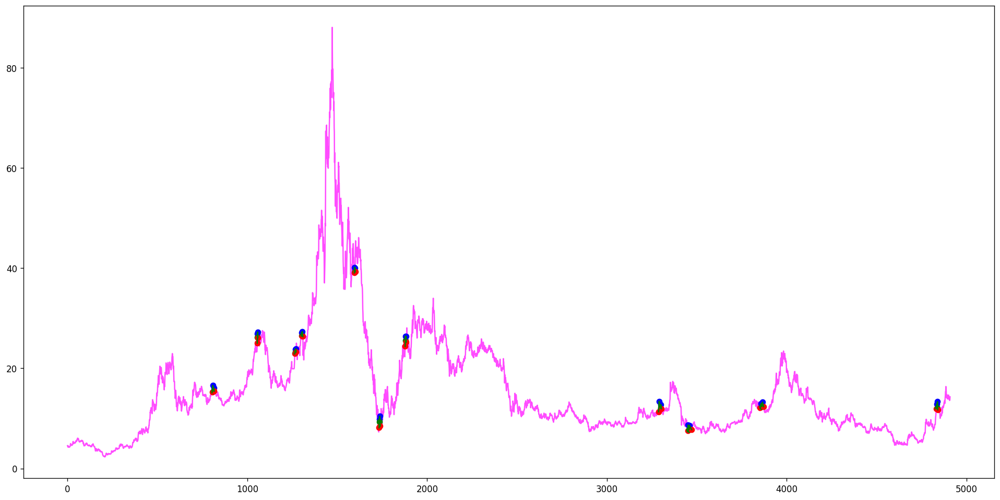

[(1755, 1758, 1759, 1761, 1764), (1790, 1793, 1796, 1797, 1800), (2109, 2117, 2119, 2125, 2130), (2593, 2604, 2606, 2608, 2616), (2625, 2627, 2629, 2636, 2642), (3096, 3097, 3100, 3103, 3109), (3175, 3176, 3177, 3179, 3184), (3555, 3556, 3557, 3559, 3560), (3683, 3685, 3687, 3688, 3689), (3699, 3701, 3703, 3704, 3706), (3836, 3837, 3839, 3841, 3844), (3947, 3949, 3950, 3951, 3953), (3959, 3960, 3961, 3963, 3964), (4171, 4172, 4173, 4174, 4175), (4202, 4203, 4206, 4207, 4209), (4212, 4213, 4214, 4215, 4216), (4286, 4287, 4288, 4292, 4295), (4829, 4831, 4832, 4833, 4834), (4955, 4956, 4957, 4961, 4962), (5002, 5008, 5012, 5014, 5017), (5100, 5101, 5103, 5104, 5106), (5195, 5197, 5199, 5200, 5201), (5357, 5358, 5359, 5360, 5362)]
[]
Ticker ACHC found 23 double top patterns, 0 double bottom patterns


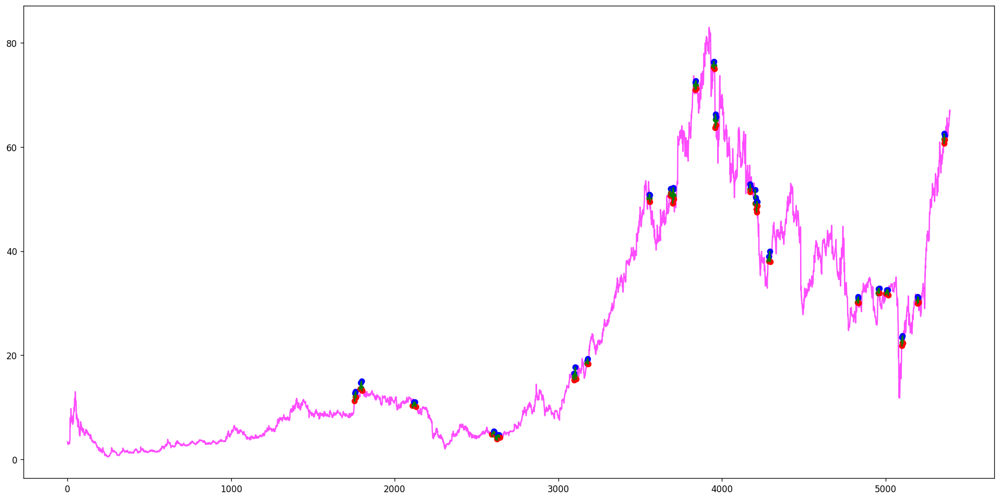

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(14, 16, 20, 21, 22), (40, 41, 42, 43, 47), (73, 74, 75, 76, 78), (79, 80, 81, 82, 83), (91, 92, 93, 95, 96), (116, 117, 118, 119, 120), (115, 119, 120, 122, 124), (134, 135, 137, 138, 139), (132, 133, 134, 135, 143), (156, 157, 159, 160, 161), (163, 166, 168, 171, 173), (188, 189, 190, 191, 193), (249, 250, 251, 252, 253), (307, 308, 309, 310, 312), (325, 326, 327, 328, 329), (333, 334, 335, 336, 339), (339, 341, 342, 344, 346), (348, 349, 350, 351, 352), (339, 341, 346, 349, 354), (358, 359, 360, 361, 362), (358, 359, 362, 363, 364), (364, 367, 369, 370, 371), (369, 370, 371, 372, 373), (379, 381, 382, 383, 384), (405, 406, 407, 410, 411), (407, 408, 409, 410, 411), (412, 413, 414, 415, 417), (404, 406, 411, 413, 419), (398, 401, 404, 406, 423), (437, 438, 439, 440, 441), (451, 452, 453, 454, 456), (473, 474, 475, 476, 477), (466, 470, 473, 476, 478), (478, 479, 480, 481, 482), (484, 485, 487, 489, 493), (497, 499, 501, 502, 503), (494, 495, 497, 499, 504), (494, 495, 505, 506, 510)

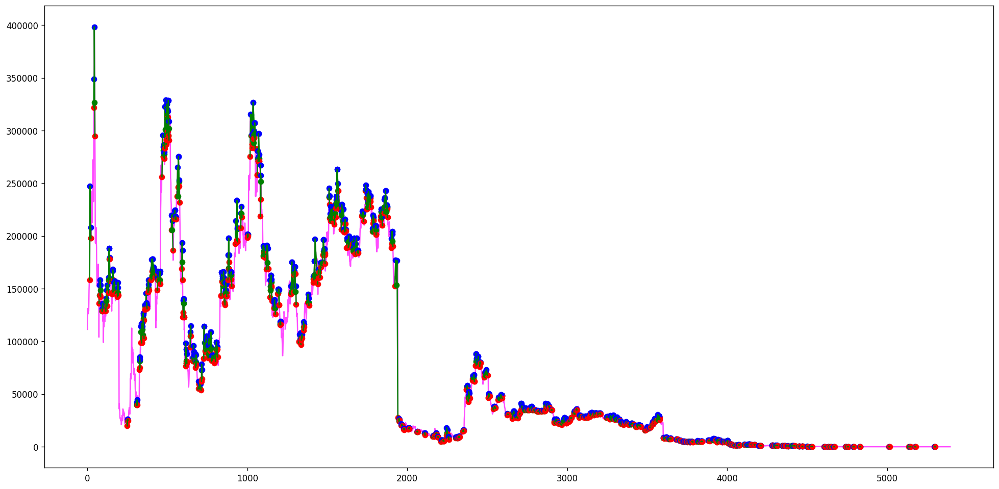

[]
[]
Ticker ACI found 0 double top patterns, 0 double bottom patterns


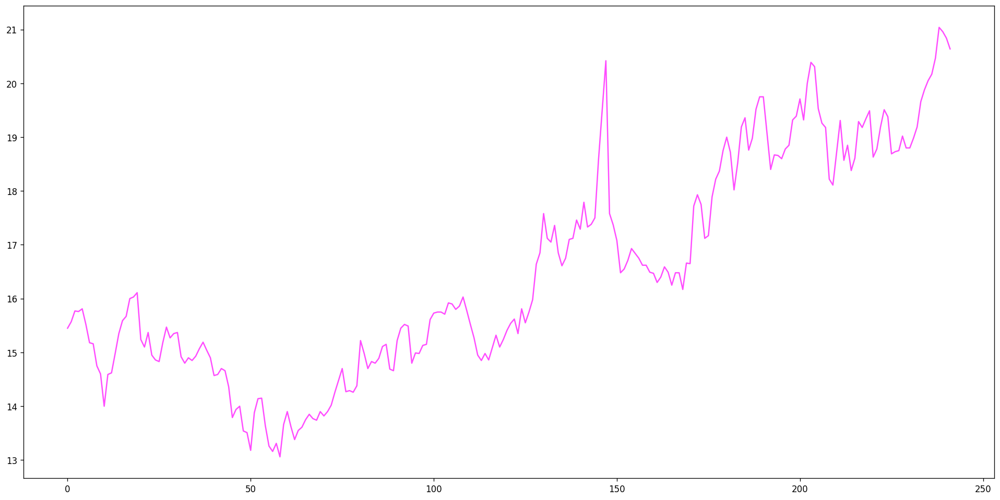

[(825, 827, 829, 832, 834), (1102, 1103, 1105, 1106, 1107)]
[]
Ticker ACIU found 2 double top patterns, 0 double bottom patterns


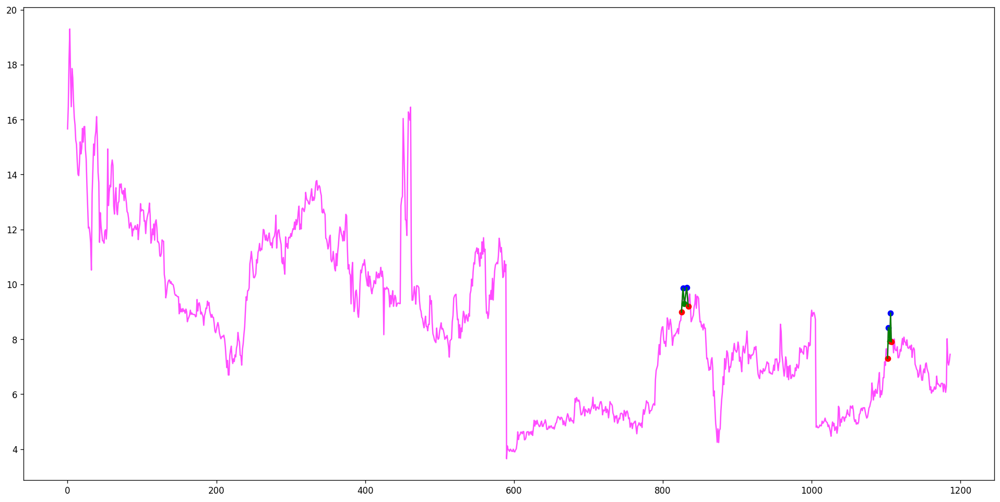

[(131, 134, 137, 140, 144), (1175, 1177, 1187, 1192, 1197), (1232, 1236, 1241, 1245, 1257), (2235, 2240, 2241, 2242, 2244), (3096, 3103, 3107, 3109, 3122), (3107, 3109, 3114, 3117, 3122), (4858, 4860, 4861, 4864, 4865), (5087, 5089, 5090, 5092, 5093), (5111, 5112, 5114, 5116, 5117)]
[]
Ticker ACIW found 9 double top patterns, 0 double bottom patterns


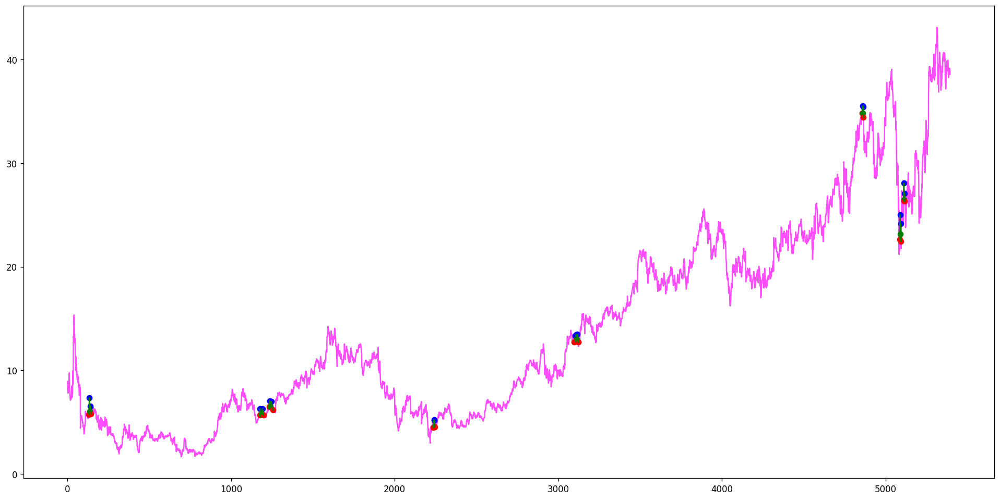

[(1606, 1607, 1608, 1614, 1615), (1714, 1715, 1719, 1720, 1721)]
[]
Ticker ACKAY found 2 double top patterns, 0 double bottom patterns


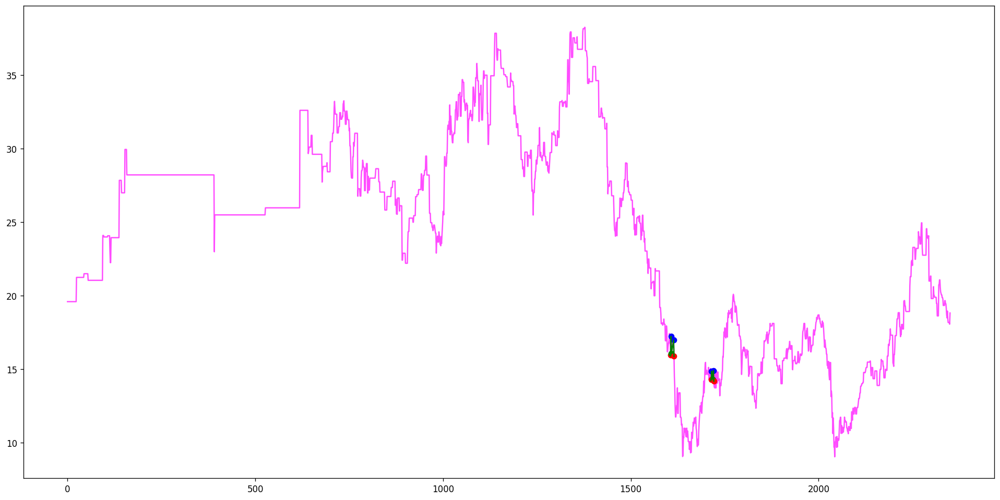

[(966, 967, 968, 985, 986), (2446, 2450, 2452, 2455, 2465), (2740, 2746, 2747, 2749, 2757)]
[]
Ticker ACLLF found 3 double top patterns, 0 double bottom patterns


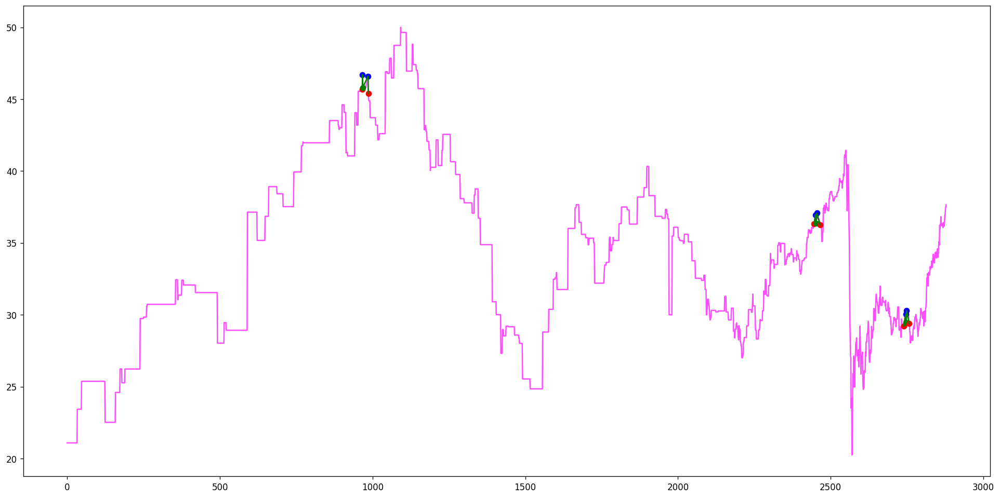

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(28, 30, 31, 32, 34), (54, 55, 56, 57, 58), (78, 79, 82, 83, 84), (208, 209, 210, 211, 212), (226, 227, 228, 229, 232), (274, 275, 276, 278, 279), (395, 396, 397, 398, 400), (572, 573, 574, 575, 577), (597, 598, 599, 600, 601), (650, 652, 653, 654, 657), (784, 785, 786, 788, 789), (794, 796, 797, 800, 802), (847, 848, 849, 851, 852), (909, 910, 911, 912, 913), (972, 973, 975, 976, 977), (1049, 1053, 1054, 1055, 1056), (1114, 1115, 1116, 1117, 1120), (1335, 1337, 1338, 1339, 1343), (1855, 1858, 1860, 1862, 1865), (1872, 1873, 1874, 1875, 1876), (2093, 2095, 2098, 2102, 2104), (2518, 2519, 2522, 2525, 2527), (2796, 2801, 2809, 2813, 2816), (3842, 3846, 3848, 3849, 3850), (3840, 3846, 3851, 3854, 3855), (3901, 3903, 3905, 3913, 3915), (3993, 4000, 4004, 4013, 4014), (4230, 4231, 4234, 4238, 4239), (4369, 4370, 4371, 4372, 4373), (4396, 4401, 4405, 4406, 4407), (4427, 4431, 4432, 4434, 4436), (4538, 4540, 4541, 4545, 4550), (4957, 4958, 4959, 4961, 4962), (4969, 4970, 4972, 4974, 4975), (

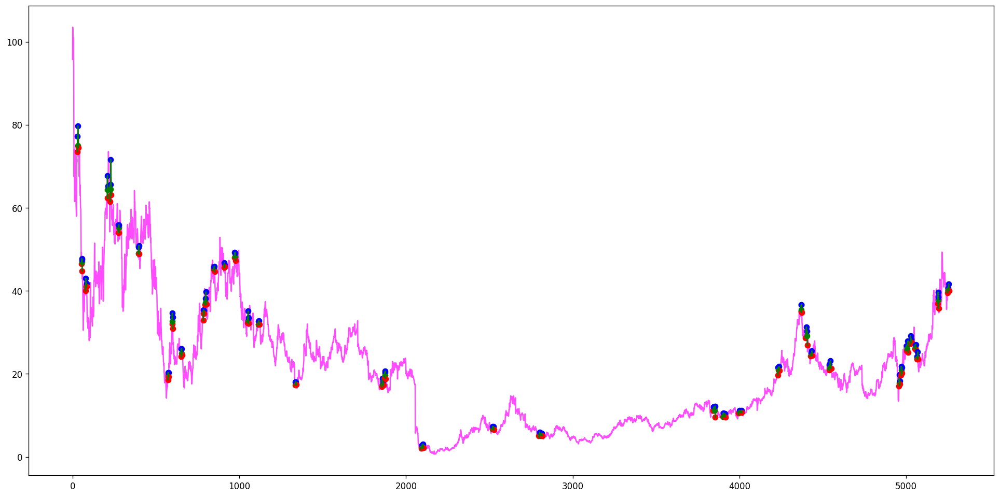

[(43, 44, 47, 48, 49), (58, 59, 60, 62, 63), (96, 97, 98, 100, 102), (157, 159, 160, 161, 163), (285, 286, 287, 288, 289), (336, 337, 338, 339, 340), (414, 416, 419, 421, 422), (424, 426, 427, 428, 429), (462, 464, 465, 466, 469), (767, 768, 770, 772, 774), (933, 936, 938, 940, 943), (955, 958, 960, 961, 963), (1186, 1189, 1191, 1192, 1193), (1215, 1224, 1227, 1229, 1233), (1357, 1364, 1367, 1373, 1377), (1739, 1741, 1743, 1750, 1759), (1834, 1840, 1843, 1845, 1850), (1834, 1840, 1843, 1848, 1850), (1946, 1947, 1948, 1950, 1953), (2068, 2071, 2076, 2077, 2079), (2256, 2257, 2258, 2260, 2262), (2266, 2268, 2269, 2270, 2272), (2488, 2490, 2493, 2495, 2496), (2547, 2552, 2553, 2555, 2568), (2785, 2790, 2795, 2798, 2801), (3382, 3384, 3387, 3389, 3390), (3456, 3457, 3458, 3461, 3462), (3471, 3472, 3474, 3475, 3476)]
[]
Ticker ACM found 28 double top patterns, 0 double bottom patterns


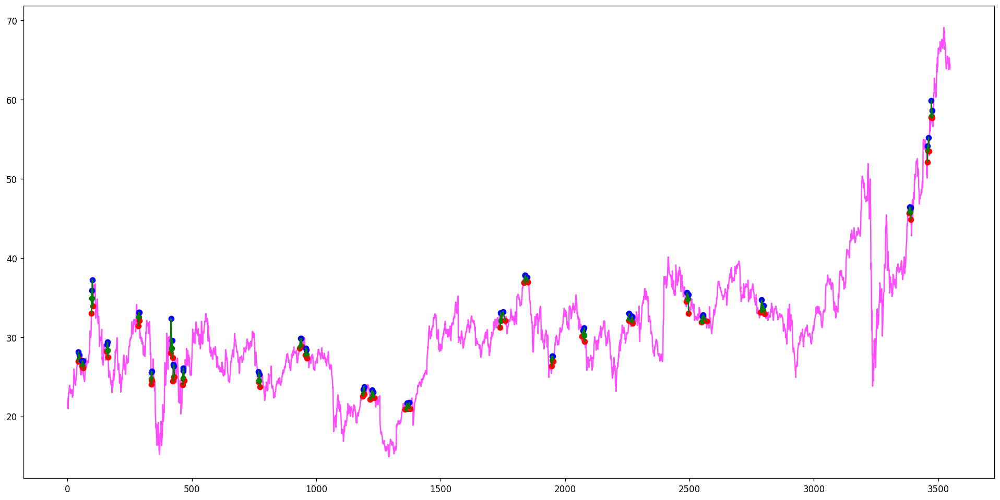

[(92, 93, 94, 96, 104), (125, 126, 127, 130, 134), (441, 442, 443, 445, 446), (568, 569, 570, 571, 572), (573, 574, 575, 576, 577), (634, 635, 636, 638, 639), (696, 697, 699, 700, 702), (731, 732, 733, 734, 735), (771, 772, 773, 774, 775), (783, 784, 786, 788, 789), (822, 825, 827, 828, 829), (843, 844, 845, 846, 847), (856, 857, 860, 861, 862)]
[]
Ticker ACMR found 13 double top patterns, 0 double bottom patterns


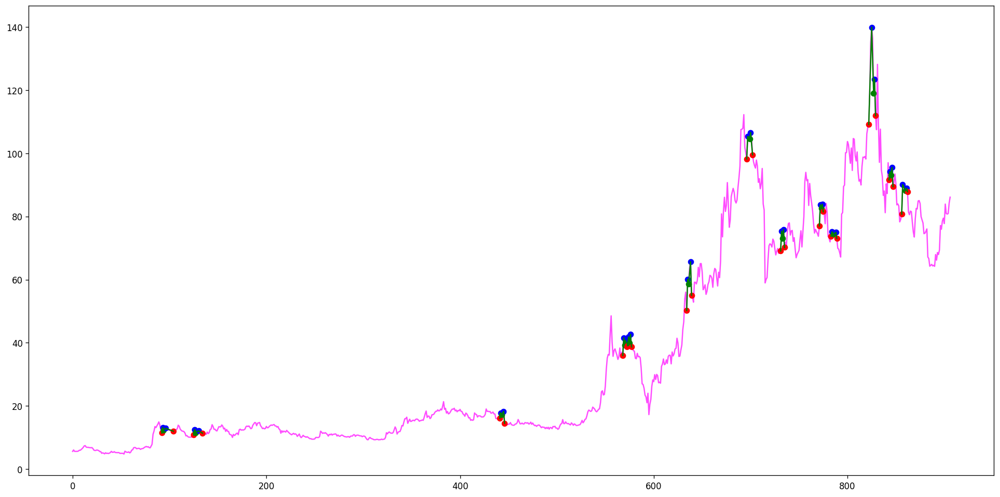

[(218, 221, 223, 226, 229), (495, 496, 498, 499, 500), (500, 502, 508, 509, 512), (577, 578, 580, 581, 583), (626, 628, 629, 630, 631), (1260, 1263, 1264, 1266, 1270), (1370, 1371, 1372, 1373, 1382), (1390, 1394, 1397, 1399, 1404), (1563, 1564, 1565, 1566, 1568), (1638, 1639, 1640, 1642, 1644), (1685, 1687, 1688, 1689, 1690), (1732, 1735, 1737, 1738, 1741), (1831, 1832, 1833, 1834, 1835), (1927, 1928, 1929, 1931, 1932), (2335, 2339, 2340, 2342, 2343), (2649, 2650, 2651, 2652, 2653), (2805, 2807, 2811, 2813, 2814), (2900, 2901, 2902, 2903, 2904), (3243, 3249, 3251, 3252, 3253), (3605, 3606, 3607, 3608, 3611), (3643, 3644, 3645, 3646, 3647), (3674, 3675, 3676, 3678, 3679), (3874, 3875, 3876, 3877, 3878), (4111, 4112, 4113, 4116, 4117), (4198, 4199, 4200, 4203, 4204), (4210, 4212, 4214, 4215, 4216), (4335, 4336, 4337, 4338, 4340), (4367, 4368, 4369, 4371, 4373), (4429, 4430, 4431, 4432, 4433), (4506, 4507, 4508, 4509, 4510), (4540, 4541, 4543, 4544, 4545), (4564, 4565, 4567, 4568, 4569), 

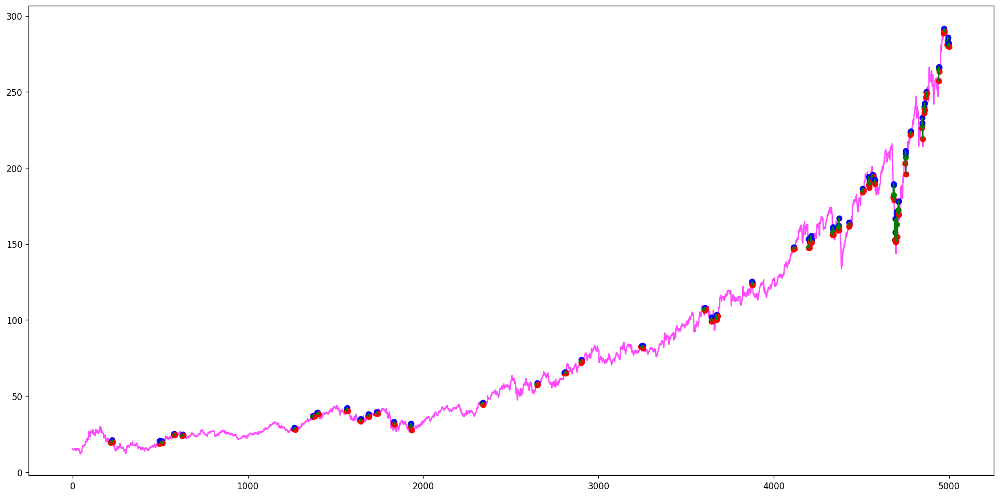

[(48, 49, 50, 51, 53), (396, 402, 403, 415, 417), (610, 611, 622, 623, 624), (635, 636, 637, 638, 640), (1209, 1210, 1211, 1218, 1219), (1549, 1550, 1552, 1556, 1557), (1622, 1624, 1628, 1629, 1630), (1824, 1828, 1829, 1834, 1840), (1824, 1828, 1829, 1838, 1840), (1992, 1996, 1997, 1998, 2000), (2160, 2179, 2180, 2181, 2182), (2287, 2288, 2289, 2292, 2294), (2287, 2288, 2289, 2293, 2294), (2494, 2495, 2496, 2500, 2505), (2935, 2938, 2940, 2943, 2945), (3956, 3957, 3960, 3962, 3964), (4776, 4778, 4779, 4780, 4782), (4862, 4863, 4865, 4871, 4873), (4927, 4928, 4932, 4933, 4934), (4954, 4955, 4957, 4961, 4962), (5086, 5089, 5090, 5092, 5093), (5242, 5243, 5244, 5245, 5246), (5293, 5294, 5296, 5297, 5298)]
[]
Ticker ACNB found 23 double top patterns, 0 double bottom patterns


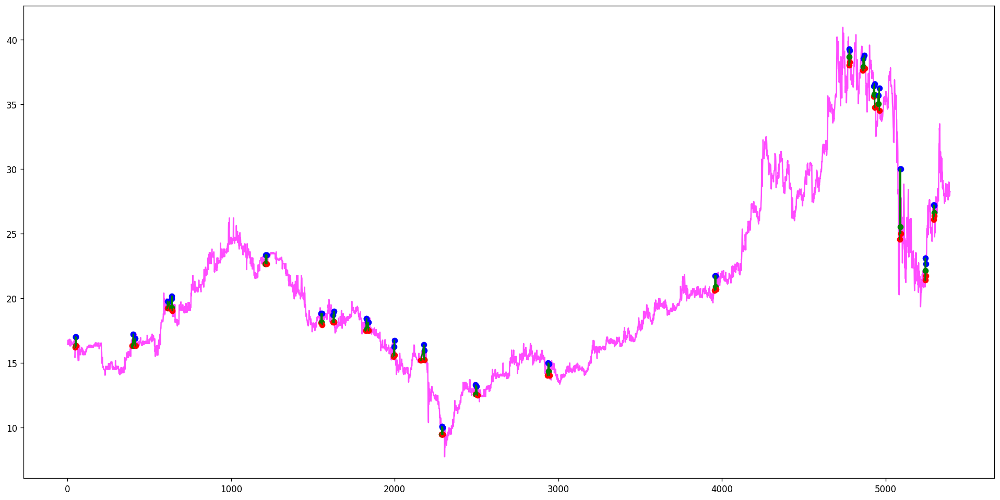

[]
[]
Ticker ACP found 0 double top patterns, 0 double bottom patterns


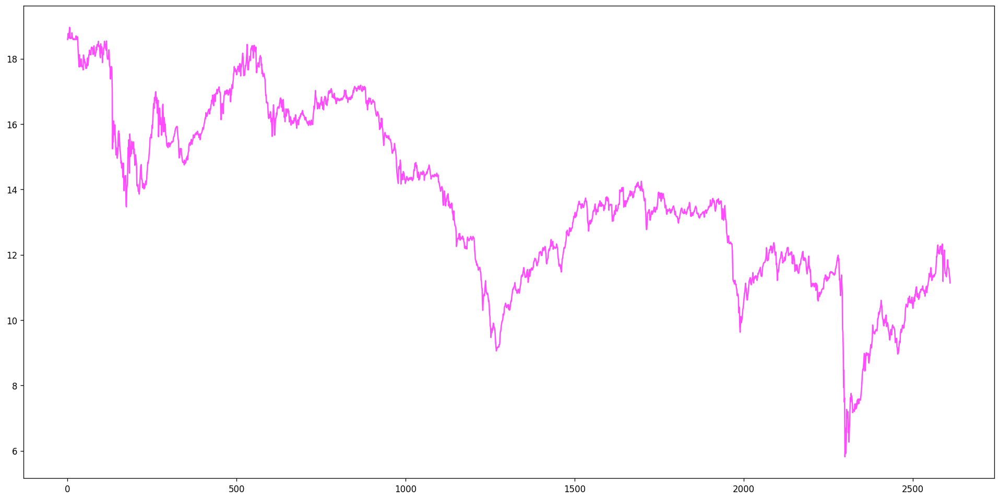

[(6, 7, 8, 9, 10), (39, 40, 41, 43, 44), (59, 60, 62, 63, 64), (172, 174, 175, 176, 177), (228, 229, 230, 231, 232), (255, 256, 258, 260, 262), (275, 276, 277, 279, 281), (326, 328, 329, 331, 334), (391, 392, 393, 394, 395), (404, 406, 407, 408, 411), (429, 430, 432, 433, 434), (454, 456, 457, 458, 459), (485, 486, 487, 488, 489), (581, 582, 583, 585, 586), (677, 678, 682, 683, 685), (719, 720, 722, 723, 724), (804, 805, 806, 807, 809), (821, 822, 823, 824, 825), (945, 946, 947, 948, 949), (1045, 1046, 1048, 1049, 1050), (1062, 1063, 1064, 1065, 1066), (1322, 1323, 1324, 1325, 1326), (1424, 1425, 1426, 1427, 1428), (1445, 1446, 1448, 1450, 1451), (1528, 1529, 1530, 1531, 1532), (1587, 1588, 1589, 1590, 1591), (1773, 1778, 1779, 1780, 1782), (1804, 1806, 1807, 1808, 1810), (1874, 1876, 1877, 1882, 1883), (1877, 1882, 1883, 1884, 1886), (1987, 1992, 1994, 1995, 1996), (2147, 2149, 2151, 2156, 2163), (2147, 2149, 2151, 2160, 2163), (2258, 2259, 2261, 2262, 2267), (2419, 2421, 2422, 2423, 

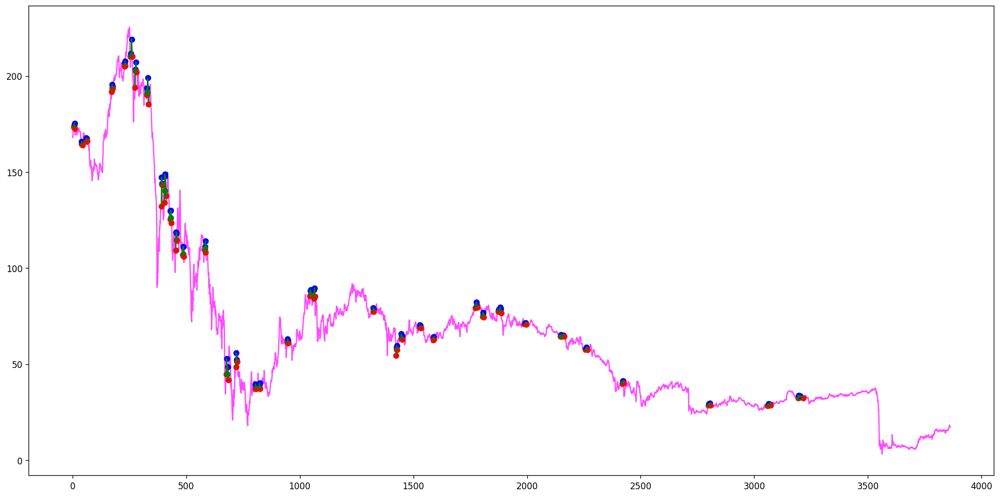

[(71, 75, 81, 89, 98)]
[]
Ticker ACRDF found 1 double top patterns, 0 double bottom patterns


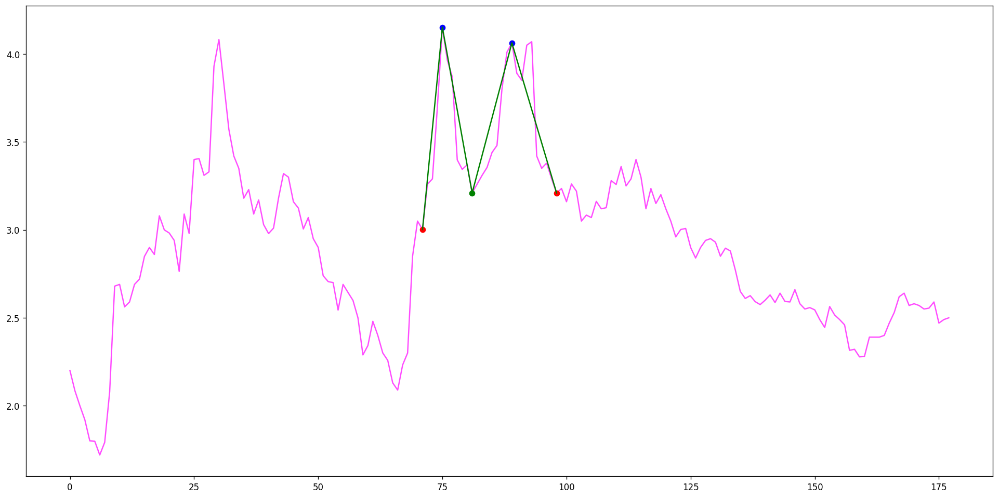

[(819, 830, 835, 838, 841), (2221, 2225, 2226, 2228, 2245)]
[]
Ticker ACRE found 2 double top patterns, 0 double bottom patterns


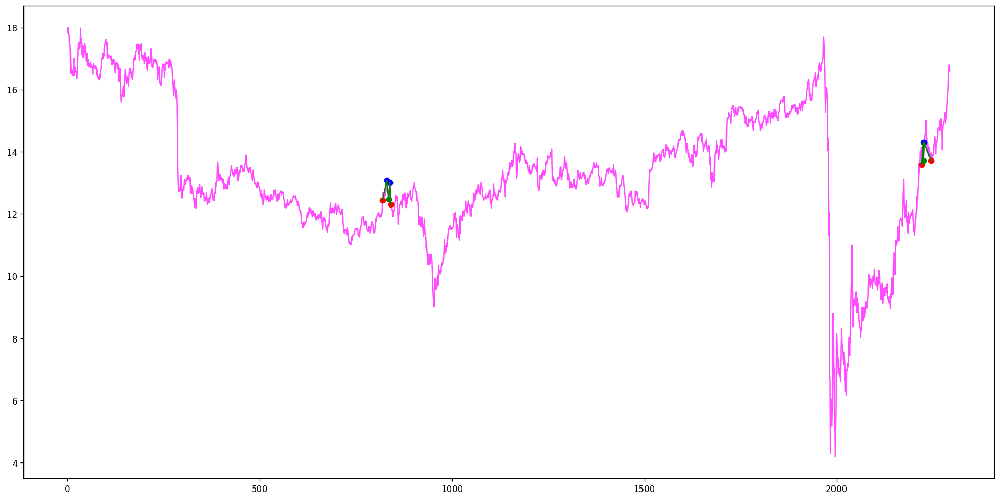

[]
[]
Ticker ACRHF found 0 double top patterns, 0 double bottom patterns


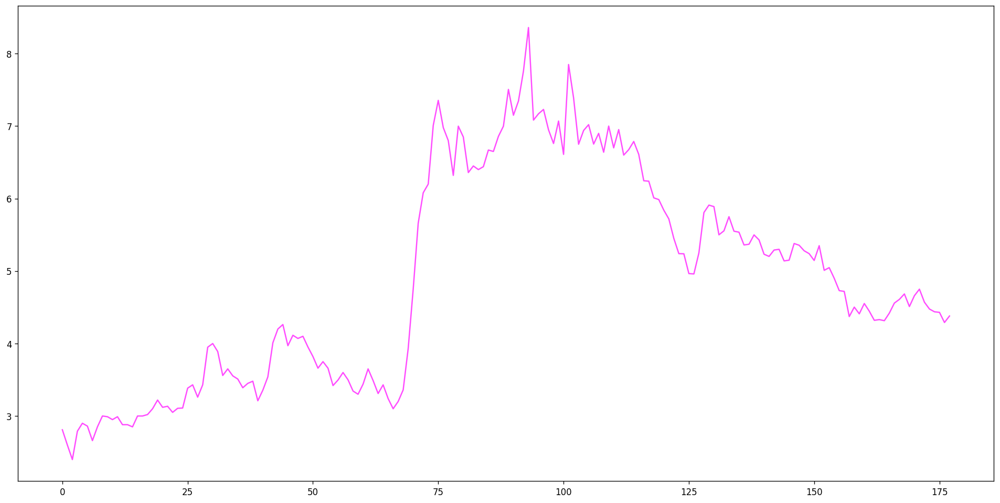

[(59, 60, 61, 62, 63), (220, 222, 224, 226, 228), (400, 401, 402, 403, 404), (731, 732, 733, 734, 735), (890, 894, 898, 901, 903)]
[]
Ticker ACRS found 5 double top patterns, 0 double bottom patterns


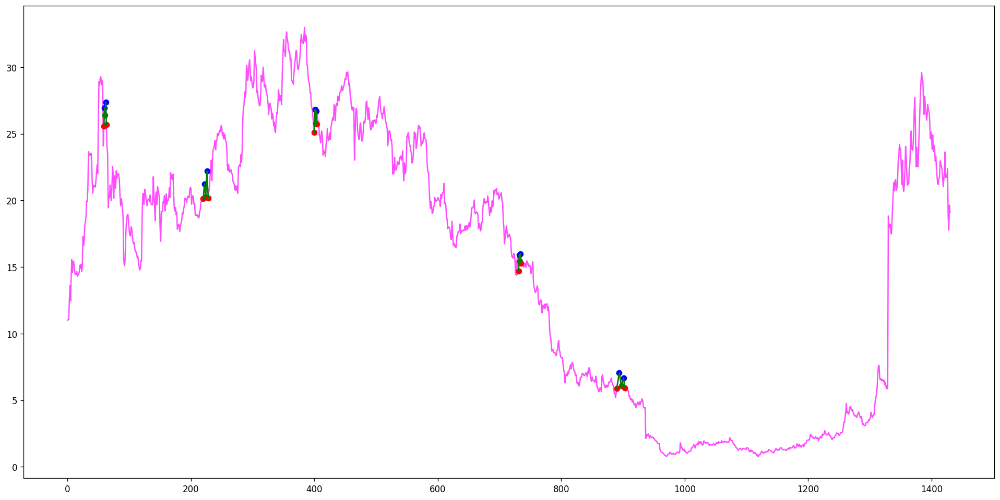

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(485, 487, 499, 503, 512), (582, 584, 586, 588, 591), (1445, 1448, 1462, 1467, 1471)]
[]
Ticker ACRX found 3 double top patterns, 0 double bottom patterns


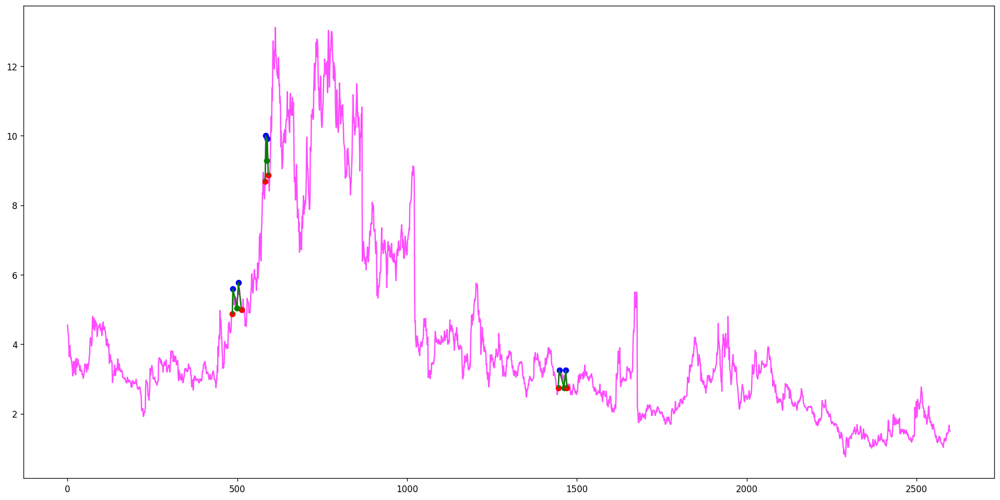

[(429, 430, 431, 432, 433), (448, 449, 450, 451, 452), (720, 721, 728, 734, 738), (1977, 1981, 1982, 1984, 1994)]
[]
Ticker ACST found 4 double top patterns, 0 double bottom patterns


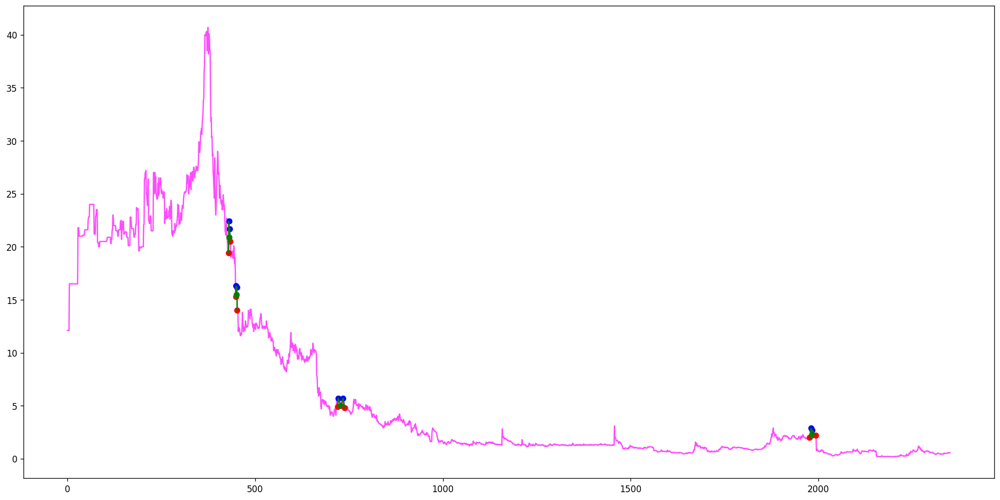

[(28, 29, 30, 33, 39)]
[]
Ticker ACTC found 1 double top patterns, 0 double bottom patterns


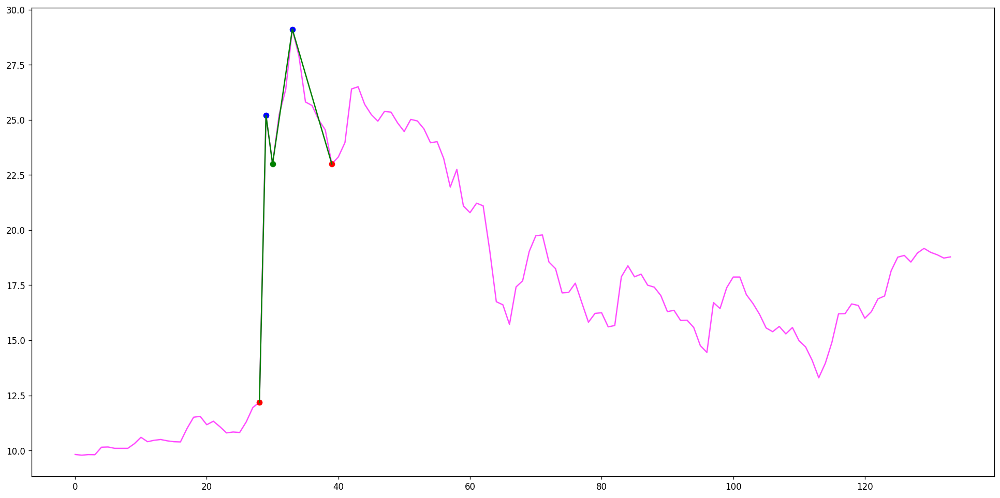

[(919, 924, 928, 933, 939), (984, 987, 989, 992, 994), (1138, 1145, 1147, 1149, 1158), (1873, 1874, 1876, 1878, 1879), (2125, 2126, 2127, 2128, 2129), (2157, 2158, 2159, 2160, 2161), (2273, 2274, 2276, 2278, 2279), (2698, 2710, 2712, 2715, 2718), (2937, 2940, 2942, 2947, 2958), (3003, 3014, 3015, 3016, 3019), (3584, 3586, 3590, 3597, 3606), (3714, 3720, 3722, 3724, 3728), (3714, 3720, 3722, 3725, 3728)]
[]
Ticker ACTG found 13 double top patterns, 0 double bottom patterns


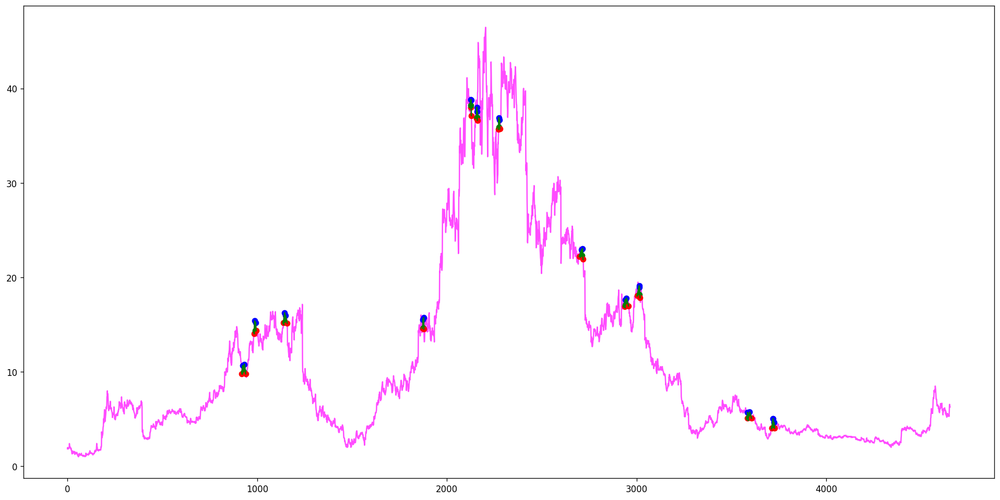

[(67, 69, 71, 72, 78), (663, 666, 670, 676, 678), (703, 713, 715, 716, 718), (984, 998, 1000, 1003, 1008), (1062, 1064, 1066, 1070, 1075), (1060, 1070, 1077, 1082, 1087), (1219, 1220, 1221, 1223, 1224)]
[]
Ticker ACV found 7 double top patterns, 0 double bottom patterns


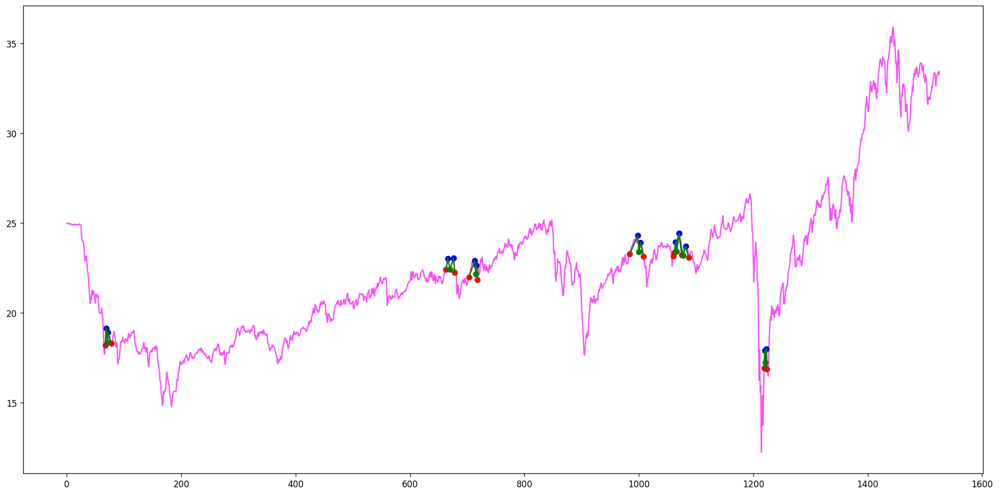

[(89, 91, 92, 94, 96), (100, 103, 104, 107, 110), (140, 141, 142, 143, 145), (247, 248, 249, 251, 253), (573, 579, 580, 582, 583), (881, 883, 884, 885, 886), (1005, 1007, 1010, 1012, 1014), (1045, 1046, 1050, 1051, 1052), (1135, 1136, 1137, 1142, 1144), (1345, 1347, 1350, 1354, 1356), (1419, 1421, 1424, 1426, 1433), (1511, 1514, 1517, 1519, 1520), (1573, 1578, 1582, 1586, 1587), (1714, 1719, 1721, 1722, 1723), (1776, 1783, 1785, 1787, 1788), (2071, 2073, 2074, 2075, 2076), (2800, 2803, 2805, 2806, 2808), (3001, 3002, 3003, 3004, 3006), (3075, 3076, 3079, 3081, 3082), (3127, 3128, 3129, 3131, 3132), (3218, 3219, 3220, 3223, 3224)]
[]
Ticker ACWI found 21 double top patterns, 0 double bottom patterns


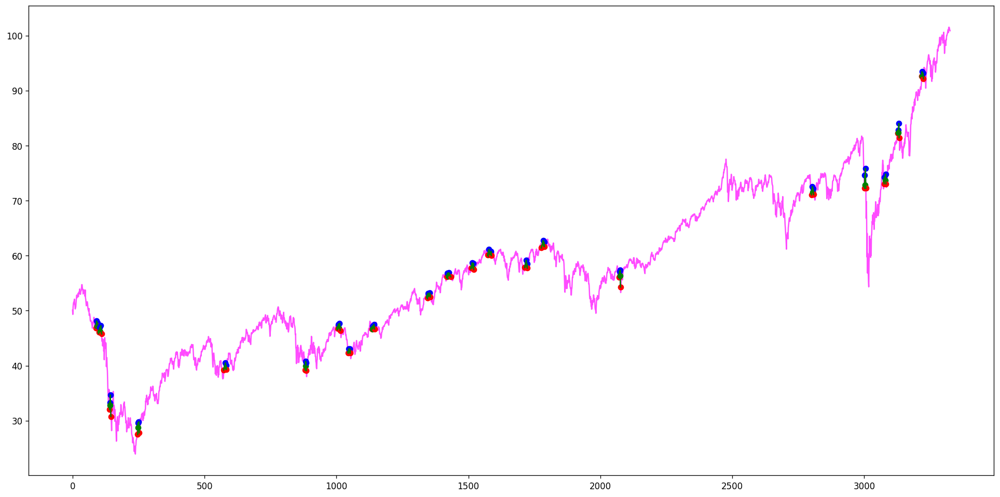

[(227, 233, 234, 236, 247), (227, 242, 247, 250, 254), (610, 614, 617, 619, 621), (741, 743, 744, 745, 746), (876, 883, 885, 887, 888), (1042, 1045, 1048, 1053, 1056), (1171, 1173, 1174, 1175, 1176), (1236, 1238, 1240, 1242, 1243), (1292, 1295, 1296, 1300, 1301), (1410, 1412, 1418, 1423, 1424), (1960, 1961, 1963, 1964, 1965), (2030, 2033, 2036, 2039, 2041), (2119, 2120, 2121, 2122, 2124), (2137, 2138, 2139, 2143, 2145), (2155, 2156, 2157, 2158, 2159), (2224, 2228, 2230, 2231, 2232), (2316, 2319, 2324, 2330, 2331), (2396, 2397, 2398, 2402, 2404)]
[]
Ticker ACWV found 18 double top patterns, 0 double bottom patterns


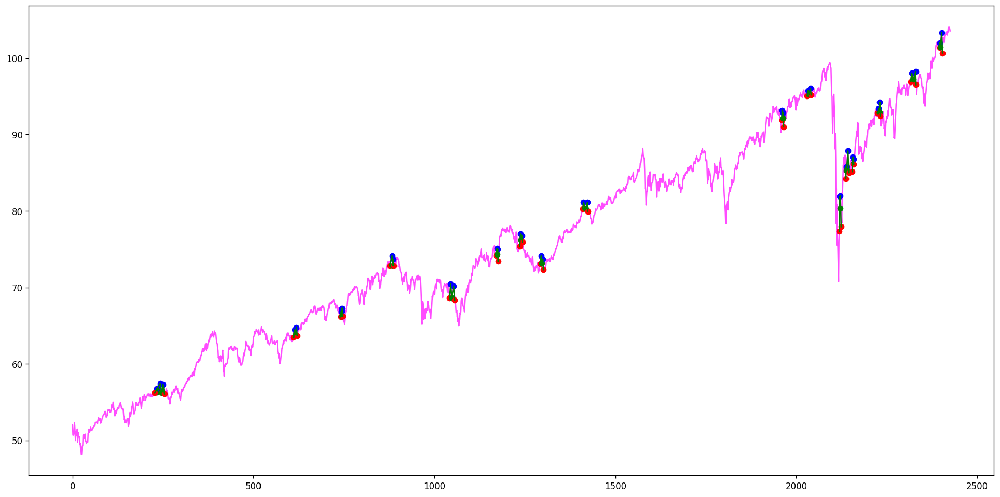

[(245, 246, 247, 249, 250), (530, 531, 532, 533, 535), (880, 881, 882, 883, 884), (891, 894, 895, 896, 897), (1283, 1285, 1291, 1294, 1296), (1309, 1310, 1311, 1313, 1314), (1904, 1906, 1911, 1913, 1916), (2069, 2071, 2072, 2073, 2074), (2232, 2241, 2244, 2245, 2250), (2399, 2403, 2412, 2417, 2426), (2399, 2404, 2412, 2417, 2426), (2666, 2672, 2675, 2679, 2681), (2829, 2834, 2837, 2847, 2852), (2856, 2859, 2861, 2862, 2863), (2982, 2984, 2985, 2988, 2993), (3216, 3217, 3218, 3221, 3222)]
[]
Ticker ACWX found 16 double top patterns, 0 double bottom patterns


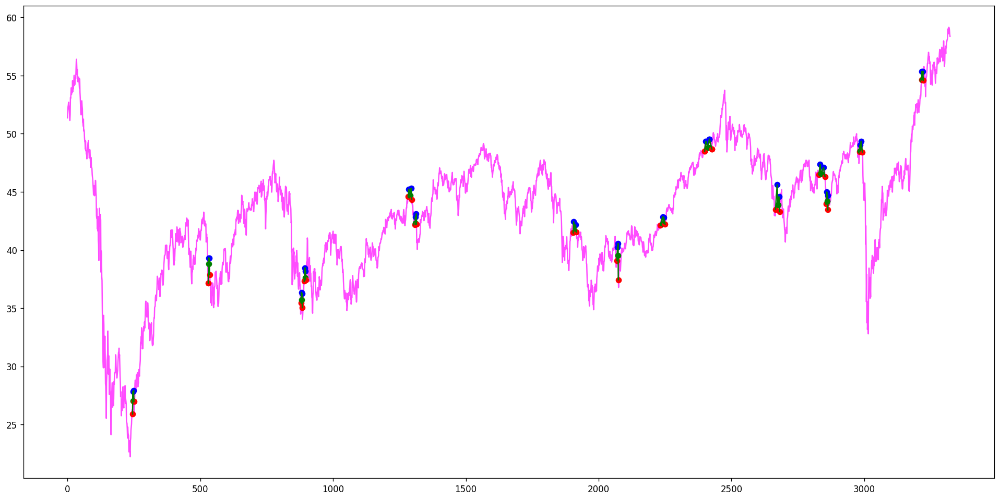

[(16, 17, 18, 20, 21), (212, 213, 214, 215, 216), (285, 286, 287, 288, 289), (310, 311, 312, 315, 316), (466, 467, 468, 470, 471), (1060, 1061, 1062, 1063, 1064), (2798, 2799, 2800, 2801, 2802), (2802, 2803, 2804, 2805, 2806)]
[]
Ticker ACXIF found 8 double top patterns, 0 double bottom patterns


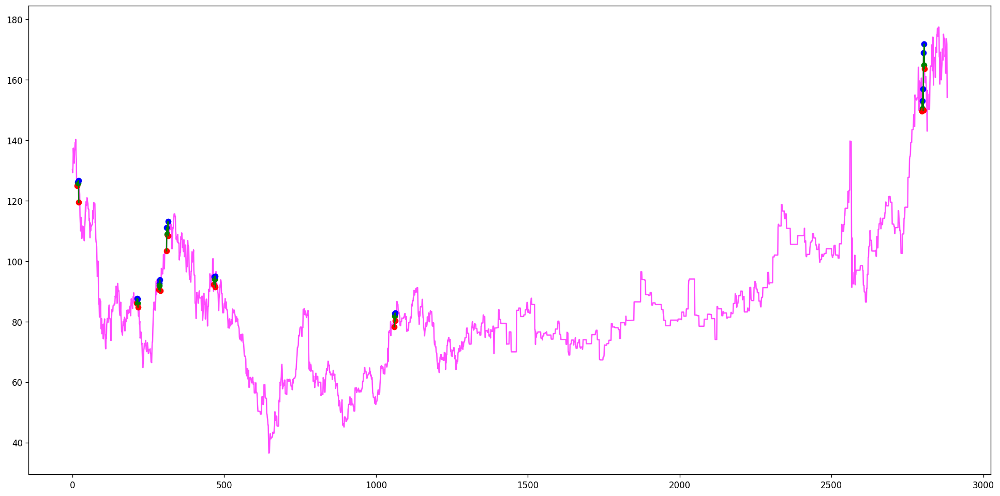

[(2284, 2285, 2287, 2288, 2289), (3528, 3530, 3532, 3534, 3540), (3575, 3578, 3579, 3580, 3584), (3711, 3713, 3714, 3715, 3716), (4406, 4407, 4408, 4411, 4413), (4484, 4485, 4489, 4492, 4493), (4649, 4650, 4651, 4652, 4653), (5328, 5331, 5333, 5334, 5335)]
[]
Ticker ACY found 8 double top patterns, 0 double bottom patterns


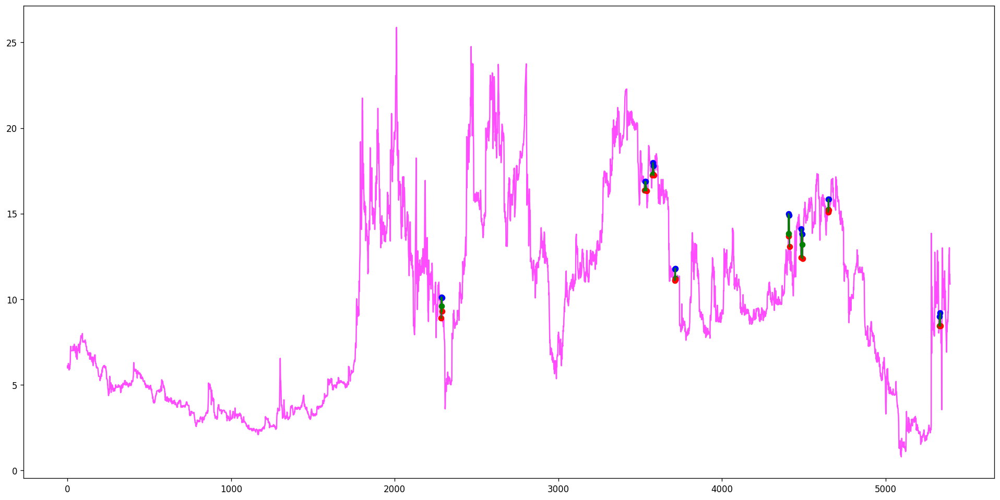

[(48, 50, 51, 52, 53), (230, 232, 235, 238, 241), (1309, 1312, 1314, 1319, 1322)]
[]
Ticker ADAP found 3 double top patterns, 0 double bottom patterns


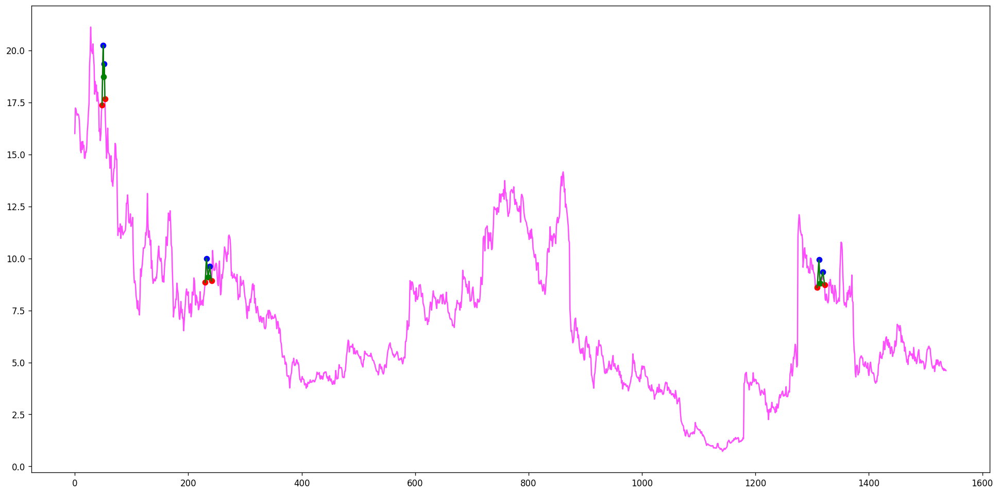

[(66, 67, 68, 69, 70), (79, 80, 81, 82, 83), (111, 112, 113, 114, 115), (128, 129, 130, 132, 135), (386, 387, 388, 389, 392), (513, 515, 516, 517, 520), (586, 587, 589, 591, 596), (833, 835, 839, 841, 845), (1123, 1127, 1130, 1131, 1132), (1513, 1515, 1516, 1519, 1520), (1690, 1691, 1692, 1694, 1695), (1748, 1749, 1750, 1752, 1754), (1800, 1805, 1806, 1807, 1808), (1894, 1895, 1896, 1897, 1900), (1930, 1933, 1936, 1938, 1939), (2024, 2029, 2031, 2032, 2033), (2134, 2135, 2136, 2137, 2138), (2251, 2252, 2254, 2255, 2256), (2316, 2317, 2318, 2320, 2321), (2328, 2330, 2333, 2335, 2336), (2807, 2809, 2810, 2811, 2814), (2937, 2938, 2940, 2944, 2947), (2964, 2965, 2966, 2967, 2968), (3053, 3055, 3058, 3060, 3062), (3086, 3088, 3090, 3091, 3095), (3268, 3269, 3270, 3274, 3280), (3335, 3337, 3339, 3340, 3342), (3529, 3530, 3533, 3534, 3536), (3570, 3572, 3573, 3574, 3575), (3803, 3806, 3808, 3812, 3814), (3943, 3944, 3945, 3947, 3948), (4085, 4086, 4088, 4089, 4090), (4125, 4126, 4127, 4129, 

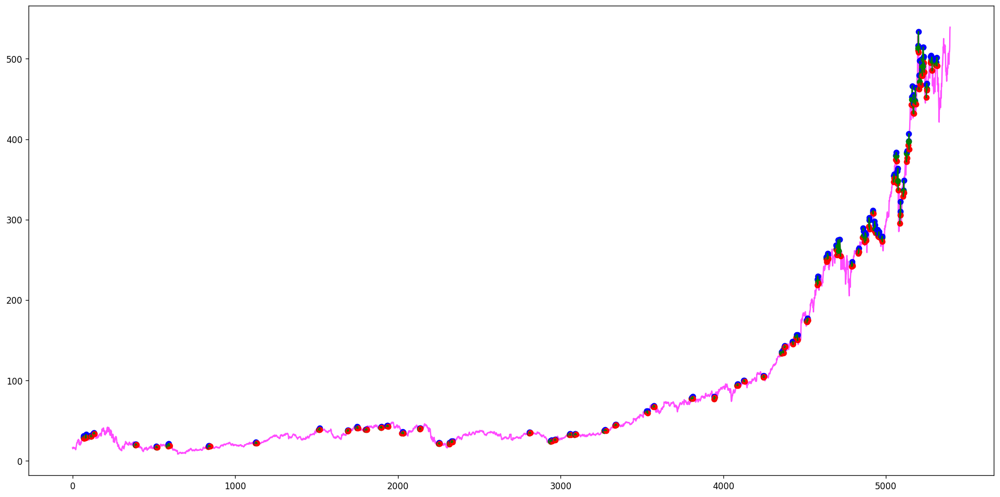

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(308, 310, 311, 313, 316), (605, 620, 621, 628, 631), (989, 991, 996, 1002, 1005), (1179, 1187, 1197, 1202, 1207), (1596, 1597, 1598, 1599, 1601), (1739, 1743, 1755, 1757, 1761), (1772, 1775, 1776, 1778, 1781), (1790, 1791, 1792, 1793, 1795), (1908, 1909, 1910, 1911, 1913), (1971, 1972, 1973, 1974, 1975), (2000, 2001, 2003, 2006, 2010), (2012, 2013, 2014, 2015, 2017), (2194, 2196, 2197, 2198, 2201), (2261, 2262, 2263, 2265, 2266), (2351, 2354, 2355, 2356, 2358), (2462, 2463, 2464, 2466, 2470), (2481, 2483, 2484, 2485, 2486), (2487, 2489, 2491, 2492, 2494), (2614, 2615, 2617, 2619, 2620), (2675, 2677, 2678, 2679, 2680), (2775, 2776, 2779, 2784, 2786), (2894, 2899, 2903, 2905, 2907), (3331, 3333, 3335, 3338, 3339), (3746, 3753, 3754, 3759, 3761), (3858, 3860, 3863, 3865, 3871), (3902, 3908, 3915, 3919, 3927), (3996, 4003, 4005, 4007, 4008), (4308, 4310, 4312, 4313, 4319), (4761, 4762, 4764, 4765, 4766), (4958, 4961, 4962, 4964, 4965), (5097, 5099, 5100, 5101, 5102), (5153, 5156, 5161, 5

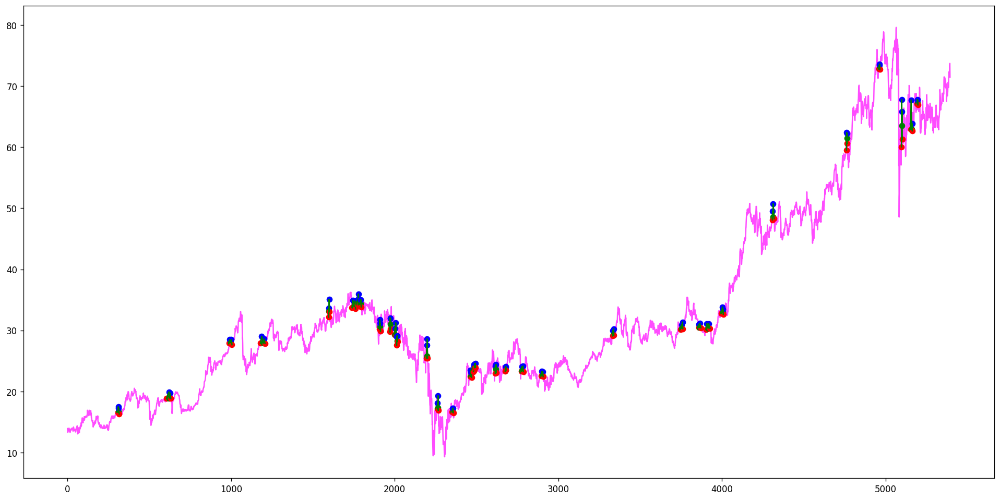

[(6, 7, 9, 10, 11), (99, 100, 101, 102, 103), (258, 259, 260, 262, 267)]
[]
Ticker ADCT found 3 double top patterns, 0 double bottom patterns


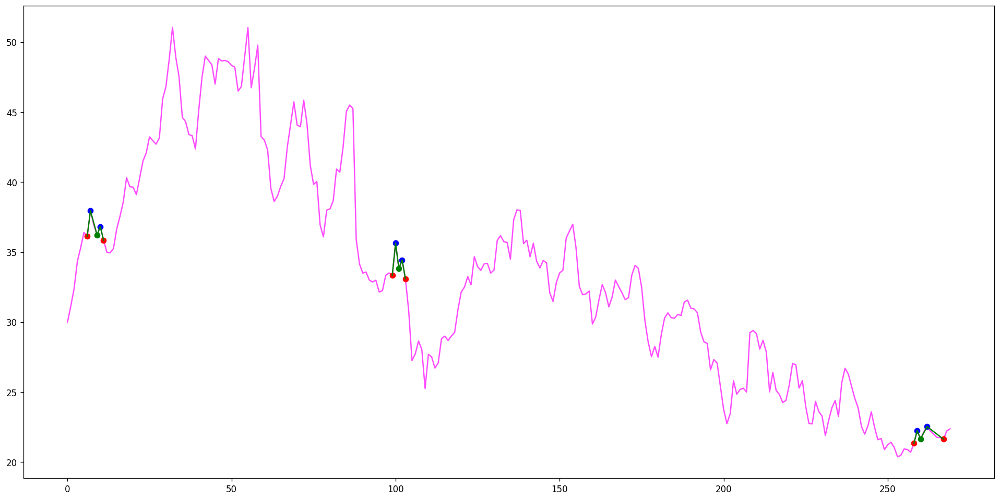

[(1763, 1765, 1766, 1767, 1768), (1848, 1849, 1850, 1851, 1852), (1909, 1911, 1912, 1913, 1914), (1990, 1992, 1995, 1997, 1999), (2043, 2044, 2045, 2046, 2047), (2210, 2211, 2212, 2213, 2216), (2264, 2266, 2267, 2268, 2269), (2336, 2339, 2340, 2341, 2342), (2429, 2430, 2431, 2432, 2433), (2466, 2468, 2469, 2470, 2471), (2530, 2532, 2533, 2534, 2535), (2543, 2544, 2545, 2546, 2548), (2570, 2573, 2576, 2578, 2580), (2617, 2618, 2619, 2620, 2621), (2635, 2636, 2637, 2638, 2639), (2672, 2673, 2674, 2675, 2676), (2680, 2682, 2683, 2684, 2685), (2704, 2706, 2707, 2709, 2711), (2718, 2720, 2721, 2722, 2723), (2783, 2784, 2785, 2786, 2787), (2792, 2793, 2794, 2795, 2796), (2801, 2803, 2808, 2809, 2810), (2799, 2800, 2801, 2803, 2812), (2830, 2831, 2833, 2834, 2835)]
[]
Ticker ADDDF found 24 double top patterns, 0 double bottom patterns


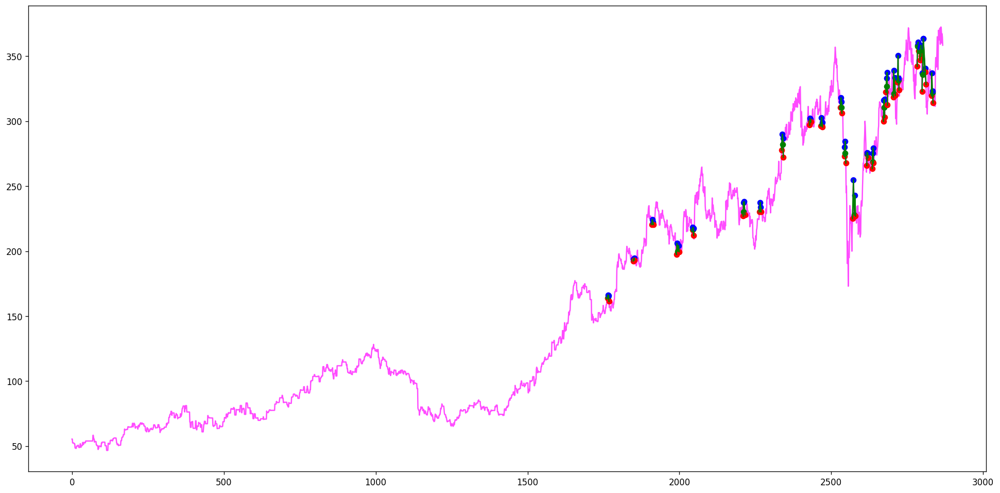

[(168, 185, 186, 187, 189), (237, 240, 242, 243, 244), (1033, 1038, 1039, 1041, 1042), (1367, 1369, 1371, 1372, 1373), (1584, 1586, 1587, 1589, 1594), (1647, 1649, 1653, 1656, 1657), (1780, 1781, 1782, 1783, 1785), (1935, 1941, 1945, 1946, 1948), (2088, 2090, 2093, 2094, 2096), (2112, 2113, 2114, 2115, 2117), (2306, 2308, 2312, 2314, 2315), (2323, 2327, 2330, 2332, 2333), (2375, 2376, 2378, 2380, 2382), (2445, 2447, 2450, 2451, 2453), (2473, 2474, 2475, 2477, 2478), (2596, 2598, 2600, 2601, 2602), (2636, 2637, 2638, 2639, 2641), (2649, 2650, 2652, 2654, 2655), (2885, 2886, 2888, 2889, 2890), (2971, 2972, 2974, 2975, 2976), (3208, 3209, 3210, 3212, 3213), (3255, 3256, 3257, 3258, 3259), (3294, 3295, 3296, 3298, 3301), (3377, 3378, 3379, 3381, 3383), (3488, 3489, 3490, 3491, 3492), (3523, 3524, 3525, 3528, 3532), (3538, 3540, 3541, 3542, 3543), (3562, 3563, 3564, 3565, 3567), (3575, 3576, 3577, 3579, 3580), (3620, 3621, 3622, 3623, 3624), (3683, 3684, 3685, 3686, 3687), (3700, 3701, 3702

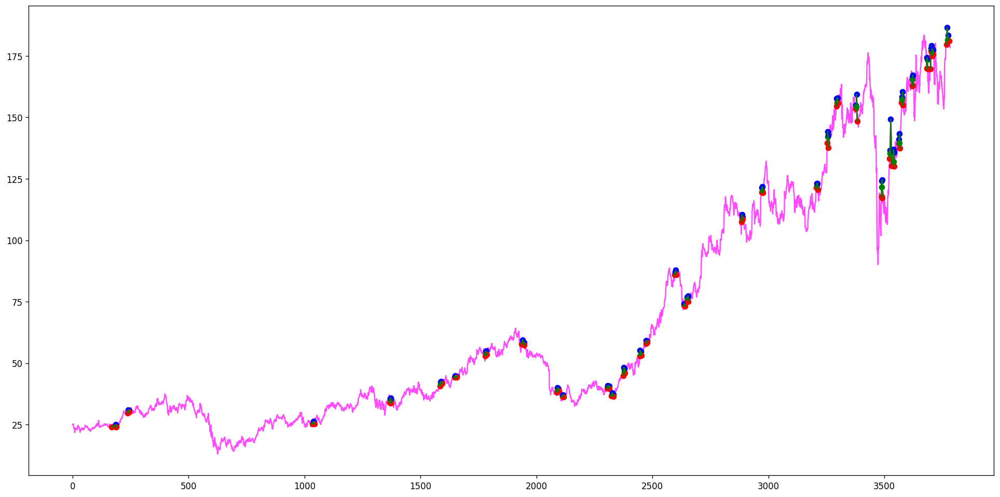

[(240, 242, 243, 246, 248), (546, 549, 554, 556, 557), (813, 817, 820, 827, 831), (1137, 1138, 1142, 1144, 1159), (1489, 1490, 1494, 1504, 1513), (2426, 2429, 2437, 2439, 2441), (2736, 2737, 2738, 2739, 2742), (2979, 2980, 2987, 2990, 2991), (4091, 4094, 4098, 4102, 4103)]
[]
Ticker ADES found 9 double top patterns, 0 double bottom patterns


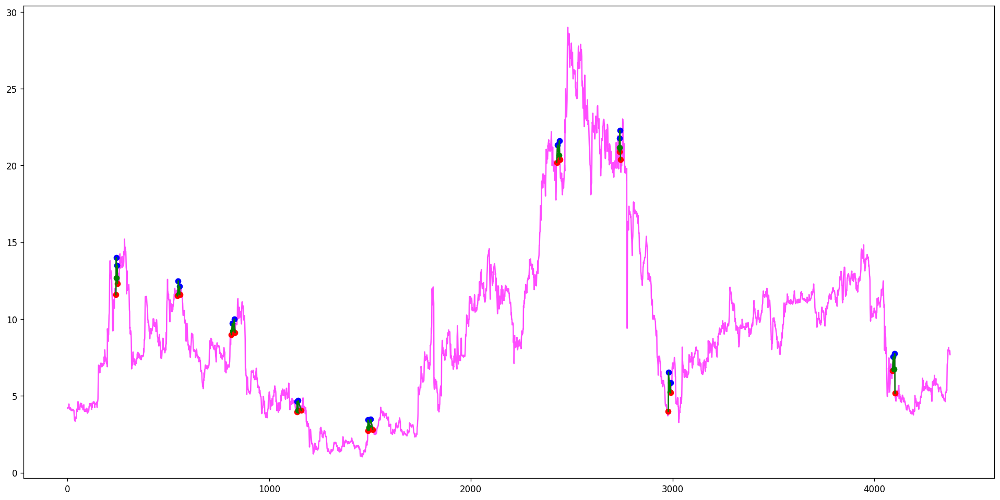

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(33, 36, 38, 40, 42), (60, 62, 63, 64, 66), (73, 74, 75, 76, 77), (101, 102, 106, 107, 108), (225, 226, 227, 228, 230), (379, 380, 381, 382, 383), (407, 409, 410, 411, 412), (420, 421, 422, 423, 424), (420, 423, 424, 425, 426), (429, 430, 432, 433, 434), (481, 482, 483, 485, 488), (514, 515, 516, 518, 523), (517, 518, 521, 522, 523), (539, 540, 541, 542, 543), (605, 606, 607, 608, 609), (609, 611, 612, 613, 614), (670, 671, 672, 673, 674)]
[]
Ticker ADHC found 17 double top patterns, 0 double bottom patterns


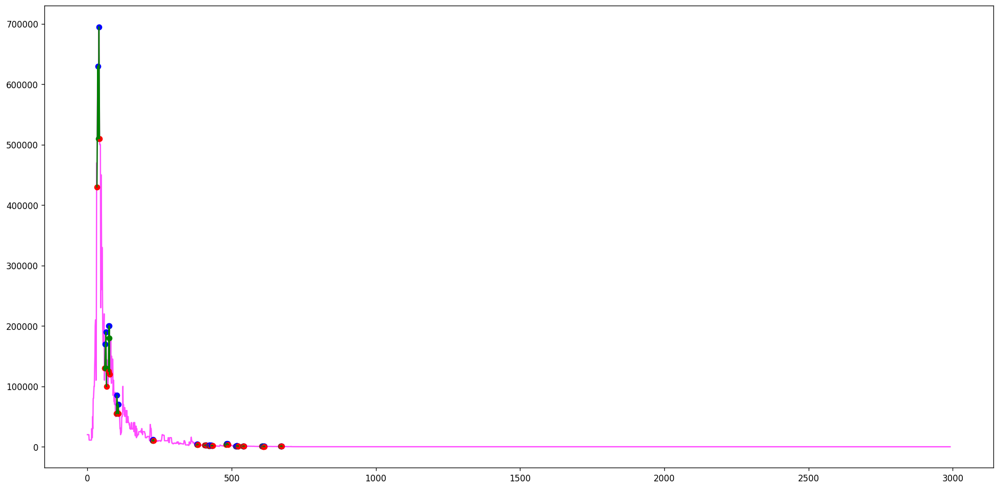

[(8, 9, 10, 11, 13), (23, 24, 25, 27, 28), (115, 116, 117, 118, 119), (128, 129, 131, 135, 138), (299, 300, 301, 302, 303), (324, 326, 329, 330, 331), (334, 335, 336, 337, 338), (355, 356, 357, 360, 364), (383, 384, 386, 387, 388), (408, 409, 410, 411, 412), (412, 416, 419, 420, 421), (466, 467, 469, 470, 471), (590, 591, 592, 594, 598), (723, 725, 726, 727, 728), (789, 791, 793, 794, 795), (831, 832, 833, 837, 839), (928, 929, 930, 932, 933), (945, 949, 952, 954, 956), (1092, 1093, 1095, 1096, 1097), (1222, 1223, 1224, 1226, 1227), (1369, 1370, 1373, 1375, 1377), (2056, 2059, 2060, 2062, 2063), (2095, 2096, 2098, 2105, 2107), (2094, 2105, 2107, 2117, 2121), (2126, 2127, 2129, 2131, 2132), (2236, 2237, 2238, 2239, 2241), (2309, 2311, 2312, 2314, 2316), (2563, 2565, 2567, 2569, 2570), (2614, 2615, 2617, 2619, 2621), (2853, 2855, 2856, 2857, 2859), (2891, 2892, 2893, 2895, 2897), (2962, 2965, 2966, 2967, 2969), (3040, 3041, 3042, 3045, 3046), (3413, 3415, 3421, 3423, 3424), (3478, 3480, 

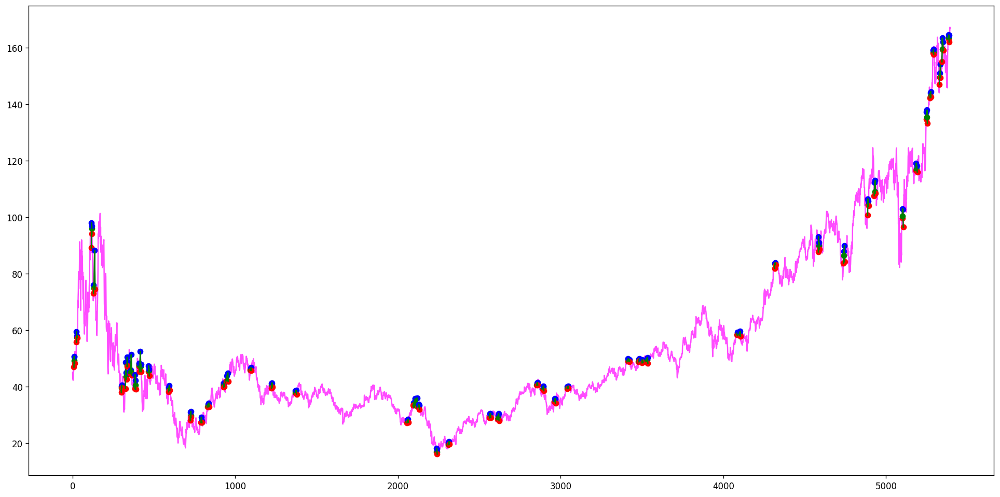

[]
[]
Ticker ADIL found 0 double top patterns, 0 double bottom patterns


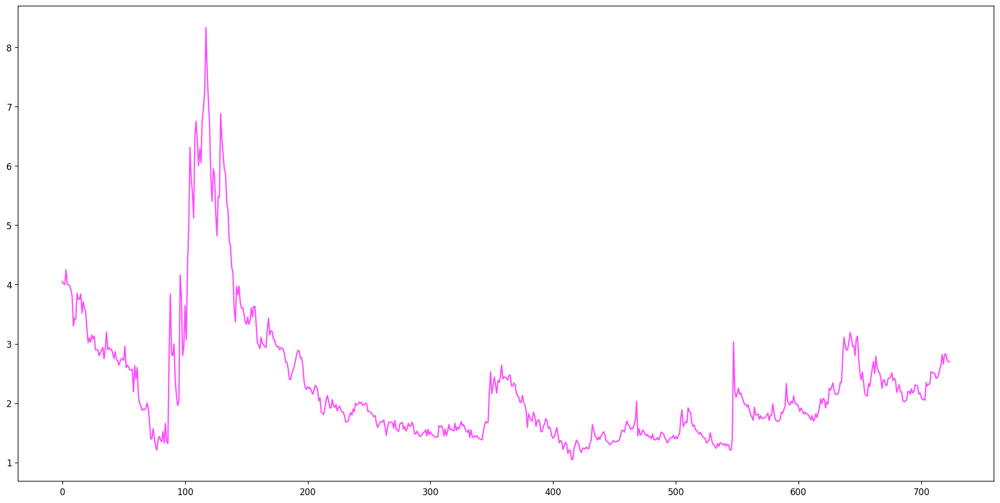

[(50, 52, 59, 66, 75), (283, 287, 288, 289, 299), (1632, 1633, 1634, 1638, 1640), (1823, 1825, 1826, 1829, 1832), (2005, 2008, 2010, 2013, 2014), (2046, 2047, 2048, 2049, 2050), (2093, 2096, 2097, 2098, 2099), (2287, 2288, 2290, 2292, 2293), (2421, 2423, 2425, 2429, 2431), (2502, 2504, 2505, 2511, 2521), (2690, 2692, 2693, 2696, 2698), (2750, 2752, 2757, 2760, 2763), (2803, 2805, 2806, 2808, 2812), (3360, 3361, 3362, 3363, 3366), (3697, 3700, 3703, 3704, 3705), (3823, 3824, 3825, 3827, 3830), (3906, 3909, 3910, 3912, 3913), (4171, 4175, 4181, 4186, 4187), (4235, 4237, 4238, 4240, 4241), (4951, 4956, 4962, 4966, 4968), (5049, 5050, 5051, 5054, 5062), (5070, 5071, 5072, 5073, 5075), (5097, 5099, 5100, 5101, 5102), (5340, 5341, 5342, 5343, 5344)]
[]
Ticker ADM found 24 double top patterns, 0 double bottom patterns


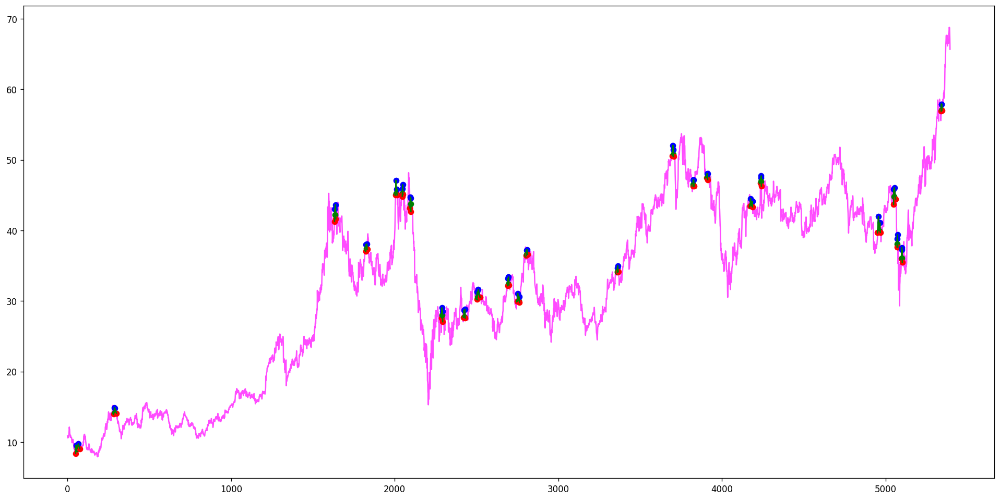

[(448, 450, 457, 461, 472), (772, 774, 782, 784, 786), (1625, 1627, 1637, 1648, 1649)]
[]
Ticker ADMA found 3 double top patterns, 0 double bottom patterns


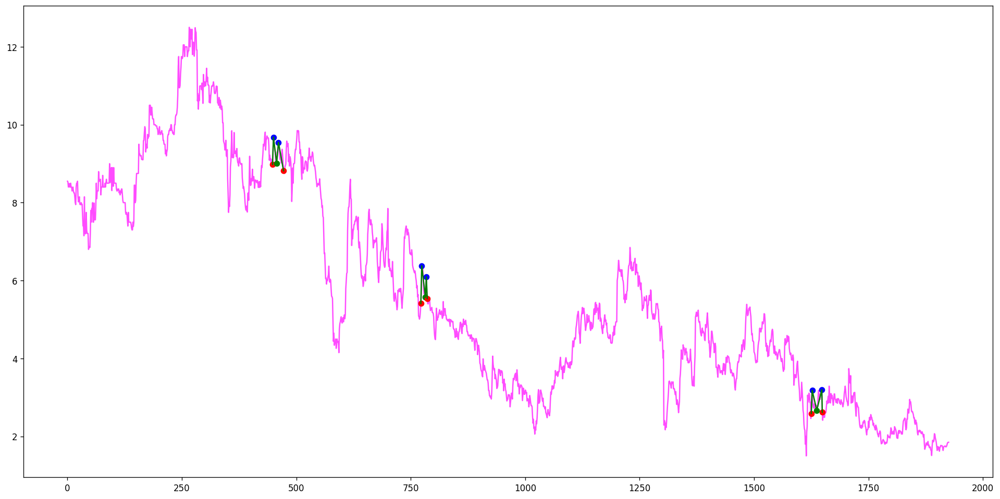

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(11, 12, 13, 15, 22), (14, 15, 16, 17, 18), (30, 31, 32, 34, 37), (40, 43, 45, 46, 47), (45, 46, 47, 48, 49), (53, 54, 55, 57, 60), (64, 66, 70, 71, 72), (125, 126, 127, 128, 129), (127, 128, 129, 130, 131), (136, 137, 139, 140, 141), (151, 152, 153, 155, 159), (168, 169, 172, 173, 179), (193, 194, 195, 196, 197), (205, 208, 212, 213, 214), (202, 203, 204, 208, 217), (205, 208, 214, 215, 217), (204, 208, 217, 220, 222), (217, 218, 219, 220, 222), (217, 220, 222, 223, 224), (227, 228, 229, 230, 231), (231, 233, 237, 238, 241), (237, 238, 239, 240, 241), (250, 251, 252, 253, 255), (252, 253, 255, 256, 258), (255, 256, 258, 260, 262), (266, 267, 268, 269, 284), (312, 313, 315, 316, 317), (324, 325, 326, 327, 328), (345, 346, 348, 349, 353), (348, 349, 351, 352, 353), (361, 362, 363, 364, 365), (365, 366, 367, 370, 372), (387, 388, 389, 390, 391), (413, 414, 415, 418, 420), (410, 412, 413, 418, 426), (431, 432, 433, 435, 437), (431, 435, 437, 438, 440), (447, 448, 449, 450, 451), (451, 45

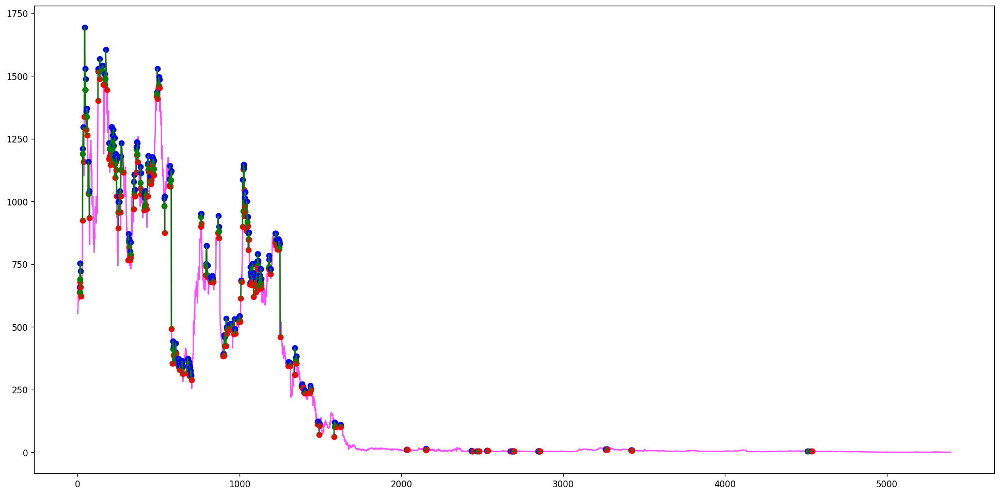

[(117, 121, 122, 124, 125), (155, 157, 159, 160, 161), (306, 307, 308, 309, 310), (371, 373, 374, 375, 376), (419, 423, 427, 429, 430), (781, 784, 785, 786, 787)]
[]
Ticker ADNT found 6 double top patterns, 0 double bottom patterns


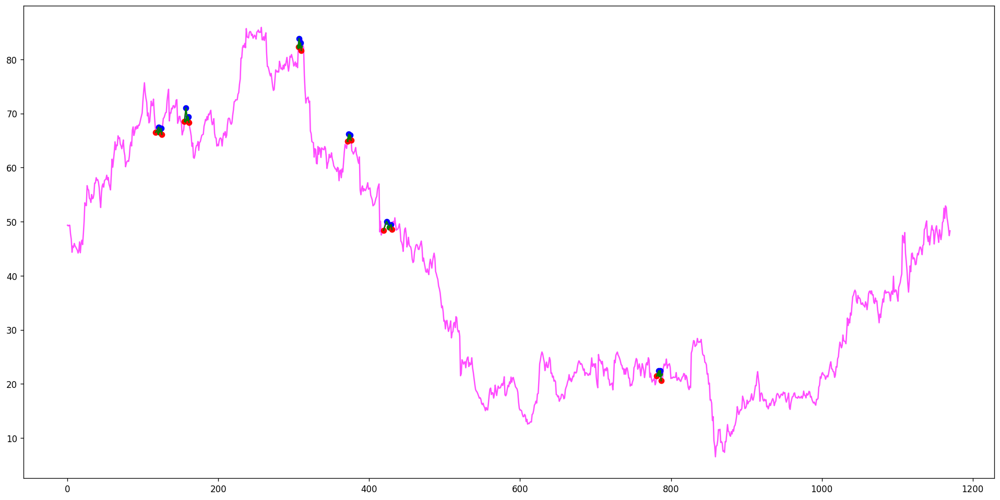

[(37, 38, 39, 40, 41), (194, 195, 196, 197, 198), (208, 209, 211, 212, 213), (275, 278, 280, 281, 283), (470, 471, 473, 475, 477), (492, 494, 495, 498, 499), (703, 704, 705, 706, 708), (719, 721, 723, 725, 727), (1029, 1031, 1033, 1034, 1036), (1074, 1075, 1078, 1081, 1082), (1265, 1266, 1269, 1279, 1283), (1466, 1483, 1484, 1487, 1494), (1966, 1968, 1969, 1972, 1974), (2181, 2182, 2184, 2186, 2187), (2189, 2191, 2193, 2196, 2197), (2312, 2314, 2316, 2317, 2319), (2329, 2330, 2333, 2334, 2336), (2562, 2569, 2571, 2574, 2579), (2614, 2615, 2617, 2619, 2620), (2643, 2648, 2649, 2651, 2652), (3254, 3255, 3256, 3260, 3265), (3360, 3361, 3362, 3363, 3366), (3513, 3519, 3521, 3522, 3523), (3561, 3562, 3563, 3565, 3568), (4088, 4089, 4090, 4091, 4092), (4220, 4223, 4228, 4229, 4232), (4271, 4275, 4276, 4278, 4281), (4396, 4397, 4398, 4399, 4400), (4402, 4403, 4404, 4405, 4407), (4479, 4480, 4482, 4484, 4486), (4537, 4538, 4539, 4541, 4543), (4572, 4574, 4577, 4579, 4580), (4634, 4635, 4636, 4

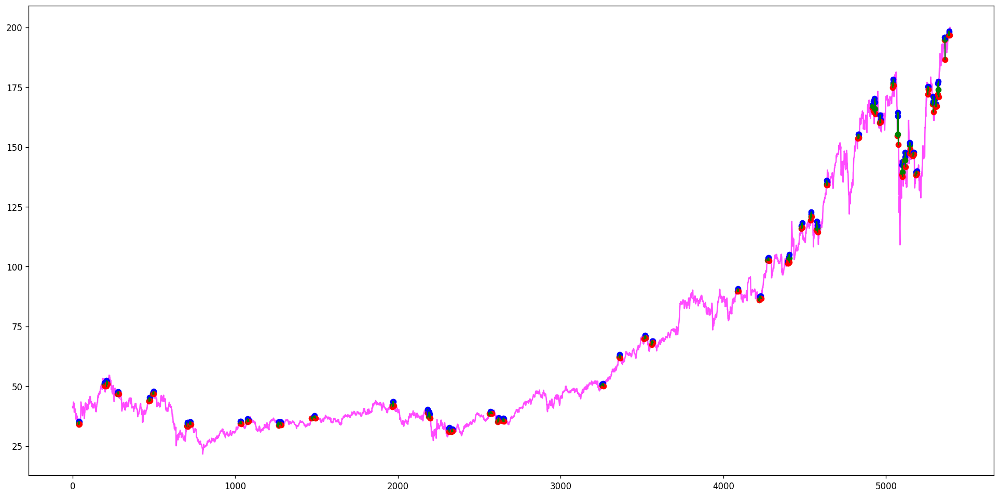

[(9, 10, 11, 12, 13)]
[]
Ticker ADPT found 1 double top patterns, 0 double bottom patterns


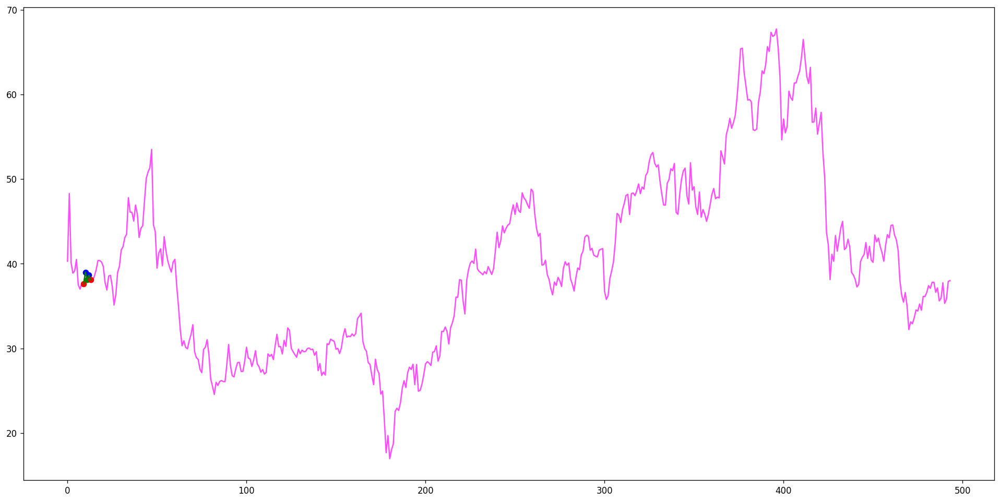

[(228, 231, 235, 236, 237), (343, 344, 346, 348, 350), (438, 440, 442, 445, 446), (493, 494, 495, 500, 503), (659, 661, 662, 664, 665), (728, 731, 732, 733, 734), (1865, 1866, 1869, 1873, 1882), (2644, 2648, 2657, 2666, 2669), (2962, 2974, 2977, 2982, 2983), (3139, 3145, 3151, 3156, 3158), (3558, 3559, 3561, 3564, 3569), (3871, 3873, 3875, 3877, 3887), (4012, 4014, 4016, 4022, 4026), (4222, 4227, 4232, 4234, 4238), (4908, 4922, 4929, 4930, 4934)]
[]
Ticker ADRNY found 15 double top patterns, 0 double bottom patterns


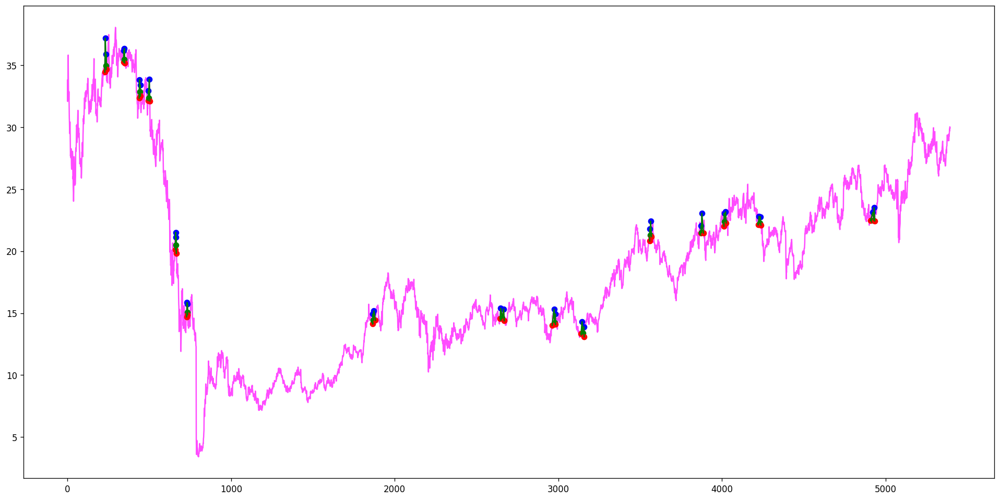

[(102, 105, 106, 109, 114), (192, 194, 195, 197, 198), (331, 332, 333, 334, 335), (727, 729, 731, 732, 733), (727, 730, 731, 732, 733), (1088, 1089, 1090, 1091, 1092), (1116, 1117, 1119, 1120, 1122), (1370, 1375, 1380, 1382, 1385), (1462, 1463, 1464, 1465, 1466), (1485, 1486, 1490, 1498, 1503), (1744, 1746, 1748, 1751, 1752), (1788, 1789, 1790, 1791, 1792), (1854, 1857, 1859, 1860, 1862), (2759, 2760, 2761, 2762, 2763), (2830, 2831, 2832, 2833, 2836), (2922, 2923, 2925, 2926, 2928), (3085, 3086, 3087, 3088, 3089), (3137, 3138, 3139, 3140, 3141), (3153, 3154, 3155, 3156, 3157), (3164, 3166, 3167, 3168, 3170), (3171, 3172, 3173, 3174, 3175), (3189, 3190, 3193, 3194, 3195), (3197, 3199, 3200, 3202, 3203), (3205, 3206, 3207, 3208, 3210), (3276, 3277, 3278, 3279, 3280), (3276, 3279, 3280, 3281, 3282), (3327, 3328, 3329, 3330, 3331), (3336, 3338, 3339, 3341, 3343), (3417, 3422, 3424, 3425, 3426), (3448, 3449, 3450, 3451, 3452), (3523, 3524, 3526, 3527, 3528), (3561, 3562, 3563, 3564, 3565), 

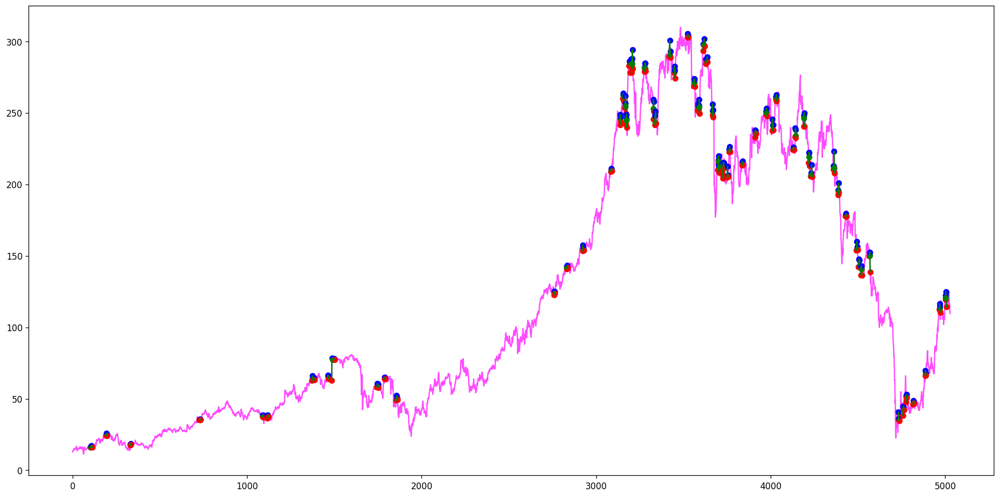

[(45, 47, 53, 54, 59), (324, 326, 328, 346, 347), (333, 340, 343, 346, 347), (537, 541, 543, 559, 562), (1247, 1248, 1251, 1252, 1256), (1579, 1580, 1584, 1585, 1586), (1605, 1608, 1610, 1611, 1613), (1711, 1714, 1715, 1716, 1719), (1908, 1909, 1911, 1912, 1914), (1969, 1970, 1971, 1972, 1974), (1994, 1995, 1996, 1998, 2000), (2169, 2170, 2171, 2172, 2173), (2209, 2210, 2211, 2212, 2213), (2415, 2416, 2417, 2418, 2419), (2439, 2440, 2442, 2443, 2446), (2593, 2595, 2596, 2597, 2598), (2704, 2705, 2706, 2707, 2708), (2724, 2727, 2730, 2732, 2733), (2822, 2823, 2825, 2828, 2834), (2951, 2952, 2953, 2954, 2955), (2964, 2965, 2966, 2967, 2968), (3097, 3098, 3100, 3101, 3103), (3570, 3572, 3573, 3574, 3575), (3745, 3746, 3748, 3750, 3751), (3878, 3879, 3881, 3882, 3885), (3886, 3888, 3889, 3890, 3893), (4140, 4142, 4143, 4144, 4145), (4209, 4211, 4212, 4213, 4214), (4308, 4310, 4311, 4314, 4315), (4331, 4333, 4334, 4338, 4339), (4391, 4392, 4393, 4396, 4398), (4558, 4559, 4560, 4561, 4562), 

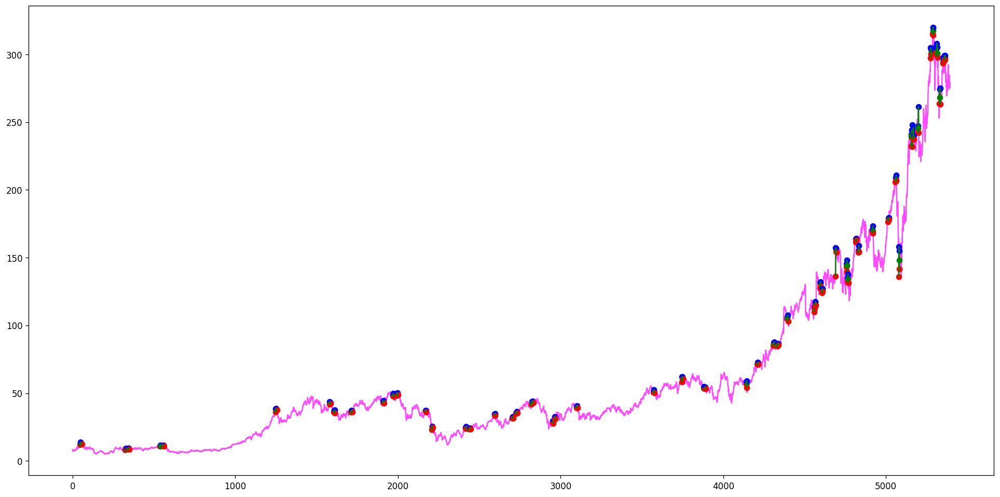

[(119, 124, 135, 139, 140), (119, 127, 135, 139, 140), (203, 204, 206, 210, 212)]
[]
Ticker ADT found 3 double top patterns, 0 double bottom patterns


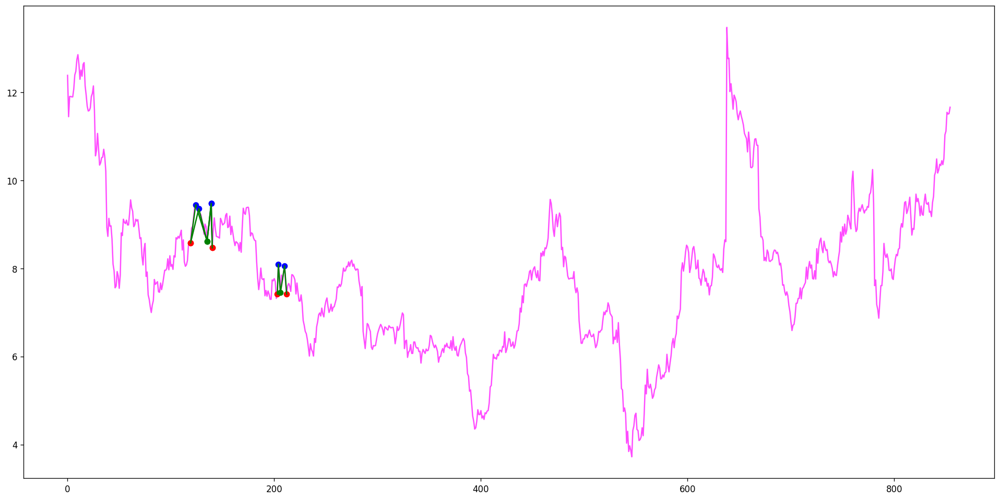

[(473, 474, 475, 477, 478), (578, 579, 580, 582, 584)]
[]
Ticker ADTM found 2 double top patterns, 0 double bottom patterns


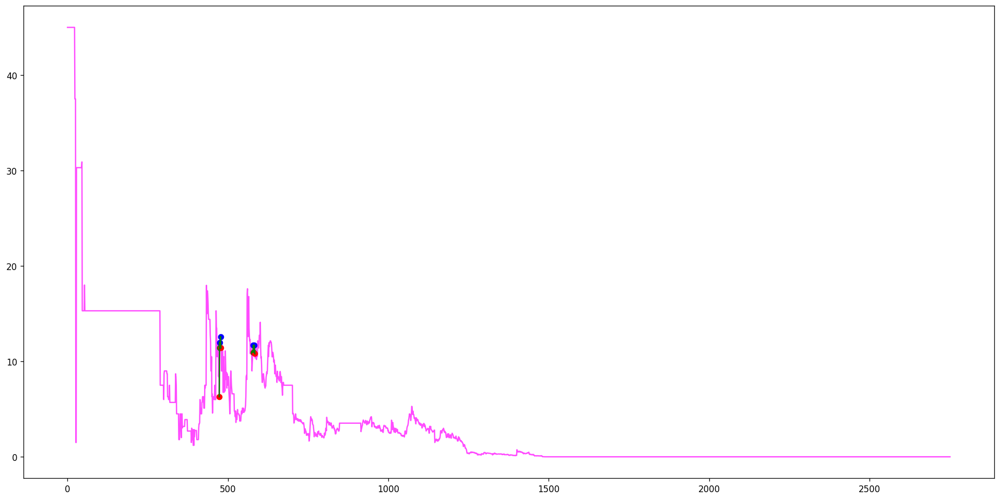

[(66, 67, 68, 69, 70), (104, 106, 107, 109, 110), (202, 203, 206, 207, 208), (262, 263, 266, 267, 268), (355, 358, 359, 360, 361), (448, 450, 452, 454, 457), (473, 475, 477, 478, 479), (632, 634, 642, 643, 648), (632, 638, 642, 643, 648), (920, 921, 922, 923, 924), (928, 929, 930, 932, 934), (1051, 1052, 1053, 1055, 1058), (1463, 1467, 1471, 1475, 1476), (1577, 1579, 1580, 1582, 1584), (2127, 2129, 2130, 2131, 2132), (2137, 2139, 2140, 2142, 2143), (2339, 2340, 2342, 2343, 2347), (2475, 2480, 2481, 2484, 2486), (2996, 2997, 2998, 3000, 3003), (3105, 3107, 3110, 3111, 3112), (3116, 3117, 3118, 3120, 3121), (3438, 3443, 3446, 3448, 3452), (3532, 3534, 3537, 3540, 3542), (3651, 3655, 3667, 3670, 3672), (3831, 3837, 3842, 3843, 3846), (3900, 3905, 3906, 3907, 3914), (4413, 4414, 4415, 4417, 4420), (5318, 5319, 5321, 5322, 5324)]
[]
Ticker ADTN found 28 double top patterns, 0 double bottom patterns


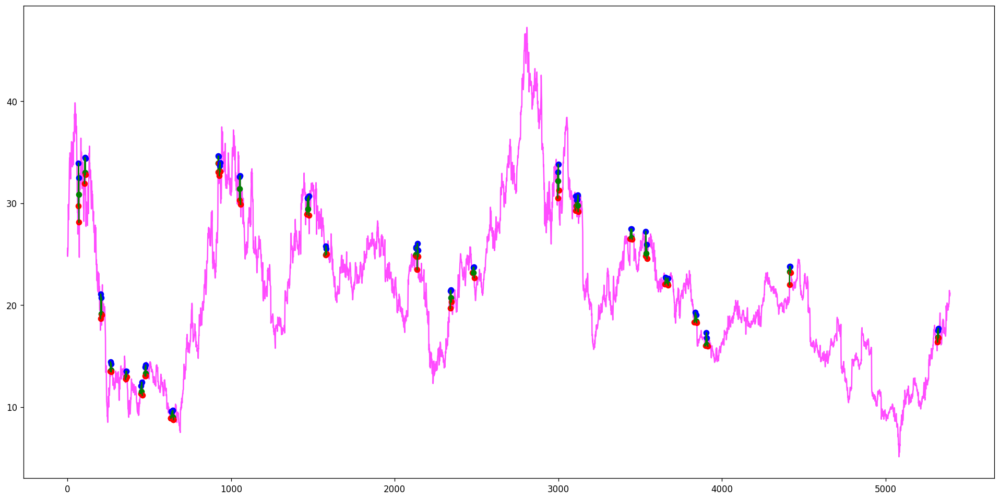

[]
[]
Ticker ADTX found 0 double top patterns, 0 double bottom patterns


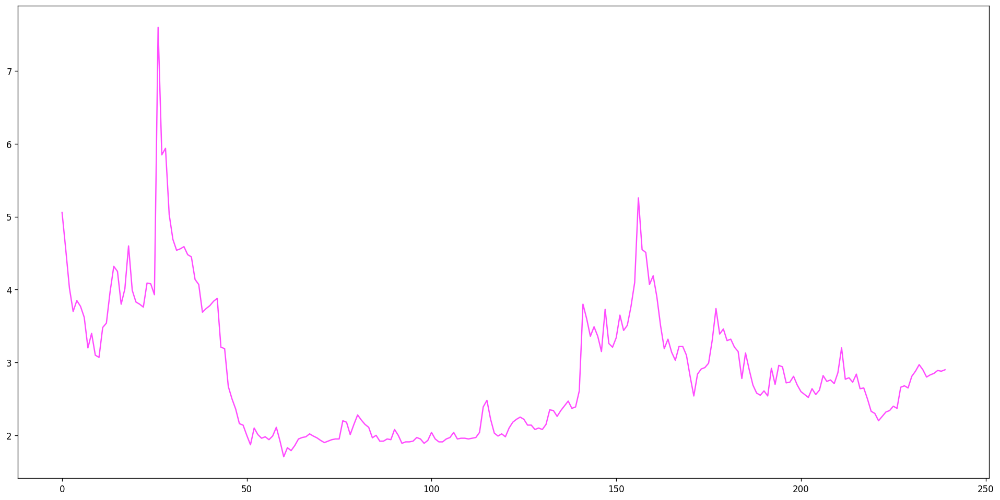

[(171, 172, 173, 174, 175), (902, 904, 908, 912, 914), (1437, 1439, 1440, 1443, 1445), (1461, 1465, 1466, 1468, 1471), (1617, 1618, 1620, 1621, 1625), (1617, 1618, 1620, 1623, 1625), (1673, 1674, 1676, 1680, 1684)]
[]
Ticker ADVM found 7 double top patterns, 0 double bottom patterns


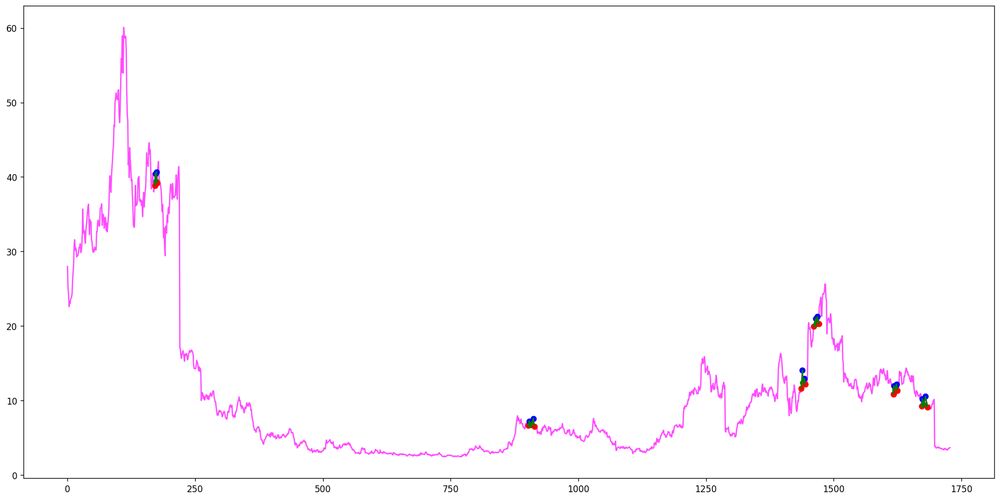

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(5, 11, 19, 25, 31), (5, 17, 19, 25, 31)]
[]
Ticker ADX found 2 double top patterns, 0 double bottom patterns


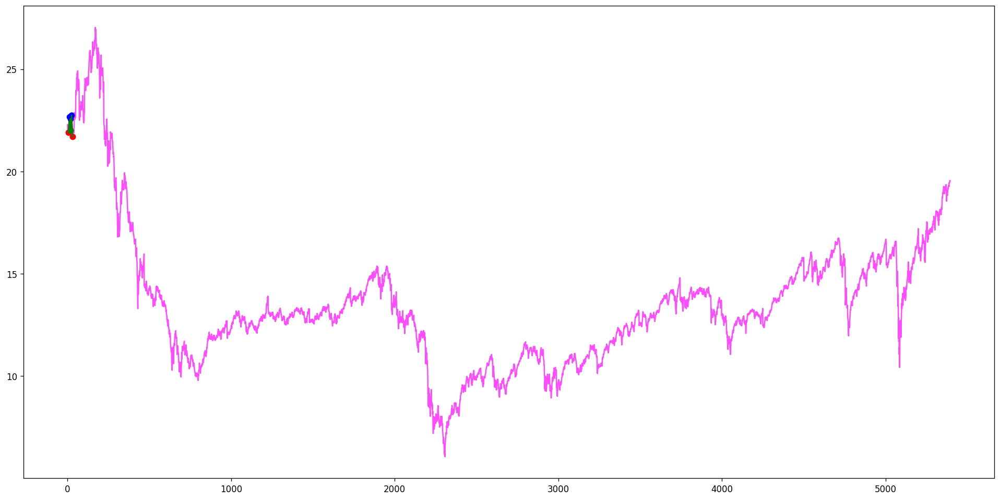

[(212, 214, 215, 217, 218)]
[]
Ticker ADXN found 1 double top patterns, 0 double bottom patterns


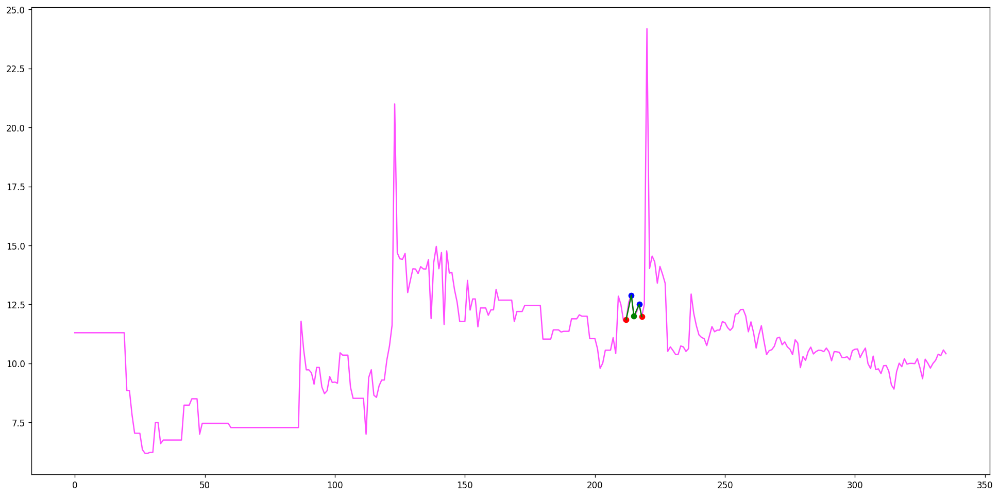

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(34, 35, 36, 38, 40), (40, 43, 47, 48, 49), (65, 66, 67, 71, 73), (67, 71, 73, 74, 75), (87, 88, 89, 90, 91), (92, 93, 94, 95, 96), (125, 126, 127, 128, 130), (195, 196, 197, 200, 201), (211, 212, 213, 214, 215), (213, 214, 215, 216, 217), (259, 260, 261, 263, 269), (284, 286, 287, 288, 289), (291, 293, 297, 298, 299), (317, 318, 319, 320, 321), (336, 337, 338, 339, 340), (352, 353, 356, 360, 365), (372, 373, 374, 376, 378), (389, 390, 391, 392, 393), (431, 432, 433, 435, 438), (475, 476, 477, 479, 489), (493, 494, 496, 497, 499), (496, 497, 499, 500, 501), (523, 524, 525, 526, 527), (539, 540, 541, 544, 549), (584, 585, 586, 587, 588), (755, 756, 757, 758, 759), (763, 769, 770, 772, 774), (964, 965, 966, 967, 968), (981, 984, 985, 986, 987), (1053, 1055, 1057, 1059, 1060), (1062, 1063, 1066, 1068, 1069), (1051, 1052, 1053, 1055, 1070), (1078, 1079, 1081, 1082, 1084), (1119, 1123, 1126, 1127, 1128), (1118, 1123, 1128, 1129, 1130), (1162, 1163, 1165, 1166, 1170), (1196, 1198, 1202, 120

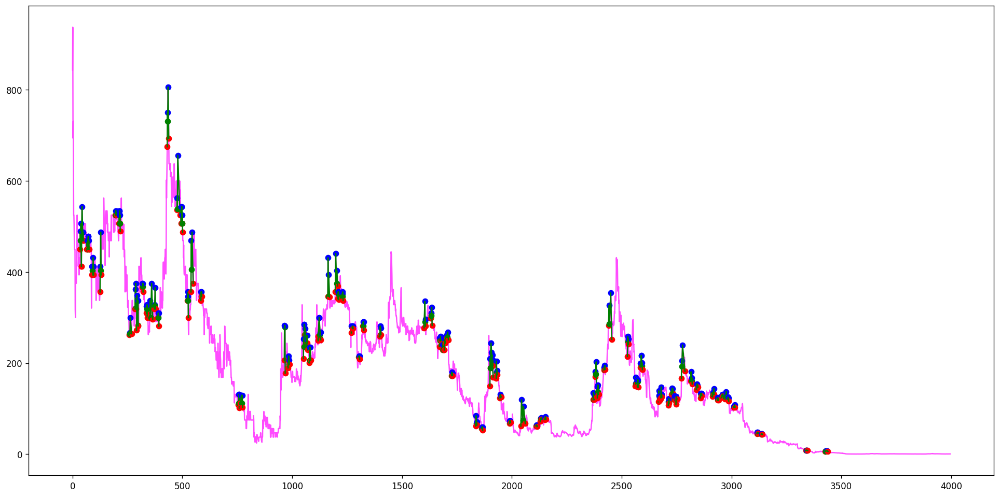

[]
[]
Ticker ADYEY found 0 double top patterns, 0 double bottom patterns


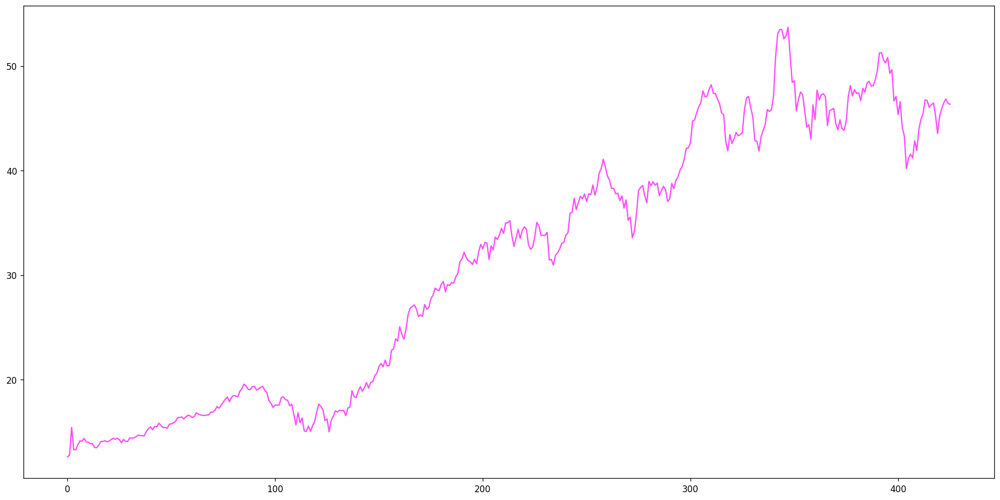

[(844, 845, 846, 847, 849), (868, 869, 870, 871, 872), (902, 903, 904, 905, 906), (898, 905, 906, 909, 911), (950, 953, 955, 956, 957), (974, 975, 976, 978, 979), (982, 984, 985, 988, 989), (981, 988, 990, 992, 996), (1003, 1004, 1005, 1009, 1014), (1016, 1017, 1021, 1022, 1024), (1026, 1028, 1030, 1031, 1032), (1016, 1022, 1024, 1028, 1033), (1024, 1025, 1026, 1028, 1033), (1038, 1039, 1040, 1041, 1042), (1045, 1048, 1050, 1052, 1053), (1037, 1041, 1042, 1048, 1054), (1062, 1063, 1064, 1065, 1067), (1073, 1076, 1078, 1079, 1080), (1106, 1109, 1110, 1111, 1112), (1101, 1104, 1106, 1109, 1115), (1127, 1128, 1129, 1130, 1131), (1127, 1130, 1131, 1133, 1135), (1163, 1164, 1166, 1169, 1170), (1170, 1171, 1174, 1175, 1176), (1163, 1169, 1170, 1171, 1177), (1183, 1186, 1187, 1188, 1190), (1177, 1188, 1192, 1193, 1194), (1204, 1205, 1206, 1207, 1208), (1202, 1207, 1209, 1211, 1212), (1251, 1252, 1253, 1254, 1256), (1256, 1258, 1259, 1260, 1263), (1259, 1260, 1261, 1262, 1263), (1270, 1271, 12

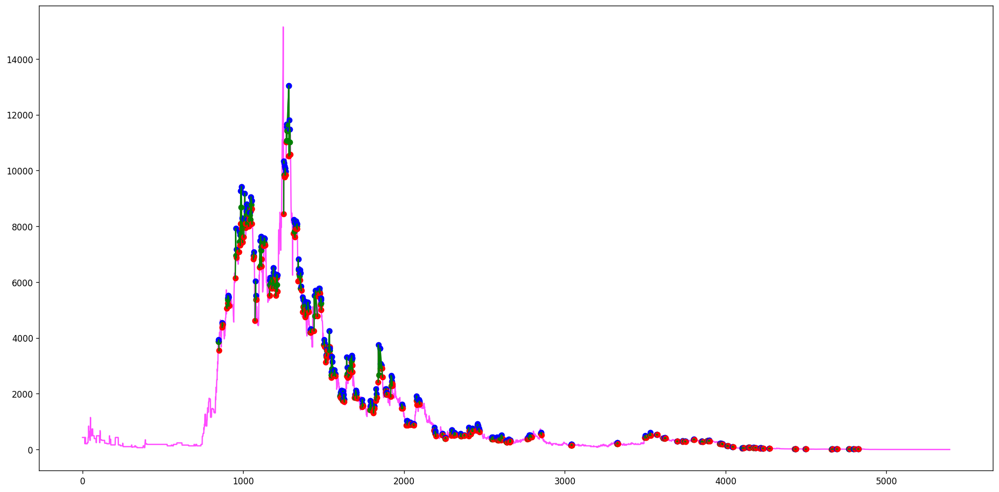

[(97, 101, 104, 105, 106), (151, 152, 154, 155, 158), (154, 155, 156, 157, 158), (204, 205, 206, 207, 208), (214, 215, 216, 219, 220), (223, 224, 225, 226, 227), (233, 234, 235, 237, 238), (243, 244, 245, 246, 247), (243, 246, 247, 248, 251), (251, 252, 253, 255, 257), (278, 279, 280, 281, 282), (301, 302, 303, 304, 305), (305, 306, 307, 308, 309), (314, 315, 317, 318, 319), (366, 367, 368, 371, 374), (369, 371, 372, 373, 374), (379, 381, 382, 383, 384), (490, 491, 492, 494, 496), (526, 527, 528, 529, 530), (530, 531, 532, 533, 534), (542, 544, 545, 548, 549), (551, 554, 555, 558, 559), (573, 574, 575, 576, 577), (577, 578, 579, 580, 581), (581, 585, 589, 590, 592), (577, 580, 581, 585, 595), (601, 602, 604, 605, 606), (606, 607, 608, 609, 612), (608, 609, 610, 611, 612), (612, 613, 614, 615, 616), (632, 633, 634, 638, 641), (635, 638, 639, 640, 641), (650, 651, 652, 655, 658), (668, 669, 670, 671, 672), (668, 671, 672, 674, 676), (687, 688, 689, 691, 693), (702, 704, 705, 706, 709), (

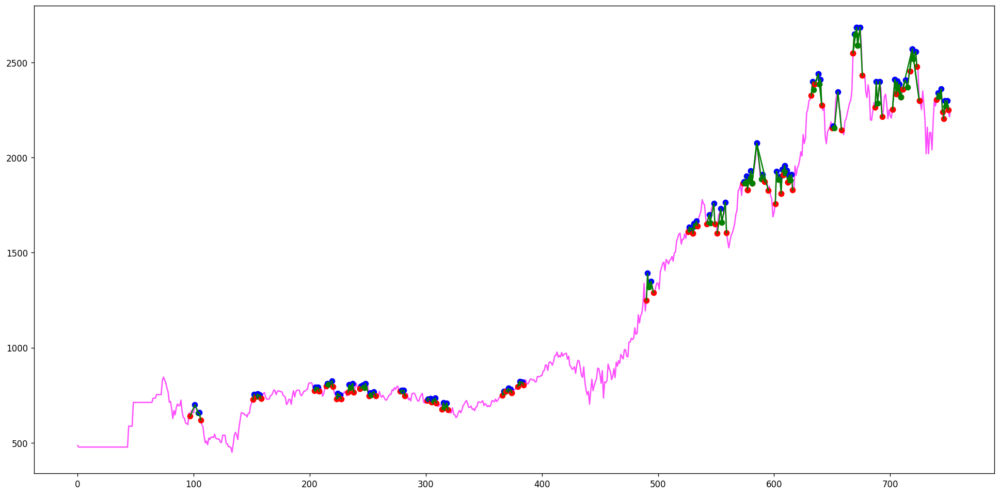

[(100, 102, 103, 105, 106), (171, 172, 173, 175, 188), (560, 568, 572, 576, 586), (1381, 1382, 1384, 1387, 1390), (1680, 1683, 1685, 1686, 1688), (1703, 1706, 1707, 1710, 1712), (1797, 1799, 1800, 1802, 1803), (1829, 1830, 1831, 1832, 1833), (2056, 2059, 2060, 2063, 2064), (2434, 2436, 2438, 2440, 2444), (2543, 2544, 2545, 2546, 2551), (2740, 2742, 2744, 2747, 2749), (2973, 2976, 2977, 2979, 2980), (3361, 3362, 3363, 3365, 3366), (3672, 3673, 3674, 3676, 3677), (3677, 3678, 3679, 3681, 3682), (3936, 3937, 3938, 3939, 3940), (3976, 3977, 3979, 3980, 3981), (3992, 3993, 3996, 3997, 3999), (4118, 4121, 4122, 4123, 4125), (4146, 4149, 4151, 4152, 4153), (4248, 4250, 4251, 4252, 4254), (4258, 4259, 4260, 4261, 4262), (4304, 4305, 4306, 4307, 4311), (4336, 4337, 4338, 4340, 4341), (4573, 4575, 4576, 4577, 4578), (4635, 4636, 4637, 4638, 4639), (4665, 4667, 4669, 4670, 4671), (4971, 4972, 4973, 4975, 4979), (5098, 5099, 5100, 5101, 5103), (5251, 5252, 5253, 5254, 5257), (5291, 5292, 5293, 529

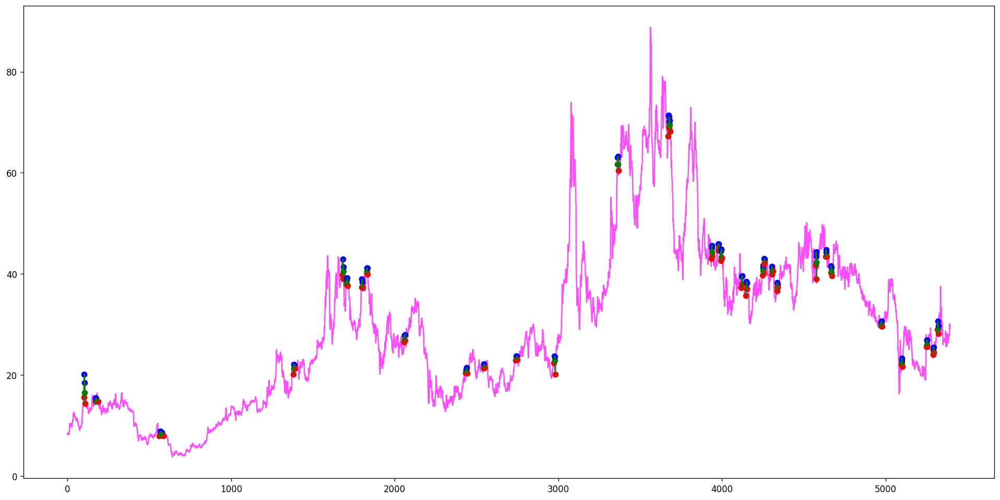

[(1128, 1130, 1131, 1133, 1138)]
[]
Ticker AEB found 1 double top patterns, 0 double bottom patterns


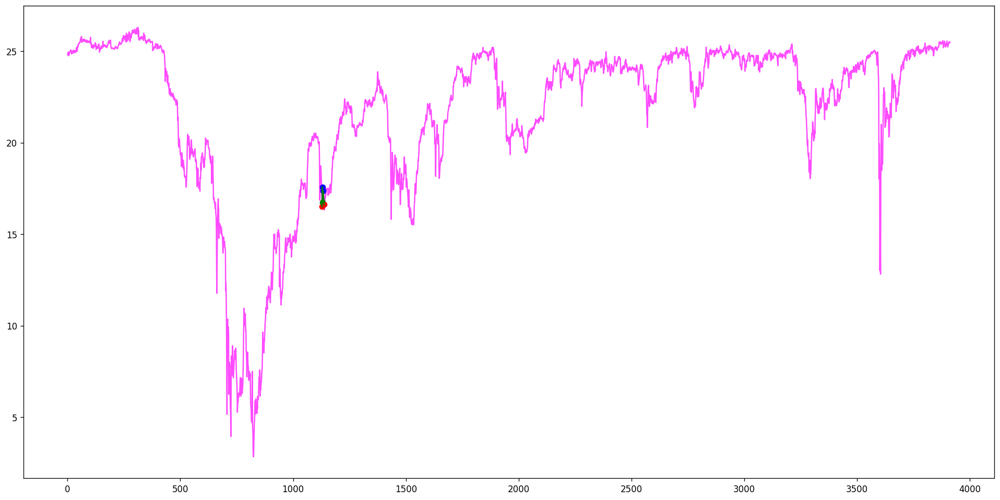

[(113, 114, 119, 121, 122), (614, 618, 620, 623, 626), (699, 700, 701, 702, 703), (849, 851, 853, 857, 860), (948, 966, 969, 971, 973), (1215, 1216, 1217, 1222, 1225), (1491, 1505, 1507, 1508, 1510), (1963, 1968, 1969, 1972, 1973), (2133, 2135, 2138, 2139, 2142), (2614, 2616, 2617, 2619, 2621), (3096, 3101, 3105, 3108, 3113), (3160, 3163, 3166, 3168, 3177), (3246, 3248, 3250, 3251, 3258), (3685, 3687, 3688, 3691, 3693), (3763, 3770, 3775, 3777, 3778), (3971, 3976, 3977, 3979, 3981), (3987, 3990, 3992, 3993, 3994), (4103, 4113, 4119, 4120, 4122), (4343, 4348, 4351, 4353, 4358), (4376, 4381, 4387, 4393, 4396), (4494, 4496, 4502, 4507, 4510), (4669, 4670, 4672, 4673, 4674), (4729, 4730, 4732, 4733, 4735), (4760, 4764, 4766, 4767, 4768), (5097, 5099, 5100, 5101, 5102), (5173, 5175, 5176, 5177, 5178), (5195, 5198, 5199, 5200, 5203), (5265, 5266, 5267, 5268, 5271), (5311, 5312, 5313, 5315, 5316), (5331, 5332, 5334, 5336, 5337)]
[]
Ticker AEE found 30 double top patterns, 0 double bottom patt

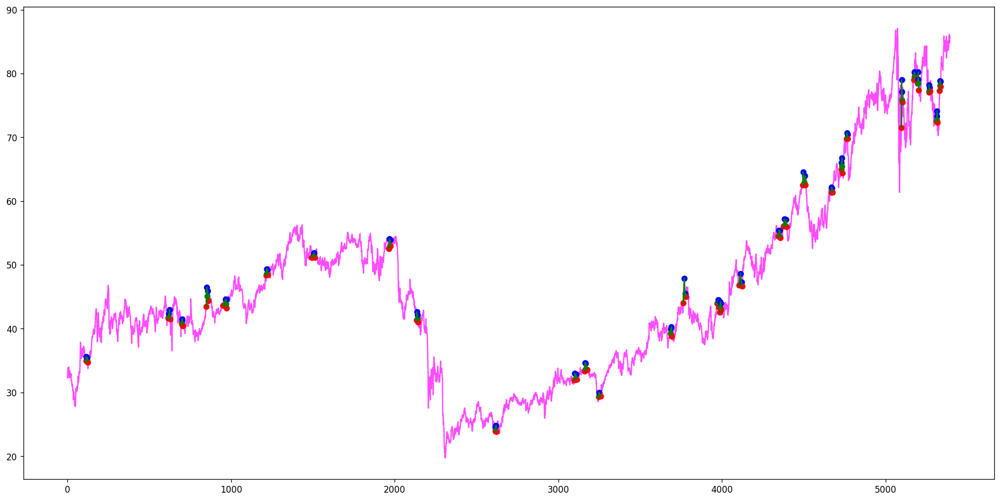

[(1229, 1237, 1241, 1245, 1246), (1478, 1482, 1494, 1498, 1499), (1508, 1510, 1512, 1513, 1518), (1665, 1668, 1672, 1676, 1689), (1862, 1864, 1867, 1872, 1875), (2773, 2776, 2779, 2783, 2786), (2773, 2777, 2779, 2783, 2786), (2843, 2849, 2851, 2857, 2862)]
[]
Ticker AEF found 8 double top patterns, 0 double bottom patterns


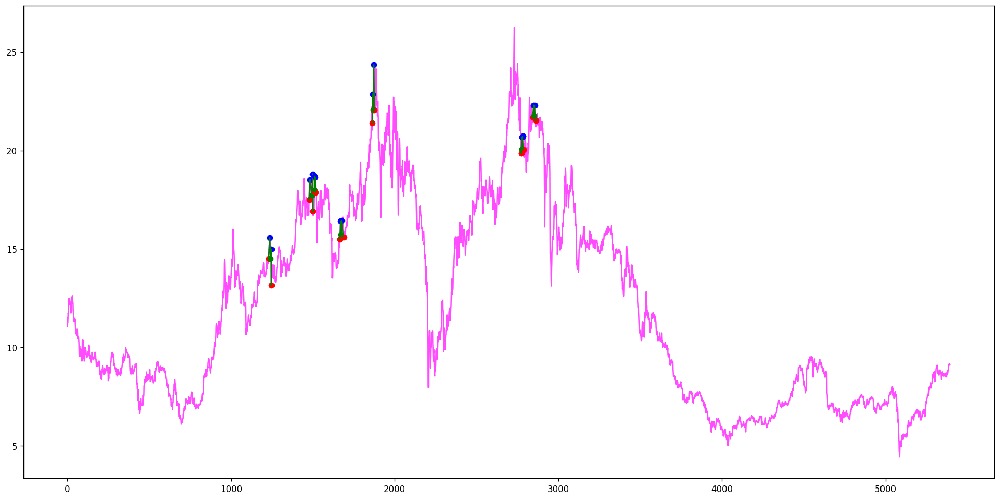

[]
[]
Ticker AEFC found 0 double top patterns, 0 double bottom patterns


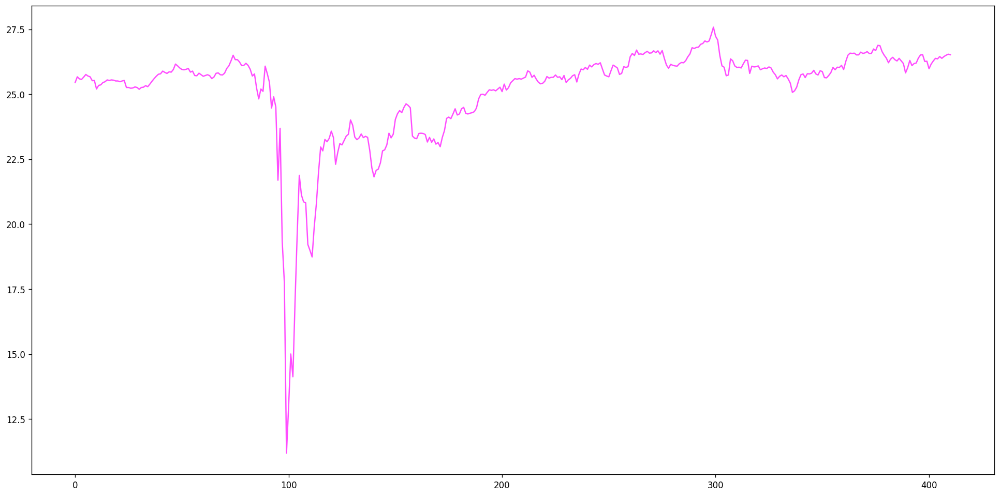

[(154, 155, 156, 158, 159), (161, 163, 164, 165, 168), (308, 310, 312, 314, 315), (331, 333, 334, 335, 336), (404, 407, 412, 415, 420), (460, 463, 473, 474, 481), (510, 511, 512, 515, 519), (550, 552, 556, 561, 565), (1662, 1665, 1669, 1676, 1679), (2277, 2280, 2285, 2288, 2289), (2316, 2317, 2318, 2320, 2322)]
[]
Ticker AEG found 11 double top patterns, 0 double bottom patterns


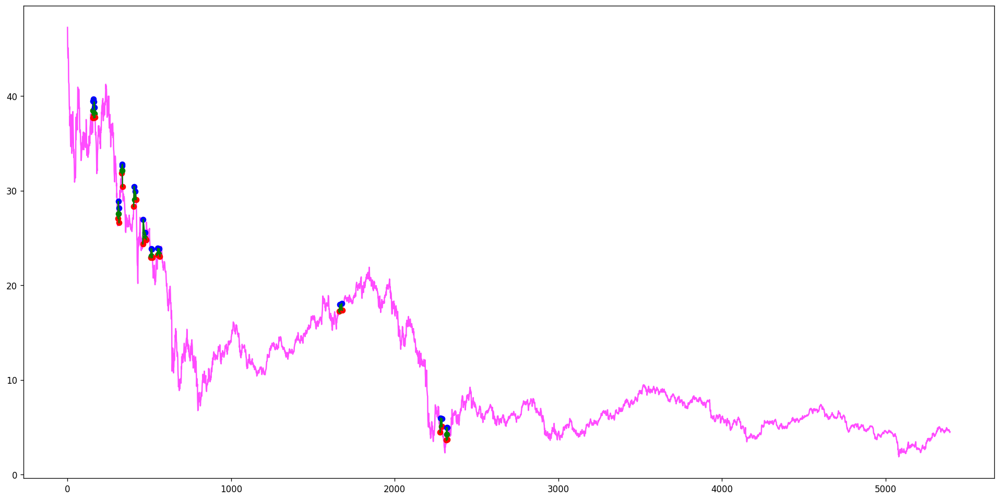

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[]
[]
Ticker AEGY found 0 double top patterns, 0 double bottom patterns


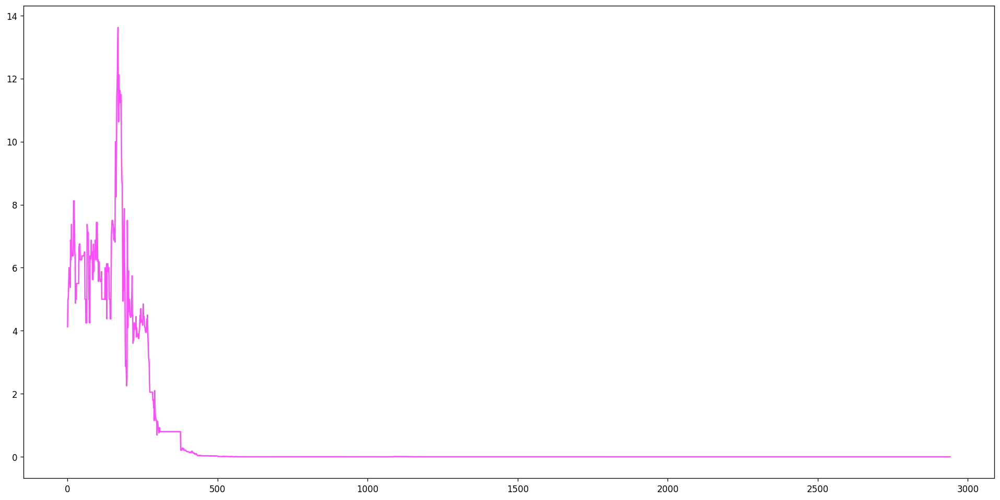

[(233, 234, 235, 236, 237), (814, 815, 816, 817, 818), (905, 906, 907, 908, 909), (919, 920, 921, 922, 924), (1216, 1217, 1218, 1219, 1220), (1279, 1280, 1281, 1282, 1283), (1331, 1332, 1333, 1336, 1341), (1354, 1355, 1357, 1359, 1360), (1549, 1551, 1552, 1553, 1554), (1593, 1594, 1595, 1596, 1597), (1841, 1842, 1843, 1845, 1846), (1914, 1915, 1917, 1918, 1919), (2026, 2027, 2028, 2029, 2031), (2468, 2469, 2472, 2473, 2483), (2734, 2736, 2738, 2741, 2744), (2789, 2790, 2793, 2794, 2813)]
[]
Ticker AEHL found 16 double top patterns, 0 double bottom patterns


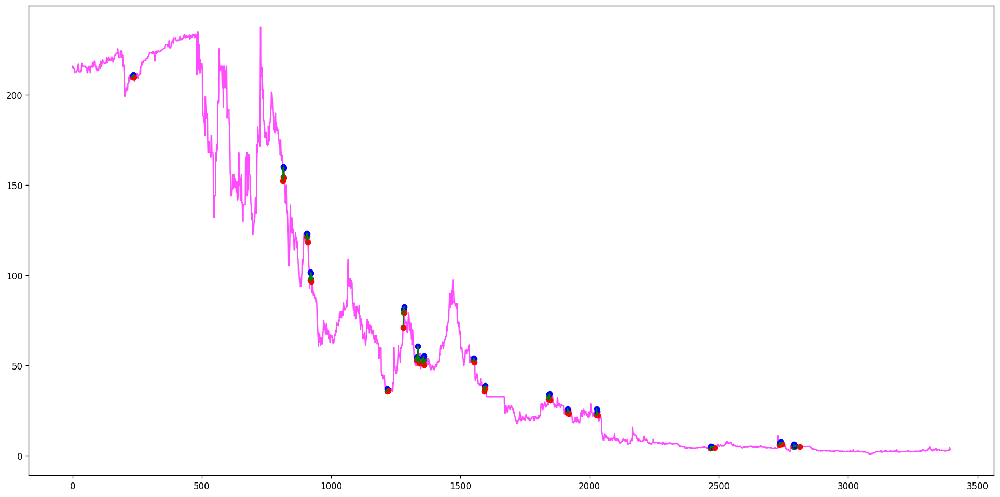

[(123, 124, 125, 126, 127), (131, 134, 136, 138, 146), (131, 134, 136, 140, 146), (250, 251, 253, 255, 260), (250, 251, 266, 267, 270), (2037, 2041, 2042, 2049, 2052), (2803, 2814, 2820, 2823, 2831)]
[]
Ticker AEHR found 7 double top patterns, 0 double bottom patterns


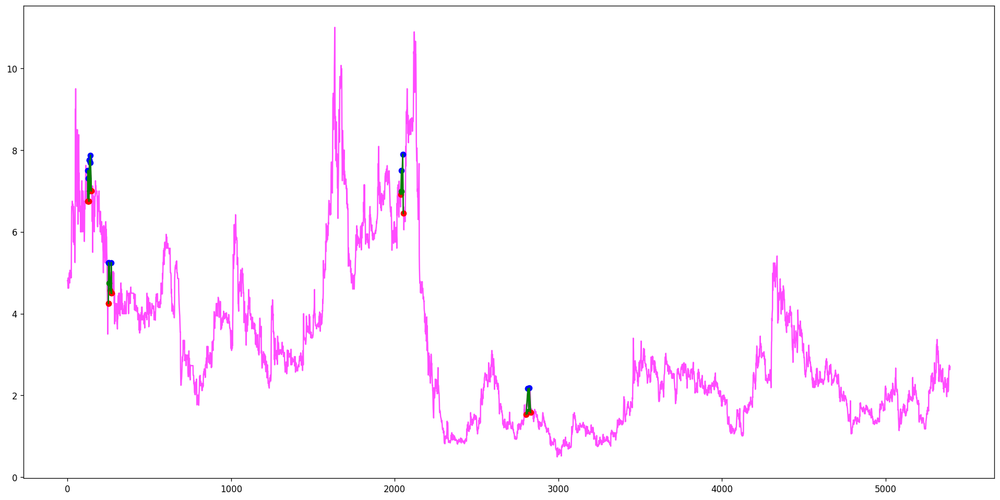

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(64, 66, 68, 69, 70), (394, 396, 397, 398, 401), (550, 552, 553, 555, 557), (570, 571, 577, 578, 579), (781, 783, 787, 791, 793), (890, 894, 896, 897, 902), (1005, 1007, 1009, 1010, 1011), (1087, 1089, 1092, 1093, 1095), (1649, 1652, 1653, 1655, 1657), (1836, 1837, 1838, 1843, 1847), (1892, 1893, 1894, 1895, 1897), (2164, 2165, 2166, 2167, 2171), (2333, 2335, 2336, 2338, 2339), (2937, 2938, 2940, 2945, 2949), (3124, 3128, 3131, 3135, 3140), (3124, 3130, 3131, 3135, 3140), (3412, 3414, 3416, 3417, 3419), (3493, 3494, 3497, 3498, 3500), (3845, 3848, 3851, 3852, 3853), (3920, 3921, 3922, 3924, 3925), (3994, 4010, 4012, 4014, 4016), (4126, 4134, 4136, 4138, 4140), (4412, 4413, 4417, 4418, 4419), (4430, 4431, 4432, 4433, 4434), (4499, 4501, 4502, 4503, 4504), (5098, 5099, 5100, 5101, 5102), (5205, 5207, 5212, 5213, 5214), (5229, 5231, 5233, 5235, 5236), (5264, 5265, 5266, 5267, 5268), (5270, 5271, 5273, 5274, 5275), (5293, 5294, 5295, 5296, 5297), (5291, 5292, 5293, 5294, 5298), (5331, 533

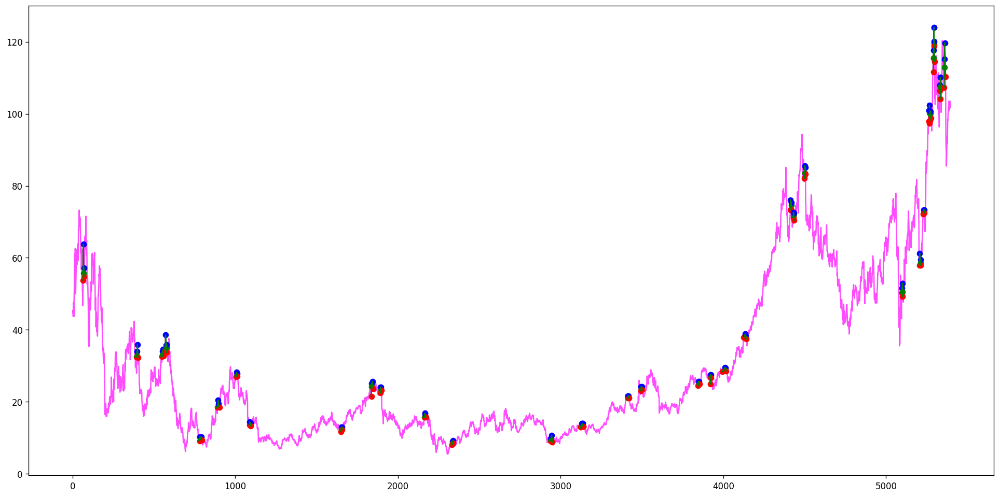

[(1177, 1182, 1189, 1194, 1202), (1649, 1650, 1656, 1659, 1664), (1649, 1650, 1656, 1661, 1664), (1898, 1914, 1917, 1920, 1923), (2606, 2613, 2615, 2617, 2618), (2777, 2779, 2780, 2786, 2790), (2938, 2940, 2941, 2943, 2946), (3138, 3144, 3145, 3146, 3150), (3281, 3284, 3290, 3295, 3296), (3281, 3287, 3290, 3295, 3296), (3654, 3657, 3661, 3662, 3665), (3886, 3887, 3888, 3890, 3892), (4103, 4104, 4105, 4106, 4107), (4189, 4190, 4191, 4193, 4194), (4196, 4198, 4201, 4202, 4203)]
[]
Ticker AEL found 15 double top patterns, 0 double bottom patterns


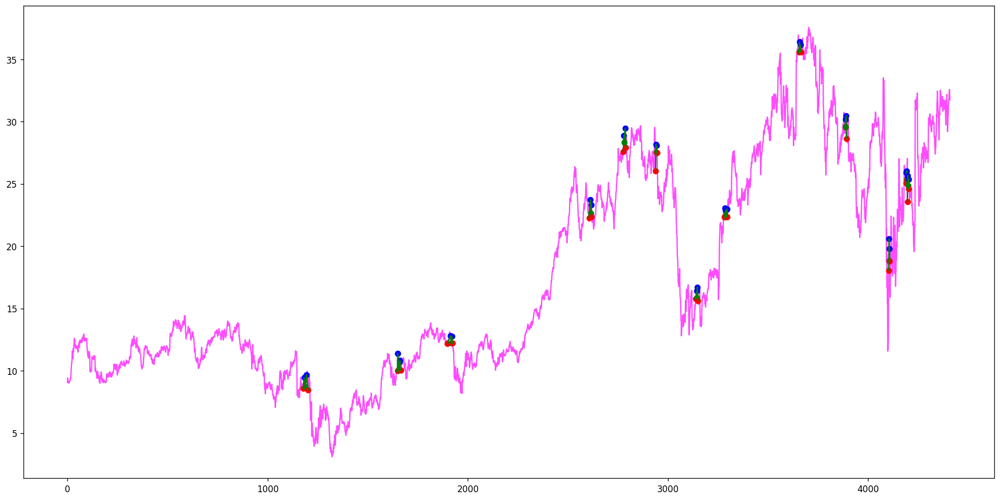

[(22, 23, 25, 27, 41), (25, 27, 32, 35, 41), (253, 256, 264, 265, 269), (423, 429, 439, 441, 443), (584, 585, 586, 590, 591), (1118, 1123, 1127, 1133, 1143), (1161, 1163, 1169, 1170, 1173), (1215, 1217, 1218, 1222, 1234), (1527, 1529, 1530, 1531, 1532), (1637, 1638, 1640, 1641, 1642), (1772, 1773, 1774, 1775, 1776), (1901, 1902, 1904, 1906, 1907), (1969, 1970, 1971, 1972, 1974), (1976, 1978, 1979, 1980, 1981), (1981, 1982, 1983, 1984, 1985), (2105, 2106, 2107, 2109, 2110), (2191, 2192, 2193, 2194, 2195), (2222, 2223, 2225, 2227, 2229), (2235, 2240, 2241, 2242, 2243), (2363, 2364, 2365, 2366, 2367), (2436, 2437, 2438, 2440, 2442), (2543, 2544, 2545, 2546, 2547), (2553, 2555, 2556, 2557, 2559), (2612, 2613, 2614, 2615, 2617), (2830, 2831, 2833, 2834, 2835), (2898, 2899, 2900, 2902, 2903), (2935, 2936, 2937, 2939, 2941), (3018, 3019, 3020, 3024, 3026), (3242, 3244, 3245, 3247, 3249), (3253, 3254, 3255, 3256, 3257), (3372, 3373, 3374, 3376, 3377), (3391, 3393, 3394, 3395, 3396), (3424, 342

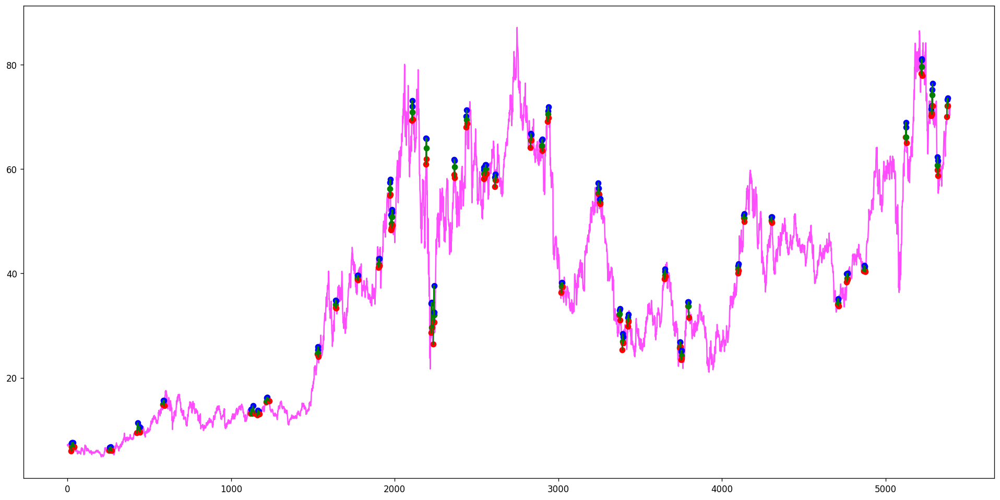

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(451, 452, 453, 454, 455), (553, 554, 555, 556, 557), (567, 569, 570, 571, 574), (952, 953, 954, 955, 959), (1056, 1057, 1058, 1059, 1060), (1190, 1197, 1199, 1200, 1201), (1221, 1223, 1224, 1225, 1226), (1226, 1229, 1231, 1232, 1233), (1233, 1235, 1236, 1237, 1239), (1226, 1229, 1233, 1235, 1242), (1280, 1281, 1282, 1283, 1284), (1326, 1327, 1328, 1329, 1330), (1459, 1461, 1464, 1466, 1467), (1478, 1479, 1480, 1481, 1482), (1480, 1481, 1482, 1483, 1485), (1513, 1514, 1515, 1516, 1517), (1518, 1519, 1520, 1521, 1523), (1541, 1542, 1543, 1545, 1551), (1593, 1594, 1596, 1598, 1599), (1610, 1612, 1613, 1614, 1618), (1647, 1648, 1649, 1650, 1651), (1656, 1657, 1658, 1659, 1660), (1660, 1661, 1662, 1664, 1665), (1670, 1671, 1672, 1674, 1681), (1747, 1748, 1751, 1755, 1757), (1751, 1755, 1757, 1758, 1759), (1764, 1765, 1766, 1767, 1768), (1771, 1772, 1773, 1774, 1778), (1778, 1779, 1780, 1783, 1786), (1792, 1793, 1794, 1795, 1796), (1791, 1795, 1796, 1797, 1798), (1810, 1812, 1813, 1817, 18

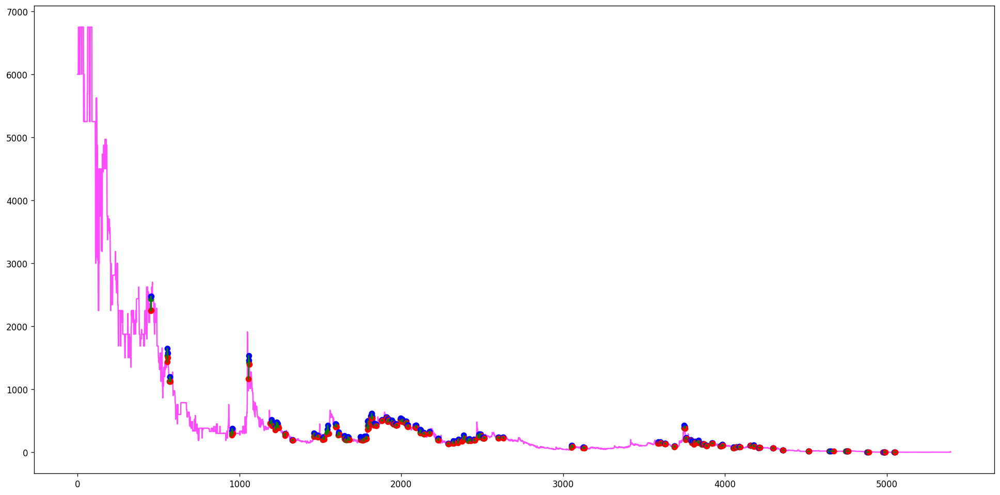

[(181, 188, 197, 200, 203)]
[]
Ticker AENZ found 1 double top patterns, 0 double bottom patterns


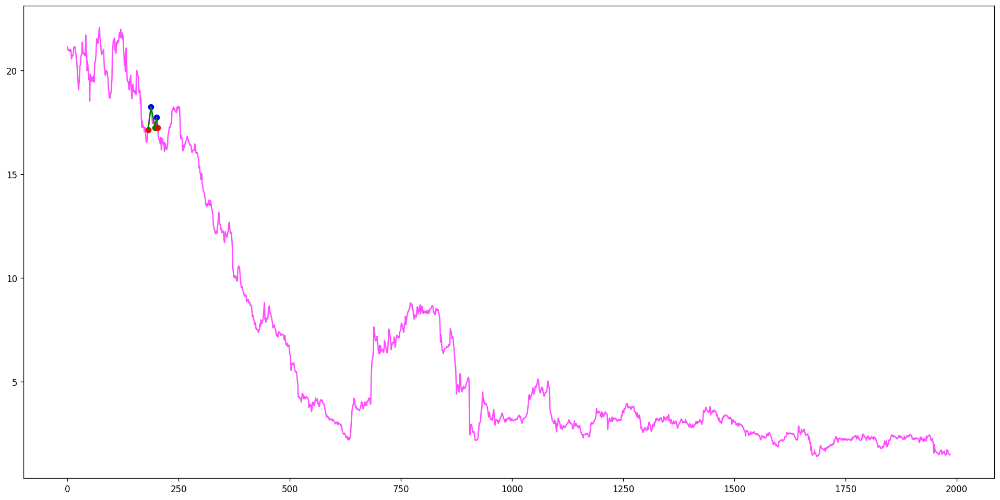

[(170, 174, 177, 178, 180), (396, 400, 401, 402, 403), (480, 482, 483, 484, 487), (630, 631, 632, 633, 635), (1116, 1125, 1131, 1140, 1142), (1116, 1127, 1131, 1140, 1142), (1165, 1177, 1178, 1182, 1190), (1165, 1177, 1178, 1183, 1190), (1165, 1177, 1178, 1184, 1190), (1215, 1216, 1220, 1222, 1227), (1294, 1300, 1301, 1302, 1303), (1516, 1519, 1520, 1522, 1524), (1610, 1612, 1613, 1618, 1619), (1848, 1851, 1853, 1854, 1855), (1964, 1968, 1969, 1972, 1973), (1961, 1972, 1973, 1974, 1976), (2081, 2082, 2086, 2087, 2088), (2193, 2195, 2197, 2199, 2200), (2217, 2218, 2219, 2220, 2222), (2261, 2263, 2266, 2267, 2268), (2499, 2501, 2509, 2512, 2516), (2806, 2808, 2809, 2812, 2816), (2887, 2898, 2902, 2905, 2911), (2966, 2981, 2983, 2985, 2989), (3604, 3605, 3606, 3607, 3609), (3697, 3698, 3700, 3701, 3703), (3803, 3804, 3805, 3808, 3809), (3823, 3824, 3825, 3827, 3829), (3899, 3900, 3905, 3907, 3910), (3988, 3990, 3992, 3993, 3994), (4297, 4299, 4303, 4304, 4306), (4439, 4441, 4445, 4446, 44

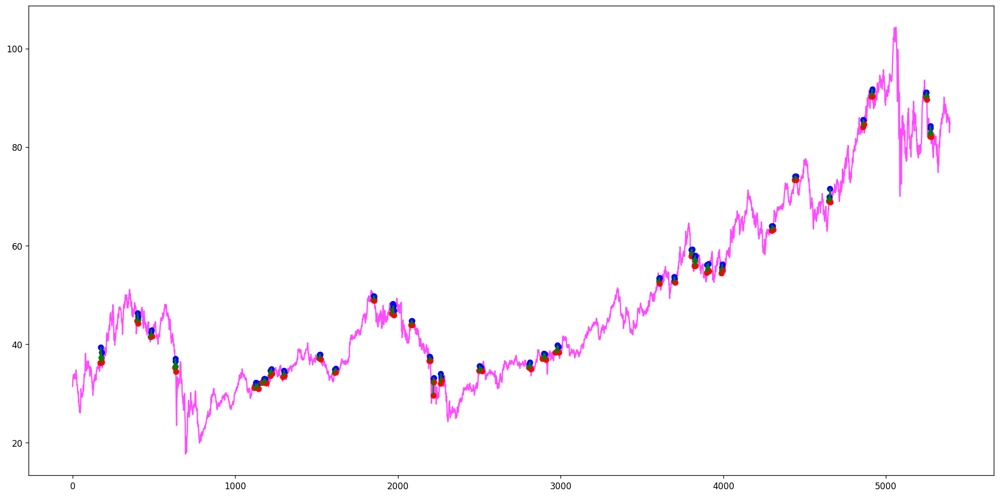

[(218, 223, 225, 233, 237), (277, 278, 279, 282, 285), (401, 403, 405, 408, 410)]
[]
Ticker AEPPL found 3 double top patterns, 0 double bottom patterns


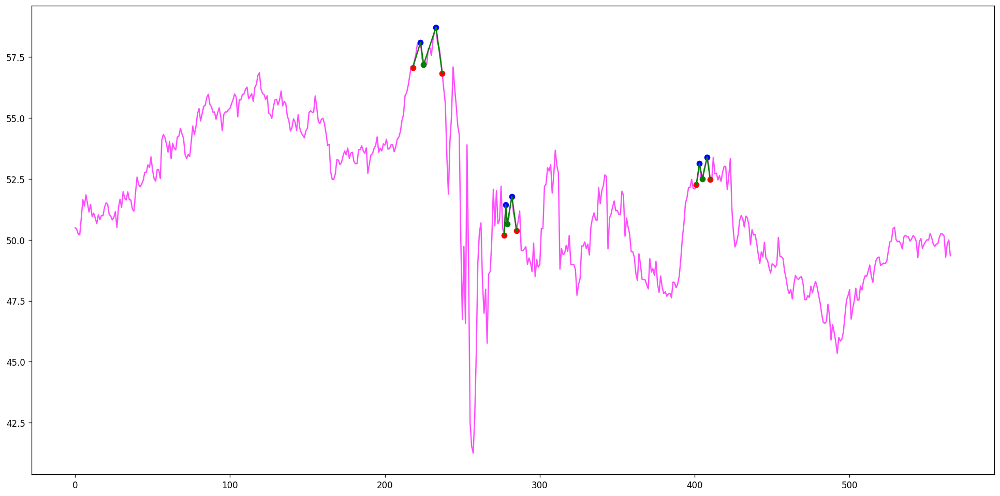

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(12, 13, 16, 17, 18), (75, 78, 80, 81, 83), (120, 121, 123, 126, 128), (117, 118, 120, 126, 129), (152, 153, 154, 155, 156), (170, 171, 172, 174, 176), (216, 217, 218, 219, 220), (224, 226, 229, 231, 232), (255, 256, 257, 258, 261), (252, 253, 255, 258, 262), (269, 270, 272, 273, 276), (283, 284, 285, 286, 290), (285, 286, 288, 289, 290), (303, 304, 305, 306, 307), (305, 306, 307, 308, 309), (344, 345, 346, 347, 348), (396, 397, 398, 399, 400), (470, 471, 472, 473, 474), (472, 473, 474, 475, 476), (546, 547, 548, 549, 550), (623, 624, 628, 631, 636), (689, 690, 692, 693, 694), (897, 898, 899, 900, 908), (909, 910, 911, 914, 916), (937, 938, 939, 940, 941), (1433, 1434, 1437, 1438, 1439), (1442, 1443, 1444, 1445, 1448), (1572, 1574, 1575, 1576, 1578), (1594, 1595, 1596, 1597, 1601)]
[]
Ticker AEPT found 29 double top patterns, 0 double bottom patterns


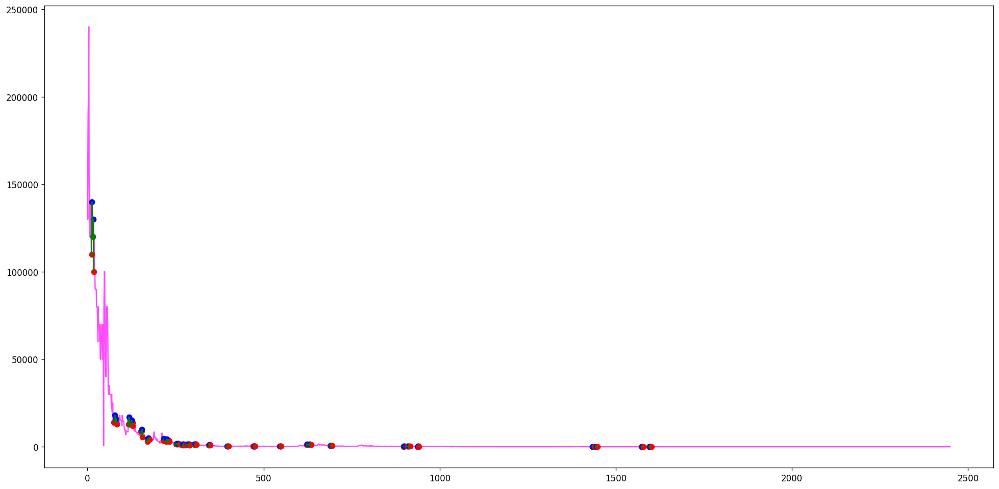

[(423, 425, 426, 427, 429), (632, 633, 635, 642, 644), (882, 884, 885, 887, 890), (1050, 1052, 1054, 1059, 1061), (1194, 1202, 1209, 1213, 1216), (1924, 1925, 1926, 1928, 1930), (2053, 2056, 2058, 2059, 2060), (2091, 2092, 2093, 2094, 2097), (2216, 2219, 2220, 2221, 2222), (2249, 2251, 2254, 2255, 2257), (2368, 2369, 2370, 2372, 2374), (2460, 2462, 2463, 2465, 2466), (2466, 2467, 2468, 2470, 2471), (2514, 2515, 2516, 2518, 2519), (2545, 2547, 2549, 2551, 2552), (2741, 2749, 2750, 2751, 2760), (3382, 3384, 3385, 3387, 3390), (3556, 3558, 3559, 3560, 3561)]
[]
Ticker AER found 18 double top patterns, 0 double bottom patterns


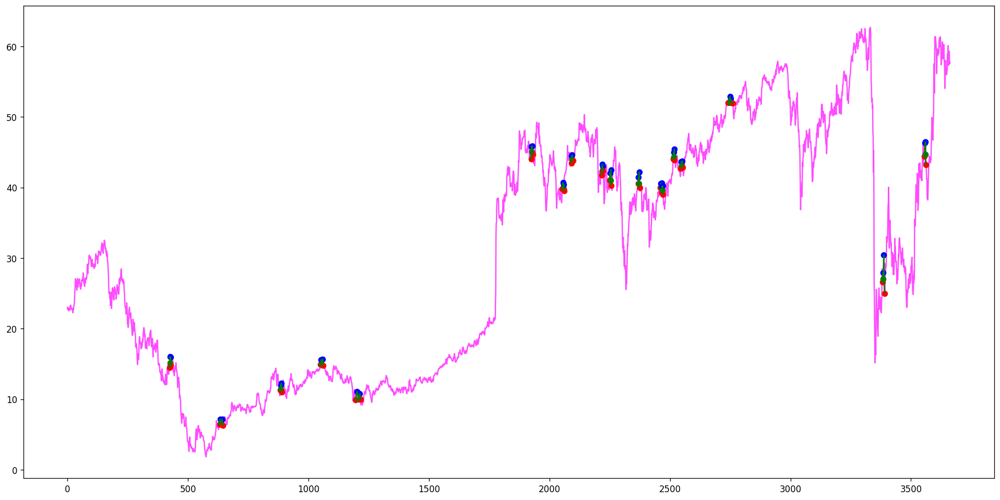

[(80, 81, 83, 86, 87), (237, 238, 239, 240, 241), (271, 272, 273, 274, 275), (374, 375, 376, 377, 378), (442, 445, 449, 450, 452), (469, 471, 473, 474, 476), (1053, 1055, 1059, 1069, 1075), (1053, 1055, 1059, 1070, 1075), (1597, 1599, 1606, 1612, 1621), (2190, 2191, 2194, 2195, 2197), (2235, 2240, 2241, 2242, 2244), (2272, 2273, 2274, 2279, 2282), (2583, 2591, 2596, 2597, 2599), (2888, 2895, 2902, 2907, 2912), (2930, 2932, 2936, 2945, 2949), (2930, 2934, 2936, 2945, 2949), (2936, 2938, 2940, 2945, 2949), (4538, 4540, 4543, 4546, 4550), (4673, 4679, 4682, 4690, 4697), (4884, 4886, 4889, 4892, 4900), (5246, 5249, 5250, 5254, 5256)]
[]
Ticker AES found 21 double top patterns, 0 double bottom patterns


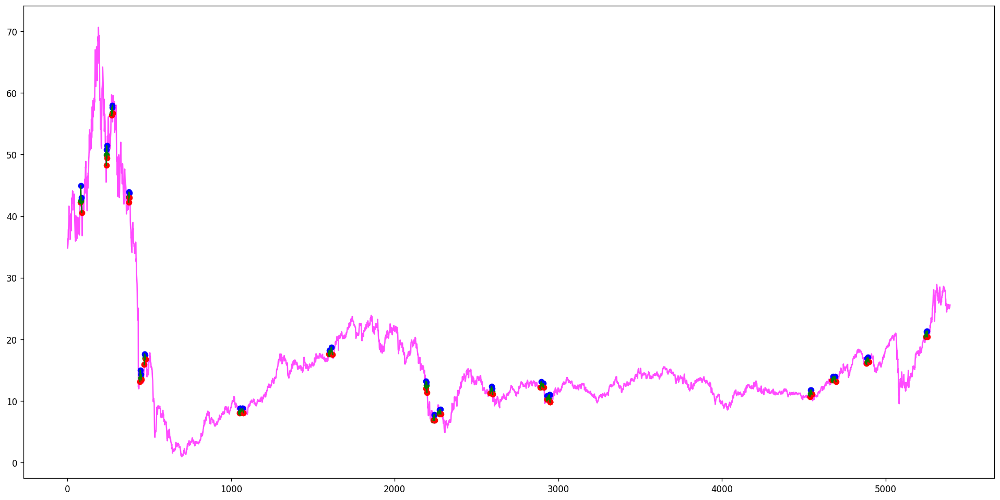

[(27, 29, 31, 34, 36)]
[]
Ticker AESC found 1 double top patterns, 0 double bottom patterns


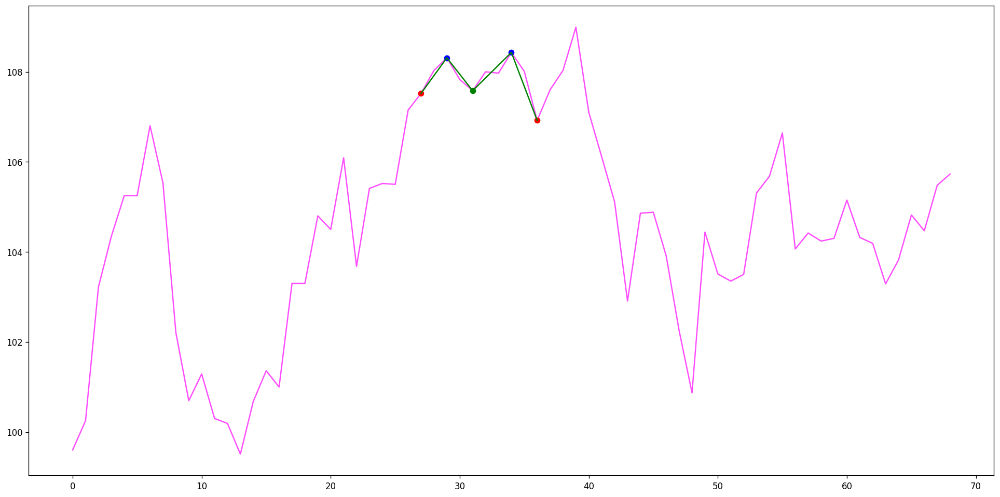

[(12, 13, 15, 18, 23), (39, 41, 42, 45, 62), (111, 114, 118, 121, 123), (688, 689, 691, 692, 693), (707, 708, 709, 710, 711), (999, 1009, 1011, 1014, 1015), (1443, 1446, 1447, 1448, 1449), (1450, 1459, 1461, 1462, 1464), (1511, 1512, 1513, 1514, 1515), (1570, 1582, 1586, 1588, 1598), (2067, 2069, 2073, 2080, 2090), (2590, 2592, 2595, 2596, 2598), (3834, 3843, 3846, 3855, 3862)]
[]
Ticker AETUF found 13 double top patterns, 0 double bottom patterns


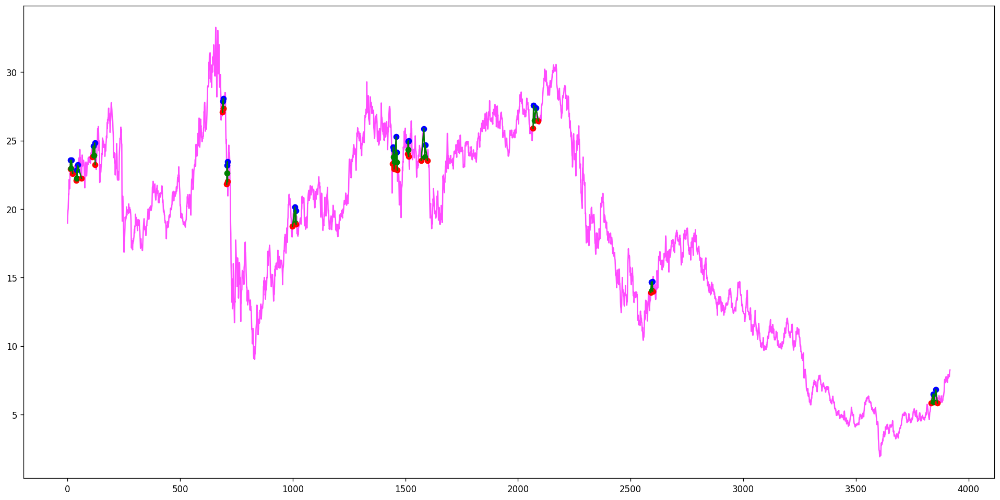

[(365, 373, 376, 379, 384), (480, 481, 483, 488, 489), (692, 694, 695, 697, 701), (689, 697, 702, 704, 705), (759, 760, 764, 766, 767), (980, 981, 982, 983, 984), (986, 987, 988, 991, 992), (1055, 1058, 1066, 1068, 1074)]
[]
Ticker AEXAY found 8 double top patterns, 0 double bottom patterns


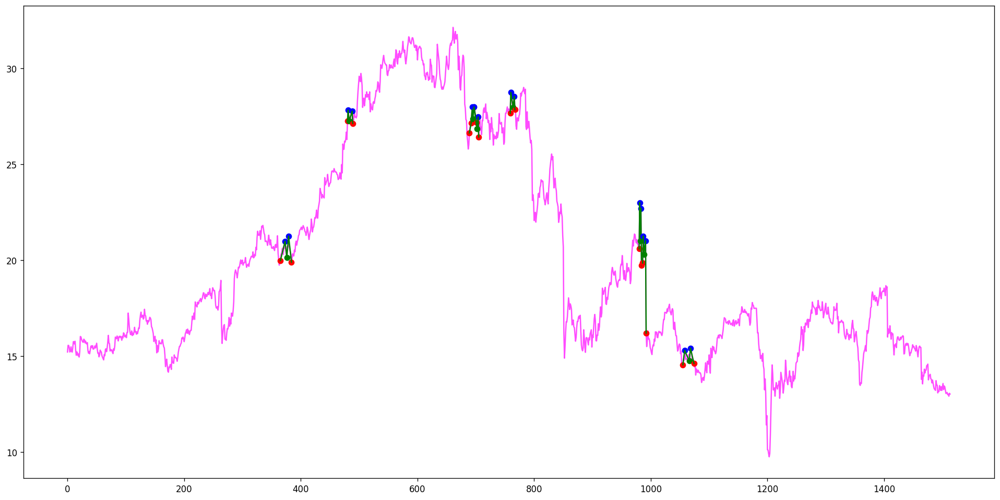

[(407, 408, 409, 412, 413), (504, 505, 506, 507, 509)]
[]
Ticker AEXE found 2 double top patterns, 0 double bottom patterns


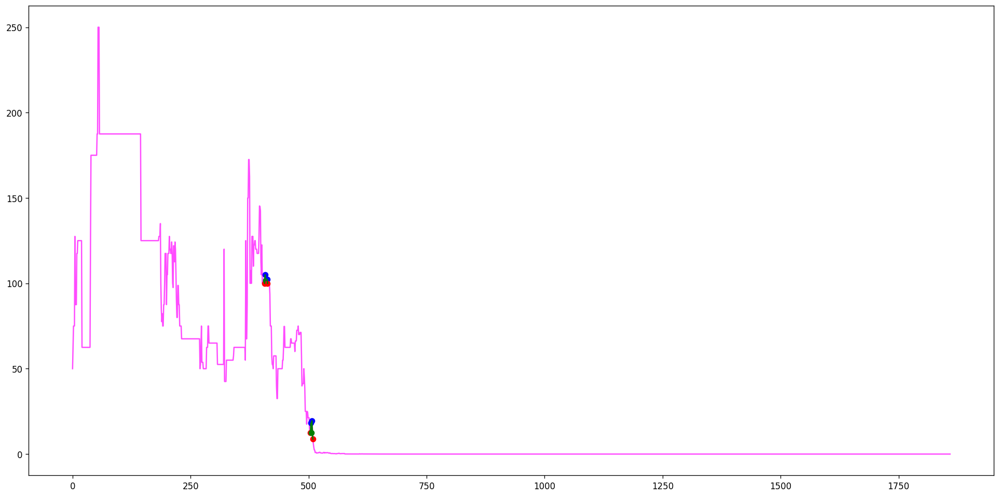

[(44, 46, 49, 50, 52), (44, 46, 49, 51, 52), (951, 952, 953, 954, 957), (1003, 1005, 1007, 1019, 1022), (5065, 5066, 5067, 5068, 5069)]
[]
Ticker AEY found 5 double top patterns, 0 double bottom patterns


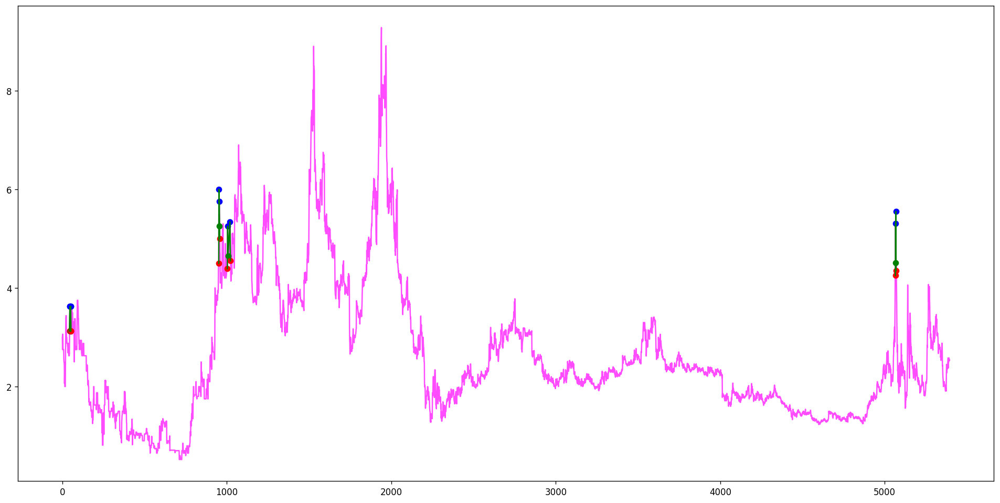

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(47, 48, 49, 51, 52), (88, 89, 90, 91, 92), (96, 97, 98, 99, 102), (111, 112, 113, 114, 115), (137, 138, 139, 140, 141), (160, 162, 163, 164, 173), (363, 364, 365, 366, 368), (377, 378, 379, 380, 382), (398, 399, 402, 407, 408), (398, 400, 402, 407, 408), (647, 652, 658, 663, 669), (647, 652, 658, 664, 669), (647, 653, 658, 663, 669), (647, 653, 658, 664, 669), (730, 731, 732, 736, 737), (746, 747, 748, 752, 763), (746, 747, 748, 759, 763), (804, 805, 808, 813, 815), (1067, 1068, 1073, 1084, 1085), (1067, 1069, 1073, 1084, 1085), (1073, 1084, 1085, 1087, 1089), (1067, 1068, 1073, 1093, 1094), (1067, 1069, 1073, 1093, 1094), (1073, 1084, 1085, 1093, 1094), (1086, 1087, 1089, 1093, 1094), (1114, 1115, 1116, 1129, 1136), (1114, 1115, 1116, 1131, 1136), (1114, 1115, 1116, 1134, 1136), (1195, 1196, 1199, 1200, 1202), (1195, 1196, 1199, 1201, 1202), (1229, 1230, 1232, 1234, 1237), (1226, 1228, 1229, 1230, 1246), (1273, 1274, 1276, 1280, 1285), (1273, 1274, 1276, 1282, 1285), (1313, 1314, 13

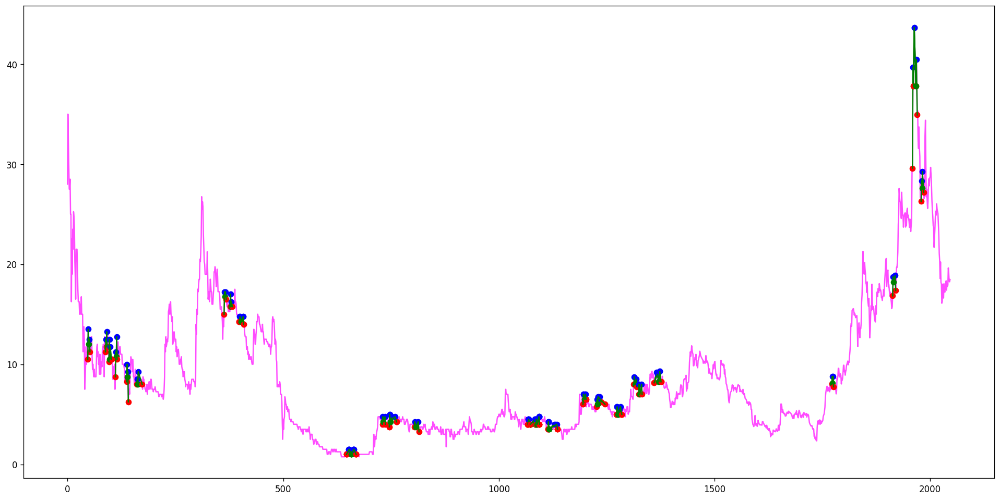

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(13, 19, 20, 21, 22), (25, 26, 28, 29, 30), (77, 78, 81, 82, 83), (77, 78, 83, 84, 85), (105, 106, 107, 111, 112), (220, 221, 224, 225, 226), (227, 229, 232, 234, 238), (266, 269, 272, 274, 278), (281, 282, 283, 284, 285), (297, 298, 299, 300, 301), (280, 284, 285, 290, 305), (307, 308, 309, 310, 311), (357, 360, 361, 364, 368), (355, 364, 369, 370, 374), (369, 370, 372, 373, 374), (381, 382, 384, 385, 386), (405, 407, 408, 410, 411), (411, 416, 421, 422, 424), (503, 504, 505, 506, 508), (618, 620, 622, 623, 624), (636, 637, 638, 641, 651), (673, 674, 675, 676, 677), (685, 687, 688, 689, 693), (693, 694, 696, 698, 700), (718, 720, 721, 722, 723), (736, 737, 738, 739, 741), (772, 773, 774, 775, 777), (765, 769, 771, 773, 778), (779, 780, 781, 783, 784), (786, 787, 789, 790, 791), (801, 802, 803, 804, 805), (801, 804, 806, 811, 814), (834, 835, 836, 842, 846), (857, 859, 861, 862, 863), (891, 892, 893, 894, 895), (913, 915, 916, 917, 918), (936, 937, 938, 939, 942), (954, 955, 957, 958,

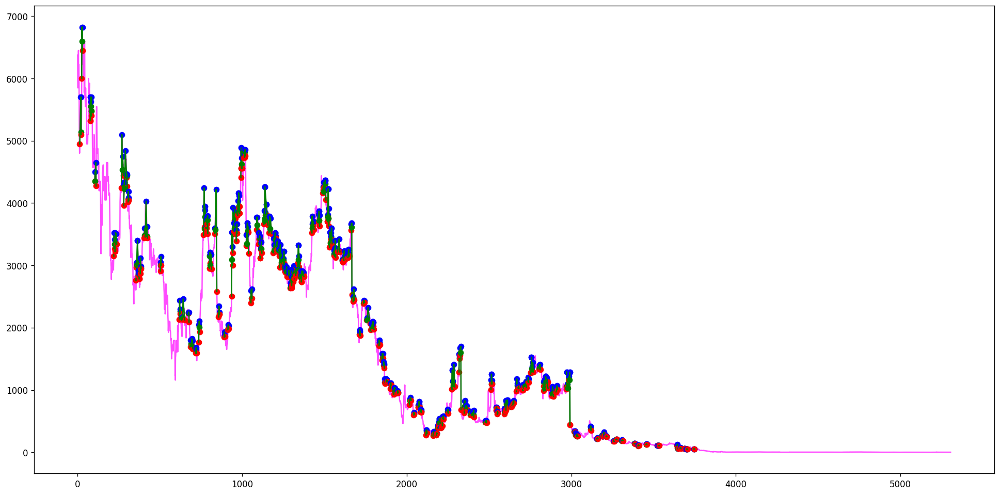

[(752, 759, 768, 774, 780), (752, 759, 768, 775, 780), (752, 759, 768, 776, 780)]
[]
Ticker AFAVX found 3 double top patterns, 0 double bottom patterns


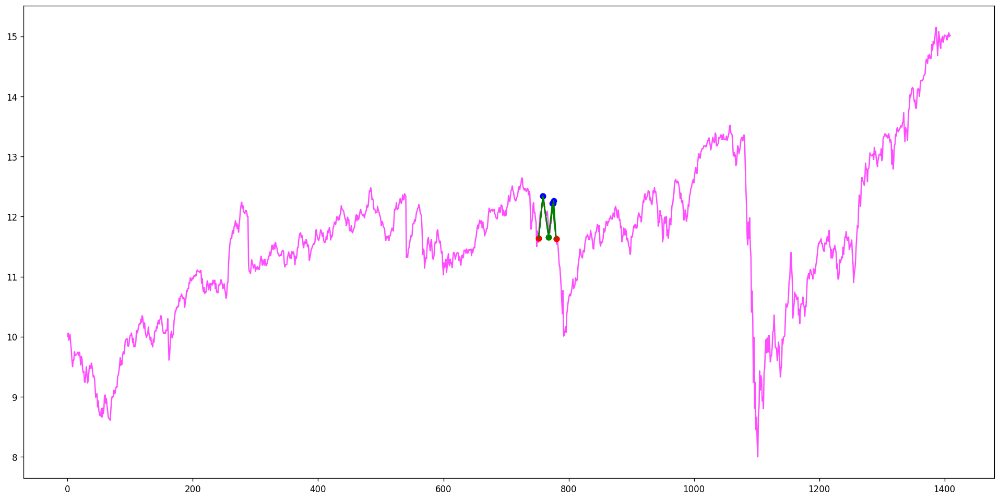

[(2306, 2313, 2322, 2330, 2333), (2679, 2682, 2687, 2689, 2692)]
[]
Ticker AFAZX found 2 double top patterns, 0 double bottom patterns


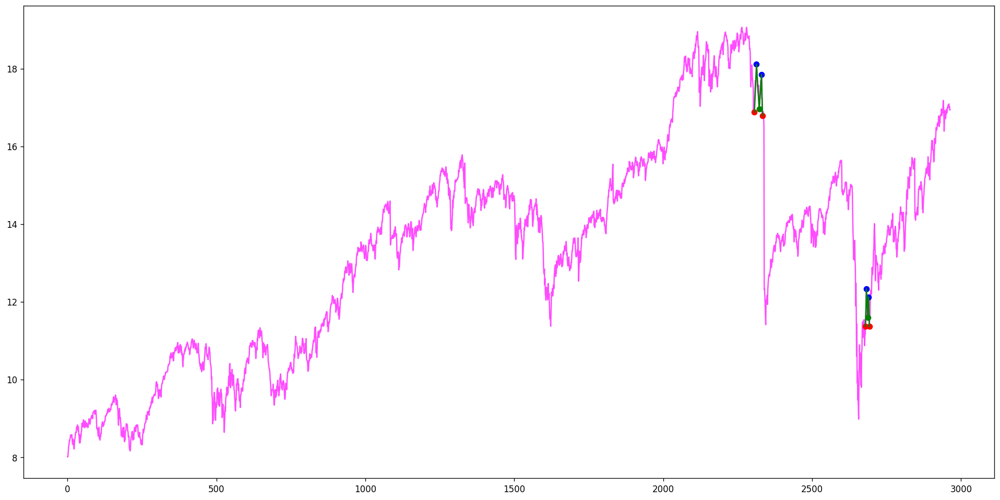

[]
[]
Ticker AFB found 0 double top patterns, 0 double bottom patterns


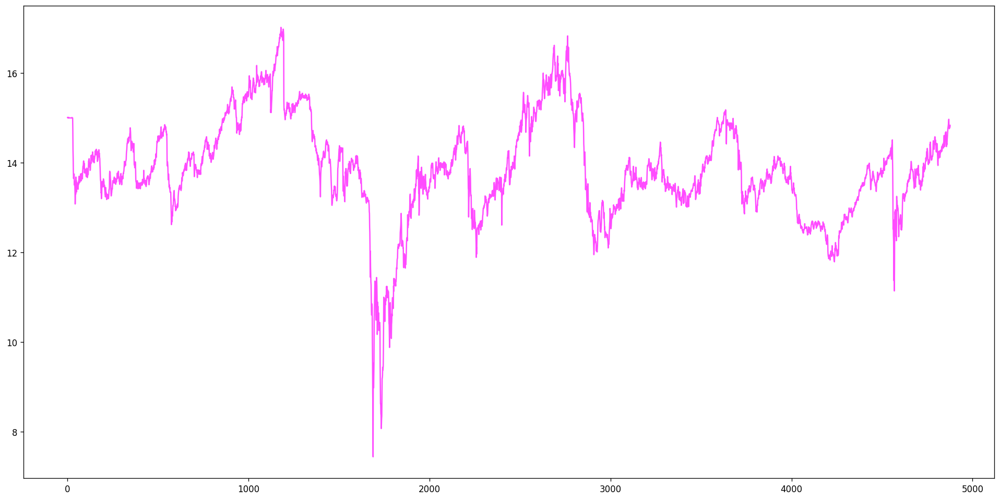

[(528, 529, 531, 535, 536), (528, 530, 531, 535, 536)]
[]
Ticker AFBA found 2 double top patterns, 0 double bottom patterns


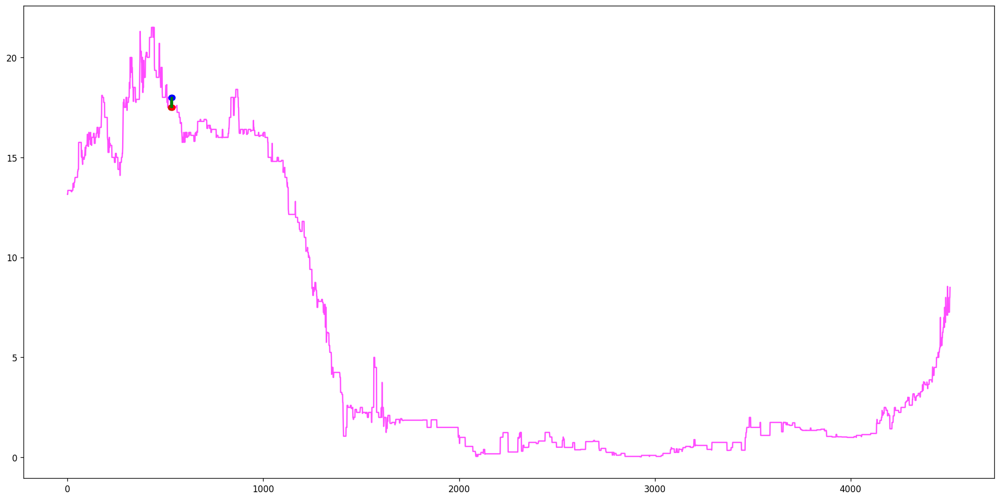

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(487, 488, 490, 491, 492), (487, 489, 490, 491, 492), (1901, 1902, 1903, 1906, 1907), (2518, 2519, 2521, 2522, 2524), (2571, 2572, 2573, 2574, 2575), (2655, 2656, 2657, 2658, 2660), (2687, 2688, 2690, 2691, 2693), (2777, 2778, 2781, 2782, 2783), (2798, 2799, 2800, 2801, 2802), (2814, 2816, 2817, 2818, 2820), (2823, 2824, 2825, 2826, 2828), (2828, 2829, 2830, 2831, 2832), (2846, 2847, 2848, 2849, 2850), (2848, 2849, 2850, 2851, 2852), (2896, 2897, 2898, 2899, 2900), (2946, 2948, 2950, 2951, 2952), (2957, 2958, 2960, 2961, 2962), (3040, 3041, 3042, 3043, 3044), (3089, 3090, 3091, 3092, 3093), (3121, 3122, 3123, 3124, 3125), (3135, 3136, 3137, 3138, 3139), (3145, 3148, 3152, 3153, 3154), (3213, 3219, 3220, 3221, 3222), (3287, 3288, 3291, 3293, 3294), (3330, 3331, 3332, 3333, 3334), (3340, 3341, 3342, 3344, 3347), (3405, 3406, 3407, 3409, 3410), (3479, 3480, 3482, 3483, 3484), (3512, 3513, 3515, 3516, 3518), (3629, 3630, 3631, 3632, 3633), (3631, 3632, 3633, 3634, 3636), (3631, 3632, 3633

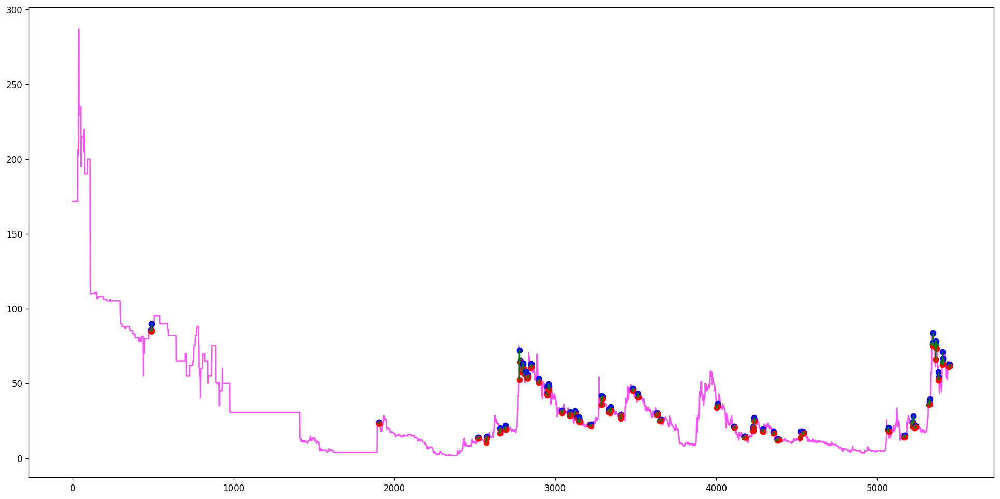

[(31, 32, 33, 34, 35)]
[]
Ticker AFCG found 1 double top patterns, 0 double bottom patterns


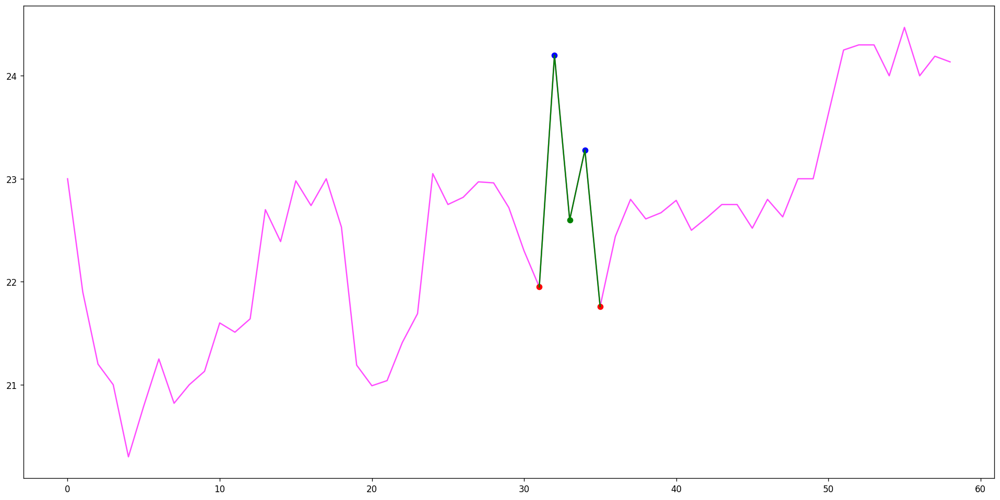

[(585, 598, 602, 606, 610), (1527, 1534, 1540, 1545, 1549), (3670, 3671, 3672, 3673, 3675), (3688, 3689, 3690, 3691, 3693), (3700, 3701, 3702, 3704, 3706), (3803, 3804, 3805, 3808, 3811)]
[]
Ticker AFDIX found 6 double top patterns, 0 double bottom patterns


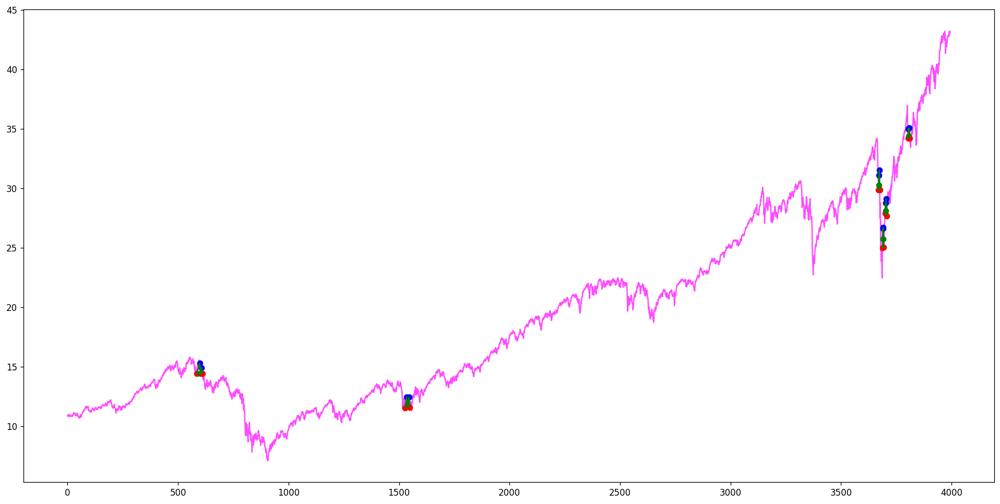

[(1213, 1216, 1221, 1223, 1226), (1233, 1243, 1246, 1249, 1257)]
[]
Ticker AFDVX found 2 double top patterns, 0 double bottom patterns


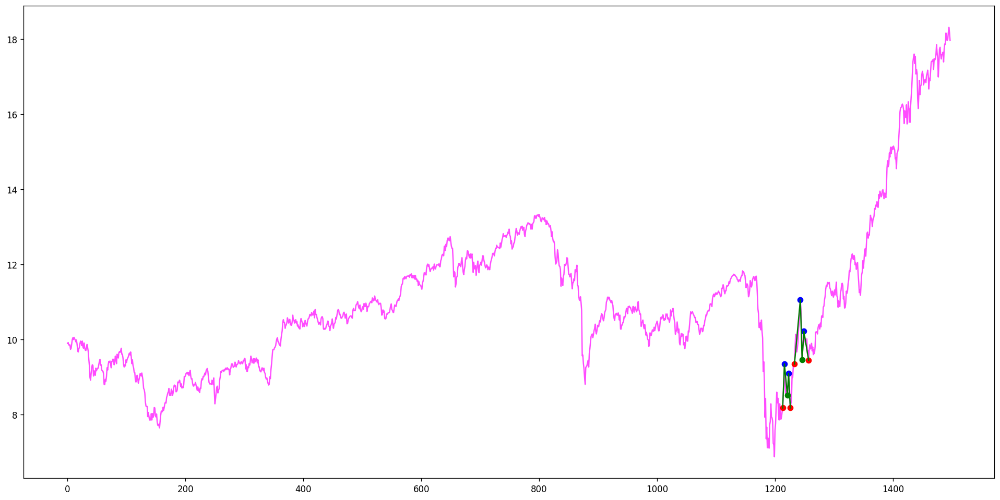

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(7, 9, 11, 12, 13), (19, 20, 21, 22, 23), (27, 28, 30, 31, 32), (38, 41, 43, 44, 47), (67, 68, 69, 71, 72), (105, 109, 111, 112, 113), (191, 193, 195, 196, 197), (247, 248, 249, 250, 253), (290, 291, 292, 293, 294), (297, 299, 300, 301, 302), (435, 436, 437, 438, 439), (527, 528, 530, 532, 533), (543, 547, 549, 554, 558), (550, 554, 556, 557, 558), (631, 633, 634, 635, 636), (653, 656, 666, 669, 674), (689, 702, 707, 713, 714), (723, 725, 726, 728, 729), (733, 734, 737, 738, 740), (737, 738, 740, 743, 744), (793, 794, 795, 796, 797), (804, 805, 807, 808, 809), (814, 815, 816, 817, 818), (844, 848, 850, 852, 855), (870, 871, 872, 873, 874), (905, 906, 907, 908, 910), (955, 956, 960, 961, 962), (1002, 1003, 1005, 1010, 1013), (1014, 1016, 1017, 1018, 1019), (1105, 1106, 1107, 1109, 1117), (1189, 1190, 1191, 1192, 1193), (1186, 1187, 1188, 1190, 1194), (1207, 1208, 1209, 1210, 1213), (1240, 1243, 1248, 1249, 1250), (1309, 1310, 1311, 1314, 1315), (1306, 1314, 1316, 1317, 1318), (1364, 13

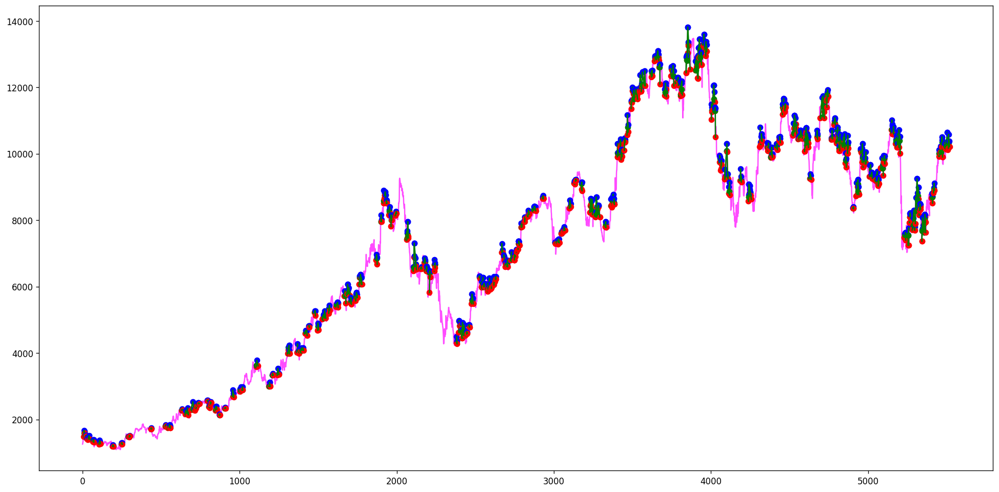

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(200, 202, 203, 204, 205), (514, 516, 522, 524, 528), (745, 748, 755, 758, 761), (861, 862, 864, 865, 867), (904, 905, 907, 910, 915), (957, 958, 960, 961, 964), (1162, 1173, 1174, 1176, 1178), (1501, 1503, 1505, 1507, 1508), (1800, 1801, 1802, 1803, 1804), (1804, 1805, 1808, 1810, 1812), (1825, 1826, 1827, 1828, 1829), (1893, 1894, 1895, 1896, 1898), (1893, 1894, 1895, 1897, 1898), (2146, 2148, 2149, 2150, 2151), (2149, 2150, 2151, 2155, 2157), (2164, 2165, 2166, 2167, 2169), (2172, 2173, 2174, 2175, 2176), (2248, 2250, 2251, 2252, 2254), (2248, 2250, 2251, 2253, 2254), (2272, 2273, 2274, 2278, 2281), (2387, 2388, 2389, 2390, 2392), (2393, 2394, 2395, 2396, 2397), (2402, 2404, 2405, 2406, 2408), (2443, 2444, 2445, 2446, 2447), (2462, 2466, 2469, 2472, 2473), (2462, 2468, 2469, 2472, 2473), (2594, 2595, 2596, 2597, 2599), (2658, 2659, 2660, 2661, 2662), (2691, 2692, 2695, 2696, 2697), (2702, 2703, 2709, 2711, 2712), (2843, 2845, 2846, 2847, 2850), (2843, 2845, 2846, 2848, 2850), (2921

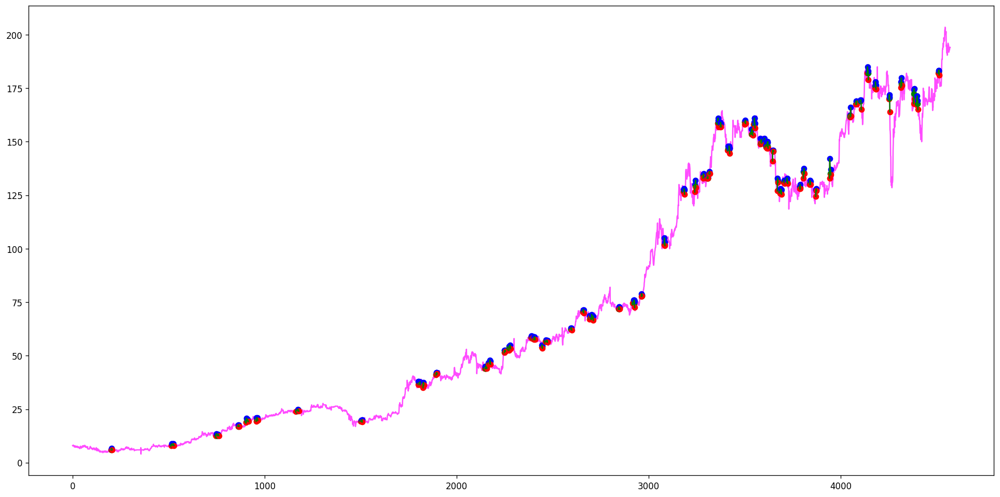

[(45, 46, 48, 49, 50)]
[]
Ticker AFGC found 1 double top patterns, 0 double bottom patterns


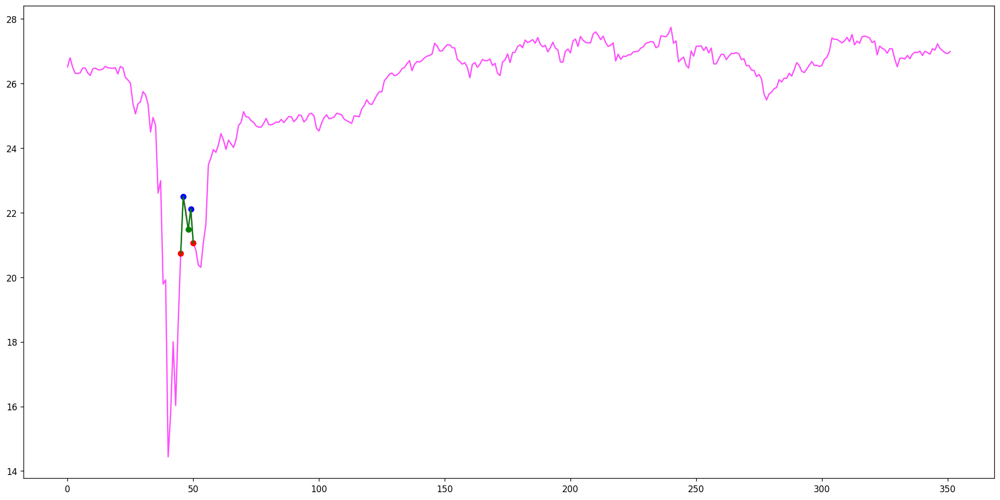

[(50, 61, 66, 72, 77)]
[]
Ticker AFGD found 1 double top patterns, 0 double bottom patterns


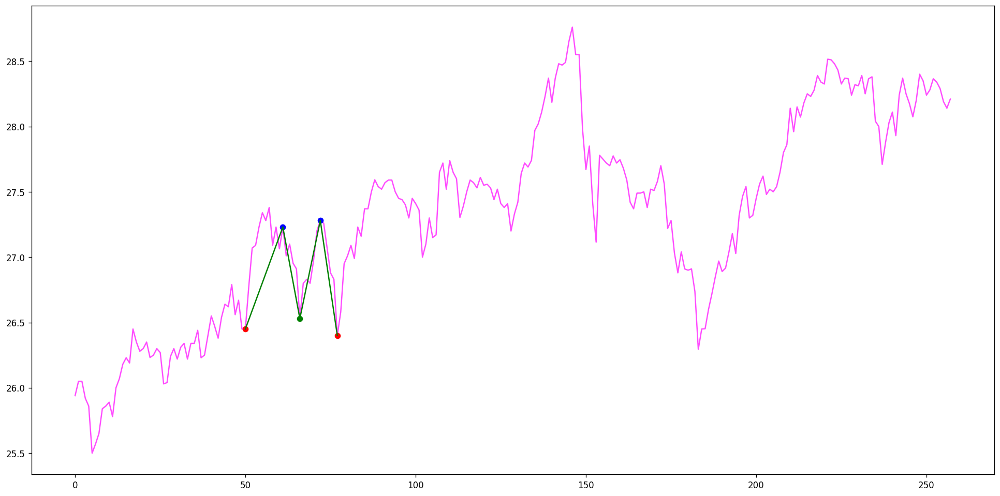

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(132, 136, 138, 139, 140), (231, 232, 233, 235, 236), (240, 242, 243, 244, 246), (252, 253, 254, 255, 256), (309, 310, 311, 312, 313), (323, 325, 328, 331, 334), (316, 317, 318, 325, 338), (351, 353, 354, 355, 356), (406, 407, 408, 409, 410), (406, 409, 410, 412, 414), (420, 421, 422, 423, 424), (436, 438, 442, 443, 444), (465, 466, 467, 468, 470), (483, 484, 486, 487, 488), (495, 496, 497, 498, 499), (551, 552, 553, 554, 556), (561, 562, 563, 564, 565), (574, 576, 577, 578, 579), (601, 602, 603, 604, 607), (603, 604, 605, 606, 607), (662, 663, 664, 665, 666), (671, 672, 673, 674, 675), (694, 695, 696, 697, 698), (690, 691, 692, 693, 702), (705, 706, 707, 708, 710), (731, 732, 733, 734, 735), (752, 753, 754, 755, 758), (782, 783, 784, 785, 786), (790, 792, 796, 798, 802), (908, 910, 913, 914, 915), (921, 923, 927, 928, 929), (943, 944, 949, 952, 954), (949, 950, 951, 952, 954), (954, 957, 958, 959, 960), (967, 968, 970, 972, 973), (978, 979, 980, 983, 986), (986, 987, 988, 989, 990), 

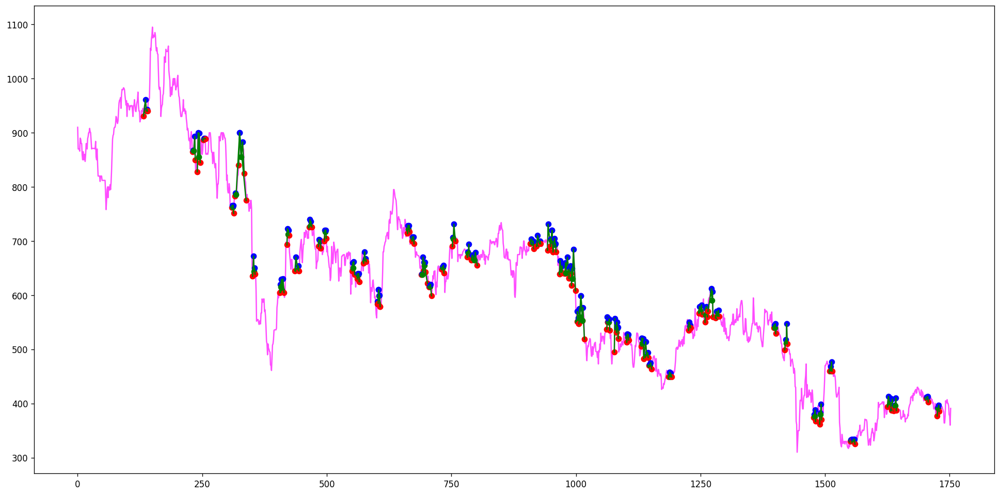

[]
[]
Ticker AFHBL found 0 double top patterns, 0 double bottom patterns


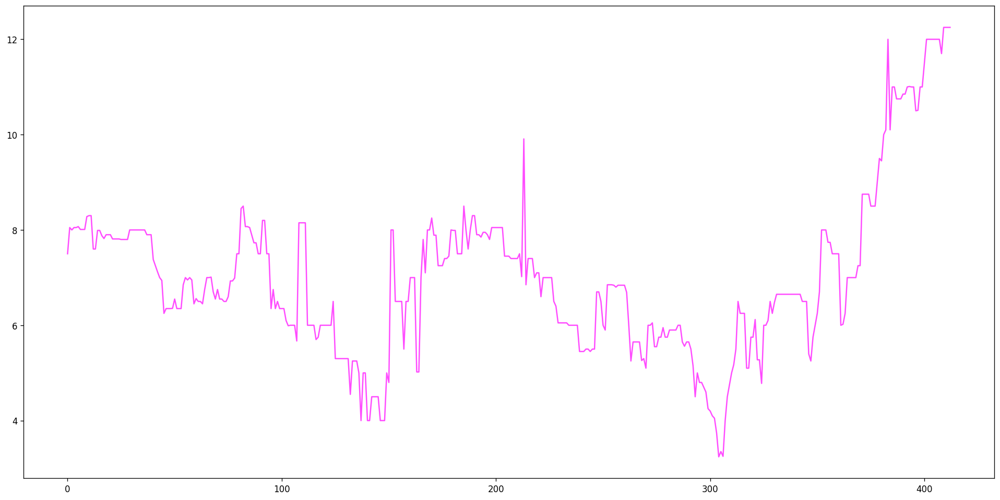

[(380, 387, 389, 390, 394), (778, 779, 783, 790, 793), (1382, 1383, 1385, 1387, 1404), (1382, 1383, 1385, 1388, 1404)]
[]
Ticker AFHIF found 4 double top patterns, 0 double bottom patterns


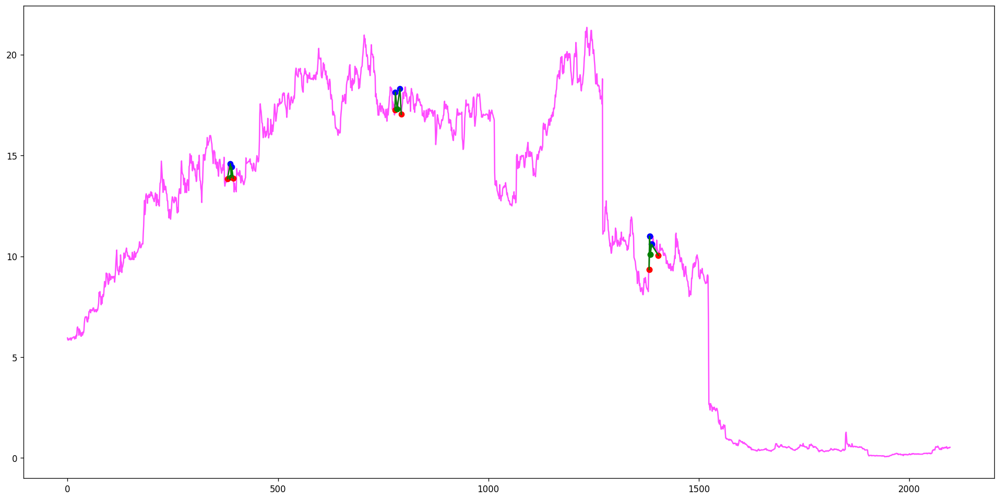

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(931, 933, 935, 938, 954), (1339, 1342, 1344, 1345, 1346), (1371, 1372, 1373, 1374, 1376), (1504, 1505, 1506, 1507, 1508), (1527, 1534, 1535, 1536, 1543), (1535, 1536, 1540, 1542, 1543), (1751, 1752, 1753, 1754, 1755), (1767, 1768, 1770, 1771, 1772), (1897, 1898, 1899, 1903, 1904), (1894, 1895, 1897, 1903, 1905), (1881, 1890, 1893, 1895, 1906), (1927, 1928, 1930, 1931, 1932), (1937, 1938, 1941, 1942, 1943), (2069, 2074, 2075, 2076, 2077), (2122, 2123, 2124, 2125, 2126), (2122, 2125, 2127, 2131, 2133), (2122, 2131, 2133, 2134, 2135), (2158, 2159, 2161, 2162, 2165), (2151, 2162, 2166, 2167, 2168), (2171, 2172, 2173, 2174, 2176), (2177, 2178, 2179, 2180, 2181), (2202, 2203, 2204, 2205, 2206), (2246, 2247, 2248, 2252, 2253), (2363, 2364, 2365, 2366, 2367), (2401, 2407, 2411, 2412, 2414), (2399, 2400, 2401, 2407, 2419), (2463, 2464, 2465, 2466, 2467), (2693, 2698, 2700, 2701, 2702), (2734, 2739, 2740, 2741, 2742), (2804, 2805, 2806, 2807, 2810), (2804, 2807, 2810, 2811, 2812), (2841, 2842,

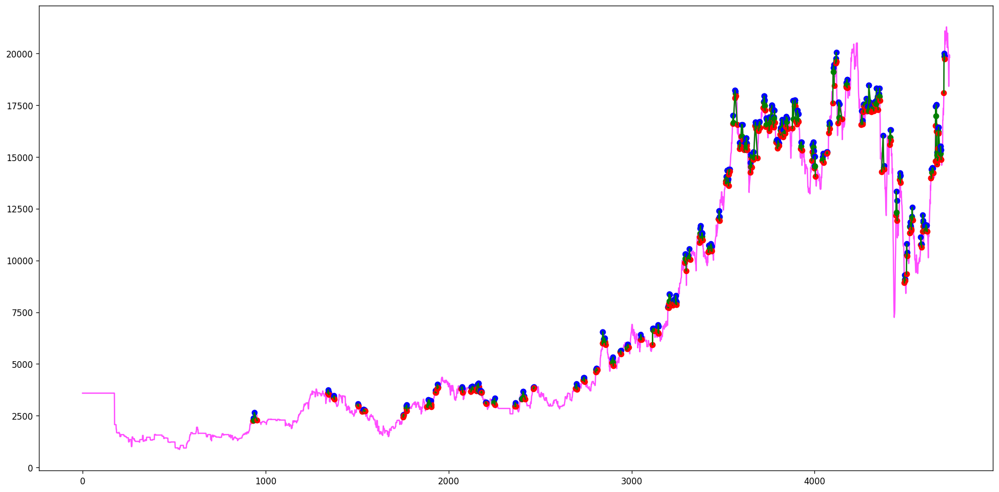

[(1399, 1400, 1401, 1402, 1403), (1551, 1552, 1554, 1555, 1556)]
[]
Ticker AFHP.L found 2 double top patterns, 0 double bottom patterns


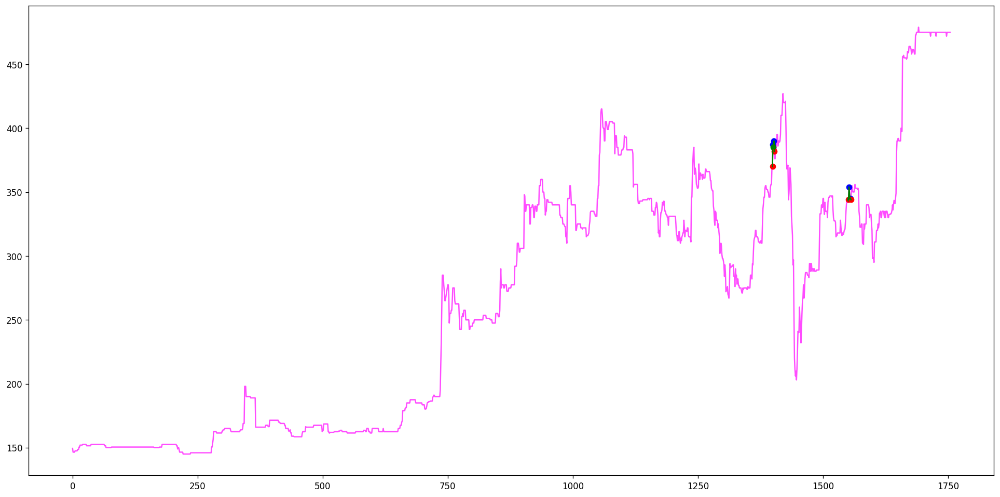

[(513, 516, 522, 524, 529), (513, 519, 522, 524, 529), (567, 573, 576, 579, 585), (753, 754, 756, 757, 760), (893, 905, 912, 915, 916), (1001, 1005, 1007, 1008, 1014)]
[]
Ticker AFI found 6 double top patterns, 0 double bottom patterns


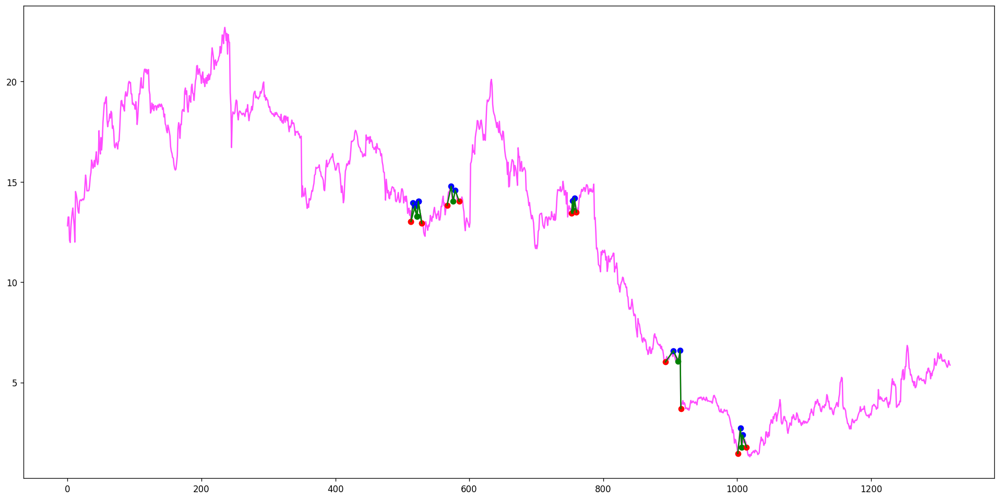

[(87, 88, 90, 91, 92)]
[]
Ticker AFIB found 1 double top patterns, 0 double bottom patterns


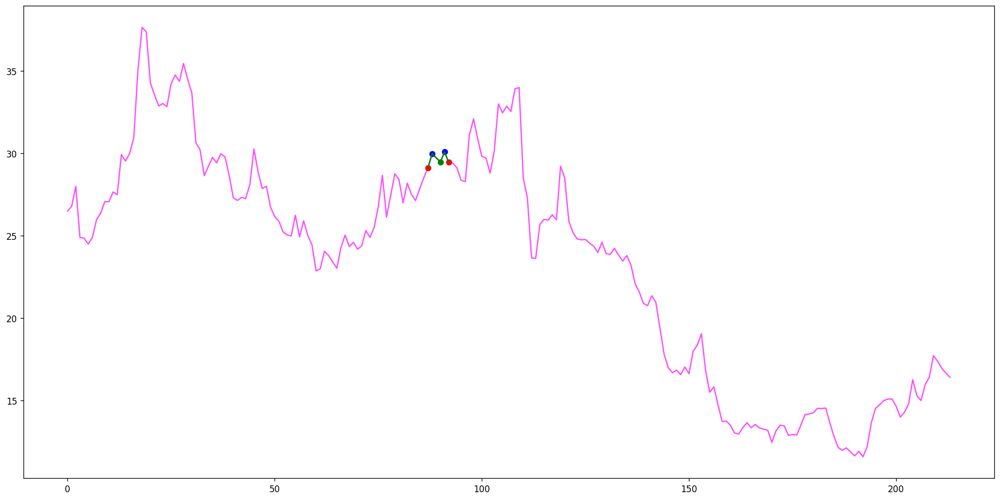

[(84, 85, 96, 102, 103), (103, 107, 114, 118, 121), (596, 610, 618, 621, 624)]
[]
Ticker AFIN found 3 double top patterns, 0 double bottom patterns


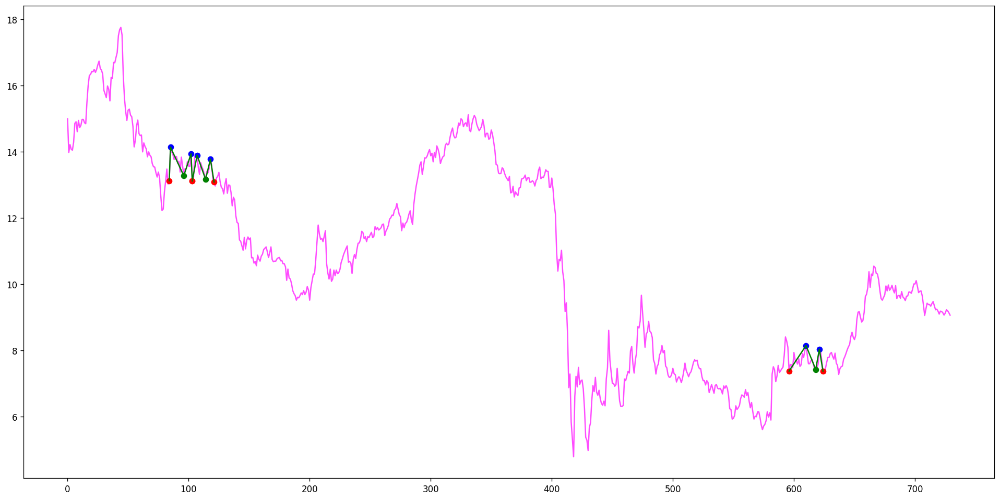

[(277, 279, 281, 286, 288), (314, 316, 319, 320, 323)]
[]
Ticker AFINP found 2 double top patterns, 0 double bottom patterns


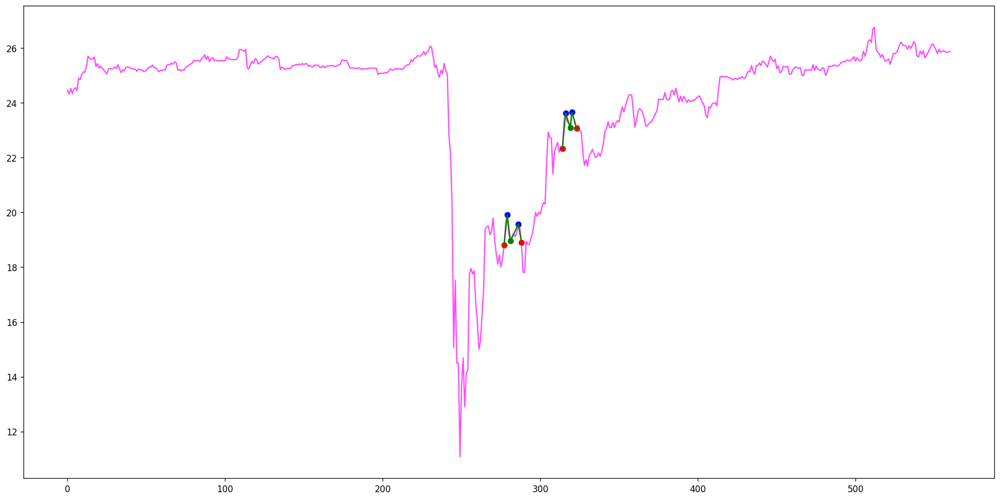

[(720, 743, 745, 746, 747), (1136, 1150, 1154, 1155, 1156), (1572, 1579, 1586, 1592, 1597), (2585, 2591, 2598, 2608, 2611), (3421, 3427, 3436, 3444, 3446)]
[]
Ticker AFJAX found 5 double top patterns, 0 double bottom patterns


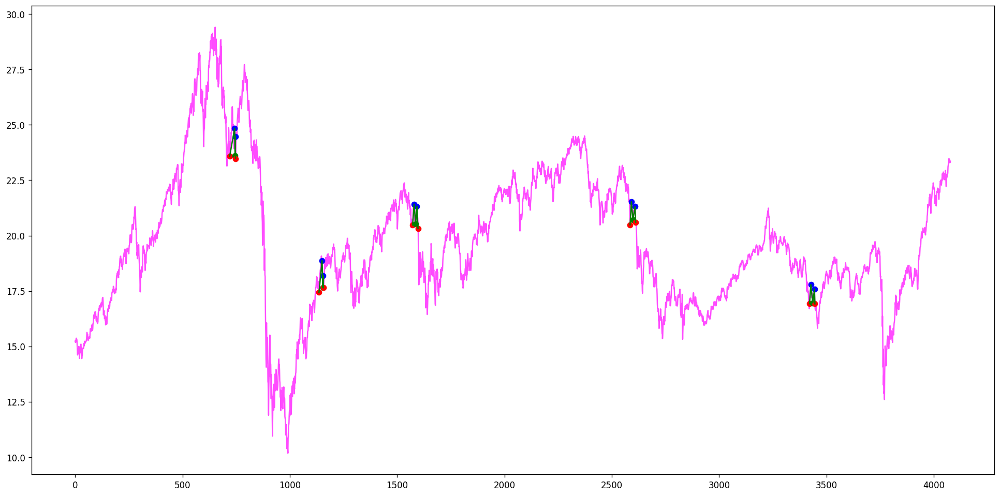

[(720, 743, 745, 746, 747), (1136, 1150, 1154, 1155, 1156), (1572, 1579, 1586, 1592, 1597), (2585, 2591, 2598, 2608, 2611), (3421, 3427, 3436, 3444, 3446)]
[]
Ticker AFJCX found 5 double top patterns, 0 double bottom patterns


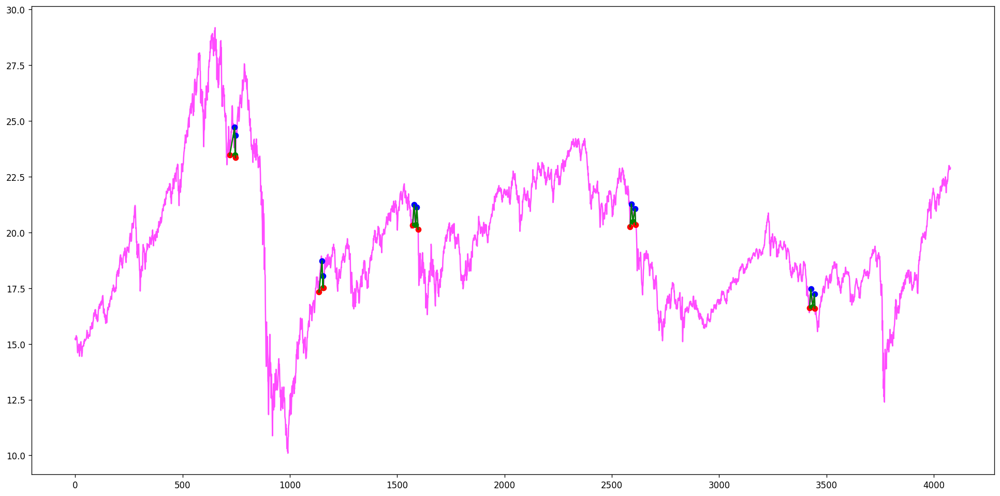

[(108, 110, 111, 112, 113), (119, 120, 121, 122, 124), (143, 145, 146, 149, 151), (173, 174, 176, 177, 179), (181, 182, 185, 188, 189), (263, 267, 272, 274, 276), (471, 472, 474, 475, 477), (658, 661, 663, 665, 669), (788, 791, 794, 795, 797), (834, 839, 840, 842, 843), (2594, 2600, 2605, 2606, 2621)]
[]
Ticker AFK found 11 double top patterns, 0 double bottom patterns


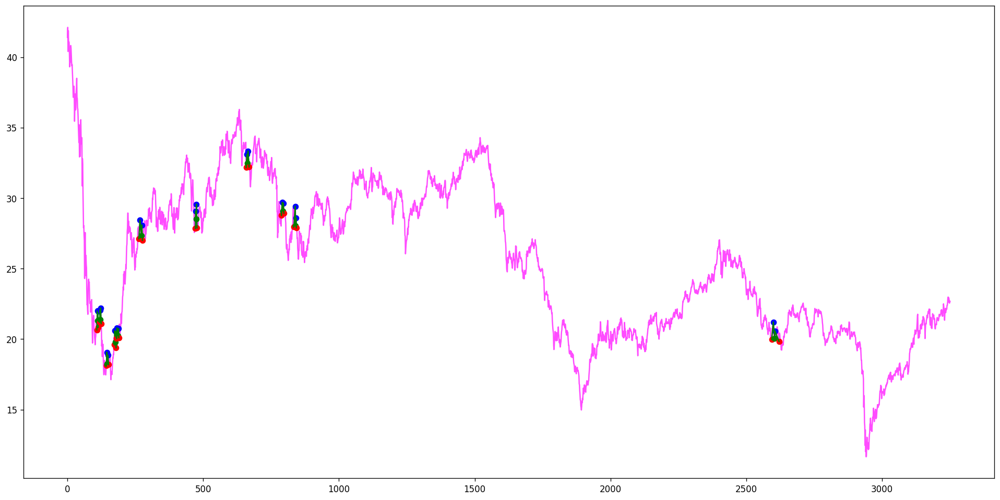

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(256, 257, 258, 268, 269), (509, 510, 512, 523, 524), (509, 510, 512, 530, 531), (644, 663, 666, 667, 668), (951, 952, 953, 954, 955), (953, 954, 955, 956, 957), (1007, 1008, 1011, 1012, 1014), (1132, 1133, 1134, 1135, 1136), (1158, 1159, 1160, 1162, 1163), (1207, 1208, 1209, 1232, 1233), (1214, 1232, 1233, 1234, 1236), (1337, 1338, 1339, 1340, 1342), (1339, 1340, 1342, 1343, 1344), (1561, 1562, 1564, 1565, 1566), (1678, 1680, 1683, 1684, 1686), (1704, 1705, 1706, 1708, 1709), (1813, 1814, 1815, 1816, 1817), (1856, 1858, 1859, 1864, 1865), (1883, 1884, 1885, 1886, 1887), (1894, 1895, 1897, 1898, 1899), (1950, 1951, 1952, 1953, 1954), (1963, 1964, 1965, 1974, 1975), (1969, 1970, 1971, 1974, 1975), (2005, 2006, 2007, 2009, 2010), (2007, 2009, 2010, 2011, 2012), (2086, 2087, 2088, 2089, 2090), (2177, 2178, 2179, 2180, 2181), (2205, 2208, 2211, 2212, 2213), (2579, 2580, 2582, 2583, 2585), (2813, 2814, 2816, 2817, 2818), (3537, 3538, 3539, 3540, 3541), (3938, 3939, 3940, 3943, 3944), (4000

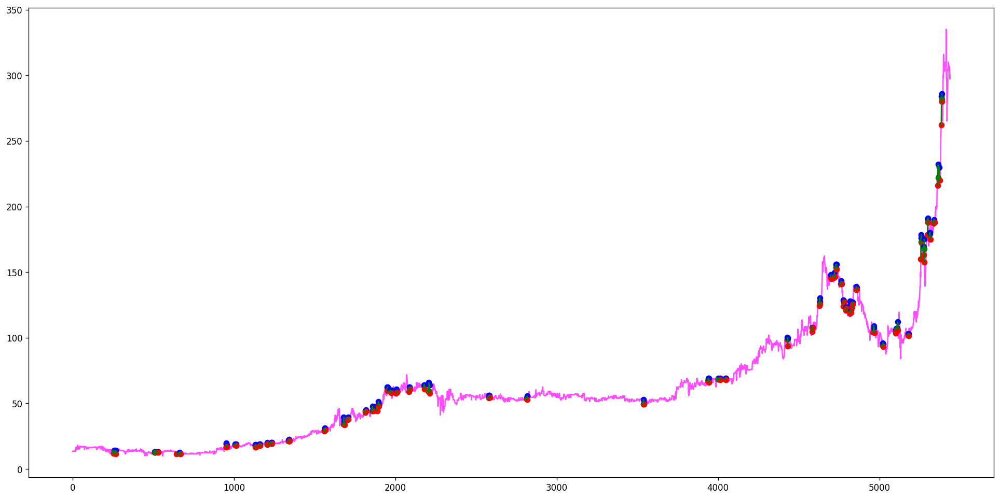

[(214, 215, 216, 219, 221), (295, 297, 301, 305, 309), (600, 601, 603, 604, 605), (1025, 1029, 1033, 1034, 1036), (1260, 1262, 1265, 1270, 1275), (1355, 1358, 1360, 1361, 1362), (1391, 1392, 1394, 1396, 1398)]
[]
Ticker AFKS.ME found 7 double top patterns, 0 double bottom patterns


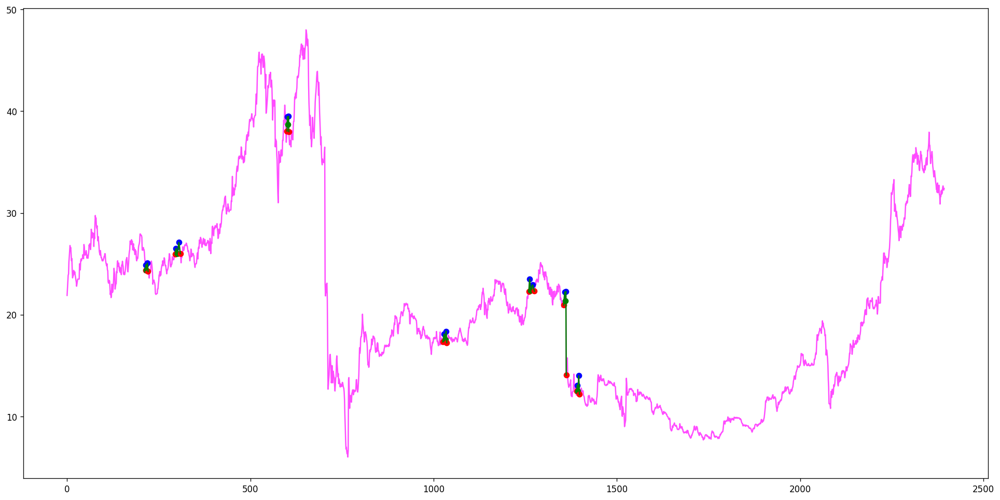

[(11, 12, 14, 16, 32), (241, 243, 248, 251, 252), (356, 358, 362, 370, 371), (621, 623, 626, 627, 630), (649, 652, 654, 655, 665), (1778, 1783, 1785, 1795, 1796), (2183, 2186, 2187, 2188, 2189), (2241, 2243, 2244, 2245, 2250), (2336, 2337, 2338, 2339, 2342), (2757, 2760, 2765, 2767, 2770), (2797, 2799, 2803, 2805, 2807), (3246, 3262, 3267, 3269, 3271), (3600, 3601, 3606, 3611, 3614), (4183, 4194, 4198, 4199, 4200), (4559, 4560, 4563, 4565, 4568), (4684, 4688, 4690, 4692, 4696), (4749, 4751, 4752, 4760, 4761), (4827, 4830, 4832, 4833, 4834), (4832, 4833, 4834, 4839, 4841), (4843, 4849, 4850, 4851, 4853), (5070, 5071, 5072, 5073, 5074), (5087, 5088, 5090, 5091, 5092), (5153, 5155, 5157, 5158, 5159), (5192, 5193, 5195, 5197, 5198), (5330, 5332, 5333, 5335, 5337)]
[]
Ticker AFL found 25 double top patterns, 0 double bottom patterns


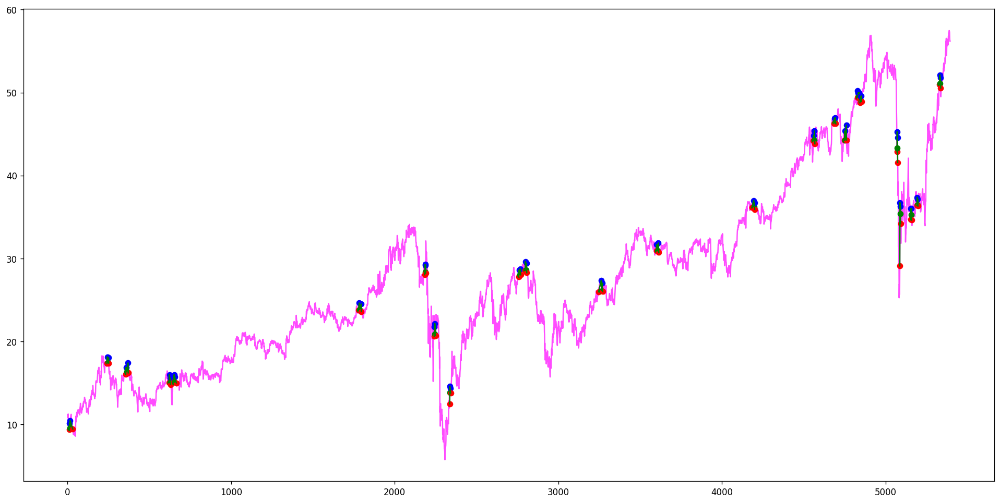

[(63, 64, 68, 76, 80), (233, 236, 237, 239, 240), (279, 280, 281, 282, 286), (621, 624, 625, 627, 630), (1361, 1374, 1378, 1380, 1383), (1631, 1633, 1637, 1638, 1648), (1770, 1774, 1778, 1780, 1783), (1868, 1871, 1872, 1876, 1880), (2052, 2054, 2056, 2057, 2058), (2352, 2355, 2356, 2362, 2370), (2764, 2767, 2768, 2775, 2778), (2972, 2977, 2980, 2981, 2982), (3110, 3111, 3112, 3113, 3115), (3293, 3294, 3296, 3297, 3298), (3397, 3398, 3400, 3404, 3408)]
[]
Ticker AFL.SG found 15 double top patterns, 0 double bottom patterns


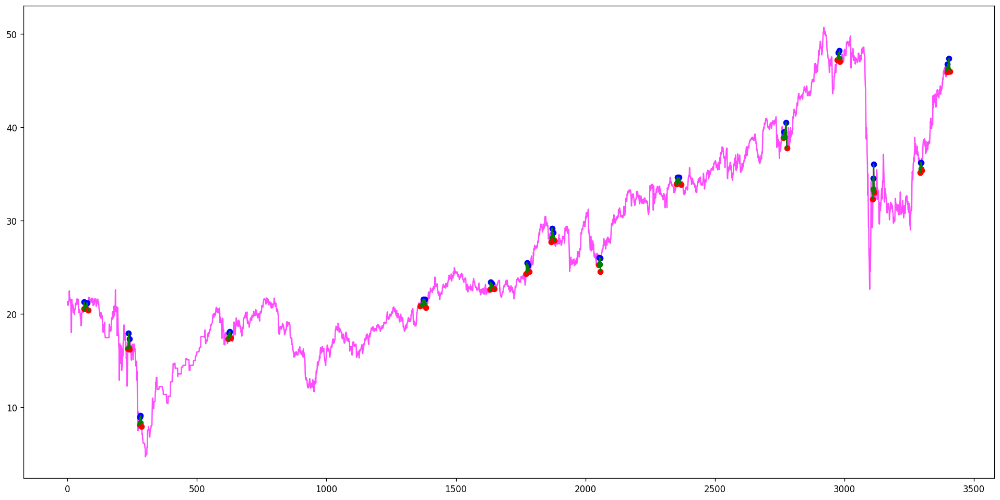

[(291, 307, 309, 310, 313)]
[]
Ticker AFLG found 1 double top patterns, 0 double bottom patterns


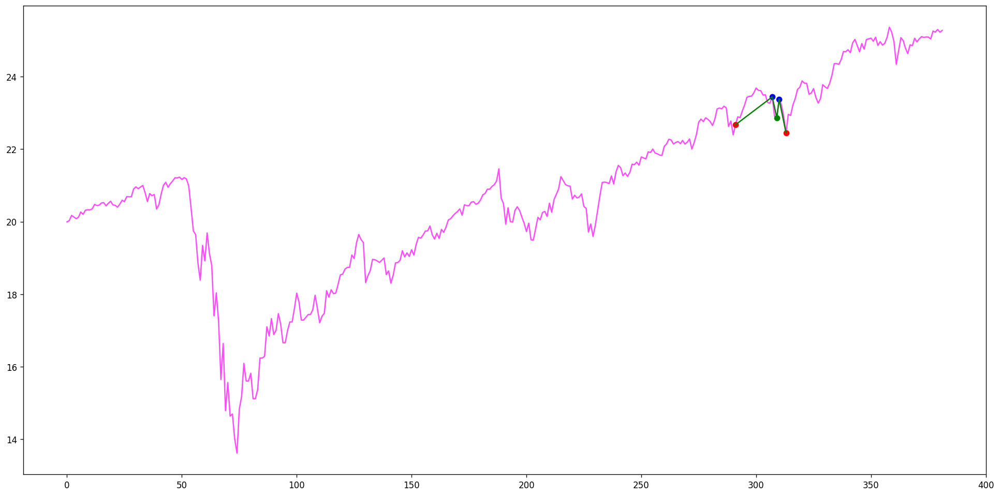

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(20, 21, 22, 23, 25), (411, 414, 417, 419, 420), (803, 804, 805, 807, 808), (1006, 1008, 1010, 1012, 1013), (1109, 1113, 1114, 1115, 1116), (1121, 1122, 1123, 1124, 1125), (1175, 1177, 1178, 1179, 1181), (1350, 1351, 1352, 1353, 1358), (1436, 1438, 1439, 1441, 1445), (1445, 1446, 1447, 1449, 1453), (1565, 1566, 1567, 1568, 1569), (1622, 1623, 1624, 1625, 1627), (1643, 1644, 1645, 1646, 1647), (1774, 1775, 1776, 1777, 1778), (1801, 1802, 1803, 1804, 1805), (1832, 1837, 1838, 1839, 1840), (1909, 1910, 1911, 1912, 1913), (1959, 1960, 1961, 1962, 1965), (2003, 2004, 2006, 2007, 2008), (2071, 2072, 2074, 2077, 2078), (2097, 2098, 2100, 2101, 2102), (2337, 2338, 2339, 2340, 2342), (2805, 2807, 2809, 2810, 2811)]
[]
Ticker AFLT.ME found 23 double top patterns, 0 double bottom patterns


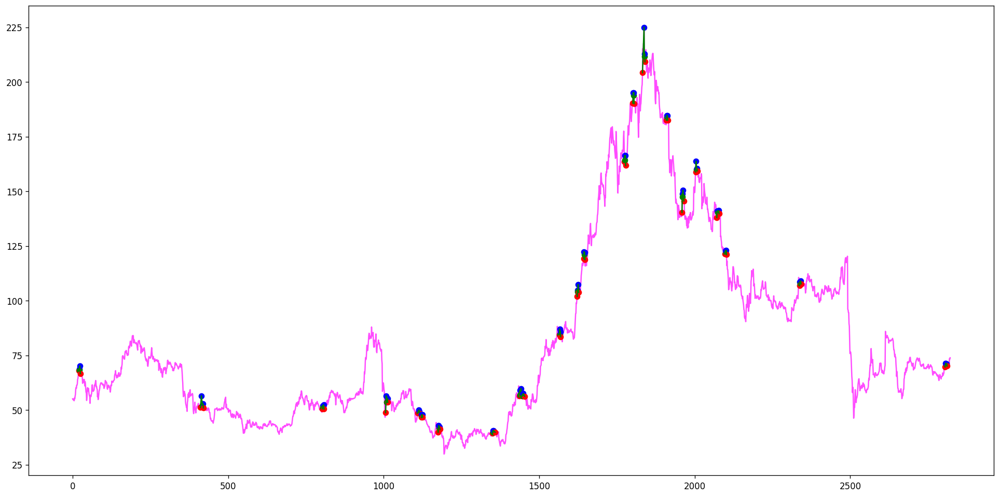

[(189, 196, 201, 213, 215), (189, 197, 201, 211, 215), (189, 197, 201, 213, 215), (316, 319, 326, 327, 330), (635, 636, 643, 644, 645), (672, 674, 675, 677, 678), (758, 759, 762, 763, 765), (790, 791, 792, 794, 795), (813, 816, 817, 819, 821), (858, 861, 862, 864, 866), (915, 917, 918, 919, 922), (934, 936, 937, 939, 941), (983, 984, 985, 986, 987), (1062, 1063, 1064, 1065, 1067), (1196, 1199, 1202, 1203, 1205), (1656, 1658, 1660, 1665, 1666), (1690, 1694, 1701, 1703, 1704), (1792, 1795, 1798, 1804, 1807), (3358, 3367, 3371, 3377, 3386), (3686, 3689, 3691, 3694, 3696), (3837, 3841, 3846, 3849, 3861), (3837, 3841, 3846, 3850, 3861), (3909, 3919, 3927, 3931, 3933), (4169, 4171, 4172, 4177, 4186)]
[]
Ticker AFLYY found 24 double top patterns, 0 double bottom patterns


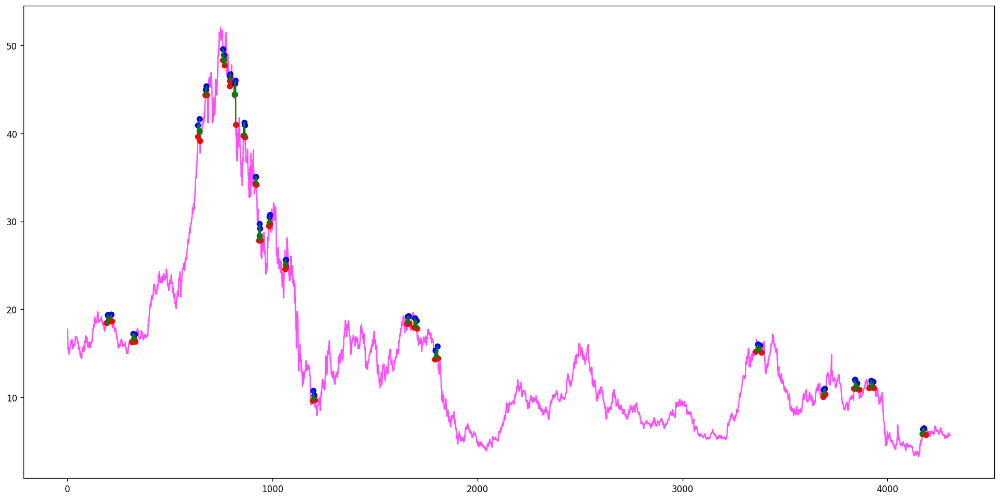

[(92, 94, 102, 105, 107), (274, 275, 276, 277, 280)]
[]
Ticker AFMD found 2 double top patterns, 0 double bottom patterns


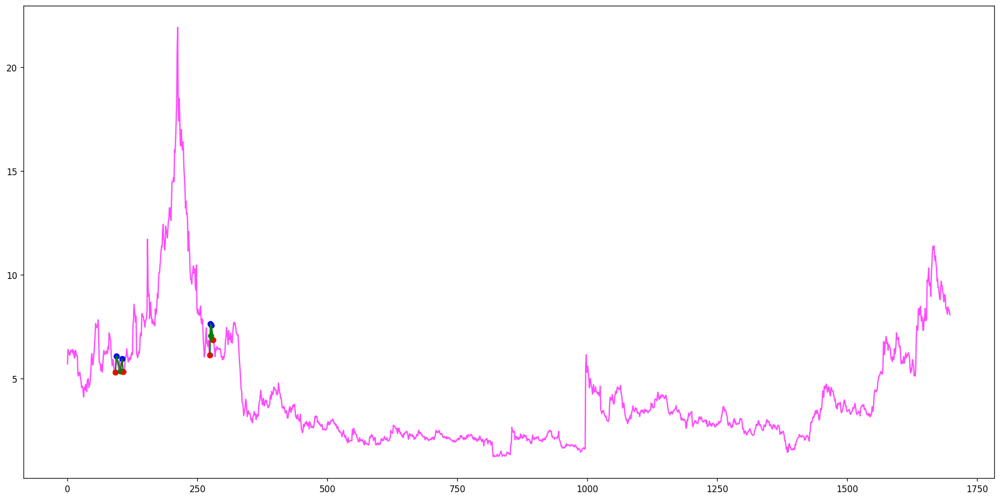

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(47, 48, 49, 50, 51), (85, 86, 88, 89, 90), (92, 93, 94, 95, 96), (213, 214, 216, 217, 218), (257, 258, 259, 261, 263), (263, 265, 267, 268, 269), (269, 271, 273, 276, 277), (273, 274, 275, 276, 277), (315, 316, 317, 318, 319), (469, 470, 472, 473, 474), (493, 495, 496, 497, 498), (555, 556, 557, 558, 559), (559, 560, 561, 562, 563), (606, 607, 609, 610, 611), (780, 781, 782, 788, 789), (842, 843, 844, 845, 846), (854, 855, 856, 857, 858), (856, 857, 858, 859, 860), (858, 859, 860, 861, 862), (866, 867, 868, 869, 870), (909, 910, 911, 912, 913), (947, 948, 949, 950, 951), (957, 958, 959, 960, 961), (1107, 1108, 1109, 1110, 1111), (1113, 1114, 1116, 1117, 1118), (1147, 1150, 1151, 1152, 1153), (1156, 1158, 1162, 1163, 1166), (1171, 1173, 1174, 1175, 1176), (1178, 1179, 1180, 1182, 1185), (1220, 1221, 1222, 1223, 1224), (1294, 1295, 1296, 1297, 1298), (1304, 1305, 1306, 1307, 1308), (1328, 1329, 1330, 1331, 1332), (1343, 1344, 1345, 1346, 1347), (1377, 1378, 1380, 1381, 1382), (1394, 13

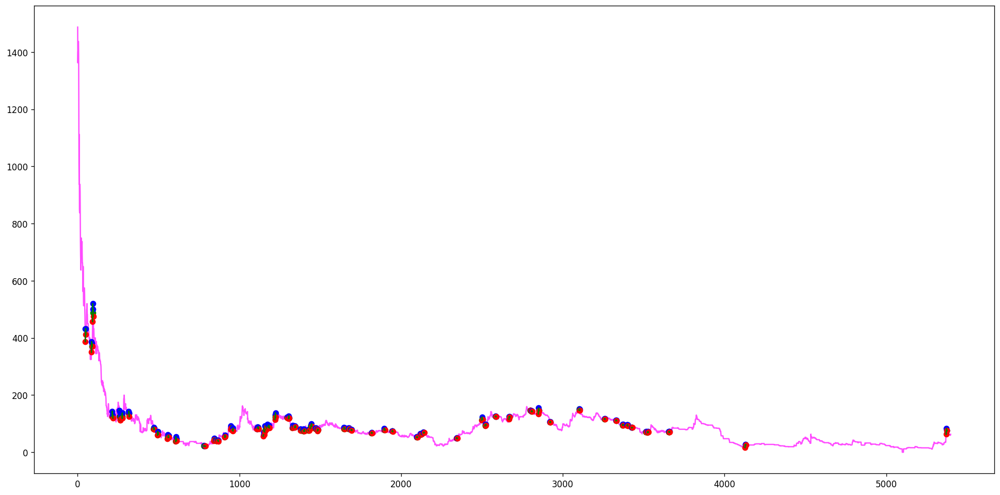

[(46, 47, 51, 52, 60), (228, 229, 232, 233, 234), (462, 463, 464, 465, 466)]
[]
Ticker AFP.SW found 3 double top patterns, 0 double bottom patterns


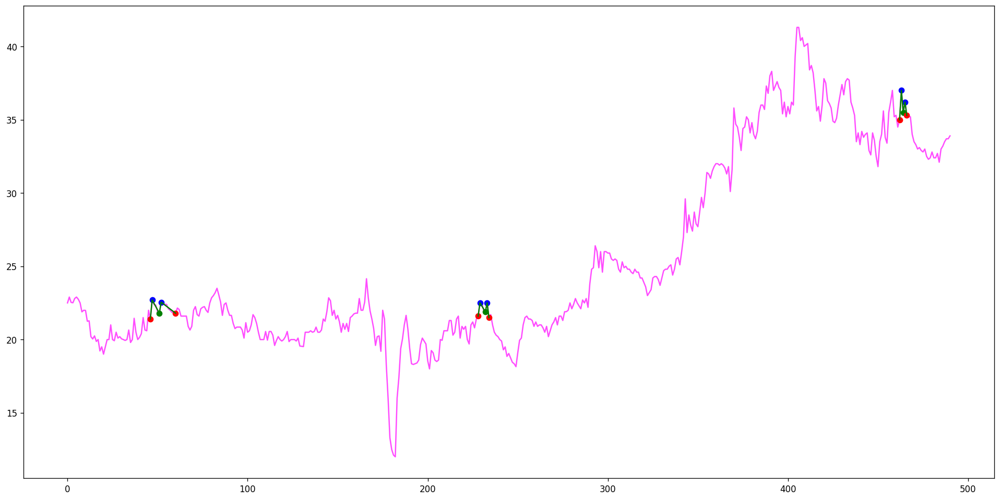

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(6, 7, 8, 9, 10), (20, 21, 25, 27, 30), (34, 35, 43, 47, 48), (52, 53, 54, 56, 57), (51, 56, 57, 58, 59), (50, 56, 59, 61, 67), (77, 78, 80, 81, 82), (124, 125, 126, 127, 128), (139, 141, 142, 143, 144), (148, 149, 150, 151, 152), (192, 193, 194, 195, 196), (225, 229, 230, 232, 234), (243, 244, 245, 246, 248), (249, 250, 251, 252, 253), (262, 263, 264, 265, 267), (264, 265, 267, 268, 271), (267, 268, 269, 270, 271), (324, 325, 326, 327, 328), (348, 349, 350, 351, 352), (336, 344, 348, 349, 357), (348, 349, 357, 366, 367), (394, 396, 398, 399, 400), (431, 434, 435, 439, 441), (611, 612, 613, 614, 615), (665, 666, 667, 668, 670), (718, 719, 721, 722, 726), (742, 748, 752, 753, 754), (761, 762, 763, 764, 765), (768, 770, 772, 774, 775), (800, 801, 802, 803, 804), (798, 803, 804, 805, 807), (814, 815, 816, 817, 823), (843, 844, 847, 850, 851), (847, 848, 849, 850, 851), (909, 910, 911, 912, 913), (968, 969, 970, 971, 972), (1022, 1023, 1024, 1026, 1027), (1112, 1113, 1115, 1116, 1117), (1

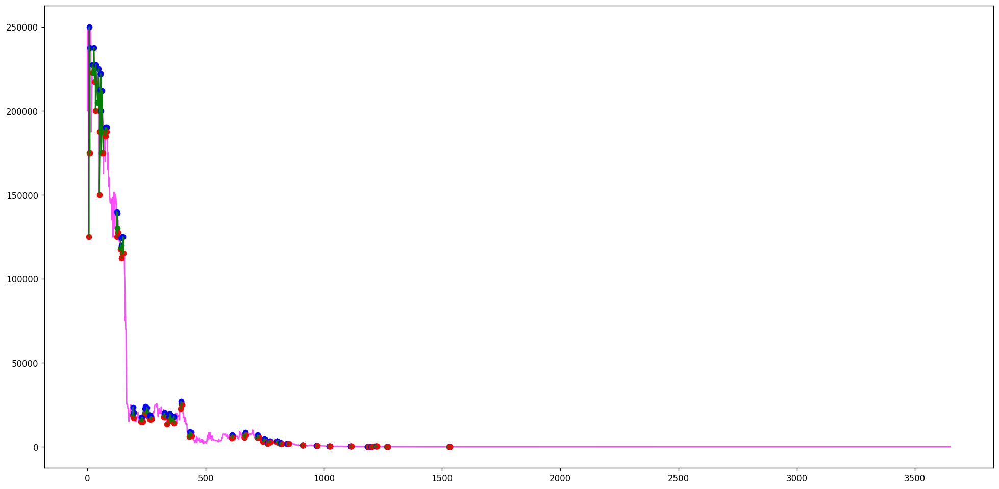

[(55, 56, 58, 59, 60), (69, 70, 71, 72, 73), (83, 84, 85, 86, 87)]
[]
Ticker AFRM found 3 double top patterns, 0 double bottom patterns


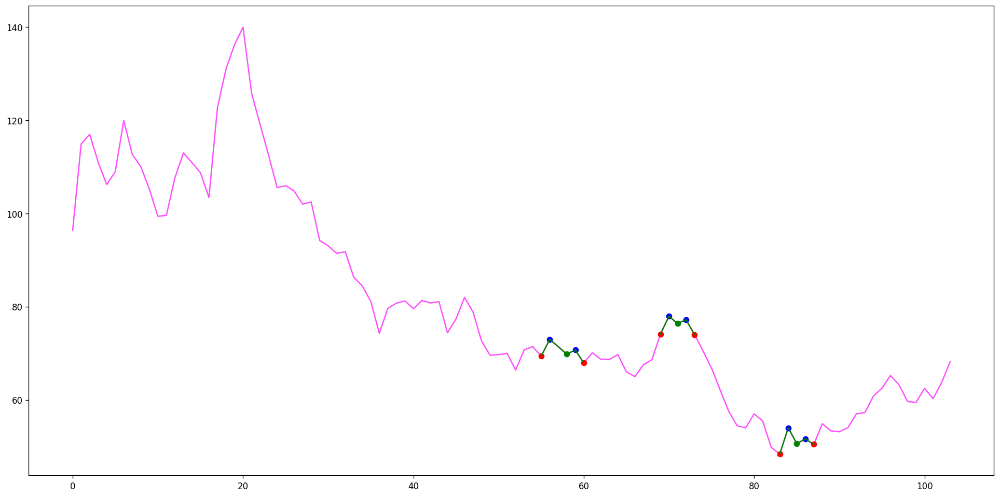

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(28, 29, 30, 31, 32), (583, 584, 585, 586, 587), (659, 660, 661, 662, 664), (828, 829, 830, 831, 832), (1026, 1027, 1028, 1029, 1030), (1542, 1543, 1545, 1547, 1548), (2742, 2743, 2744, 2749, 2750), (3210, 3211, 3212, 3213, 3215)]
[]
Ticker AFS.L found 8 double top patterns, 0 double bottom patterns


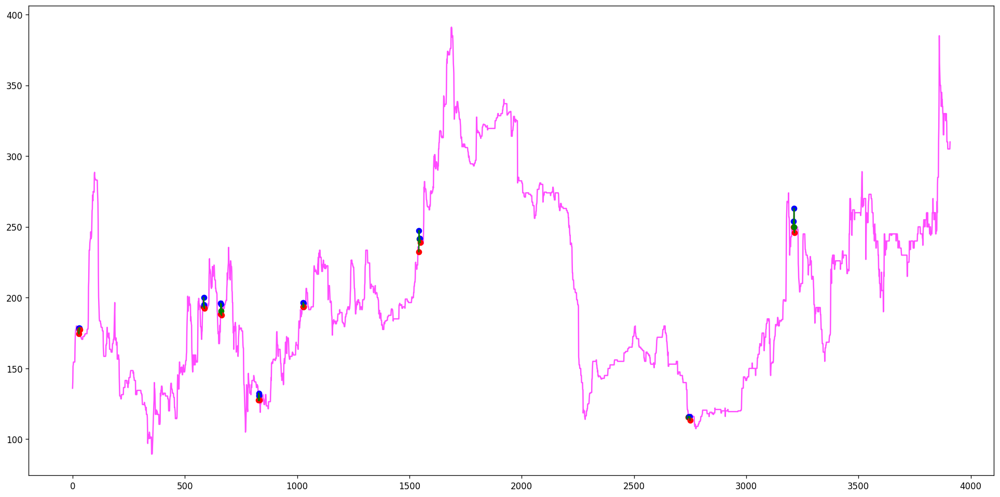

[(1211, 1214, 1216, 1217, 1218), (1315, 1316, 1319, 1321, 1322)]
[]
Ticker AFSIB found 2 double top patterns, 0 double bottom patterns


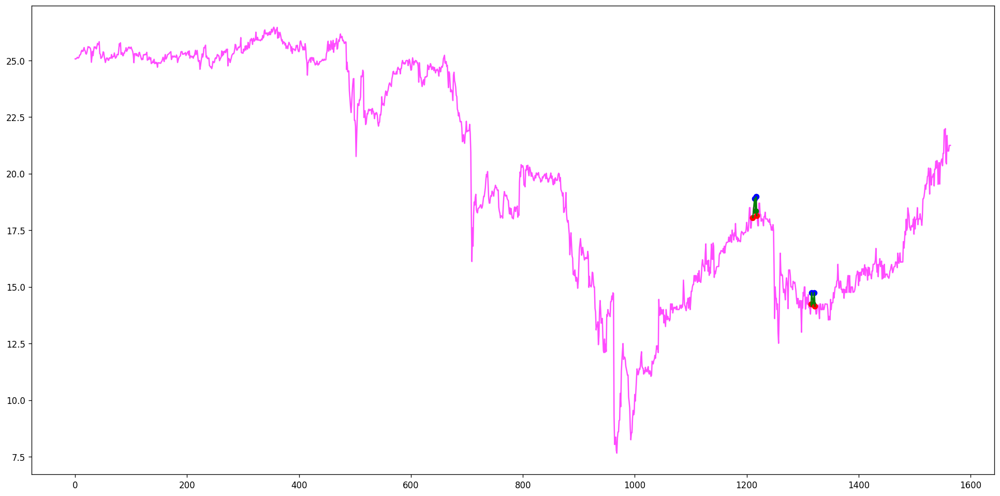

[(830, 832, 833, 839, 841)]
[]
Ticker AFSIC found 1 double top patterns, 0 double bottom patterns


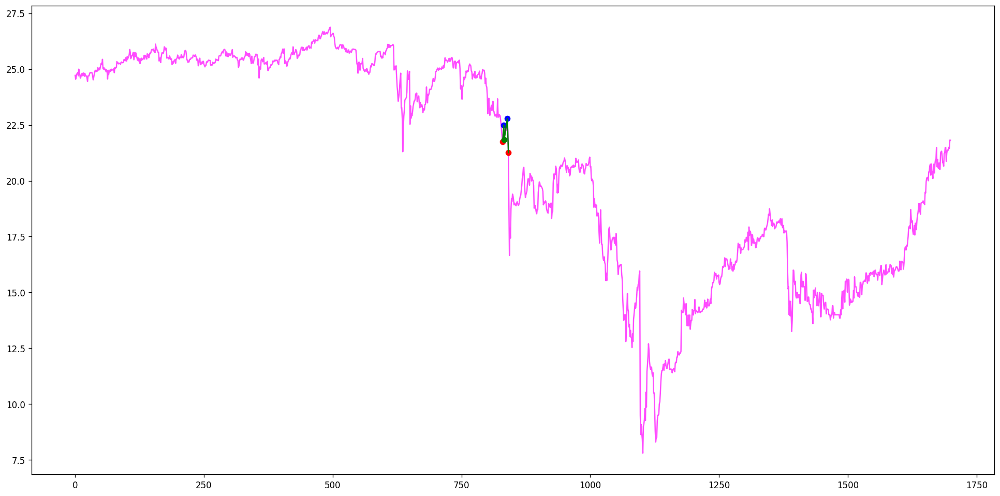

[(454, 456, 457, 463, 465), (1027, 1028, 1031, 1034, 1037), (1023, 1034, 1037, 1041, 1046), (1023, 1034, 1037, 1042, 1046)]
[]
Ticker AFSIM found 4 double top patterns, 0 double bottom patterns


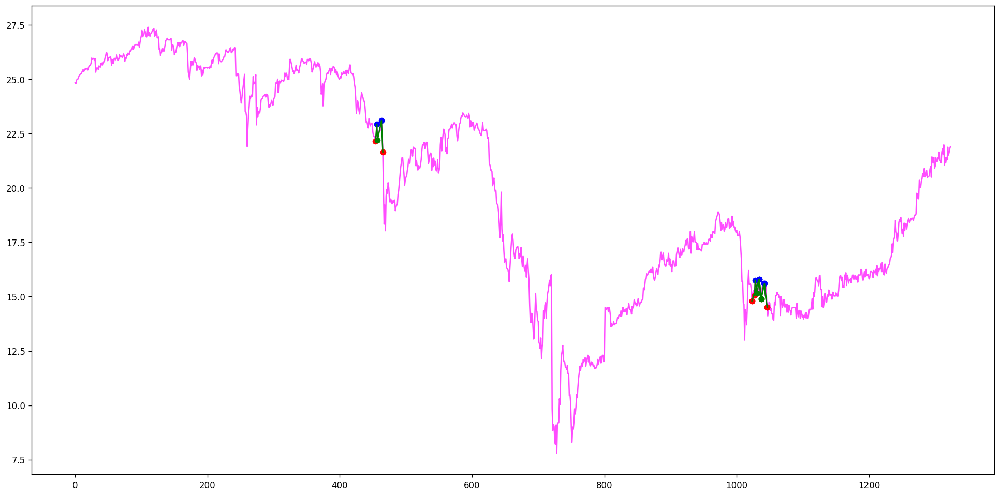

[(448, 450, 451, 457, 459), (1130, 1131, 1132, 1133, 1135), (1265, 1268, 1269, 1270, 1271), (1274, 1278, 1279, 1280, 1281), (1279, 1280, 1281, 1282, 1283)]
[]
Ticker AFSIN found 5 double top patterns, 0 double bottom patterns


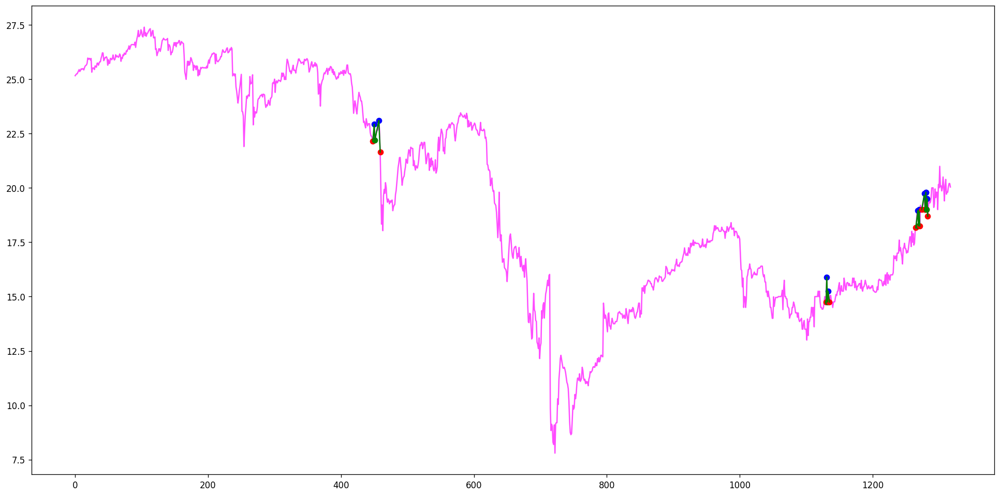

[(644, 646, 647, 653, 655), (1236, 1237, 1239, 1240, 1241), (1247, 1249, 1251, 1252, 1253), (1348, 1349, 1352, 1355, 1358), (1384, 1386, 1391, 1394, 1400), (1384, 1387, 1391, 1394, 1400)]
[]
Ticker AFSIP found 6 double top patterns, 0 double bottom patterns


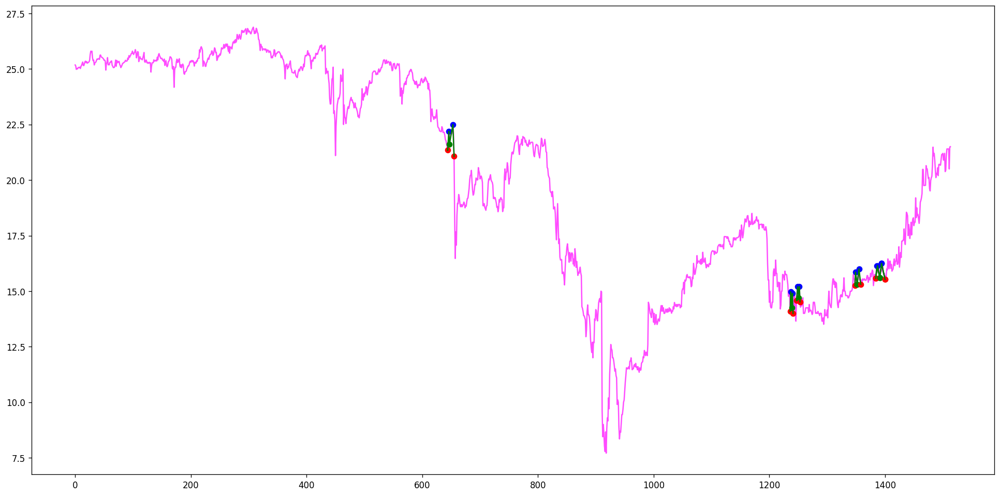

[(423, 430, 434, 435, 444), (582, 584, 585, 587, 592)]
[]
Ticker AFT found 2 double top patterns, 0 double bottom patterns


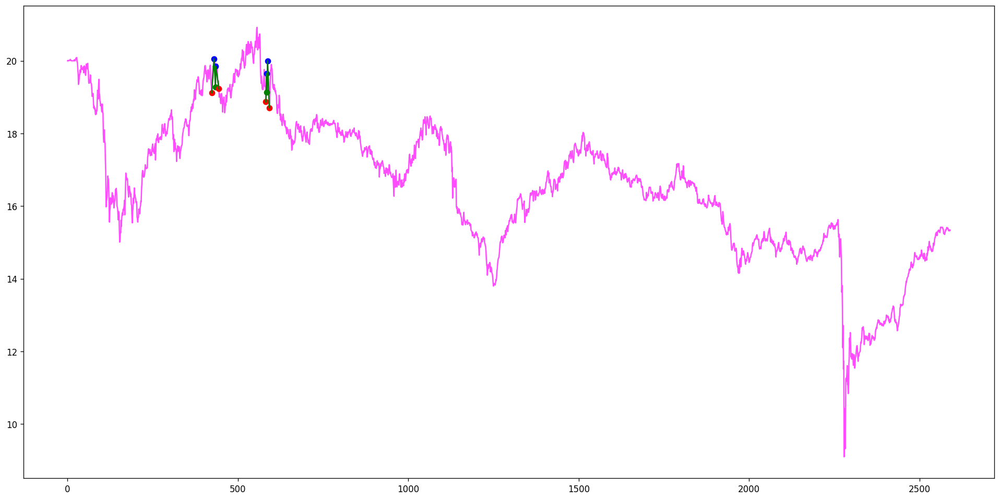

[(236, 237, 240, 241, 244), (315, 319, 320, 321, 322), (347, 348, 350, 351, 353), (362, 363, 364, 366, 368), (422, 423, 424, 425, 426), (490, 494, 500, 501, 503), (490, 496, 500, 501, 503), (490, 498, 500, 501, 503)]
[]
Ticker AFTM found 8 double top patterns, 0 double bottom patterns


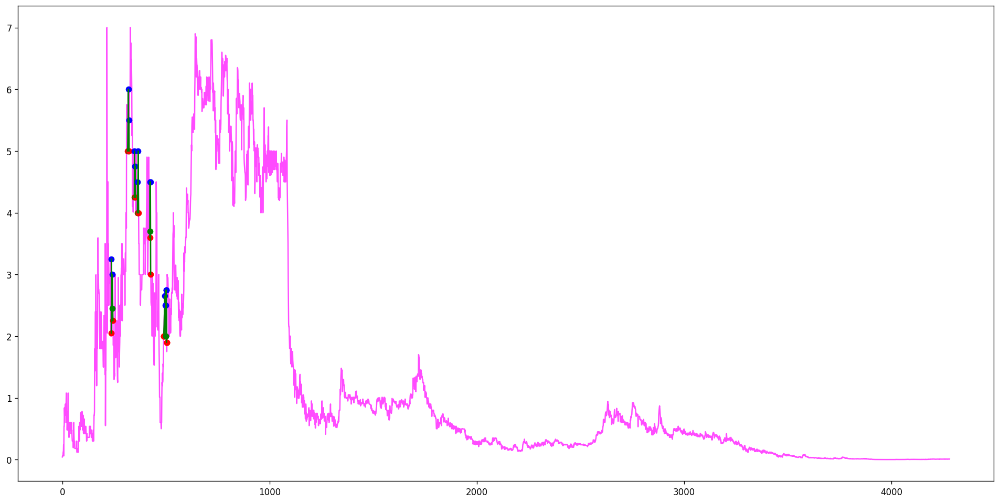

[(55, 56, 59, 60, 61), (82, 83, 84, 85, 86), (131, 132, 133, 134, 135), (169, 170, 171, 172, 173), (194, 197, 199, 200, 201)]
[]
Ticker AFTPY found 5 double top patterns, 0 double bottom patterns


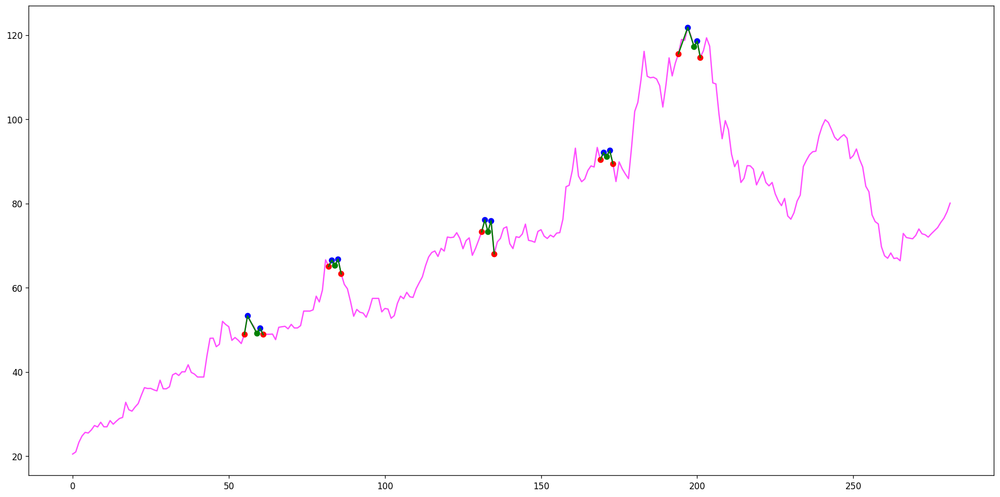

[(236, 237, 238, 239, 240), (244, 245, 246, 247, 248), (288, 290, 291, 292, 295), (296, 297, 299, 300, 301), (312, 313, 314, 315, 316), (319, 320, 321, 322, 323)]
[]
Ticker AFW.DE found 6 double top patterns, 0 double bottom patterns


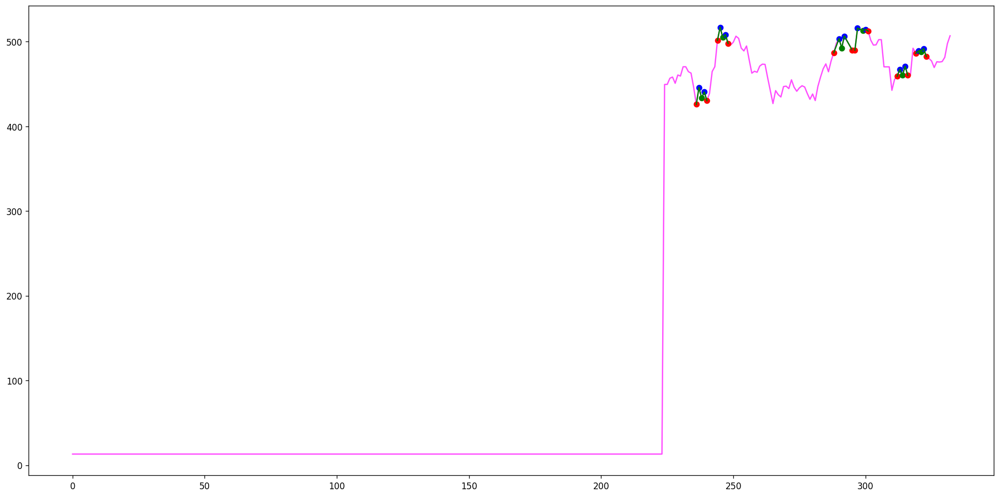

[(8, 10, 12, 13, 15), (20, 21, 22, 23, 25), (36, 39, 40, 41, 42), (64, 65, 67, 68, 69), (82, 84, 85, 86, 90), (92, 93, 94, 95, 96), (132, 133, 134, 135, 136), (157, 158, 159, 160, 161), (165, 167, 168, 169, 170), (191, 194, 200, 201, 202), (206, 207, 209, 210, 211), (215, 216, 217, 218, 219), (225, 226, 227, 228, 230), (241, 243, 244, 245, 246), (271, 272, 273, 274, 275), (280, 281, 282, 283, 286), (309, 310, 311, 313, 314)]
[]
Ticker AFW.DU found 17 double top patterns, 0 double bottom patterns


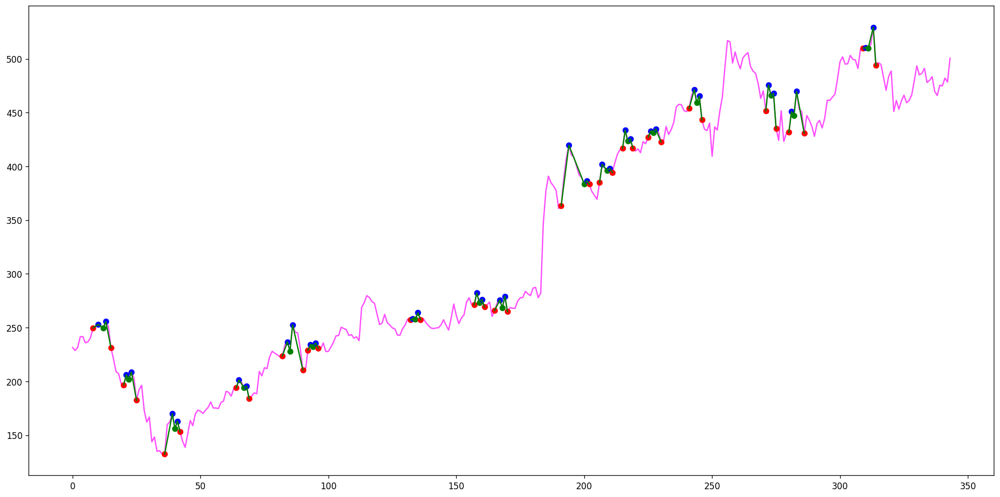

[(103, 104, 105, 107, 113), (244, 245, 246, 250, 255), (585, 587, 591, 594, 599), (630, 632, 634, 636, 638), (732, 734, 736, 738, 741), (780, 783, 785, 791, 792), (799, 801, 802, 806, 808), (1775, 1776, 1777, 1778, 1779), (1791, 1794, 1796, 1797, 1798), (2258, 2262, 2265, 2267, 2272), (2615, 2616, 2617, 2618, 2619), (2650, 2651, 2655, 2656, 2660), (3072, 3074, 3077, 3079, 3081), (3094, 3095, 3097, 3098, 3099), (3216, 3218, 3219, 3220, 3221), (3278, 3279, 3281, 3282, 3283), (3349, 3352, 3353, 3354, 3355), (3480, 3481, 3482, 3484, 3485), (3560, 3561, 3562, 3563, 3564), (3575, 3576, 3577, 3578, 3579), (3661, 3663, 3664, 3666, 3667), (3843, 3844, 3845, 3846, 3847), (3860, 3861, 3863, 3864, 3866), (3921, 3923, 3924, 3925, 3926), (3939, 3940, 3941, 3942, 3943), (4023, 4024, 4026, 4028, 4029), (4036, 4037, 4038, 4039, 4040), (4053, 4054, 4055, 4056, 4057), (4123, 4124, 4125, 4127, 4129), (4147, 4148, 4149, 4150, 4151), (4156, 4158, 4160, 4161, 4163), (4222, 4223, 4224, 4225, 4226), (4262, 426

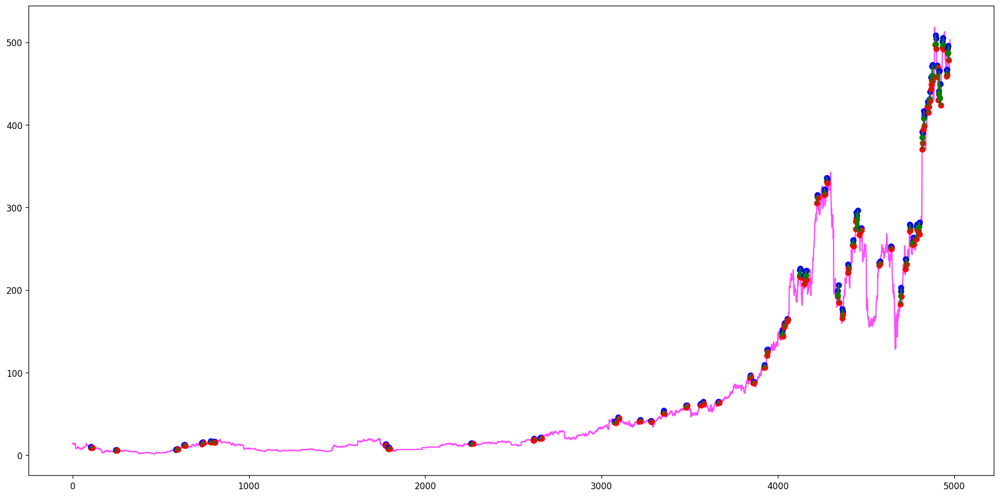

[(122, 123, 124, 125, 127), (137, 138, 140, 141, 142), (160, 161, 163, 164, 165), (171, 172, 173, 175, 176), (273, 274, 276, 278, 280), (318, 319, 320, 321, 322), (349, 350, 351, 352, 353), (401, 404, 406, 407, 409), (469, 470, 472, 473, 474), (488, 489, 490, 492, 496), (516, 518, 520, 521, 522), (528, 529, 530, 531, 532), (544, 547, 548, 549, 550), (567, 568, 570, 573, 578), (590, 592, 593, 594, 598), (600, 601, 602, 603, 604), (673, 675, 676, 677, 678), (749, 751, 752, 753, 754), (788, 789, 790, 791, 794), (788, 791, 794, 795, 798), (815, 821, 822, 823, 824)]
[]
Ticker AFW.MU found 21 double top patterns, 0 double bottom patterns


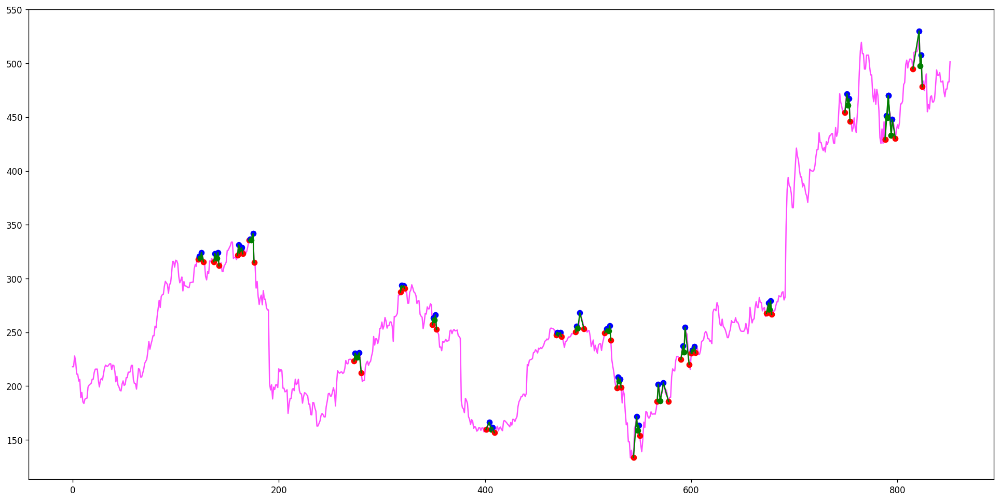

[(177, 178, 179, 180, 181), (206, 207, 208, 210, 211), (251, 252, 253, 254, 255), (524, 526, 531, 532, 534), (580, 581, 582, 583, 584), (594, 595, 596, 597, 598), (658, 659, 662, 663, 664), (794, 795, 796, 797, 798), (807, 808, 810, 812, 813), (829, 830, 831, 837, 838), (844, 845, 846, 847, 850), (884, 885, 886, 888, 891), (1115, 1116, 1117, 1118, 1120), (1125, 1126, 1128, 1129, 1130), (1132, 1133, 1134, 1135, 1136), (1149, 1150, 1151, 1152, 1153), (1211, 1212, 1213, 1214, 1216), (1279, 1280, 1281, 1283, 1284), (1289, 1291, 1292, 1294, 1296), (1311, 1312, 1313, 1316, 1317), (1306, 1316, 1318, 1320, 1321), (1355, 1356, 1357, 1359, 1361), (1410, 1411, 1412, 1413, 1414), (1419, 1420, 1421, 1422, 1423), (1419, 1422, 1423, 1424, 1426), (1429, 1430, 1431, 1433, 1434), (1531, 1532, 1535, 1536, 1537), (1557, 1558, 1560, 1561, 1563), (1565, 1566, 1567, 1568, 1569), (1602, 1603, 1604, 1606, 1608), (1617, 1618, 1619, 1620, 1622), (1629, 1630, 1631, 1632, 1633), (1773, 1774, 1775, 1776, 1778), (18

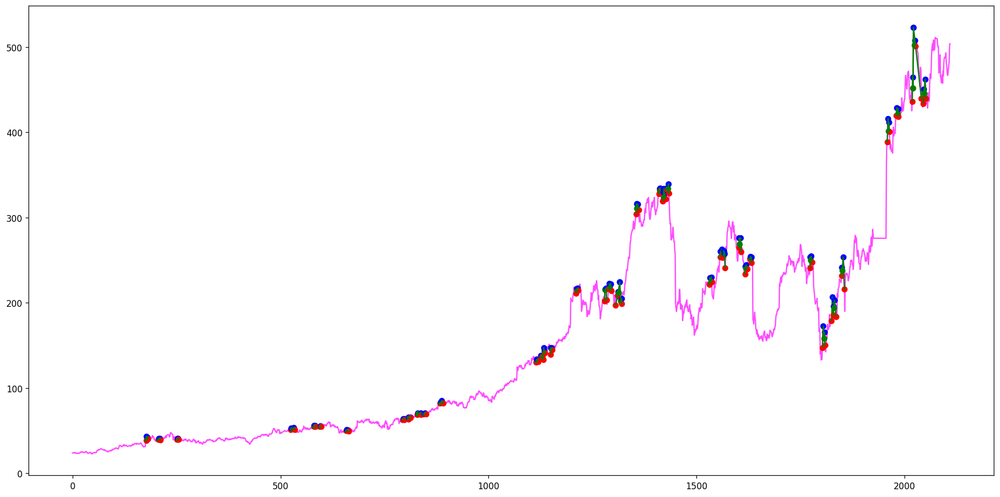

[(10, 11, 12, 13, 14), (124, 125, 126, 127, 129), (1751, 1764, 1766, 1767, 1768), (2314, 2316, 2318, 2322, 2329), (2895, 2900, 2904, 2912, 2916), (3222, 3225, 3226, 3230, 3236), (3283, 3286, 3290, 3294, 3298), (3381, 3388, 3390, 3391, 3392), (3889, 3892, 3895, 3896, 3897), (3919, 3920, 3921, 3925, 3927), (4369, 4373, 4374, 4375, 4376), (4504, 4508, 4510, 4511, 4512), (4523, 4524, 4525, 4526, 4527), (4604, 4605, 4606, 4608, 4609), (4794, 4796, 4798, 4800, 4801), (4939, 4942, 4943, 4944, 4945), (4952, 4953, 4954, 4956, 4957), (4999, 5000, 5002, 5003, 5004), (5126, 5127, 5128, 5129, 5131), (5147, 5148, 5149, 5150, 5152), (5171, 5172, 5173, 5175, 5176), (5186, 5187, 5188, 5189, 5190), (5219, 5220, 5221, 5222, 5223), (5237, 5238, 5239, 5240, 5241), (5266, 5269, 5270, 5271, 5272), (5358, 5359, 5360, 5361, 5362)]
[]
Ticker AFX.DE found 26 double top patterns, 0 double bottom patterns


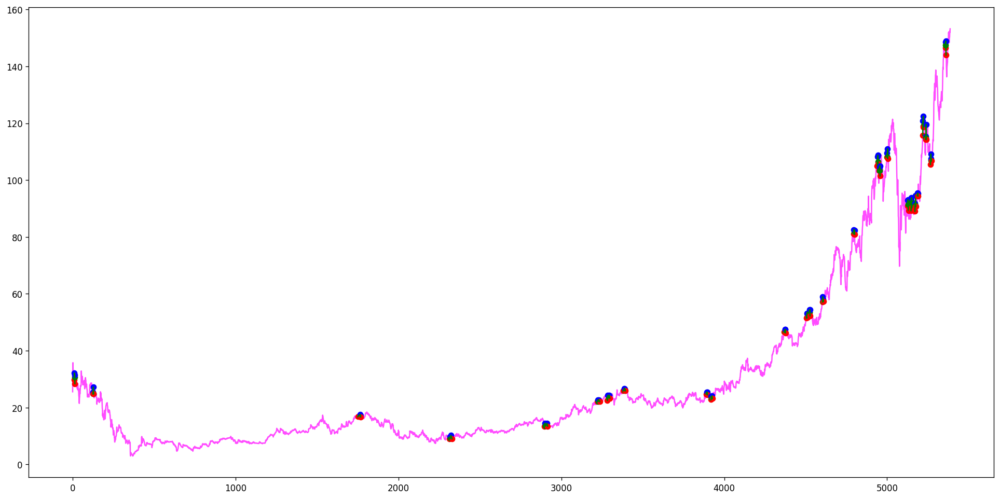

[(56, 57, 61, 62, 67), (801, 802, 804, 806, 808), (801, 802, 804, 807, 808), (810, 811, 814, 815, 816), (844, 845, 846, 847, 848), (864, 865, 867, 870, 872), (1106, 1108, 1114, 1116, 1122), (1996, 1998, 2001, 2002, 2005), (2302, 2304, 2308, 2309, 2310), (2326, 2329, 2340, 2342, 2343), (2326, 2331, 2340, 2342, 2343), (2600, 2603, 2607, 2609, 2616), (2600, 2603, 2607, 2611, 2616), (2905, 2908, 2910, 2917, 2923), (3252, 3255, 3256, 3260, 3266), (3562, 3567, 3571, 3572, 3574), (3562, 3569, 3571, 3572, 3574), (3702, 3710, 3716, 3721, 3724), (3921, 3924, 3931, 3935, 3942), (4017, 4022, 4024, 4025, 4027), (4047, 4048, 4050, 4052, 4053), (4290, 4292, 4295, 4296, 4302), (4413, 4414, 4415, 4418, 4420), (4555, 4556, 4557, 4558, 4559), (4587, 4588, 4589, 4590, 4591), (4638, 4640, 4641, 4642, 4644), (4860, 4861, 4862, 4864, 4865), (4932, 4933, 4934, 4935, 4936), (4971, 4974, 4975, 4976, 4977), (5113, 5114, 5115, 5116, 5119), (5179, 5180, 5181, 5182, 5183), (5226, 5227, 5228, 5229, 5230), (5251, 525

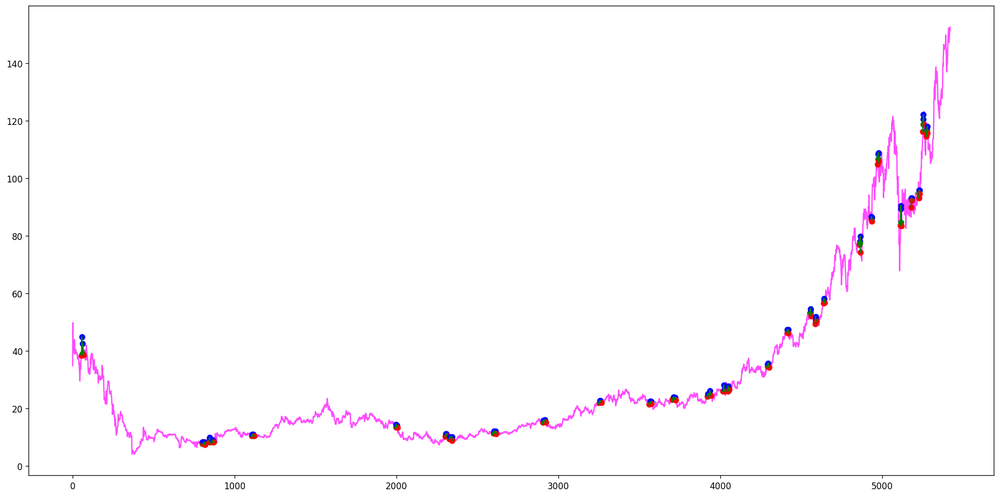

[(1817, 1819, 1824, 1838, 1839), (2525, 2529, 2530, 2532, 2538), (2755, 2756, 2757, 2759, 2762), (2848, 2850, 2854, 2858, 2862), (3640, 3644, 3645, 3648, 3652), (3976, 3979, 3980, 3981, 3982), (4048, 4049, 4050, 4051, 4056), (4070, 4074, 4075, 4077, 4078), (4121, 4122, 4123, 4124, 4125), (4167, 4168, 4170, 4171, 4172), (4195, 4196, 4197, 4199, 4201), (4251, 4252, 4254, 4256, 4257), (4480, 4481, 4483, 4484, 4485), (4505, 4508, 4509, 4510, 4511), (4594, 4595, 4596, 4597, 4598), (4629, 4630, 4631, 4632, 4633), (4691, 4692, 4693, 4695, 4697), (4719, 4720, 4721, 4723, 4725), (4760, 4761, 4762, 4763, 4764), (4789, 4790, 4793, 4794, 4795), (4802, 4803, 4804, 4806, 4807), (4845, 4846, 4847, 4848, 4849), (4911, 4912, 4913, 4914, 4917)]
[]
Ticker AFX.HA found 23 double top patterns, 0 double bottom patterns


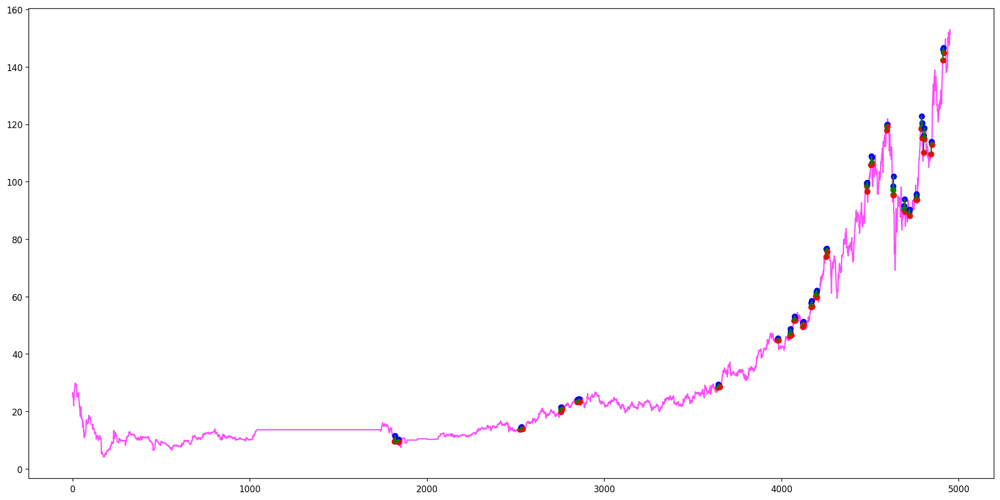

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(43, 44, 45, 46, 47), (42, 44, 47, 49, 51), (546, 548, 549, 550, 551), (590, 591, 592, 593, 594), (708, 709, 710, 711, 713), (745, 746, 748, 750, 751), (820, 821, 822, 823, 824), (842, 843, 844, 849, 858), (886, 887, 888, 890, 893), (908, 909, 910, 911, 912), (925, 927, 928, 929, 930), (921, 923, 924, 927, 931), (958, 960, 962, 963, 964), (950, 954, 956, 960, 973), (974, 975, 976, 977, 978), (1000, 1001, 1002, 1003, 1004), (1004, 1005, 1008, 1009, 1010), (1016, 1019, 1020, 1027, 1034), (1045, 1046, 1047, 1048, 1049)]
[]
Ticker AFX.L found 19 double top patterns, 0 double bottom patterns


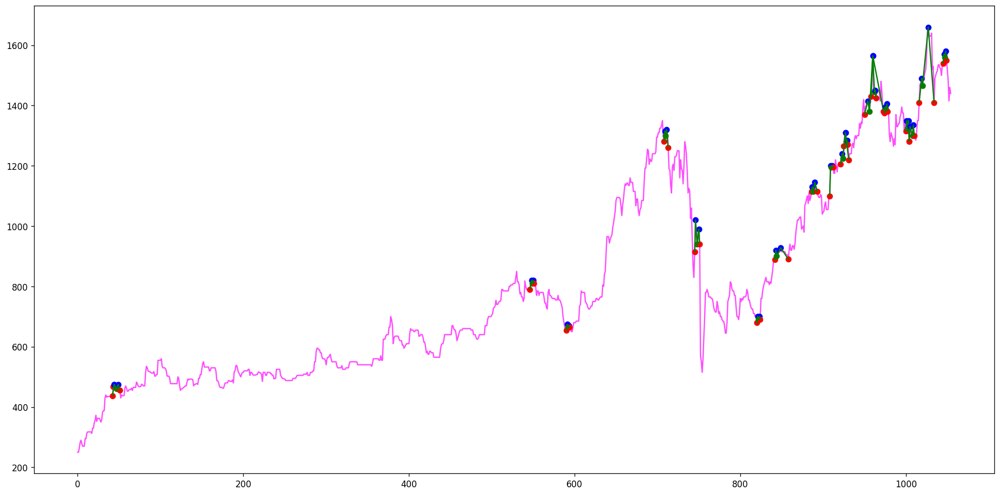

[(69, 72, 74, 75, 76), (87, 88, 89, 90, 91), (100, 101, 103, 104, 105), (355, 357, 359, 360, 361), (506, 508, 509, 511, 512), (555, 556, 558, 559, 560), (682, 683, 684, 685, 687), (710, 711, 712, 713, 714), (750, 751, 752, 753, 754), (823, 824, 825, 827, 828)]
[]
Ticker AFX.VI found 10 double top patterns, 0 double bottom patterns


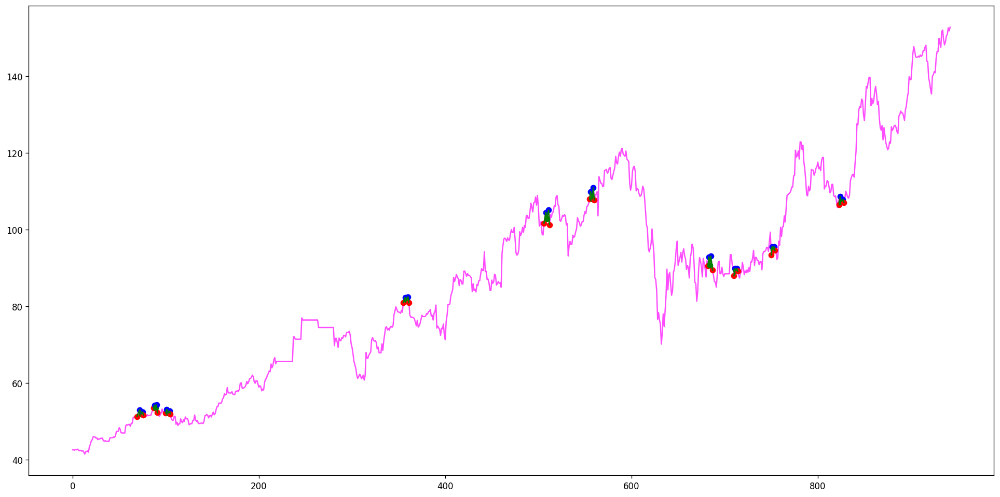

[(37, 39, 42, 43, 46), (163, 164, 165, 166, 167)]
[]
Ticker AFYA found 2 double top patterns, 0 double bottom patterns


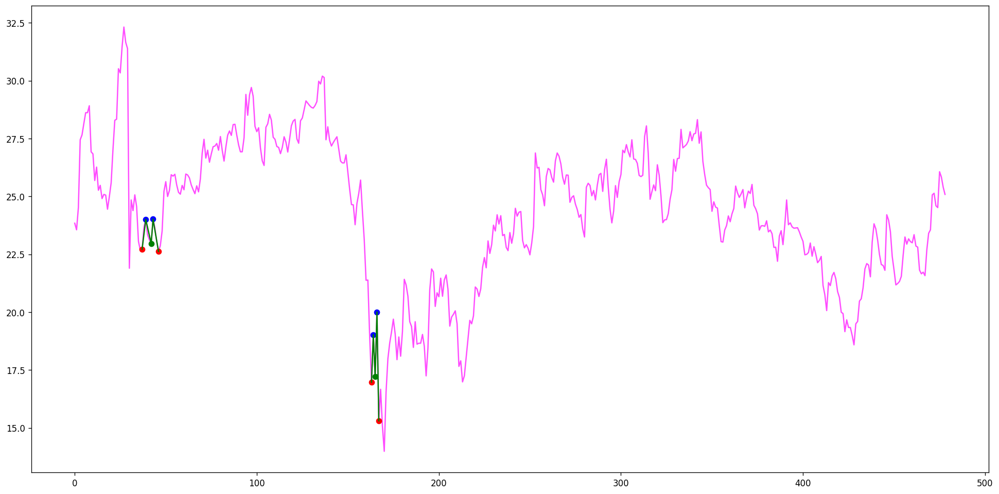

[(941, 942, 945, 951, 959)]
[]
Ticker AFZ.BE found 1 double top patterns, 0 double bottom patterns


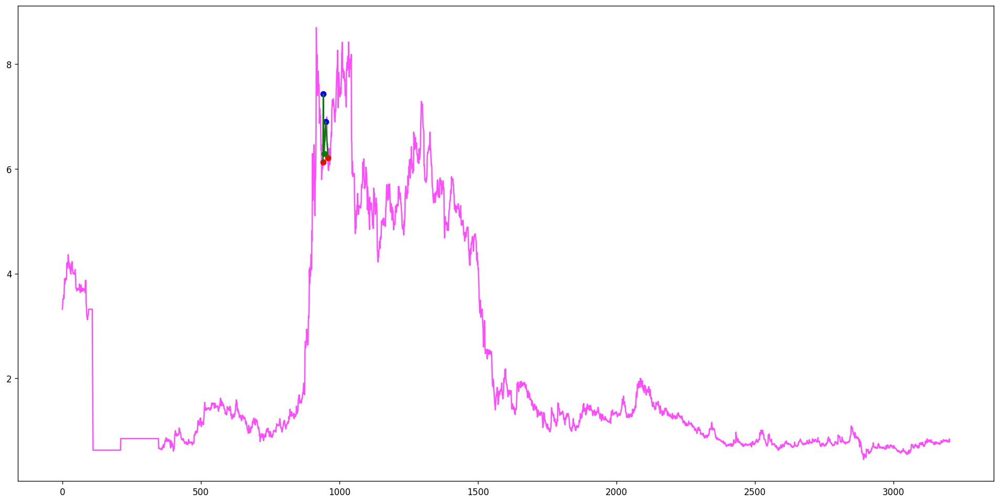

[(946, 952, 954, 957, 960), (1038, 1044, 1050, 1054, 1059)]
[]
Ticker AFZ.F found 2 double top patterns, 0 double bottom patterns


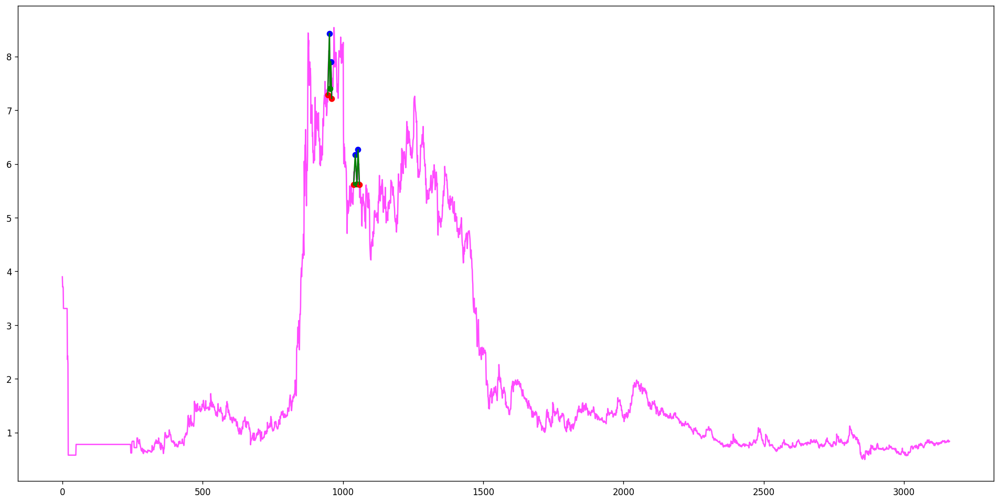

[]
[]
Ticker AFZ.MU found 0 double top patterns, 0 double bottom patterns


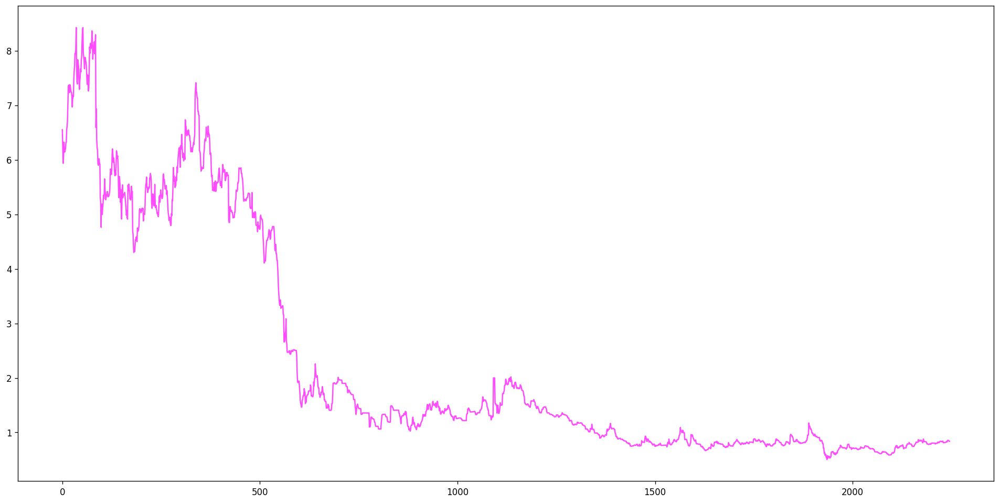

[]
[]
Ticker AFZ.SG found 0 double top patterns, 0 double bottom patterns


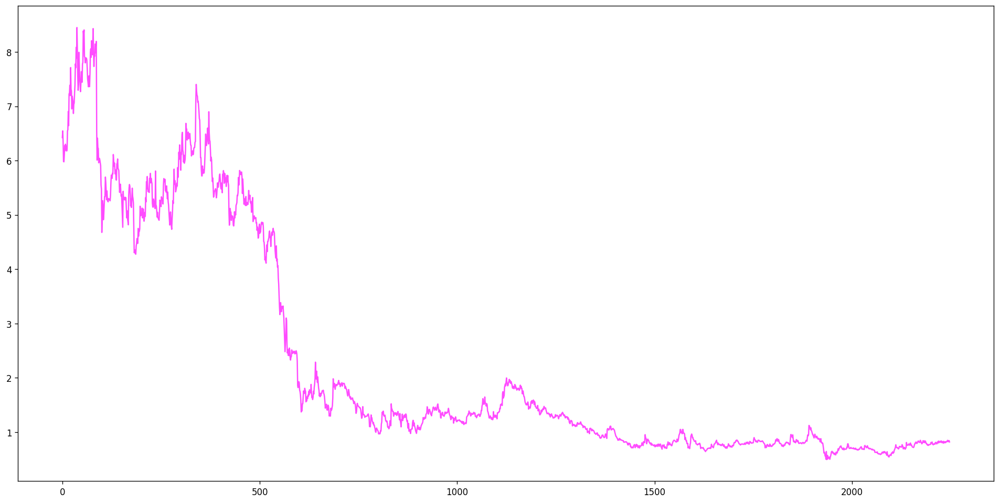

[(82, 83, 84, 86, 87), (364, 367, 370, 373, 375), (530, 531, 533, 535, 536), (558, 560, 562, 565, 566), (568, 571, 573, 574, 575), (581, 582, 584, 585, 588), (940, 942, 945, 947, 948), (1193, 1198, 1200, 1203, 1204), (1269, 1271, 1273, 1279, 1280), (1621, 1629, 1630, 1631, 1638), (1617, 1619, 1620, 1623, 1639)]
[]
Ticker AMC found 11 double top patterns, 0 double bottom patterns


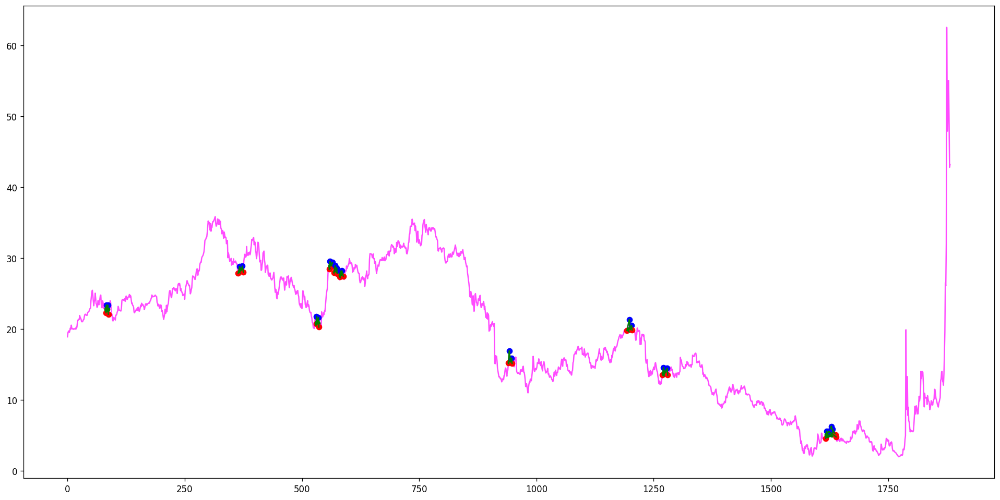

[(43, 44, 45, 46, 47), (81, 83, 84, 86, 88), (147, 148, 149, 150, 151), (262, 263, 265, 267, 269), (307, 308, 309, 310, 311), (620, 623, 626, 627, 638), (1063, 1072, 1078, 1080, 1083), (1412, 1413, 1417, 1420, 1422), (2115, 2117, 2121, 2125, 2129), (2795, 2799, 2802, 2804, 2813), (2973, 2975, 2977, 2985, 2992), (4313, 4314, 4315, 4316, 4317), (4953, 4957, 4960, 4961, 4962), (5088, 5089, 5090, 5091, 5092), (5125, 5127, 5128, 5129, 5130), (5143, 5144, 5147, 5149, 5150), (5184, 5185, 5187, 5188, 5190), (5281, 5282, 5283, 5285, 5286), (5286, 5287, 5288, 5289, 5291), (5307, 5308, 5309, 5312, 5314), (5353, 5354, 5357, 5358, 5359)]
[]
Ticker AMD found 21 double top patterns, 0 double bottom patterns


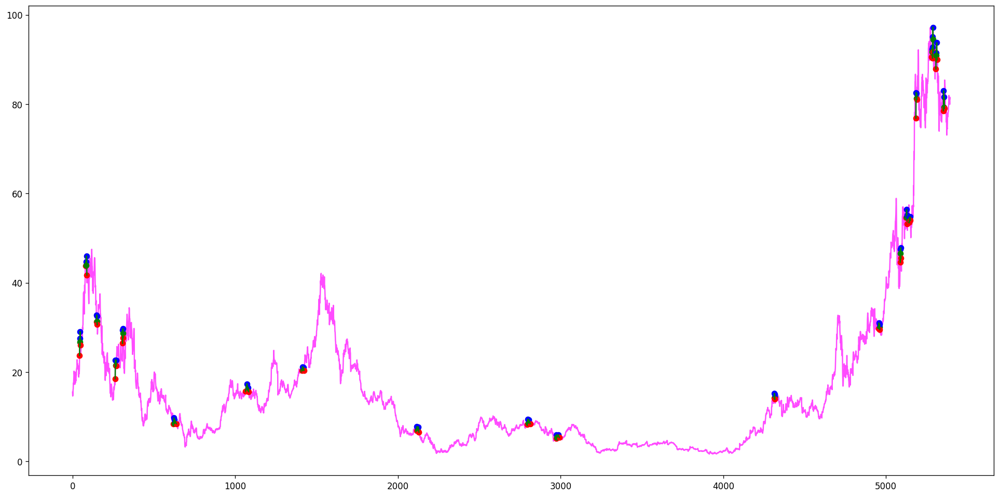

[(34, 35, 36, 37, 38), (89, 90, 91, 94, 96), (121, 123, 125, 126, 128), (133, 134, 135, 136, 137), (181, 183, 186, 187, 189), (266, 267, 268, 270, 271), (725, 727, 728, 729, 730), (756, 760, 764, 775, 779), (920, 921, 922, 923, 925), (1079, 1080, 1081, 1083, 1085), (1239, 1240, 1241, 1244, 1247), (1401, 1402, 1405, 1407, 1408), (1484, 1490, 1492, 1495, 1500), (1700, 1701, 1702, 1704, 1706), (1844, 1846, 1847, 1849, 1850), (2036, 2037, 2038, 2039, 2041), (2162, 2163, 2165, 2166, 2167), (2184, 2185, 2187, 2188, 2189), (2264, 2265, 2266, 2267, 2268), (2274, 2275, 2276, 2277, 2278), (2297, 2298, 2300, 2301, 2302), (2338, 2340, 2343, 2344, 2345), (2368, 2369, 2370, 2371, 2373), (2383, 2384, 2385, 2386, 2387), (2587, 2590, 2591, 2592, 2593), (2601, 2602, 2603, 2604, 2606), (2614, 2615, 2617, 2619, 2620), (2676, 2677, 2678, 2679, 2680), (2727, 2729, 2730, 2731, 2733), (2848, 2849, 2850, 2851, 2852), (2866, 2867, 2868, 2869, 2870), (2950, 2951, 2952, 2953, 2954), (2964, 2965, 2966, 2967, 2968)

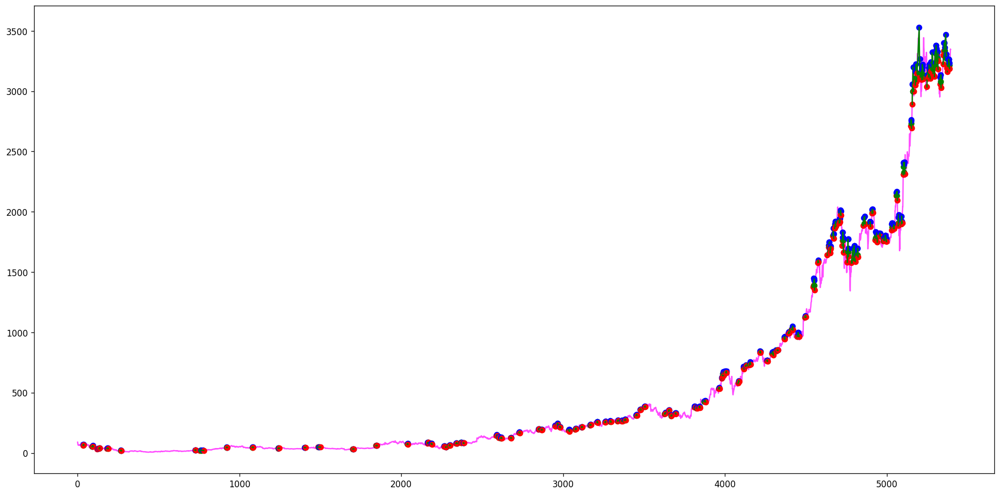

[(101, 102, 103, 104, 106), (236, 237, 238, 239, 240), (284, 285, 286, 290, 292), (324, 325, 326, 327, 328), (500, 503, 508, 509, 510), (590, 591, 592, 594, 596), (613, 614, 616, 617, 618), (657, 658, 660, 661, 662), (694, 696, 697, 698, 699), (713, 714, 715, 716, 717), (914, 920, 930, 931, 933), (1332, 1333, 1334, 1335, 1336), (1368, 1369, 1370, 1371, 1372), (1379, 1380, 1381, 1382, 1383), (1401, 1403, 1406, 1407, 1408), (1408, 1409, 1410, 1411, 1412), (1441, 1444, 1445, 1446, 1447), (1447, 1448, 1449, 1450, 1451), (1559, 1562, 1563, 1564, 1566), (1592, 1593, 1594, 1596, 1598), (1767, 1768, 1769, 1770, 1771), (1778, 1779, 1780, 1782, 1784), (2015, 2016, 2017, 2018, 2019), (2045, 2046, 2048, 2049, 2050), (2059, 2060, 2061, 2062, 2063), (2089, 2091, 2092, 2096, 2097), (2101, 2102, 2104, 2105, 2106), (2175, 2176, 2177, 2179, 2180), (2236, 2237, 2238, 2240, 2241), (2245, 2246, 2247, 2248, 2249), (2347, 2348, 2349, 2350, 2353), (2496, 2497, 2500, 2502, 2505), (2517, 2518, 2521, 2523, 2526)

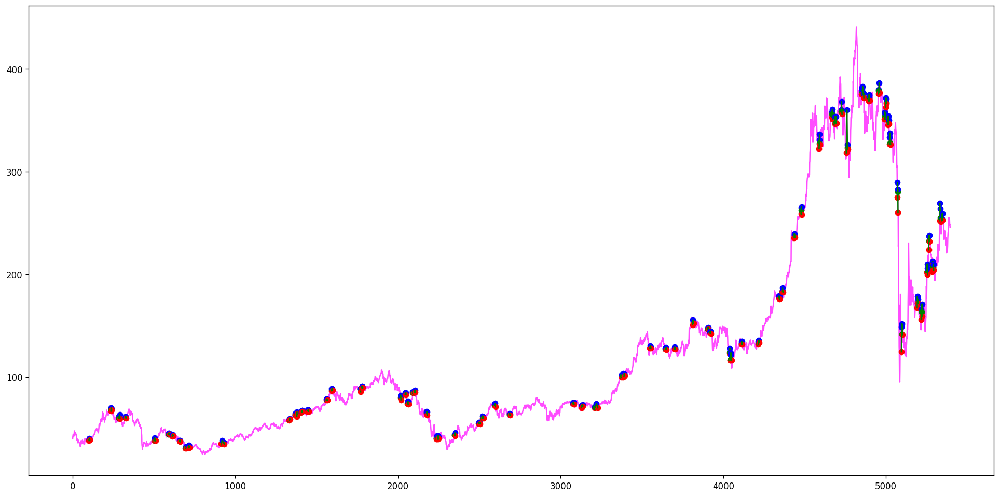

[(2, 3, 4, 5, 6), (73, 74, 75, 76, 78), (329, 330, 331, 332, 333), (589, 591, 594, 596, 597), (716, 717, 718, 719, 722), (799, 800, 801, 802, 803), (811, 813, 814, 815, 816), (819, 822, 823, 824, 825), (843, 844, 846, 847, 848), (893, 894, 895, 896, 897), (913, 914, 915, 916, 917), (917, 918, 919, 920, 921), (939, 940, 941, 942, 943), (949, 950, 951, 952, 953), (1007, 1008, 1010, 1013, 1015), (1037, 1038, 1040, 1042, 1045), (1137, 1138, 1139, 1140, 1141), (1194, 1195, 1196, 1197, 1198), (1247, 1248, 1249, 1250, 1251), (1252, 1254, 1255, 1259, 1260), (1284, 1285, 1286, 1287, 1288), (1298, 1299, 1300, 1301, 1302), (1351, 1352, 1353, 1354, 1355), (1380, 1381, 1382, 1384, 1385), (1387, 1388, 1389, 1391, 1392), (1401, 1402, 1403, 1404, 1405), (1436, 1437, 1438, 1440, 1441), (1536, 1537, 1538, 1539, 1540), (1542, 1543, 1544, 1545, 1547), (1596, 1598, 1599, 1600, 1601), (1626, 1627, 1628, 1629, 1630), (1634, 1635, 1636, 1637, 1638), (1645, 1646, 1647, 1648, 1649), (1675, 1676, 1677, 1678, 167

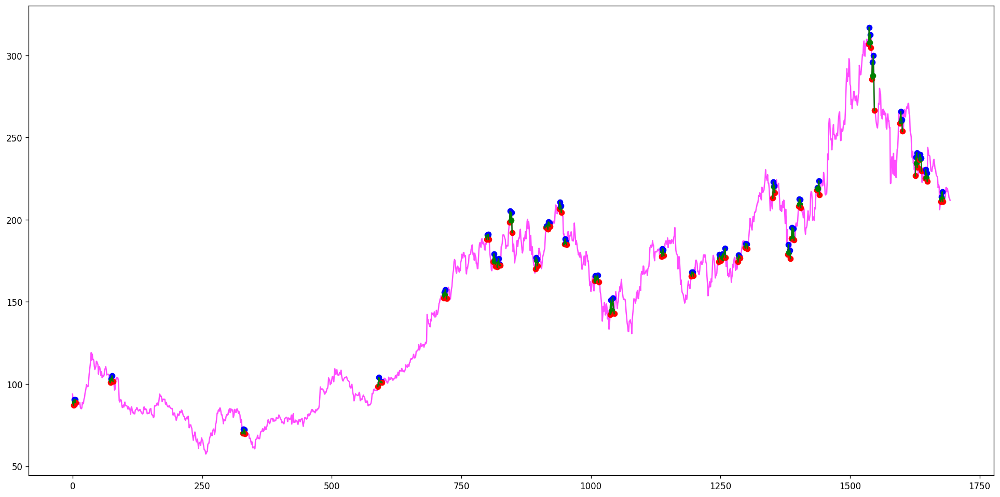

[(24, 25, 26, 27, 28), (35, 36, 37, 38, 39), (50, 51, 54, 57, 60), (344, 349, 354, 358, 362), (541, 547, 556, 560, 564), (1067, 1069, 1071, 1072, 1073), (1353, 1354, 1355, 1359, 1363), (1388, 1389, 1391, 1393, 1394), (1508, 1512, 1517, 1519, 1520), (1700, 1701, 1704, 1705, 1706), (1713, 1714, 1715, 1716, 1720), (1800, 1803, 1804, 1805, 1806), (1950, 1951, 1952, 1953, 1954), (1967, 1968, 1969, 1973, 1975), (2003, 2004, 2005, 2006, 2007), (2044, 2046, 2047, 2048, 2050), (2075, 2076, 2077, 2078, 2079), (2123, 2127, 2130, 2131, 2132), (2149, 2150, 2151, 2152, 2153), (2159, 2162, 2165, 2166, 2169), (2220, 2223, 2225, 2226, 2227), (2244, 2246, 2249, 2250, 2251), (2383, 2384, 2385, 2386, 2389), (2438, 2440, 2441, 2445, 2447), (2455, 2456, 2458, 2460, 2462), (2535, 2536, 2537, 2538, 2540), (2591, 2592, 2593, 2595, 2596), (2645, 2646, 2647, 2648, 2649), (2702, 2703, 2704, 2705, 2706), (2770, 2777, 2780, 2781, 2782), (2803, 2806, 2807, 2808, 2810), (2841, 2842, 2844, 2847, 2848), (3553, 3561, 35

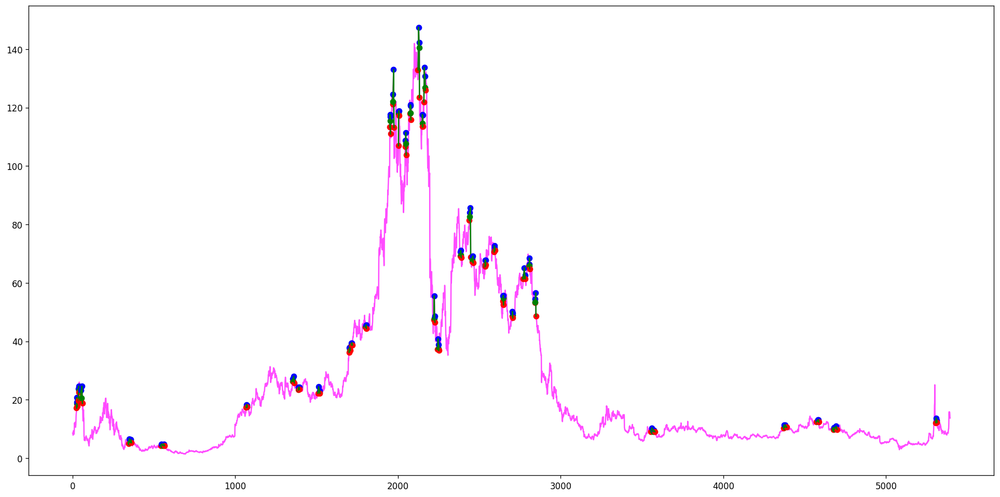

[(2, 3, 4, 6, 11), (38, 39, 40, 41, 42), (71, 72, 73, 76, 77), (84, 86, 87, 88, 89), (93, 94, 95, 97, 99), (104, 105, 106, 107, 108), (110, 112, 113, 114, 115), (126, 127, 128, 131, 135), (125, 131, 136, 138, 141), (165, 167, 168, 169, 170), (172, 175, 178, 180, 182), (189, 190, 191, 192, 193), (197, 198, 199, 200, 202), (215, 216, 217, 218, 219), (246, 247, 248, 249, 250), (295, 298, 302, 303, 304), (325, 326, 327, 328, 330), (325, 328, 330, 331, 332), (344, 345, 347, 348, 349), (411, 413, 415, 416, 417), (476, 477, 479, 481, 482), (485, 486, 487, 488, 489), (489, 490, 492, 494, 498), (536, 541, 542, 547, 548), (581, 582, 583, 587, 588), (588, 590, 591, 592, 593), (627, 628, 629, 630, 631), (637, 638, 639, 641, 642), (651, 654, 655, 656, 659), (655, 656, 657, 658, 659), (666, 667, 668, 669, 674), (689, 690, 692, 693, 695), (702, 705, 708, 709, 710), (721, 722, 723, 724, 725), (744, 745, 746, 747, 748), (757, 758, 759, 760, 762), (783, 784, 785, 786, 787), (778, 781, 782, 784, 788), (7

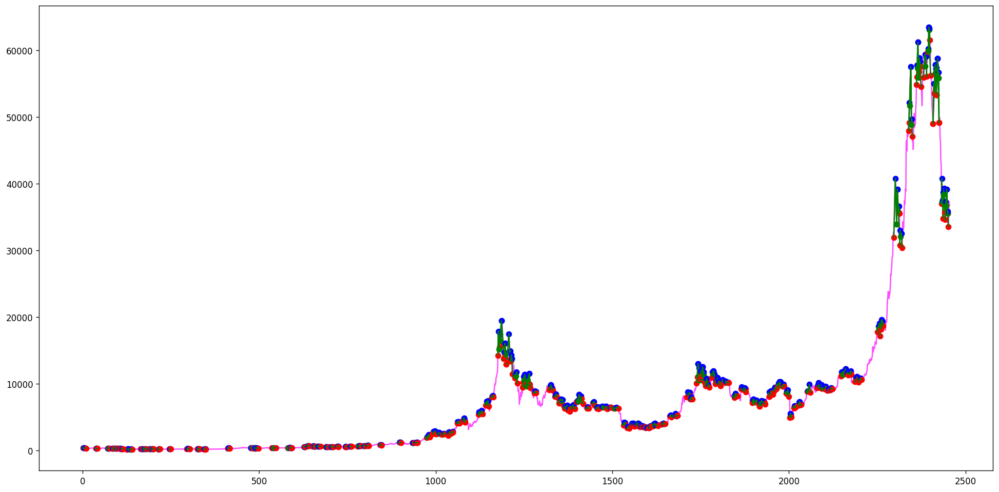

[(478, 482, 487, 488, 497), (653, 664, 665, 667, 669), (904, 905, 906, 910, 920), (1093, 1094, 1099, 1106, 1109), (1161, 1164, 1167, 1171, 1186), (1384, 1387, 1392, 1394, 1397), (1628, 1630, 1632, 1638, 1640)]
[]
Ticker DAX found 7 double top patterns, 0 double bottom patterns


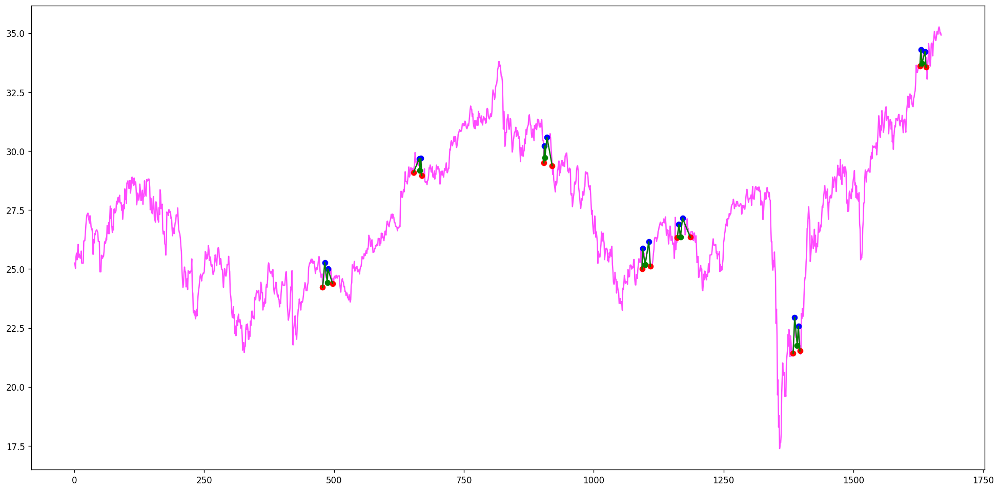

[(226, 227, 228, 229, 230), (285, 286, 287, 289, 290), (311, 312, 313, 314, 315), (598, 600, 602, 603, 604), (619, 620, 621, 622, 623), (635, 636, 637, 638, 639), (674, 675, 677, 680, 683), (689, 691, 694, 695, 697), (772, 773, 774, 775, 776), (818, 819, 821, 822, 823), (839, 840, 841, 843, 845), (846, 847, 848, 850, 851), (864, 865, 866, 867, 868), (870, 872, 874, 875, 876), (885, 886, 888, 890, 893), (903, 905, 907, 908, 909), (922, 925, 926, 927, 928), (915, 917, 919, 925, 930), (919, 920, 921, 925, 930), (968, 970, 971, 972, 973), (998, 1002, 1008, 1010, 1014), (1020, 1021, 1022, 1023, 1024), (1025, 1026, 1027, 1031, 1038), (1078, 1079, 1081, 1082, 1089), (1105, 1106, 1107, 1108, 1109), (1140, 1141, 1142, 1143, 1144), (1208, 1209, 1211, 1212, 1214), (1217, 1218, 1219, 1220, 1221), (1233, 1235, 1236, 1237, 1238), (1292, 1293, 1294, 1296, 1297), (1339, 1340, 1341, 1342, 1343), (1380, 1381, 1382, 1383, 1384), (1392, 1393, 1394, 1395, 1396), (1413, 1419, 1420, 1422, 1423), (1423, 1424,

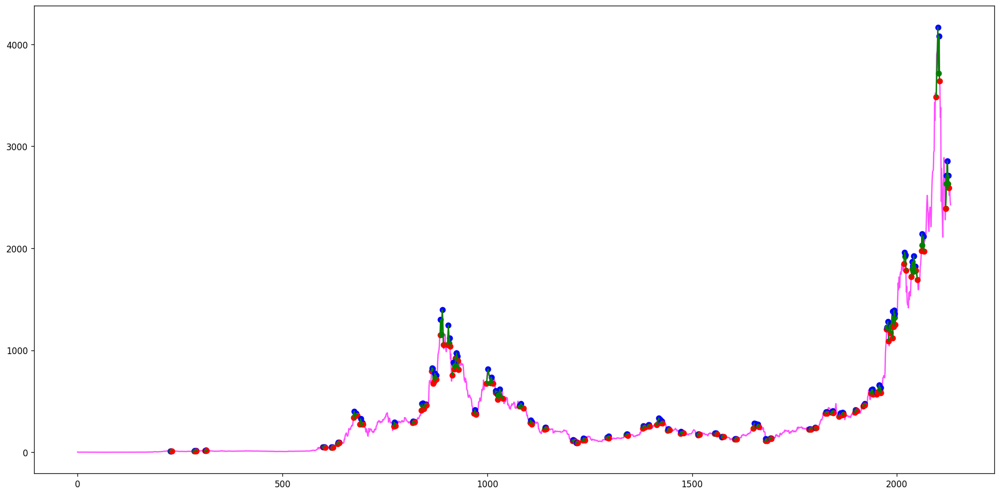

[(3, 4, 6, 7, 9), (474, 475, 477, 479, 480), (1953, 1955, 1961, 1968, 1973), (2561, 2565, 2567, 2568, 2574), (2614, 2615, 2617, 2619, 2621), (2768, 2774, 2779, 2784, 2785), (2927, 2934, 2940, 2944, 2948), (3114, 3120, 3124, 3126, 3139), (3114, 3120, 3124, 3128, 3139), (4012, 4014, 4017, 4019, 4026), (4735, 4743, 4750, 4760, 4762), (5097, 5099, 5106, 5111, 5122), (5097, 5101, 5106, 5111, 5122)]
[]
Ticker F found 13 double top patterns, 0 double bottom patterns


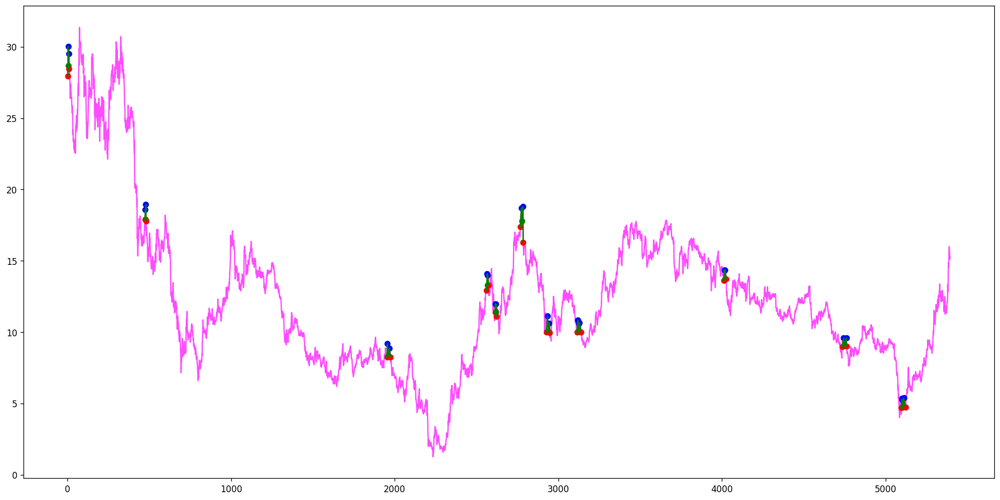

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(23, 24, 25, 26, 28), (40, 41, 45, 46, 47), (132, 134, 135, 137, 138), (217, 219, 221, 223, 225), (409, 411, 412, 413, 414), (439, 440, 441, 442, 446), (451, 452, 453, 454, 455), (477, 479, 480, 482, 485), (488, 489, 490, 491, 492), (618, 619, 620, 622, 624), (694, 696, 697, 701, 704), (891, 892, 893, 894, 895), (968, 969, 971, 972, 973), (998, 999, 1000, 1001, 1003), (1067, 1068, 1070, 1072, 1073), (1279, 1280, 1281, 1282, 1284), (1304, 1306, 1307, 1308, 1310), (1473, 1474, 1475, 1476, 1477), (1485, 1486, 1487, 1488, 1489), (1548, 1549, 1551, 1555, 1556), (1562, 1563, 1564, 1565, 1566), (1596, 1597, 1598, 1600, 1601), (1593, 1595, 1596, 1600, 1602), (1673, 1674, 1675, 1677, 1679), (1764, 1765, 1766, 1767, 1768), (1815, 1816, 1818, 1819, 1820), (1834, 1835, 1836, 1837, 1838), (2030, 2036, 2037, 2038, 2039), (2103, 2106, 2107, 2108, 2109), (2119, 2120, 2121, 2122, 2123), (2119, 2122, 2123, 2124, 2125), (2134, 2135, 2136, 2138, 2139), (2206, 2208, 2210, 2212, 2213)]
[]
Ticker FB found 3

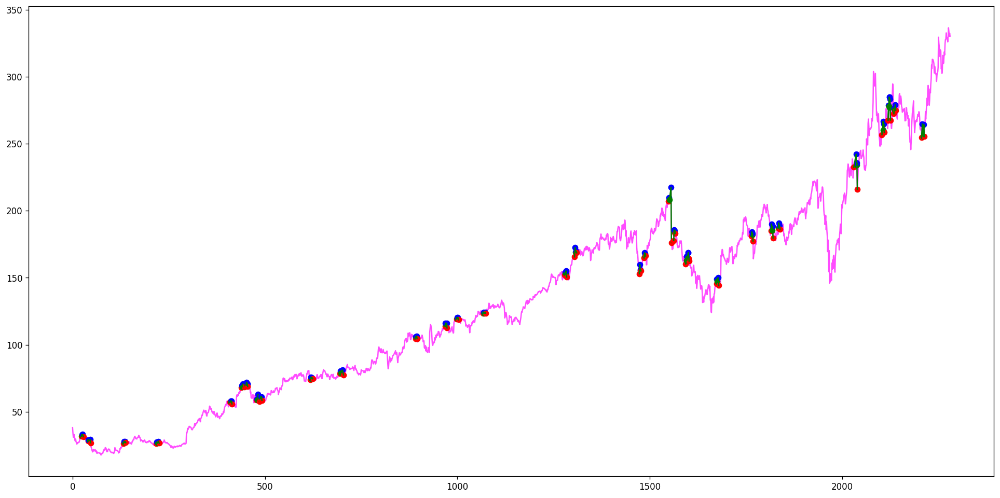

[(128, 131, 133, 137, 140), (141, 145, 154, 157, 161), (141, 149, 154, 157, 161), (347, 355, 360, 366, 372), (500, 518, 522, 523, 527), (1436, 1437, 1438, 1439, 1441), (1447, 1448, 1449, 1450, 1452), (1529, 1531, 1532, 1533, 1534), (1550, 1554, 1557, 1560, 1562), (1638, 1639, 1642, 1643, 1644), (1716, 1717, 1718, 1719, 1720), (1824, 1826, 1828, 1829, 1830), (2390, 2391, 2392, 2394, 2395), (2398, 2400, 2401, 2405, 2407), (2441, 2443, 2444, 2446, 2448), (2665, 2667, 2668, 2670, 2673), (2904, 2906, 2909, 2910, 2911), (2927, 2928, 2930, 2931, 2932), (3017, 3018, 3019, 3020, 3022), (3064, 3065, 3066, 3067, 3068), (3096, 3097, 3098, 3099, 3100), (3143, 3144, 3145, 3147, 3148), (3543, 3544, 3545, 3546, 3550), (3779, 3782, 3783, 3785, 3786), (3787, 3789, 3791, 3794, 3795), (4195, 4199, 4201, 4203, 4205), (4571, 4572, 4575, 4576, 4577), (4715, 4717, 4719, 4720, 4722), (4735, 4736, 4737, 4738, 4739), (4770, 4771, 4772, 4773, 4775), (4799, 4800, 4801, 4802, 4803), (4813, 4814, 4815, 4816, 4817)]


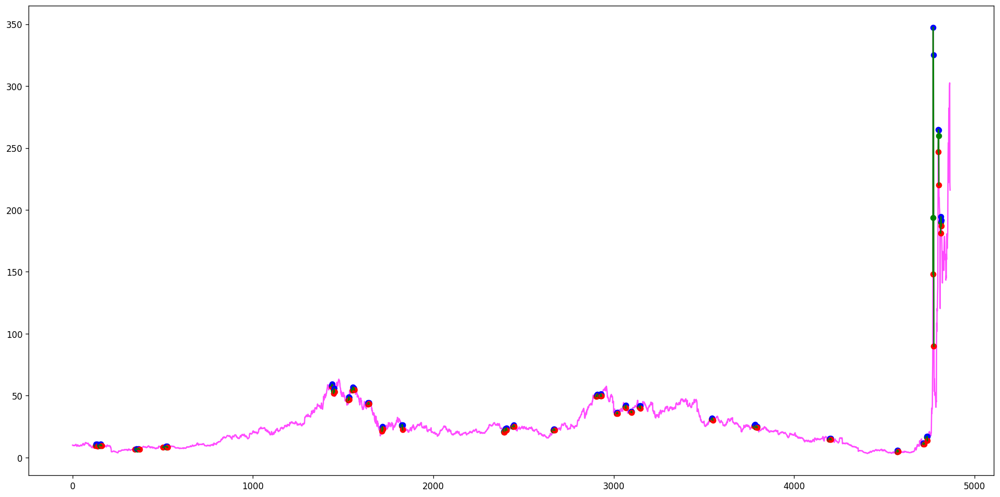

[(31, 32, 33, 34, 36), (58, 59, 60, 61, 62), (114, 116, 118, 119, 120), (134, 135, 136, 137, 138), (158, 159, 160, 162, 164), (177, 178, 179, 180, 181), (292, 293, 294, 295, 296), (409, 411, 412, 413, 416), (451, 452, 453, 454, 456), (470, 471, 472, 473, 474), (492, 493, 494, 496, 499), (509, 510, 511, 512, 513), (520, 521, 522, 524, 525), (619, 620, 621, 622, 623), (638, 639, 642, 643, 644), (666, 667, 668, 669, 670), (790, 791, 792, 793, 794), (805, 806, 807, 810, 812), (795, 810, 814, 815, 817), (843, 844, 845, 846, 847), (852, 853, 855, 856, 857), (902, 903, 904, 905, 906), (911, 913, 915, 916, 917), (930, 931, 932, 933, 935), (972, 973, 974, 977, 981), (1023, 1024, 1025, 1026, 1027), (1044, 1045, 1047, 1050, 1055), (1055, 1056, 1060, 1061, 1062), (1087, 1088, 1089, 1090, 1092), (1101, 1103, 1104, 1105, 1106), (1154, 1155, 1157, 1158, 1160), (1362, 1363, 1364, 1365, 1366), (1371, 1372, 1373, 1374, 1375), (1377, 1378, 1379, 1380, 1381), (1383, 1384, 1385, 1386, 1387), (1417, 1418, 1

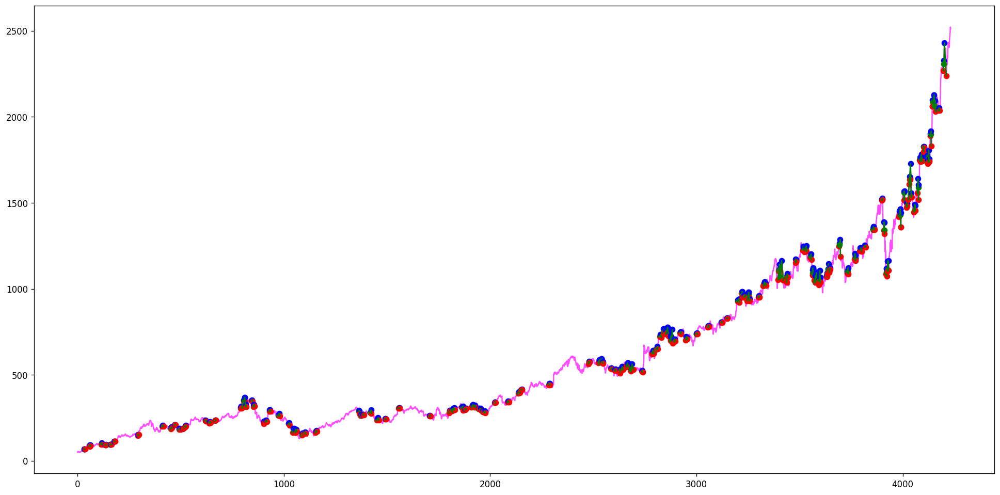

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(5, 7, 8, 9, 10), (24, 25, 26, 27, 28), (28, 30, 31, 32, 33), (56, 58, 60, 61, 62), (96, 97, 98, 99, 100), (154, 155, 156, 158, 159), (190, 191, 192, 194, 196), (252, 253, 254, 255, 257), (268, 271, 272, 273, 274), (279, 280, 281, 283, 285), (308, 310, 311, 313, 315), (331, 332, 333, 334, 336), (346, 348, 350, 351, 353), (384, 385, 386, 387, 388), (405, 407, 408, 409, 410), (465, 467, 468, 472, 473), (793, 794, 795, 796, 797), (805, 806, 807, 808, 809), (834, 835, 836, 837, 839), (958, 959, 961, 963, 965), (984, 985, 986, 987, 988), (992, 993, 995, 997, 999), (1051, 1052, 1053, 1055, 1057), (1078, 1079, 1080, 1081, 1082), (1139, 1140, 1141, 1142, 1143), (1221, 1223, 1224, 1225, 1227), (1227, 1230, 1231, 1232, 1233), (1536, 1537, 1541, 1542, 1543), (1589, 1595, 1598, 1599, 1600), (1606, 1608, 1610, 1611, 1612), (1619, 1621, 1623, 1625, 1626), (1850, 1851, 1852, 1853, 1857), (1873, 1874, 1875, 1876, 1877), (1965, 1966, 1967, 1968, 1969), (1981, 1982, 1983, 1984, 1985), (1992, 1993, 1994

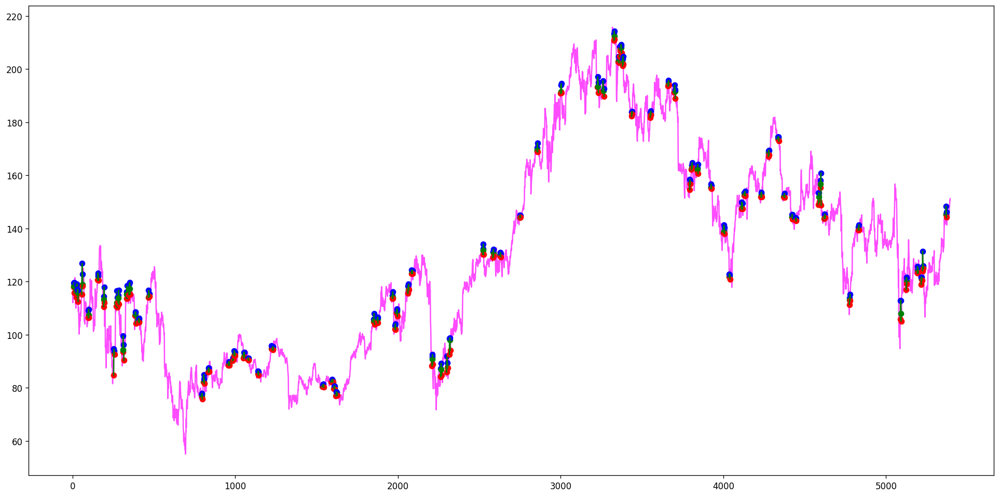

[(120, 121, 122, 123, 125), (143, 144, 145, 146, 151), (190, 192, 198, 199, 202), (670, 674, 675, 677, 678), (718, 723, 728, 729, 743), (728, 729, 732, 738, 743), (1413, 1415, 1422, 1427, 1435), (2194, 2196, 2197, 2199, 2202), (2221, 2223, 2225, 2226, 2228), (2564, 2576, 2580, 2583, 2592), (2890, 2895, 2902, 2903, 2913), (2931, 2934, 2937, 2939, 2940), (2972, 2975, 2977, 2982, 2983), (3223, 3228, 3230, 3231, 3232), (3241, 3243, 3244, 3247, 3250), (3354, 3355, 3357, 3362, 3367), (3372, 3374, 3375, 3377, 3380), (3712, 3714, 3715, 3716, 3718), (3774, 3777, 3782, 3786, 3790), (4224, 4229, 4238, 4240, 4242), (4288, 4292, 4297, 4302, 4303), (4417, 4419, 4425, 4433, 4439), (4636, 4639, 4641, 4642, 4643), (4780, 4781, 4782, 4783, 4784), (4935, 4937, 4938, 4940, 4941), (5199, 5200, 5201, 5202, 5203), (5269, 5272, 5273, 5275, 5276), (5297, 5299, 5300, 5301, 5302), (5310, 5312, 5314, 5315, 5316), (5326, 5327, 5328, 5329, 5331)]
[]
Ticker KO found 30 double top patterns, 0 double bottom patterns


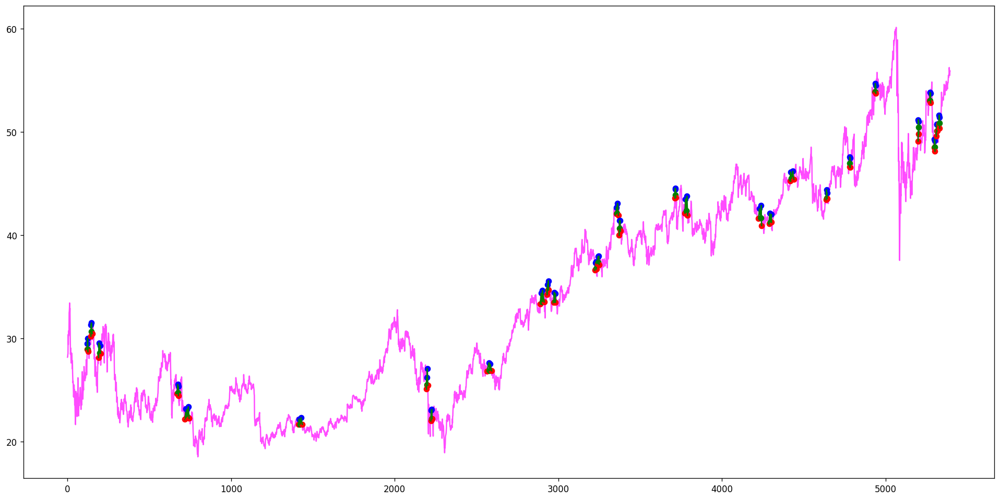

[(1620, 1623, 1631, 1632, 1636), (2068, 2072, 2074, 2076, 2078), (2149, 2150, 2152, 2154, 2155), (2270, 2271, 2272, 2274, 2275), (2843, 2844, 2846, 2847, 2849), (3046, 3047, 3048, 3049, 3050), (3112, 3114, 3115, 3116, 3118), (3132, 3133, 3136, 3139, 3142), (3210, 3212, 3213, 3214, 3215), (3386, 3387, 3388, 3389, 3390), (3405, 3406, 3407, 3408, 3409), (3428, 3429, 3431, 3433, 3434), (3443, 3444, 3445, 3446, 3447), (3487, 3488, 3489, 3490, 3493), (3500, 3501, 3502, 3503, 3504), (3583, 3584, 3587, 3588, 3589), (3596, 3597, 3598, 3599, 3600), (3680, 3681, 3684, 3685, 3686), (3703, 3704, 3705, 3706, 3707), (3712, 3713, 3714, 3716, 3717), (3727, 3728, 3729, 3731, 3732), (3816, 3817, 3819, 3820, 3821), (3863, 3864, 3865, 3866, 3867), (3945, 3948, 3951, 3952, 3953), (3966, 3967, 3968, 3969, 3970), (3972, 3973, 3975, 3976, 3978), (4052, 4053, 4054, 4055, 4056), (4058, 4059, 4060, 4061, 4062), (4114, 4116, 4117, 4118, 4121), (4126, 4127, 4128, 4130, 4132), (4126, 4130, 4133, 4134, 4135), (4142, 

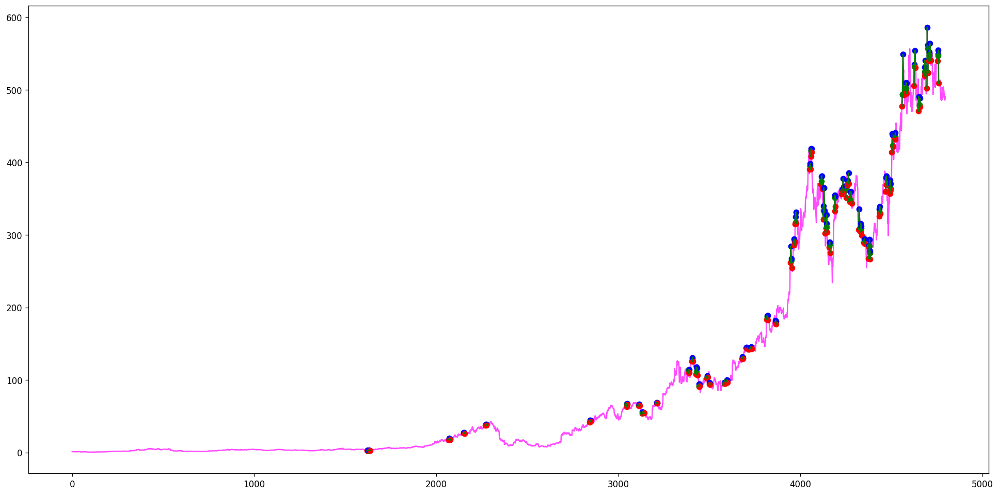

[(53, 58, 61, 62, 63), (79, 80, 81, 82, 83), (137, 138, 139, 142, 143), (167, 169, 171, 172, 173), (357, 358, 359, 360, 361), (388, 389, 391, 399, 405), (412, 413, 414, 415, 416), (495, 498, 499, 501, 504), (777, 779, 781, 783, 788), (1030, 1031, 1033, 1034, 1039), (1060, 1061, 1062, 1068, 1069), (1861, 1863, 1866, 1868, 1869), (1993, 1995, 1996, 1997, 1998), (2209, 2212, 2214, 2215, 2217), (2706, 2711, 2715, 2717, 2724)]
[]
Ticker NOK found 15 double top patterns, 0 double bottom patterns


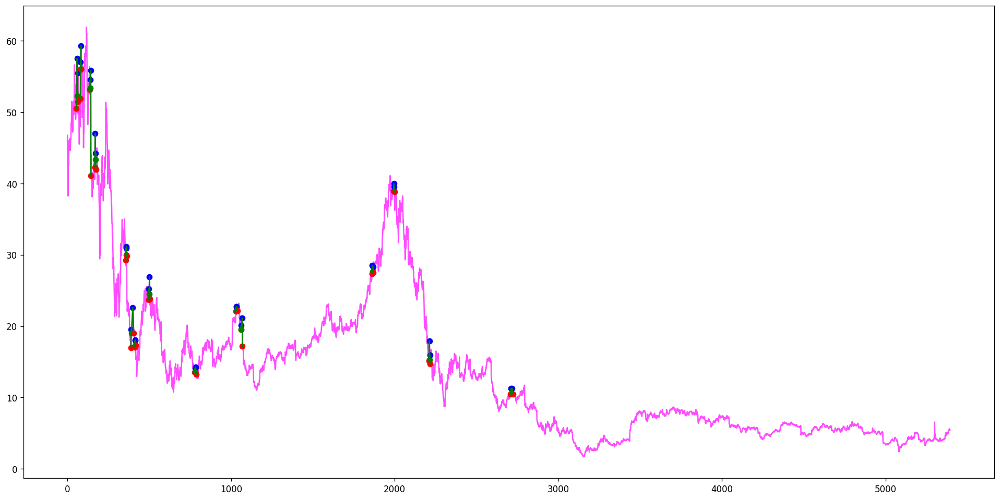

[(324, 327, 329, 330, 331), (486, 487, 488, 490, 493), (508, 509, 510, 511, 513), (654, 663, 670, 674, 682), (966, 967, 974, 982, 988), (1685, 1686, 1687, 1688, 1690), (1847, 1848, 1852, 1855, 1857), (1976, 1977, 1979, 1980, 1981), (1996, 1997, 1998, 1999, 2000), (2024, 2025, 2027, 2028, 2030), (2056, 2057, 2058, 2059, 2060), (2093, 2094, 2095, 2096, 2098), (2189, 2191, 2193, 2196, 2197), (2277, 2280, 2282, 2287, 2293), (2822, 2823, 2824, 2825, 2827), (2902, 2906, 2910, 2914, 2915), (2963, 2965, 2966, 2967, 2969), (2969, 2971, 2972, 2975, 2977), (2990, 2992, 2994, 2998, 3007), (3253, 3255, 3267, 3271, 3278), (3676, 3694, 3697, 3700, 3703), (4192, 4193, 4194, 4195, 4196), (4271, 4273, 4274, 4275, 4276), (4313, 4314, 4315, 4316, 4317), (4355, 4356, 4357, 4358, 4359), (4425, 4426, 4427, 4428, 4429), (4493, 4494, 4495, 4496, 4497), (4500, 4501, 4502, 4503, 4504), (4511, 4512, 4513, 4514, 4515), (4518, 4519, 4520, 4521, 4522), (4544, 4546, 4547, 4548, 4549), (4558, 4559, 4560, 4561, 4562), 

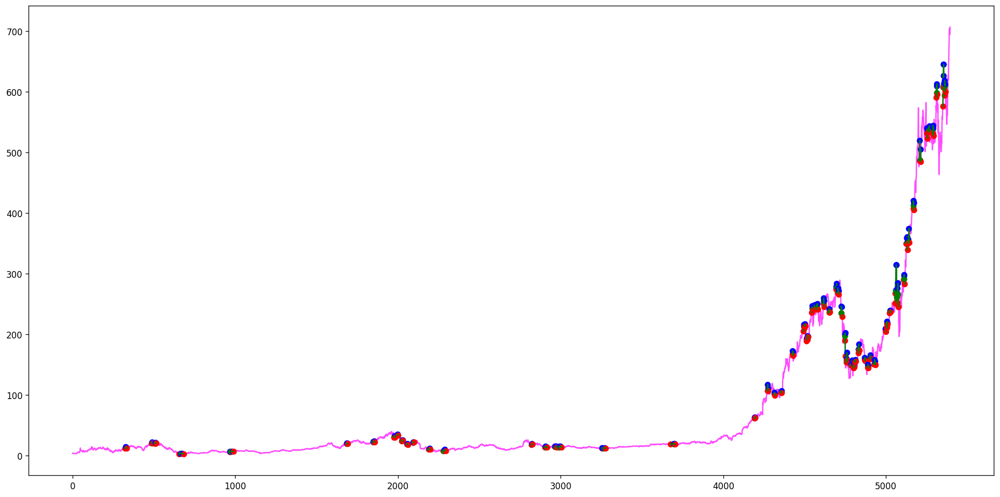

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(28, 29, 31, 33, 37), (24, 25, 27, 29, 38), (81, 82, 83, 84, 85), (104, 105, 107, 108, 109), (140, 141, 142, 143, 144), (152, 155, 156, 161, 163), (163, 164, 165, 166, 167), (174, 176, 180, 181, 183), (163, 164, 174, 176, 186), (234, 235, 236, 238, 239), (231, 232, 233, 235, 240), (251, 254, 255, 256, 257), (268, 269, 270, 271, 275), (261, 263, 268, 271, 277), (350, 352, 354, 355, 361), (354, 355, 359, 360, 361), (399, 400, 401, 402, 403), (436, 438, 439, 440, 441), (468, 469, 473, 474, 475), (503, 504, 506, 507, 508), (510, 511, 512, 515, 517), (550, 552, 554, 555, 556), (560, 561, 564, 566, 570), (590, 591, 593, 594, 595), (660, 661, 662, 663, 664), (707, 709, 711, 712, 713), (802, 803, 807, 808, 811), (816, 818, 821, 822, 824), (828, 831, 834, 835, 836), (879, 880, 882, 883, 885), (911, 912, 913, 914, 915), (913, 914, 915, 916, 918), (930, 935, 937, 938, 939), (983, 984, 985, 986, 988), (1030, 1032, 1033, 1034, 1036), (1339, 1341, 1342, 1343, 1344), (1353, 1354, 1358, 1360, 1361), 

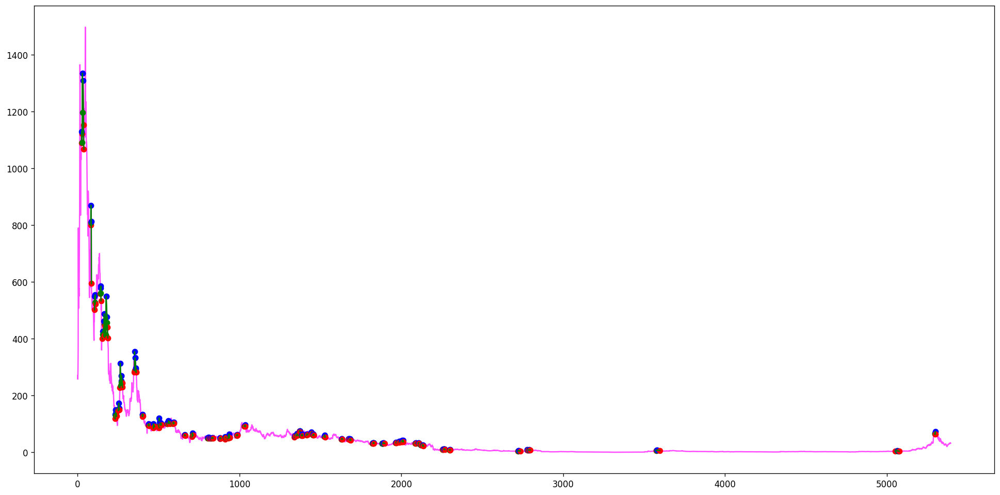

[(19, 21, 24, 25, 26), (72, 73, 74, 75, 76), (80, 83, 85, 86, 87), (89, 90, 91, 93, 95), (162, 163, 164, 166, 167), (179, 180, 182, 183, 184), (279, 280, 281, 283, 285), (305, 306, 307, 308, 309), (336, 337, 338, 339, 340), (347, 348, 350, 351, 352), (357, 358, 359, 360, 361), (377, 378, 380, 381, 383), (631, 636, 639, 640, 641), (724, 727, 728, 731, 733), (1086, 1089, 1091, 1093, 1097), (1202, 1203, 1204, 1206, 1207), (1298, 1299, 1300, 1305, 1310), (1532, 1533, 1534, 1535, 1536), (1579, 1581, 1583, 1584, 1586), (1620, 1621, 1623, 1625, 1626), (2017, 2018, 2019, 2020, 2021), (2109, 2110, 2111, 2112, 2114), (2184, 2185, 2187, 2188, 2189), (2217, 2218, 2219, 2220, 2222), (2251, 2252, 2254, 2255, 2260), (2262, 2263, 2264, 2265, 2266), (2316, 2317, 2318, 2320, 2322), (2381, 2383, 2388, 2389, 2390), (2704, 2708, 2709, 2711, 2717), (2964, 2965, 2966, 2967, 2968), (3097, 3099, 3101, 3102, 3103), (3380, 3381, 3382, 3384, 3386), (3399, 3401, 3402, 3404, 3405), (3440, 3442, 3443, 3444, 3446), (

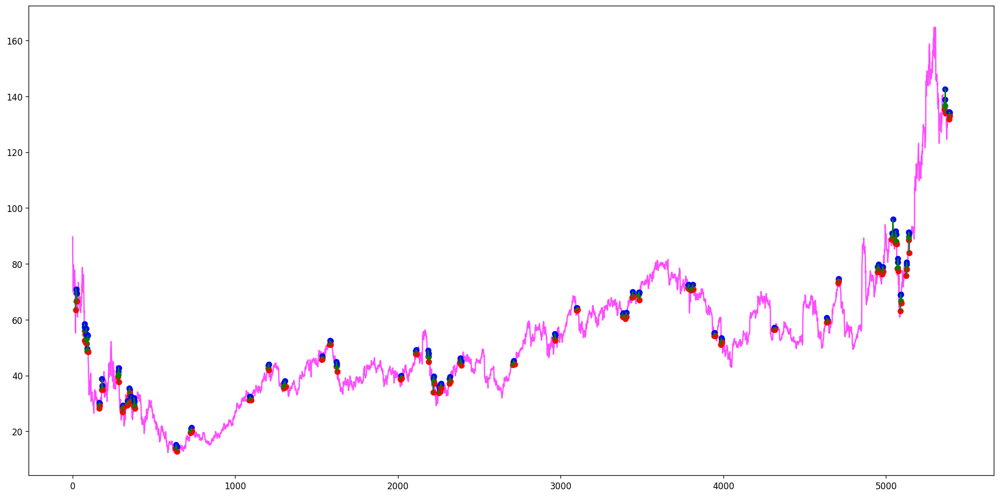

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(10, 11, 12, 13, 14), (120, 121, 122, 123, 124), (132, 135, 137, 138, 139), (336, 337, 338, 339, 340), (383, 384, 386, 387, 388), (701, 704, 705, 706, 708), (860, 863, 864, 865, 870), (945, 951, 952, 954, 955), (1011, 1014, 1018, 1019, 1020), (1051, 1052, 1053, 1055, 1057), (1420, 1430, 1437, 1445, 1448), (1420, 1434, 1437, 1445, 1448), (1541, 1545, 1546, 1548, 1550), (1739, 1741, 1743, 1749, 1752), (1954, 1955, 1957, 1959, 1960), (2110, 2113, 2115, 2117, 2118), (2122, 2124, 2126, 2127, 2128), (2249, 2250, 2251, 2252, 2257), (2406, 2410, 2412, 2413, 2415), (2405, 2410, 2415, 2417, 2419), (2521, 2523, 2524, 2525, 2527), (2614, 2615, 2617, 2619, 2620), (2964, 2965, 2966, 2967, 2968), (3204, 3205, 3207, 3210, 3212), (3227, 3228, 3229, 3231, 3232), (3594, 3596, 3597, 3598, 3599), (3682, 3688, 3690, 3692, 3693), (3697, 3700, 3703, 3704, 3705), (3915, 3917, 3920, 3921, 3922), (4037, 4038, 4039, 4040, 4041), (4177, 4180, 4181, 4186, 4187), (4380, 4381, 4383, 4385, 4386), (4544, 4545, 4547, 4

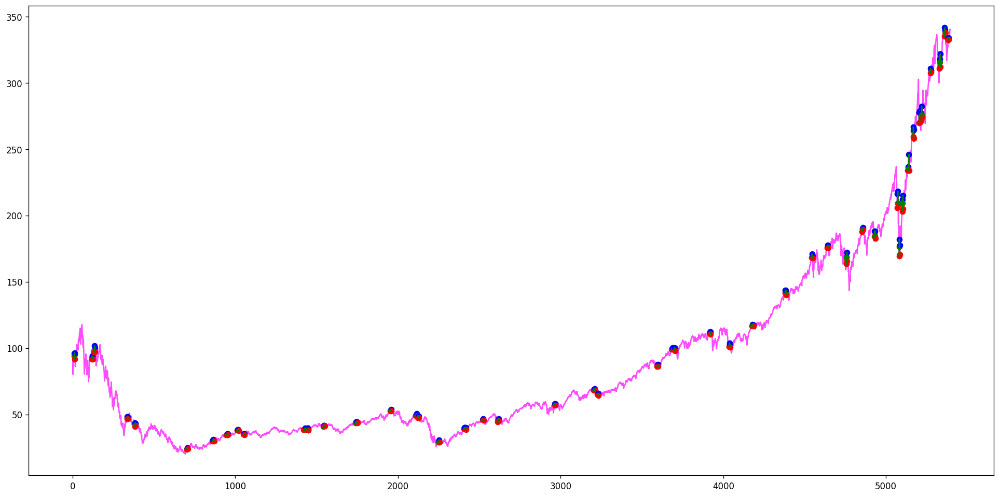

[(1562, 1563, 1564, 1565, 1567)]
[]
Ticker QYLD found 1 double top patterns, 0 double bottom patterns


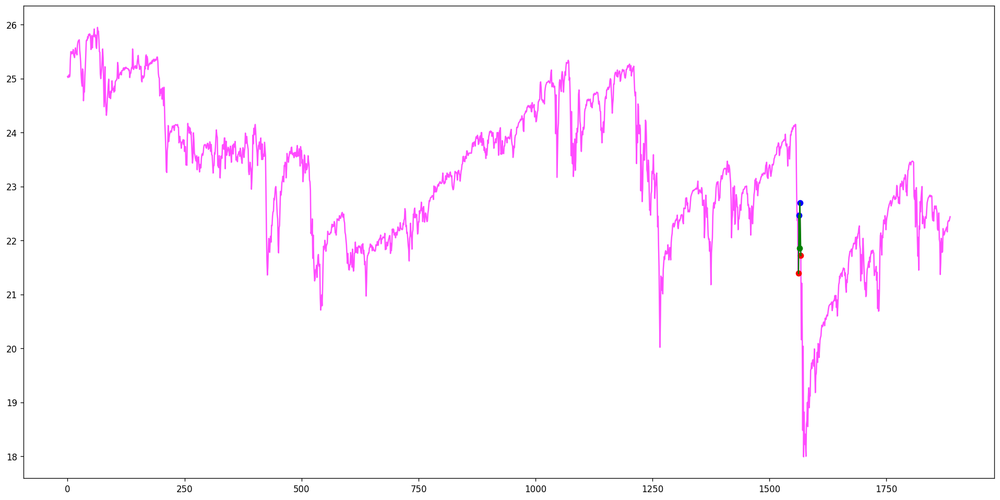

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(77, 78, 79, 80, 83), (385, 392, 398, 401, 404), (548, 551, 556, 559, 561), (710, 711, 713, 714, 727), (1181, 1182, 1183, 1184, 1185), (1318, 1321, 1322, 1324, 1325), (1418, 1421, 1424, 1426, 1428), (1788, 1790, 1793, 1794, 1796), (1830, 1831, 1832, 1833, 1835), (1903, 1905, 1906, 1908, 1910), (2045, 2046, 2047, 2048, 2050), (2081, 2082, 2083, 2084, 2086), (2110, 2112, 2116, 2117, 2118), (2138, 2139, 2140, 2141, 2142), (2252, 2253, 2254, 2255, 2256), (2765, 2766, 2771, 2772, 2773), (2786, 2787, 2788, 2789, 2797), (3034, 3036, 3038, 3039, 3040), (3096, 3099, 3100, 3102, 3104), (3335, 3336, 3337, 3338, 3339), (3547, 3549, 3550, 3551, 3553), (3747, 3748, 3749, 3750, 3751), (3752, 3753, 3754, 3755, 3756), (3804, 3808, 3811, 3812, 3813), (3863, 3866, 3868, 3869, 3871), (3896, 3898, 3899, 3900, 3901), (3998, 4001, 4002, 4003, 4004), (4065, 4068, 4069, 4070, 4071), (4094, 4099, 4100, 4101, 4102), (4277, 4278, 4279, 4280, 4281), (4476, 4479, 4482, 4484, 4486), (4573, 4574, 4578, 4582, 4583), 

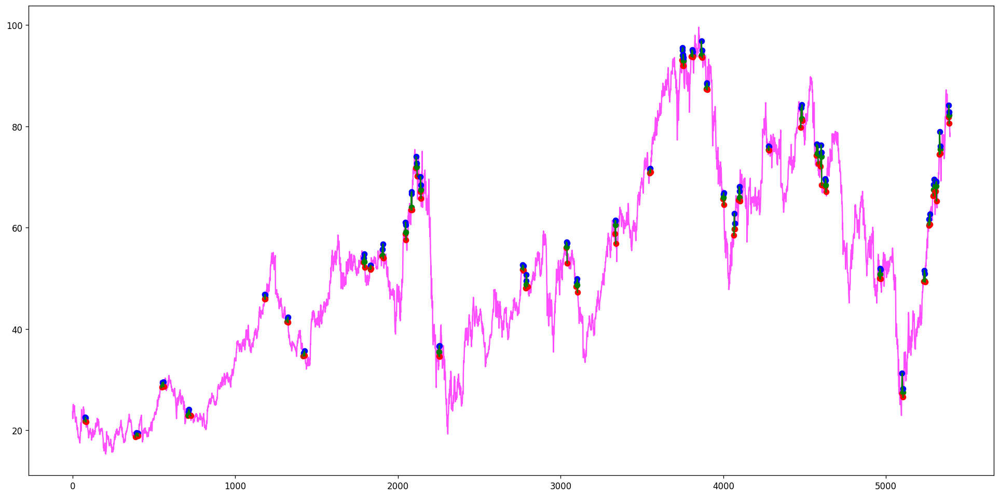

[(534, 535, 536, 537, 538)]
[]
Ticker RIDE found 1 double top patterns, 0 double bottom patterns


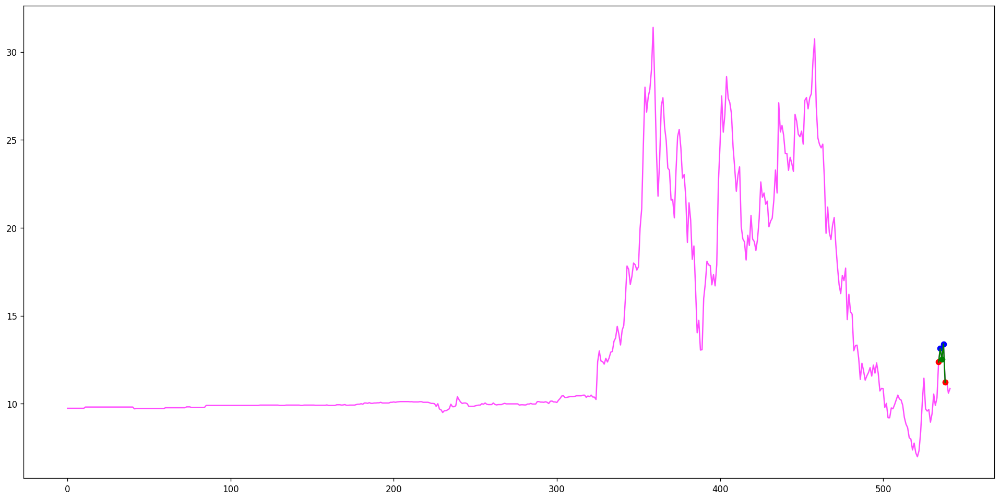

[(107, 115, 116, 119, 120), (470, 471, 472, 474, 475), (1228, 1229, 1230, 1231, 1233), (1244, 1245, 1246, 1247, 1248), (1258, 1259, 1260, 1261, 1263), (1289, 1290, 1291, 1292, 1293)]
[]
Ticker RIOT found 6 double top patterns, 0 double bottom patterns


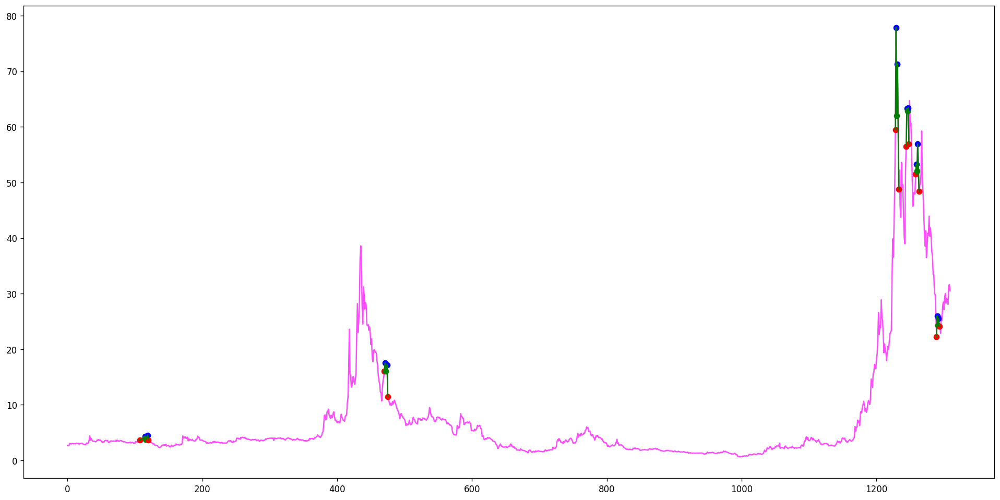

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(229, 230, 232, 237, 246), (229, 230, 232, 239, 246), (909, 910, 912, 913, 914), (943, 944, 945, 948, 954), (1135, 1137, 1138, 1140, 1146), (1329, 1330, 1331, 1332, 1333), (1371, 1372, 1373, 1374, 1375), (1558, 1559, 1560, 1561, 1562), (1649, 1650, 1652, 1653, 1655), (1754, 1755, 1756, 1757, 1760), (1775, 1777, 1780, 1781, 1782), (1790, 1792, 1795, 1796, 1797), (1837, 1838, 1839, 1840, 1842), (1871, 1872, 1873, 1874, 1875), (1947, 1949, 1950, 1951, 1952), (2018, 2019, 2021, 2022, 2023), (2044, 2045, 2046, 2047, 2050), (2092, 2094, 2096, 2097, 2099), (2144, 2145, 2146, 2147, 2148), (2161, 2162, 2163, 2164, 2165), (2183, 2184, 2185, 2186, 2187), (2340, 2341, 2342, 2343, 2348), (2362, 2364, 2366, 2368, 2370), (2593, 2595, 2596, 2599, 2600), (2652, 2654, 2655, 2656, 2659), (2703, 2705, 2706, 2707, 2708), (2750, 2751, 2752, 2753, 2754), (2761, 2762, 2763, 2764, 2765), (2855, 2856, 2857, 2859, 2860), (2862, 2864, 2865, 2866, 2867), (2897, 2898, 2899, 2900, 2902), (3107, 3108, 3109, 3111, 31

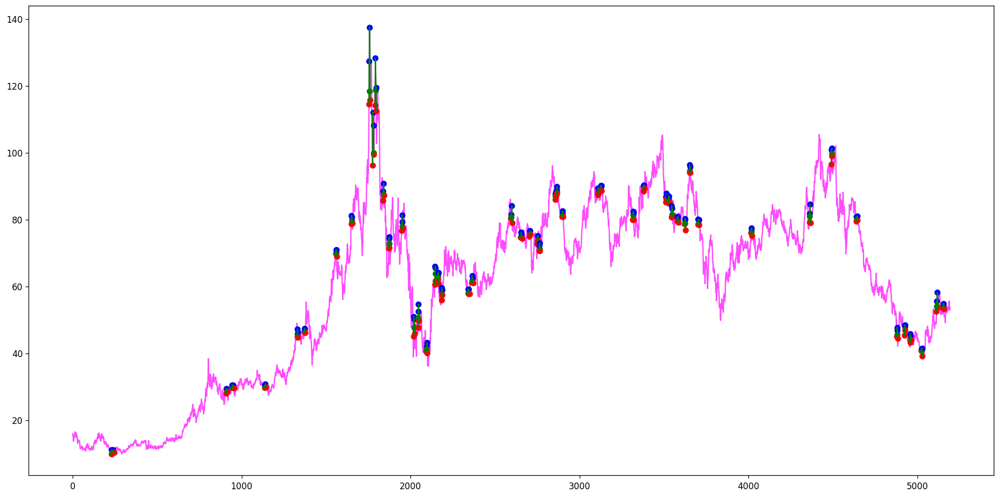

[(666, 667, 668, 670, 671)]
[]
Ticker SPCE found 1 double top patterns, 0 double bottom patterns


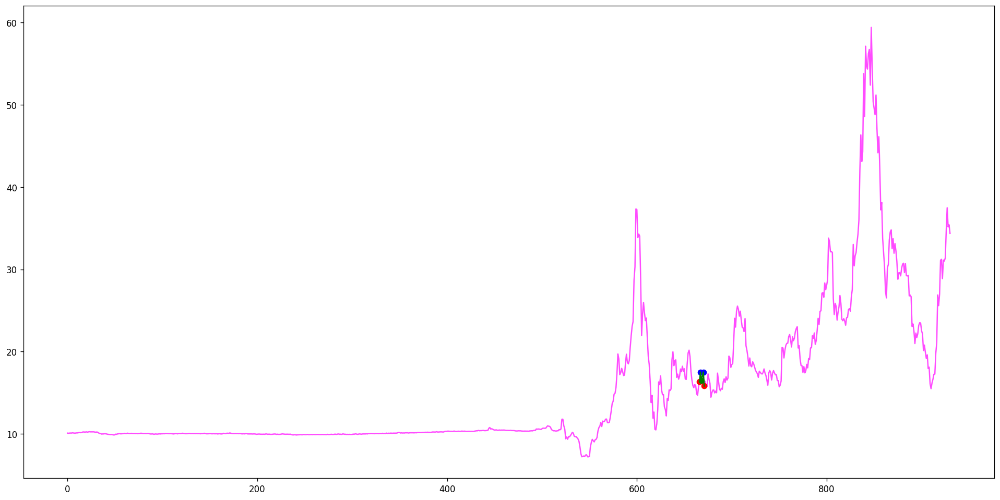

[(8, 9, 10, 11, 12), (21, 22, 24, 25, 26), (73, 74, 75, 76, 77), (77, 78, 81, 82, 83), (270, 271, 272, 273, 274), (443, 444, 446, 447, 448), (500, 502, 505, 506, 507), (659, 661, 662, 663, 664), (701, 702, 703, 704, 705), (705, 706, 708, 709, 710), (782, 783, 785, 786, 787), (793, 794, 795, 796, 797), (919, 921, 922, 923, 925), (1015, 1016, 1018, 1019, 1021), (1030, 1031, 1033, 1034, 1037), (1042, 1043, 1044, 1047, 1048), (1120, 1122, 1125, 1127, 1128), (1318, 1321, 1322, 1324, 1325), (1624, 1625, 1627, 1628, 1629), (1650, 1651, 1653, 1655, 1659), (1901, 1902, 1903, 1905, 1906), (1951, 1952, 1954, 1955, 1956), (2014, 2016, 2017, 2018, 2019), (2161, 2163, 2165, 2167, 2168), (2209, 2210, 2211, 2212, 2214), (2209, 2212, 2214, 2215, 2216), (2217, 2218, 2219, 2223, 2225), (2245, 2246, 2247, 2248, 2249), (2316, 2317, 2318, 2320, 2322), (2347, 2348, 2349, 2350, 2353), (2439, 2440, 2443, 2444, 2445), (2593, 2595, 2596, 2597, 2598), (2661, 2662, 2664, 2665, 2666), (2853, 2855, 2856, 2857, 2858)

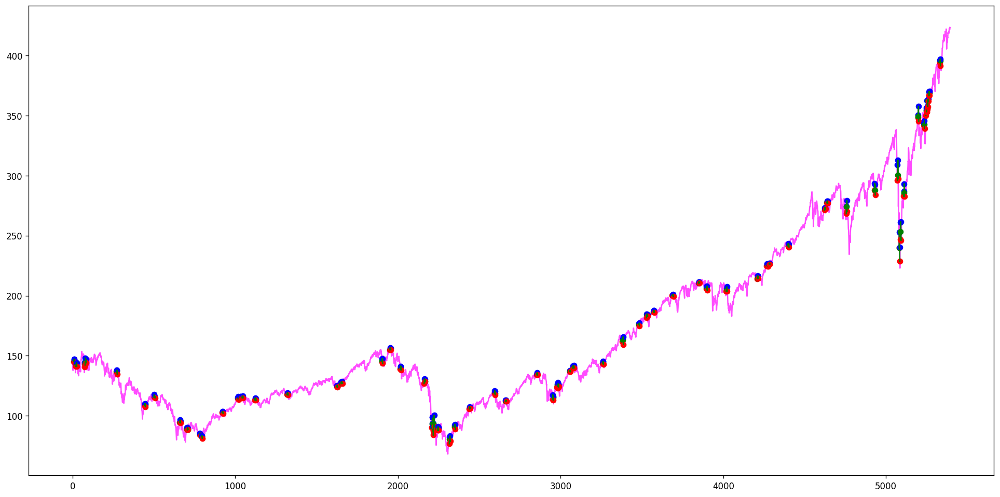

[(77, 78, 80, 82, 83), (301, 302, 303, 304, 305), (344, 345, 346, 347, 349), (434, 435, 436, 437, 438), (489, 490, 491, 493, 495), (1171, 1178, 1180, 1181, 1186), (1365, 1372, 1376, 1382, 1384), (1743, 1748, 1752, 1758, 1759), (1743, 1749, 1752, 1758, 1759), (2162, 2163, 2166, 2167, 2169), (2493, 2502, 2505, 2512, 2519), (2579, 2581, 2586, 2588, 2594), (2881, 2884, 2887, 2892, 2901), (2919, 2924, 2926, 2929, 2937), (2977, 2982, 2983, 2985, 2988), (2972, 2975, 2977, 2979, 2989), (3129, 3133, 3139, 3144, 3151), (3198, 3202, 3206, 3210, 3212), (3698, 3702, 3709, 3712, 3715), (3865, 3866, 3867, 3869, 3875), (3912, 3917, 3923, 3924, 3926), (4589, 4592, 4594, 4595, 4597), (5079, 5080, 5081, 5082, 5084), (5098, 5099, 5100, 5101, 5102)]
[]
Ticker T found 24 double top patterns, 0 double bottom patterns


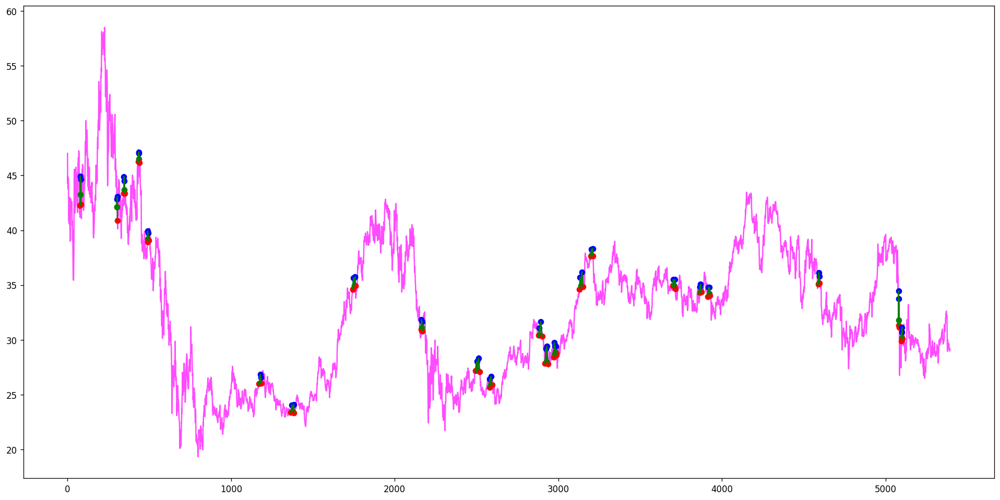

[(347, 351, 356, 364, 366), (942, 943, 944, 946, 949), (1050, 1051, 1052, 1053, 1054), (1090, 1091, 1092, 1095, 1097), (1103, 1104, 1105, 1106, 1107), (1186, 1187, 1188, 1191, 1192), (1588, 1589, 1590, 1595, 1597), (1778, 1779, 1780, 1781, 1782), (1863, 1864, 1865, 1868, 1869), (1877, 1878, 1880, 1881, 1883), (1908, 1909, 1910, 1911, 1913), (1957, 1958, 1960, 1961, 1962), (2003, 2006, 2007, 2008, 2009), (2040, 2041, 2043, 2045, 2046), (2202, 2203, 2204, 2205, 2206), (2206, 2207, 2209, 2210, 2211), (2278, 2279, 2280, 2282, 2283), (2290, 2293, 2295, 2296, 2297), (2364, 2365, 2366, 2367, 2368), (2449, 2451, 2454, 2455, 2456), (2472, 2473, 2474, 2475, 2477), (2490, 2491, 2492, 2494, 2495), (2501, 2502, 2503, 2504, 2506), (2509, 2510, 2512, 2513, 2514), (2530, 2531, 2532, 2533, 2534), (2535, 2536, 2537, 2538, 2540), (2558, 2559, 2560, 2561, 2564), (2570, 2571, 2573, 2575, 2577), (2579, 2580, 2581, 2583, 2584), (2579, 2583, 2584, 2585, 2586), (2605, 2606, 2607, 2608, 2611), (2605, 2608, 2611

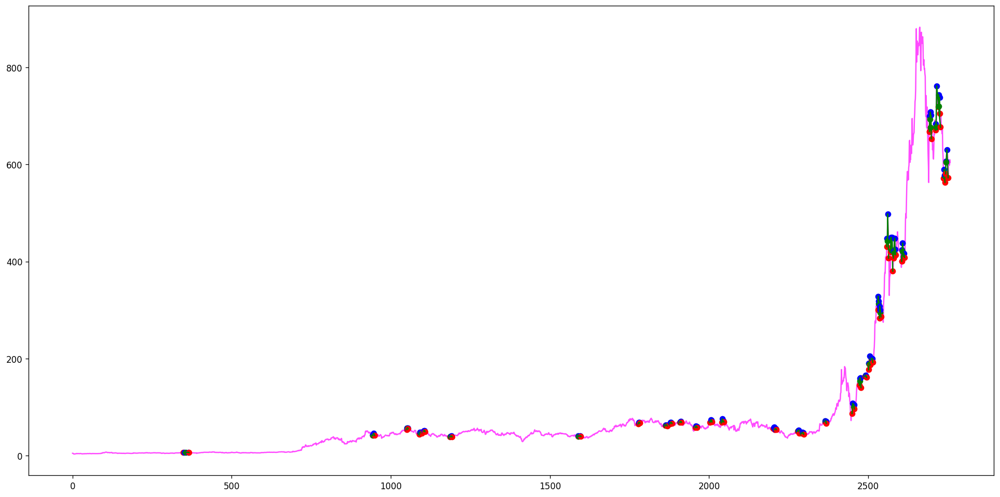

[(101, 104, 110, 114, 116), (156, 158, 159, 160, 162), (181, 183, 186, 190, 198), (282, 283, 286, 287, 289), (900, 902, 903, 904, 905), (905, 908, 909, 912, 914), (1145, 1148, 1150, 1156, 1160), (1304, 1305, 1307, 1308, 1309), (1307, 1308, 1309, 1311, 1312), (1455, 1457, 1460, 1462, 1465), (1474, 1475, 1476, 1477, 1478), (1671, 1673, 1675, 1676, 1678), (1702, 1705, 1709, 1710, 1711), (1756, 1757, 1758, 1759, 1760), (1784, 1785, 1789, 1790, 1791), (1889, 1890, 1891, 1892, 1893), (1948, 1951, 1953, 1959, 1962), (1966, 1968, 1969, 1970, 1971), (2083, 2085, 2086, 2088, 2089), (2098, 2099, 2100, 2101, 2103), (2259, 2261, 2262, 2265, 2266), (2332, 2333, 2335, 2336, 2337), (2372, 2374, 2375, 2382, 2383), (2426, 2429, 2432, 2433, 2434), (2437, 2438, 2439, 2442, 2443), (2514, 2516, 2517, 2518, 2520), (2524, 2525, 2526, 2529, 2530), (2537, 2538, 2539, 2541, 2542), (2600, 2601, 2602, 2603, 2604), (2693, 2694, 2695, 2697, 2698), (2712, 2713, 2714, 2716, 2717), (2764, 2766, 2769, 2770, 2771), (2808

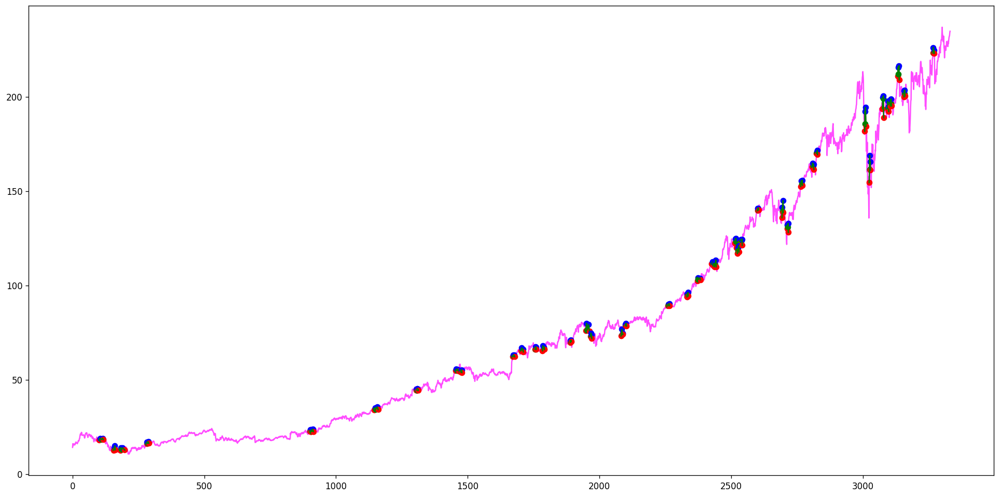

[(32, 33, 34, 37, 38), (992, 995, 999, 1001, 1003), (1098, 1102, 1104, 1108, 1110), (1124, 1126, 1128, 1130, 1131), (1216, 1221, 1232, 1238, 1240), (1490, 1493, 1494, 1496, 1502), (1511, 1513, 1514, 1515, 1517), (1636, 1639, 1640, 1641, 1642), (1757, 1759, 1762, 1767, 1768), (1982, 1983, 1984, 1986, 1987), (2111, 2113, 2115, 2116, 2117), (2118, 2119, 2120, 2121, 2123), (2177, 2179, 2180, 2181, 2182), (2382, 2383, 2386, 2388, 2390), (2611, 2612, 2617, 2618, 2619), (2706, 2708, 2709, 2710, 2711), (2820, 2821, 2823, 2824, 2825), (2828, 2829, 2834, 2837, 2838), (3047, 3048, 3049, 3050, 3051), (3068, 3070, 3071, 3072, 3073), (3827, 3828, 3829, 3830, 3831)]
[]
Ticker VIAC found 21 double top patterns, 0 double bottom patterns


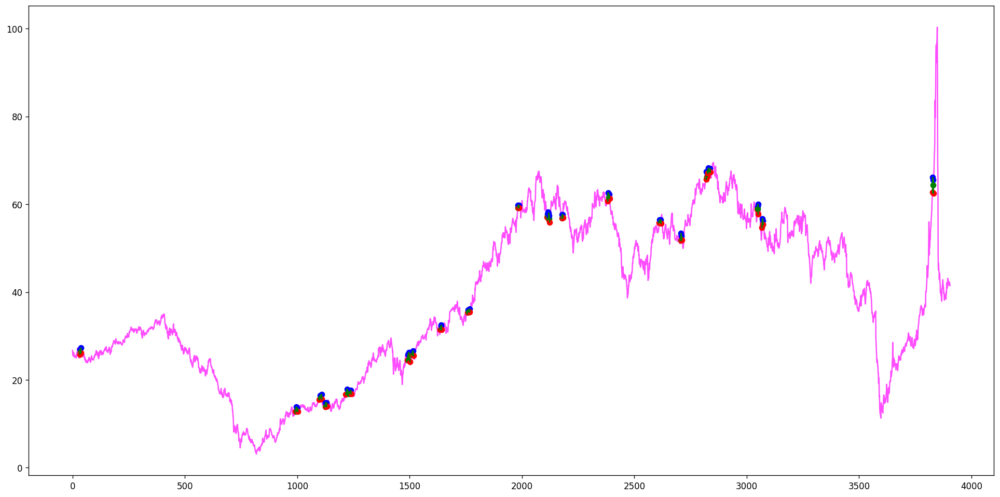

[(175, 179, 185, 187, 192), (175, 189, 192, 194, 196), (795, 796, 797, 798, 799), (832, 838, 841, 842, 844)]
[]
Ticker VICI found 4 double top patterns, 0 double bottom patterns


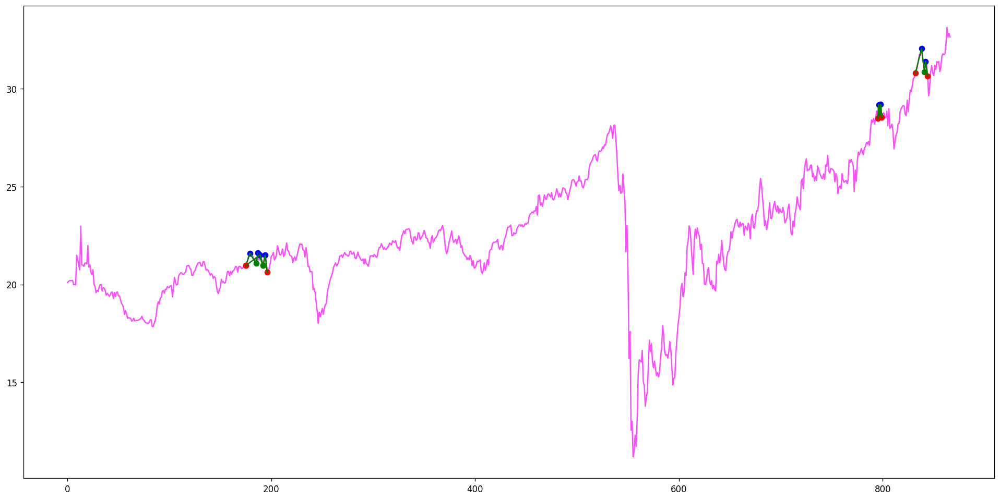

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(11, 13, 14, 15, 16), (20, 25, 26, 28, 29), (40, 41, 42, 43, 44), (50, 51, 53, 56, 58), (73, 74, 75, 76, 77), (72, 76, 80, 86, 89), (128, 129, 130, 131, 132), (127, 131, 134, 135, 136), (126, 131, 137, 142, 147), (137, 142, 145, 146, 147), (176, 177, 178, 179, 180), (180, 181, 182, 184, 186), (191, 192, 194, 195, 196), (203, 205, 207, 210, 219), (236, 237, 239, 240, 241), (267, 268, 269, 273, 274), (281, 282, 283, 284, 285), (316, 317, 319, 320, 321), (326, 327, 328, 330, 331), (357, 358, 359, 360, 361), (368, 369, 371, 372, 373), (434, 435, 436, 437, 439), (460, 461, 462, 463, 464), (493, 495, 496, 498, 500), (490, 498, 500, 501, 502), (508, 509, 510, 511, 512), (503, 504, 507, 509, 513), (525, 526, 527, 528, 529), (551, 552, 555, 556, 557), (575, 576, 577, 578, 579), (562, 563, 564, 570, 580), (580, 581, 582, 583, 584), (599, 600, 601, 602, 604), (625, 628, 629, 630, 633), (634, 635, 636, 638, 639), (654, 656, 659, 661, 662), (662, 663, 665, 666, 667), (668, 669, 670, 674, 680), (69

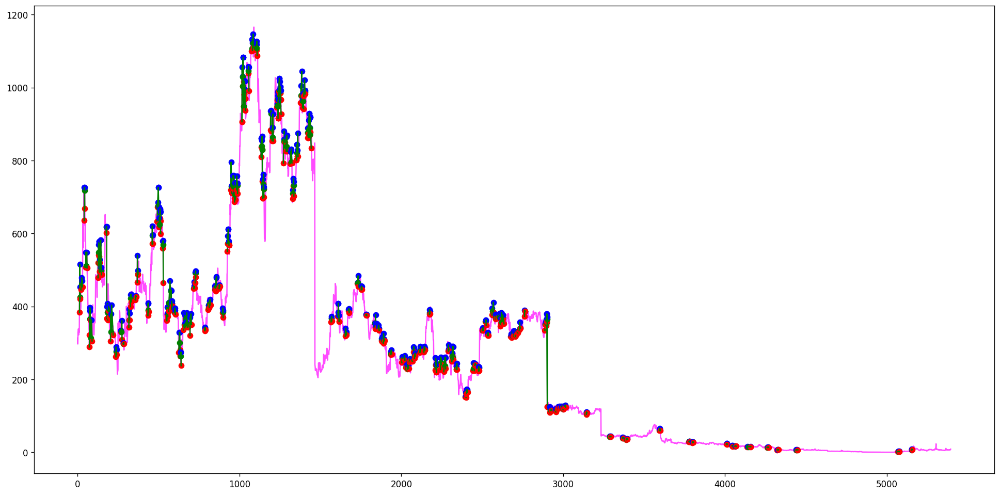

[(152, 153, 154, 155, 158), (209, 210, 211, 212, 214), (301, 302, 303, 304, 305), (342, 345, 346, 348, 350), (539, 540, 542, 543, 545), (644, 645, 646, 647, 648), (657, 658, 659, 661, 662), (672, 674, 676, 677, 679), (710, 713, 715, 716, 717), (724, 725, 726, 727, 728), (898, 899, 900, 901, 903), (915, 927, 928, 931, 933), (1110, 1114, 1121, 1127, 1136), (1471, 1474, 1476, 1478, 1494), (1858, 1860, 1866, 1868, 1873), (1891, 1892, 1894, 1899, 1902), (1964, 1966, 1967, 1968, 1969), (2140, 2147, 2149, 2150, 2152), (2161, 2163, 2165, 2167, 2169), (2274, 2275, 2276, 2278, 2279), (2889, 2896, 2902, 2905, 2907), (3393, 3396, 3399, 3400, 3401), (3534, 3535, 3538, 3541, 3542), (4016, 4022, 4025, 4026, 4027), (4420, 4422, 4423, 4425, 4429), (4521, 4526, 4527, 4528, 4529), (4585, 4587, 4589, 4592, 4594), (4654, 4656, 4657, 4658, 4666), (4755, 4756, 4758, 4759, 4760), (4857, 4860, 4861, 4863, 4866), (4934, 4937, 4938, 4940, 4941), (5041, 5045, 5047, 5048, 5049), (5072, 5073, 5076, 5077, 5078), (53

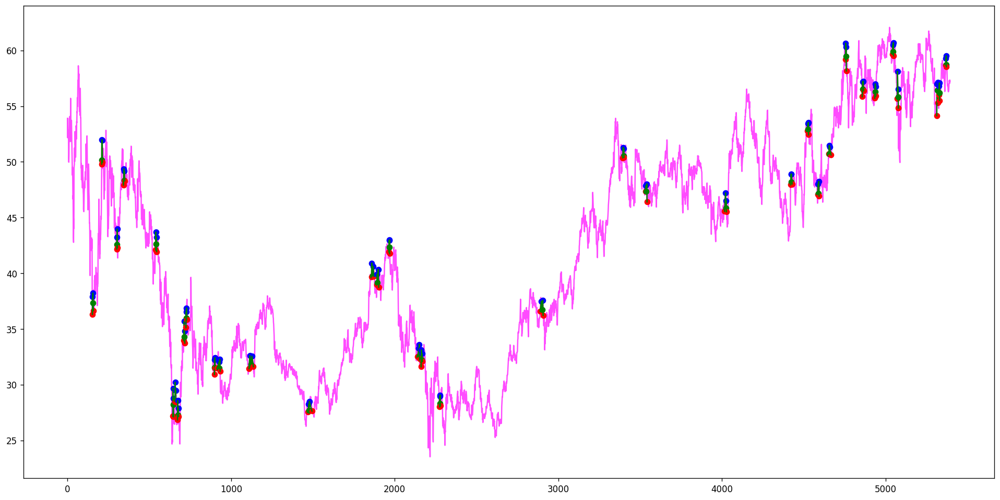

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(33, 35, 36, 40, 42), (216, 217, 218, 219, 220), (272, 274, 276, 278, 279), (297, 298, 299, 300, 301), (383, 384, 385, 386, 387), (418, 420, 421, 423, 424), (449, 450, 451, 452, 453), (683, 686, 688, 689, 690), (690, 691, 692, 693, 694), (707, 708, 709, 710, 711), (801, 802, 803, 804, 805), (813, 814, 817, 818, 819), (861, 864, 866, 867, 868), (934, 935, 936, 937, 938), (992, 993, 994, 995, 996), (1000, 1005, 1007, 1008, 1009), (1049, 1050, 1051, 1052, 1053), (1243, 1244, 1245, 1247, 1248), (1268, 1269, 1270, 1275, 1277), (1342, 1343, 1344, 1345, 1347), (1448, 1449, 1450, 1451, 1453), (1453, 1454, 1455, 1456, 1457), (1509, 1510, 1511, 1512, 1513), (1519, 1520, 1521, 1522, 1523), (1532, 1533, 1534, 1536, 1537), (1544, 1547, 1548, 1550, 1554), (1563, 1564, 1565, 1567, 1568), (1619, 1620, 1621, 1622, 1623), (1634, 1635, 1636, 1637, 1641), (1636, 1637, 1638, 1639, 1641), (1642, 1643, 1644, 1645, 1646), (1670, 1671, 1672, 1673, 1675)]
[]
Ticker W found 32 double top patterns, 0 double bott

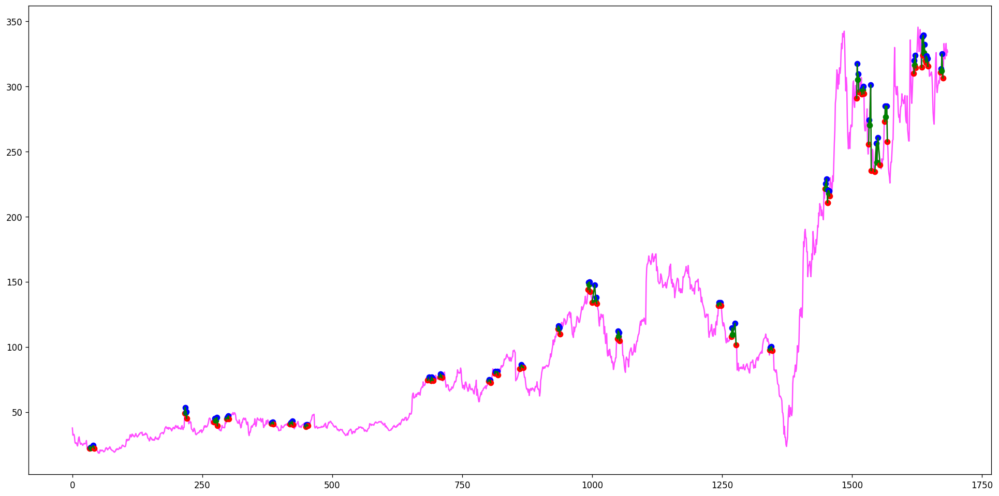

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(2, 4, 6, 9, 11), (171, 176, 179, 180, 182), (348, 350, 354, 358, 361), (405, 408, 410, 413, 418), (1100, 1111, 1113, 1122, 1124), (1128, 1139, 1143, 1149, 1152), (1270, 1281, 1284, 1285, 1289), (1377, 1379, 1384, 1386, 1405), (1587, 1588, 1591, 1593, 1598), (1988, 1989, 1991, 1993, 1994), (2161, 2163, 2165, 2166, 2168), (2242, 2243, 2244, 2246, 2249), (2347, 2348, 2349, 2350, 2353), (2353, 2354, 2355, 2356, 2358), (2369, 2371, 2372, 2374, 2375), (2438, 2440, 2443, 2444, 2447), (2623, 2624, 2626, 2628, 2633), (2891, 2892, 2894, 2895, 2897), (2962, 2963, 2964, 2965, 2966), (3166, 3167, 3170, 3179, 3188), (3805, 3808, 3811, 3812, 3816), (3821, 3824, 3825, 3826, 3828), (3943, 3944, 3945, 3950, 3952), (3994, 3996, 4002, 4003, 4004), (4029, 4031, 4032, 4033, 4034), (4071, 4072, 4075, 4078, 4081), (4874, 4875, 4877, 4878, 4880), (4936, 4937, 4938, 4940, 4941), (5017, 5018, 5019, 5021, 5022), (5095, 5099, 5103, 5104, 5106), (5195, 5197, 5199, 5202, 5203), (5263, 5265, 5267, 5269, 5271), (527

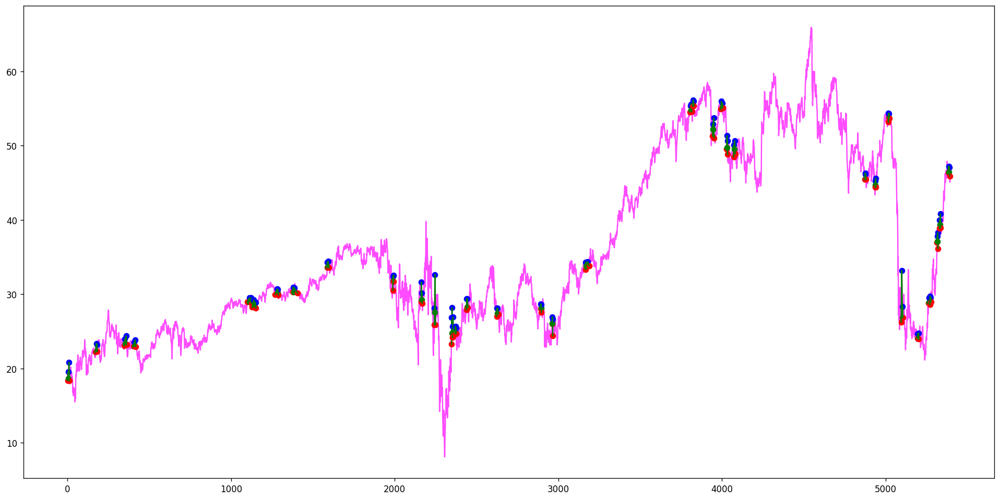

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in arccos


[(51, 52, 53, 54, 56), (200, 202, 203, 205, 206), (316, 318, 319, 320, 321), (331, 332, 333, 334, 340), (374, 375, 376, 377, 379), (436, 438, 439, 440, 441), (442, 443, 445, 446, 448), (655, 656, 657, 658, 659), (687, 688, 690, 691, 692), (703, 704, 705, 706, 707), (768, 769, 771, 773, 774), (830, 832, 839, 841, 843), (887, 888, 889, 890, 892), (996, 997, 999, 1003, 1004), (1765, 1769, 1772, 1773, 1775), (2145, 2147, 2148, 2149, 2151), (2183, 2185, 2187, 2188, 2189), (2197, 2198, 2200, 2201, 2202), (2209, 2210, 2211, 2212, 2213), (2303, 2305, 2307, 2308, 2309), (2362, 2369, 2373, 2374, 2375), (2485, 2490, 2496, 2497, 2499), (2625, 2627, 2628, 2630, 2632), (2653, 2654, 2656, 2666, 2668), (2995, 2997, 2999, 3001, 3003), (3065, 3069, 3073, 3081, 3083), (3344, 3345, 3346, 3348, 3350), (3372, 3374, 3375, 3377, 3379), (3407, 3408, 3413, 3417, 3418), (3447, 3448, 3450, 3451, 3452), (3561, 3562, 3566, 3568, 3570), (3776, 3777, 3778, 3779, 3780), (3861, 3862, 3863, 3866, 3867), (3899, 3900, 390

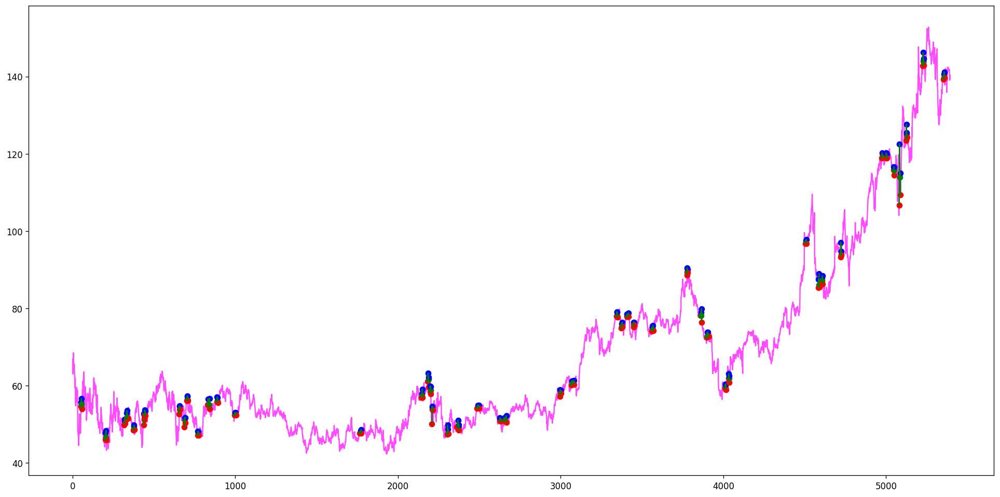

[(562, 568, 570, 573, 575), (930, 932, 933, 935, 936), (948, 949, 952, 954, 956), (1302, 1303, 1304, 1305, 1306), (1328, 1329, 1330, 1331, 1332), (1339, 1340, 1341, 1343, 1344), (1349, 1350, 1352, 1353, 1354), (1396, 1397, 1398, 1399, 1400), (1428, 1429, 1432, 1435, 1436), (1459, 1460, 1461, 1462, 1463), (1582, 1584, 1585, 1586, 1587), (1705, 1706, 1708, 1709, 1710), (1711, 1712, 1714, 1716, 1717), (1720, 1721, 1723, 1724, 1725), (1746, 1747, 1748, 1749, 1750), (1791, 1792, 1794, 1795, 1796), (1844, 1846, 1847, 1848, 1849), (1861, 1862, 1863, 1865, 1866), (1889, 1891, 1893, 1894, 1895), (1957, 1959, 1960, 1962, 1964), (1994, 1995, 1996, 1997, 2000), (2005, 2006, 2007, 2009, 2010), (2015, 2016, 2017, 2018, 2021), (2081, 2082, 2084, 2085, 2086), (2103, 2104, 2105, 2106, 2107), (2116, 2117, 2118, 2119, 2120), (2128, 2129, 2130, 2131, 2132), (2183, 2186, 2187, 2188, 2189), (2209, 2210, 2211, 2212, 2214), (2219, 2220, 2221, 2223, 2225), (2518, 2519, 2520, 2523, 2524), (2561, 2562, 2563, 256

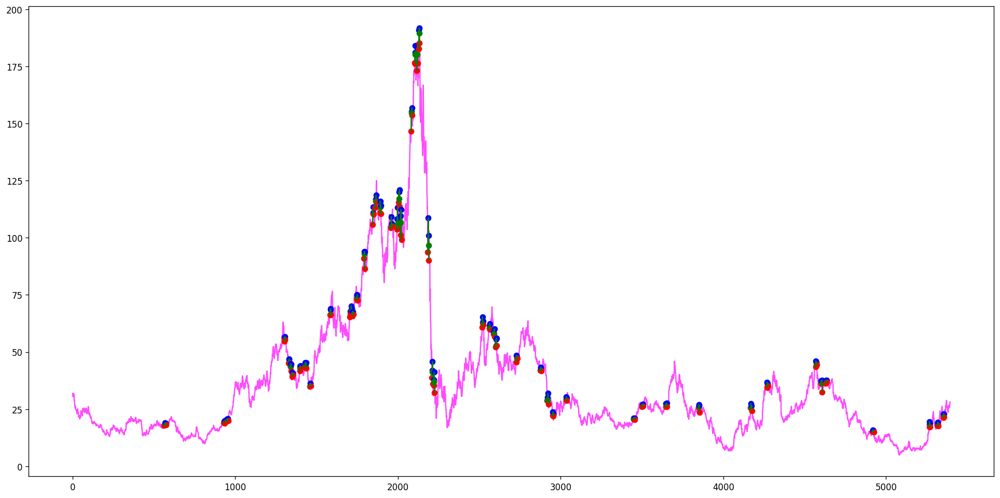

[(7, 8, 9, 11, 12), (62, 64, 65, 66, 67), (477, 482, 483, 484, 486), (518, 520, 523, 524, 525), (589, 591, 592, 593, 595), (621, 623, 626, 627, 629), (642, 643, 644, 645, 646), (740, 741, 744, 746, 749), (803, 806, 807, 811, 812), (1515, 1517, 1518, 1519, 1520), (1525, 1526, 1530, 1531, 1532), (1538, 1541, 1543, 1544, 1546), (1666, 1668, 1669, 1670, 1673), (1745, 1748, 1750, 1751, 1754), (1907, 1909, 1910, 1911, 1912), (1962, 1963, 1964, 1966, 1967), (1981, 1982, 1983, 1984, 1985), (2056, 2057, 2058, 2059, 2060), (2118, 2119, 2120, 2121, 2122), (2128, 2129, 2130, 2131, 2132), (2209, 2210, 2211, 2212, 2214), (2316, 2317, 2318, 2320, 2322), (2384, 2385, 2386, 2387, 2388), (2423, 2424, 2425, 2426, 2428), (2516, 2517, 2519, 2520, 2524), (2786, 2787, 2790, 2791, 2792), (2921, 2922, 2923, 2924, 2925), (2951, 2952, 2953, 2954, 2956), (3066, 3067, 3068, 3071, 3073), (3075, 3076, 3078, 3081, 3082), (3224, 3228, 3229, 3231, 3232), (3283, 3285, 3286, 3287, 3288), (3300, 3301, 3303, 3304, 3305), (

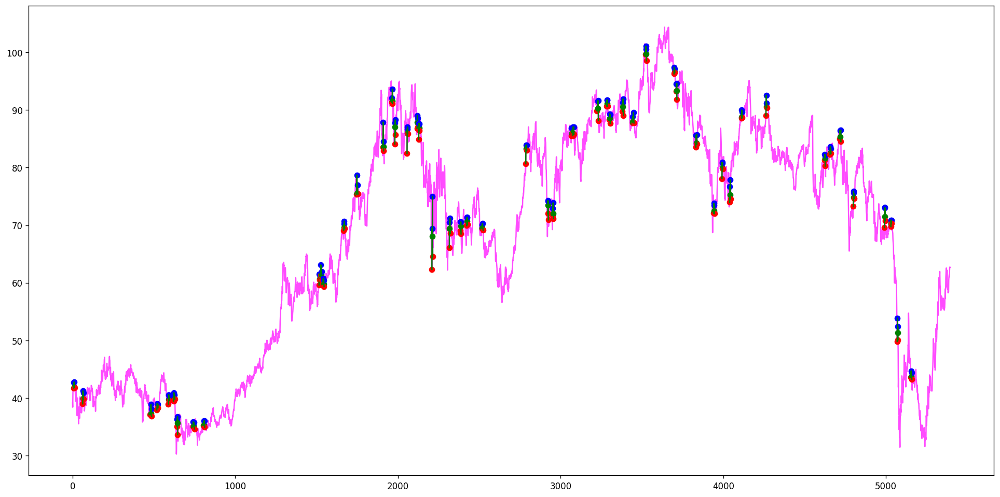

[(8, 12, 16, 17, 19), (97, 98, 99, 101, 104)]
[]
Ticker XPEV found 2 double top patterns, 0 double bottom patterns


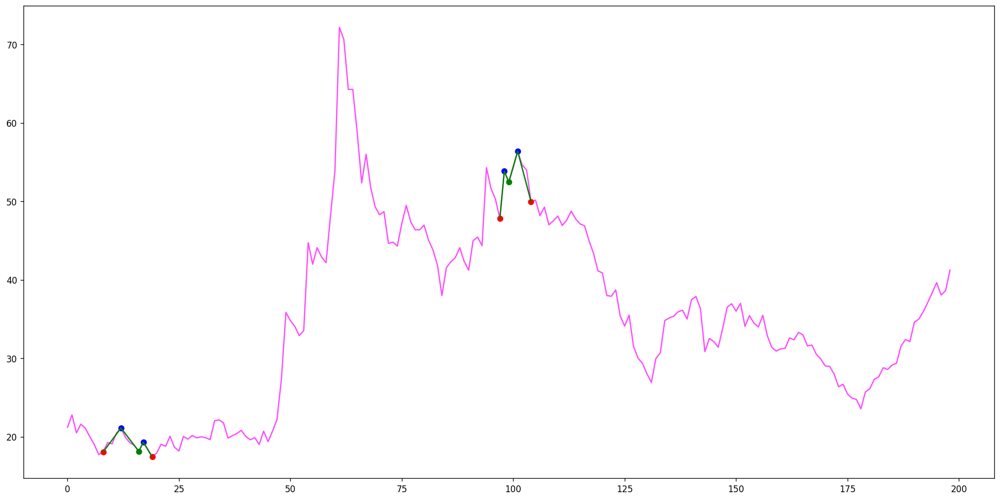

[(3, 4, 6, 8, 9), (14, 15, 16, 18, 19), (106, 107, 109, 111, 112), (131, 134, 136, 137, 139), (151, 152, 153, 154, 155), (200, 201, 202, 203, 204), (235, 236, 238, 239, 240), (250, 251, 252, 253, 254), (460, 461, 462, 463, 464), (473, 474, 476, 477, 478), (483, 484, 485, 486, 488), (686, 688, 689, 692, 693), (772, 773, 774, 776, 777), (862, 863, 864, 866, 867), (1149, 1151, 1152, 1153, 1155), (1171, 1172, 1173, 1174, 1175), (1190, 1191, 1192, 1193, 1194), (1200, 1201, 1202, 1203, 1205), (1243, 1244, 1245, 1246, 1247), (1266, 1267, 1268, 1269, 1270), (1286, 1287, 1288, 1289, 1291), (1306, 1307, 1309, 1310, 1312), (1357, 1358, 1359, 1360, 1361), (1369, 1370, 1371, 1372, 1374), (1380, 1381, 1382, 1383, 1384), (1432, 1433, 1434, 1436, 1437), (1470, 1475, 1478, 1479, 1480), (1510, 1511, 1513, 1514, 1515), (1526, 1527, 1528, 1529, 1530), (1561, 1562, 1563, 1564, 1570), (1580, 1581, 1582, 1583, 1585), (1721, 1722, 1723, 1724, 1725), (1754, 1756, 1757, 1759, 1761), (1766, 1767, 1768, 1769, 177

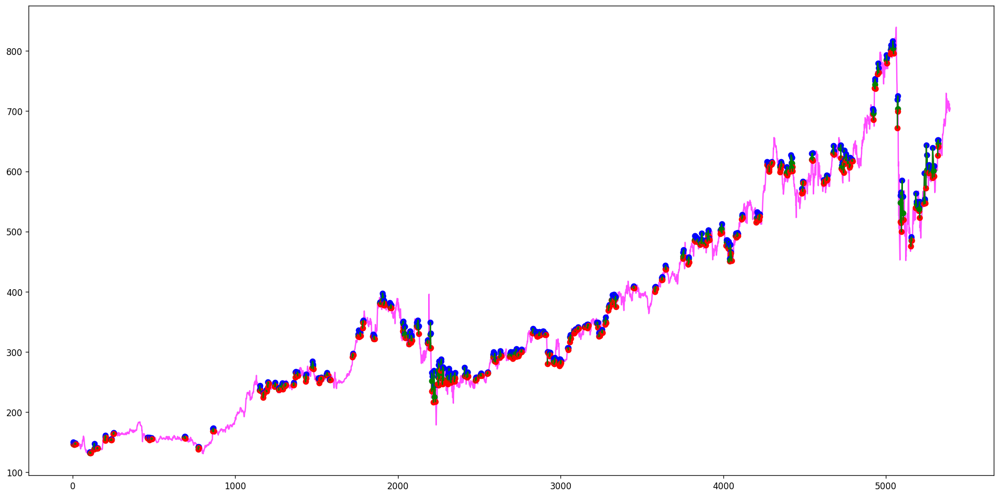

[(2, 3, 6, 8, 9), (118, 119, 123, 124, 125), (364, 366, 367, 371, 375), (364, 366, 367, 372, 375), (569, 571, 572, 573, 575), (694, 695, 696, 697, 699), (811, 813, 814, 815, 816), (973, 975, 976, 977, 978), (988, 990, 991, 992, 994), (1076, 1077, 1078, 1082, 1083), (1226, 1229, 1230, 1231, 1232), (1270, 1271, 1272, 1274, 1275), (1329, 1330, 1332, 1333, 1334), (1408, 1411, 1416, 1418, 1420), (1429, 1430, 1432, 1433, 1434), (1438, 1439, 1440, 1442, 1445)]
[]
Ticker Z found 16 double top patterns, 0 double bottom patterns


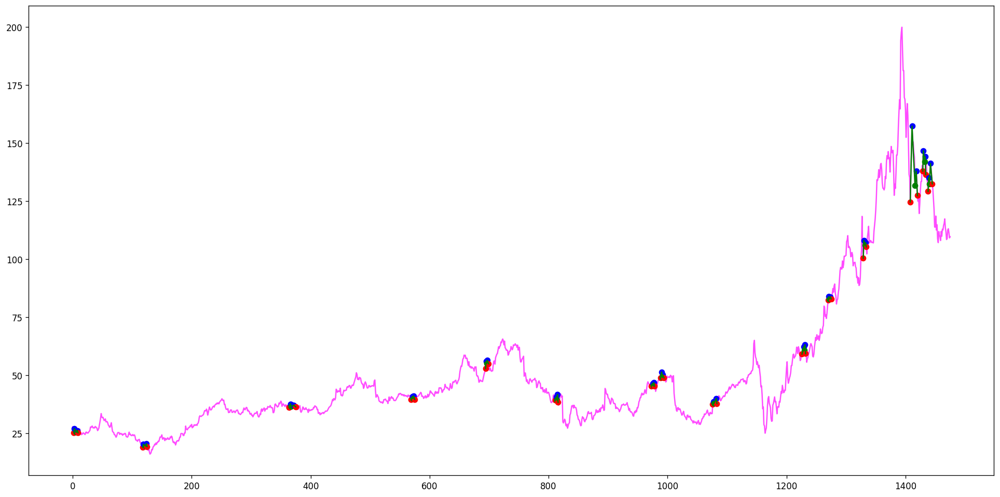

[(12, 13, 14, 15, 16), (19, 20, 21, 22, 23), (58, 59, 60, 61, 62), (75, 77, 79, 80, 82), (186, 187, 189, 190, 191), (218, 219, 220, 221, 222), (254, 255, 256, 257, 258), (281, 283, 285, 286, 287), (314, 315, 316, 317, 318), (324, 325, 326, 327, 329), (366, 367, 368, 369, 370), (376, 379, 381, 382, 383), (374, 375, 376, 379, 387), (402, 403, 405, 408, 409), (453, 454, 455, 460, 464), (474, 475, 476, 477, 480), (476, 477, 478, 479, 480), (491, 492, 493, 494, 495), (498, 499, 500, 501, 503)]
[]
Ticker ZM found 19 double top patterns, 0 double bottom patterns


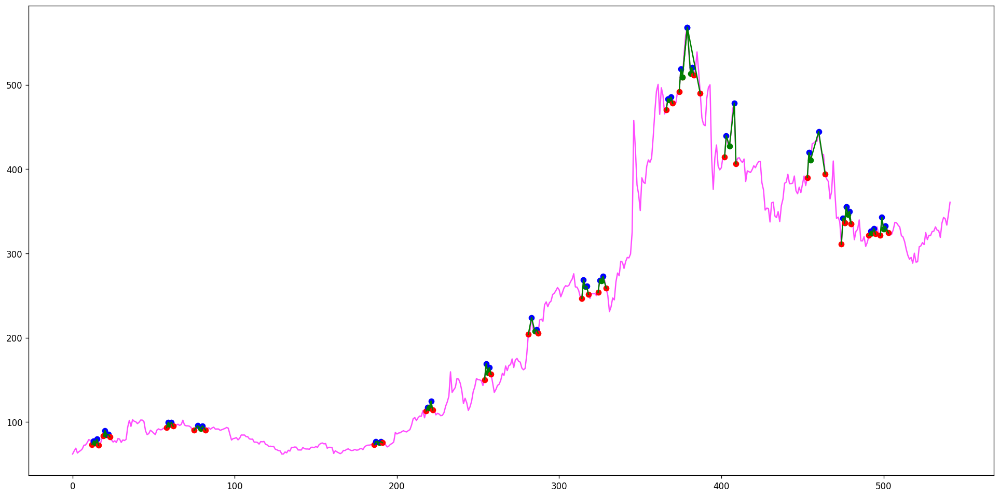

In [16]:
for ticker in ticker_dfs.keys():
    ticker_df = ticker_dfs[ticker]
    if ticker_df is None:
        continue

    # discrete dataset
    x_data = ticker_df.index.to_numpy()      # the index will be our x axis, not date
    y_data = ticker_df[price_name].to_numpy()
    # print(x_data)
    # print(y_data)

    suspected_double_bottoms = []
    suspected_double_tops = find_double_top_in_pre_time_steps(x_data, y_data, pre_time_steps)
    # suspected_double_bottoms = find_double_bot_in_pre_time_steps(x_data, y_data, pre_time_steps)
    # suspected_double_tops = find_double_top(x_data, y_data)
    # suspected_double_bottoms = find_double_bottom(x_data, y_data)
    print(suspected_double_tops)
    print(suspected_double_bottoms)
    print('Ticker {} found {} double top patterns, {} double bottom patterns'.format(ticker, len(suspected_double_tops), len(suspected_double_bottoms)))
    # save_data_price_patterns(x_data, y_data, suspected_double_tops,
    #                          "{}_{}_{}_{}_double_top_data_patterns.csv"
    #                          .format(ticker, start_time, end_time, pre_time_steps))
    # save_data_price_patterns(x_data, y_data, suspected_double_bottoms,
    #                          "{}_{}_{}_{}_double_bot_data_patterns.csv"
    #                          .format(ticker, start_time, end_time, pre_time_steps))
    for i, double_top in enumerate(suspected_double_tops):
        save_data_price_pattern(ticker_df,
                                double_top,
                                "{}_{}_{}_{}_{:03d}_double_top_data_patterns.csv"
                                .format(ticker, start_time, end_time, pre_time_steps, i))

    visualize_res(x_data, y_data, suspected_double_tops, suspected_double_bottoms)

In [17]:
!zip -jm /content/data_price_patterns.zip /content/*.csv

Streaming output truncated to the last 5000 lines.
  adding: ADBE_2000-01-01 00:00:00_2021-06-11_30_026_double_top_data_patterns.csv (deflated 74%)
  adding: ADBE_2000-01-01 00:00:00_2021-06-11_30_027_double_top_data_patterns.csv (deflated 74%)
  adding: ADBE_2000-01-01 00:00:00_2021-06-11_30_028_double_top_data_patterns.csv (deflated 72%)
  adding: ADBE_2000-01-01 00:00:00_2021-06-11_30_029_double_top_data_patterns.csv (deflated 74%)
  adding: ADBE_2000-01-01 00:00:00_2021-06-11_30_030_double_top_data_patterns.csv (deflated 73%)
  adding: ADBE_2000-01-01 00:00:00_2021-06-11_30_031_double_top_data_patterns.csv (deflated 72%)
  adding: ADBE_2000-01-01 00:00:00_2021-06-11_30_032_double_top_data_patterns.csv (deflated 73%)
  adding: ADBE_2000-01-01 00:00:00_2021-06-11_30_033_double_top_data_patterns.csv (deflated 75%)
  adding: ADBE_2000-01-01 00:00:00_2021-06-11_30_034_double_top_data_patterns.csv (deflated 74%)
  adding: ADBE_2000-01-01 00:00:00_2021-06-11_30_035_double_top_data_pattern